In [19]:
import geopandas as gpd
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.optimize import minimize
from deap import base, creator, tools, algorithms
from tqdm import tqdm

import numpy as np
rng = np.random.default_rng(seed=42)

In [71]:
# Import the dataframes
df_marketshare_with_amazon = pd.read_csv("output/00_markedshare_with_amazon.csv")
df_b2b_share = pd.read_csv("output/01_b2b_forecast_complete.csv")

ga_corrected_b2b_gdf = gpd.read_file("output/04_ga_corrected_b2b_df.csv", GEOM_POSSIBLE_NAMES="geometry", KEEP_GEOM_COLUMNS="NO")
#Convert Columns with Numeric-looking Strings to Proper Numeric Format
for col in ga_corrected_b2b_gdf.select_dtypes(include=["object"]).columns:
    if col != ga_corrected_b2b_gdf.geometry.name:
        try:
            converted = pd.to_numeric(ga_corrected_b2b_gdf[col], errors="coerce")
            if converted.notna().sum() > 0.9 * len(ga_corrected_b2b_gdf):  
                ga_corrected_b2b_gdf[col] = converted
        except Exception as e:
            print(e)
            pass 

# Import postal code data for plotting
# The postal code data is in a CSV format
gdf_plz = gpd.read_file("input/plz_region_hannover.csv", GEOM_POSSIBLE_NAMES="geometry", KEEP_GEOM_COLUMNS="NO")
for col in gdf_plz.select_dtypes(include=["object"]).columns:
    if col != gdf_plz.geometry.name:
        try:
            converted = pd.to_numeric(gdf_plz[col], errors="coerce")
            if converted.notna().sum() > 0.9 * len(gdf_plz):  
                gdf_plz[col] = converted
        except Exception as e:
            print(e)
            pass 

In [105]:
# ============================================================================================
# 📊 PLOTTING FUNCTIONS: Visualization of Results and Evaluation Metrics
# --------------------------------------------------------------------------------------------
# This section contains all helper functions used to visualize and evaluate results of the
# B2B and carrier market share modeling pipeline. These include:
#
# - plot_b2b_ratio_per_carrier:      B2B ratio per carrier based on optimized B2B factors.
# - plot_fitness_evolution:          Fitness curve over generations during genetic algorithm.
# - plot_actual_b2b_per_carrier:     Actual contribution of each carrier to total B2B volume.
# - plot_market_share_comparison:    Comparison of estimated vs. target market shares.
# - plot_b2b_estimation_vs_target:   Scatter + error analysis of cell-wise B2B targets vs. model.
# - visualize_market_shares:         Spatial and statistical visualization of market shares
#                                    (KDE, grid cells, and postal-code aggregation).
#
# All plots are used for result analysis and model debugging, and rely on weighted statistics
# using cell-level estimated parcel volumes as weights (column: `total_coun`).
# ============================================================================================

def plot_b2b_ratio_per_carrier(market_share_df, carriers, optimized_b2b_vector):
    """
    Plot the B2B share per carrier, calculated by multiplying the market share with the optimized B2B factor.
    """
    # Compute the share of B2B shipments per carrier
    b2b_contributions = {
        c: market_share_df[c] * optimized_b2b_vector[i]
        for i, c in enumerate(carriers)
    }

    # Weighted total volumes (for market share scaling)
    total_weight = market_share_df["total_coun"].values
    total_per_carrier = {c: np.sum(market_share_df[c] * total_weight) for c in carriers}
    b2b_per_carrier = {c: np.sum(b2b_contributions[c] * total_weight) for c in carriers}

    # Final B2B share per carrier
    b2b_ratio = {c: b2b_per_carrier[c] / total_per_carrier[c] for c in carriers}

    # Plot bar chart
    plt.figure(figsize=(10, 5))
    plt.bar(b2b_ratio.keys(), [v * 100 for v in b2b_ratio.values()])
    plt.ylabel("B2B Share of Deliveries (%)")
    plt.title("B2B Share per Carrier (weighted by total deliveries)")
    plt.grid(True, axis="y")
    plt.tight_layout()
    plt.show()

    # Optional: Tabular summary
    df_ratio = pd.DataFrame({
        "Carrier": list(b2b_ratio.keys()),
        "B2B Share (%)": [round(v * 100, 2) for v in b2b_ratio.values()]
    }).sort_values("B2B Share (%)", ascending=False)
    print(df_ratio)


def plot_fitness_evolution(logbook):
    """
    Plot the GA fitness evolution over generations (min and average).
    """
    gen = logbook.select("gen")
    fit_mins = logbook.select("min")
    fit_avgs = logbook.select("avg")

    plt.figure(figsize=(10, 4))
    plt.plot(gen, fit_mins, label="Minimum Fitness")
    plt.plot(gen, fit_avgs, label="Average Fitness")
    plt.xlabel("Generation")
    plt.ylabel("Fitness (Squared Error Sum)")
    plt.title("Fitness Evolution during Genetic Algorithm")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


def plot_actual_b2b_per_carrier(market_share_df, carriers, optimized_b2b_vector):
    """
    Visualize how much each carrier contributes to the total B2B volume after optimization.
    """
    b2b_contributions = {
        c: market_share_df[c] * optimized_b2b_vector[i] * market_share_df["total_coun"]
        for i, c in enumerate(carriers)
    }
    b2b_totals = {c: np.sum(b2b_contributions[c]) for c in carriers}
    total_b2b = sum(b2b_totals.values())
    b2b_share = {c: (v / total_b2b) * 100 for c, v in b2b_totals.items()}

    plt.figure(figsize=(10, 5))
    plt.bar(b2b_share.keys(), b2b_share.values())
    plt.ylabel("Share of Total B2B Volume (%)")
    plt.title("Carrier Contribution to Total B2B Volume")
    plt.grid(True, axis="y")
    plt.tight_layout()
    plt.show()

    df_b2b = pd.DataFrame({
        "Carrier": list(b2b_share.keys()),
        "B2B Share (%)": list(b2b_share.values())
    }).sort_values("B2B Share (%)", ascending=False).round(2)
    print(df_b2b)


def plot_market_share_comparison(carriers, target_shares, adjusted_values, weights, year):
    """
    Compare target market shares to estimated (adjusted) values per carrier.
    """
    total_weight = np.sum(weights)
    estimated_shares = {
        k: np.sum(adjusted_values[k]) / total_weight for k in carriers
    }
    target_pct = {k: v * 100 for k, v in target_shares.items()}
    estimated_pct = {k: v * 100 for k, v in estimated_shares.items()}

    df_comp = pd.DataFrame({
        "Carrier": carriers,
        "Target Share (%)": [target_pct[k] for k in carriers],
        "Estimated Share (%)": [estimated_pct[k] for k in carriers]
    })

    fig, ax = plt.subplots(figsize=(10, 6))
    x = np.arange(len(carriers))
    width = 0.35

    ax.bar(x - width / 2, df_comp["Target Share (%)"], width, label="Target")
    ax.bar(x + width / 2, df_comp["Estimated Share (%)"], width, label="Estimated")

    ax.set_xticks(x)
    ax.set_xticklabels(carriers)
    ax.set_ylabel("Market Share (%)")
    ax.set_title(f"Market Share Comparison by Carrier (Year {year})")
    ax.legend()
    plt.grid(True, axis='y')
    plt.tight_layout()
    plt.show()

    return df_comp


def plot_b2b_estimation_vs_target(valid_df, df_b2b_share, target_array, estimated_array, year):
    """
    Plot actual vs. estimated B2B shares and error distribution.
    """
    weights = valid_df["total_coun"].values

    # Get target B2B from master table
    target_row = df_b2b_share[df_b2b_share["Year"] == year].iloc[0]
    target_b2b = target_row["Actual_B2B"] if target_row["Type"] != "Forecast" else target_row["B2B_BoundedSigmoid"]
    target_b2b /= 100

    df_plot = valid_df.copy()
    df_plot["target"] = target_array
    df_plot["estimated"] = estimated_array
    df_plot["error"] = np.abs(df_plot["target"] - df_plot["estimated"])

    # Error visualization (colored scatter)
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=df_plot, x="target", y="estimated", hue="error", palette="coolwarm")
    plt.plot([0, 1], [0, 1], "--", color="gray", label="Perfect Match")
    plt.title("Error Distribution: Target vs. Estimated B2B Share")
    plt.xlabel("Target B2B Share")
    plt.ylabel("Estimated B2B Share")
    plt.grid(True)
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.tight_layout()
    plt.show()

    # Weighted RMSE
    mse = np.average((estimated_array - target_array) ** 2, weights=weights)
    rmse = np.sqrt(mse)
    print(f"\nWeighted RMSE per cell: {rmse:.4f}")

    # Weighted global B2B value
    global_b2b = np.average(estimated_array, weights=weights)
    print(f"Estimated national B2B share (weighted): {global_b2b:.4f}")
    print(f"Target B2B share from input: {target_b2b:.4f}")
    print(f"Absolute deviation: {abs(global_b2b - target_b2b):.4f}")


def visualize_market_shares(valid_df, adjusted_array, carriers, plz_gdf, year):
    """
    Full visualization of carrier market share:
    - KDE for each carrier across cells
    - Cell-level maps
    - Aggregation at postal code level
    """
    # --- KDE per carrier ---
    df_adjusted = pd.DataFrame(adjusted_array, columns=carriers)
    df_adjusted["total_coun"] = valid_df["total_coun"].values

    plt.figure(figsize=(12, 6))
    for carrier in carriers:
        sns.kdeplot(data=df_adjusted, x=carrier, label=carrier)
    plt.title("Carrier Market Share Distribution (cell-level)")
    plt.xlabel("Market Share")
    plt.ylabel("Density")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # --- Summary statistics ---
    stats = df_adjusted[carriers].describe().T
    stats["range"] = stats["max"] - stats["min"]
    print(stats[["mean", "std", "range"]].round(3))

    # --- Cell-level maps ---
    gdf = gpd.GeoDataFrame(valid_df.copy(), geometry="geometry")
    for carrier in carriers:
        gdf[f"share_{carrier}"] = adjusted_array[:, carriers.index(carrier)]

    rows = int(np.ceil(len(carriers) / 2))
    fig, axes = plt.subplots(rows, 2, figsize=(12, rows * 6))
    vmax = gdf[[f"share_{c}" for c in carriers]].max().max()

    for i, carrier in enumerate(carriers):
        r, c = divmod(i, 2)
        ax = axes[r, c] if rows > 1 else axes[c]
        gdf.plot(column=f"share_{carrier}", cmap="OrRd", legend=True,
                 legend_kwds={'shrink': 0.6}, ax=ax, vmin=0, vmax=vmax)
        ax.set_title(f"{carrier} Share (Grid Cells, {year})")
        ax.axis("off")

    for j in range(len(carriers), rows * 2):
        r, c = divmod(j, 2)
        ax = axes[r, c] if rows > 1 else axes[c]
        ax.axis("off")

    plt.tight_layout()
    plt.show()

    # --- Aggregation to postal code level ---
    grouped = gdf.groupby("postal_cod")
    plz_aggregated = pd.DataFrame({
        f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
        for c in carriers
    })
    plz_aggregated.index.name = "postal_cod"
    plz_aggregated.reset_index(inplace=True)
    plz_gdf_merged = plz_gdf.merge(plz_aggregated, on="postal_cod", how="inner")

    fig, axes = plt.subplots(rows, 2, figsize=(12, rows * 6))
    vmax = plz_gdf_merged[[f"share_{c}" for c in carriers]].max().max()

    for i, carrier in enumerate(carriers):
        r, c = divmod(i, 2)
        ax = axes[r, c] if rows > 1 else axes[c]
        plz_gdf_merged.plot(column=f"share_{carrier}", cmap="OrRd", legend=True,
                            legend_kwds={'shrink': 0.6}, ax=ax, vmin=0, vmax=vmax)
        ax.set_title(f"{carrier} Share (Postal Code, {year})")
        ax.axis("off")

    for j in range(len(carriers), rows * 2):
        r, c = divmod(j, 2)
        ax = axes[r, c] if rows > 1 else axes[c]
        ax.axis("off")

    plt.tight_layout()
    plt.show()


In [106]:
# ============================================================================================
# 🔧 HELPER FUNCTIONS: Data Preparation and Dynamic Bound Scaling for Carrier B2B Optimization
# --------------------------------------------------------------------------------------------
# These functions assist in preparing the input data for optimization of carrier-specific
# B2B shares, as well as in dynamically adjusting parameter bounds over time.
#
# 1. prepare_data(...) :
#    - Loads the target market shares for a given year from a market share DataFrame.
#    - Filters valid grid cells from the corrected B2B dataset.
#    - Returns all relevant inputs required for optimization and modeling.
#
# 2. generate_dynamic_bounds(...) :
#    - Dynamically scales the lower bounds of carrier B2B factors over time.
#    - Reflects the structural shift in the German parcel market, where B2B share 
#      has been decreasing steadily (e.g., from 45% in 2010 toward ~20% in 2025).
# ============================================================================================

def prepare_data(year, df_market, ga_corrected_b2b_df, b2b_share_by_carrier_full, sample_size):
    """
    Extracts and prepares input data for optimization in a specific year.

    Parameters:
    -----------
    year : int
        Year for which data is to be prepared.
    df_market : pd.DataFrame
        DataFrame containing target market shares per carrier per year.
    ga_corrected_b2b_df : pd.DataFrame
        Grid-level B2B estimates (adjusted via GA), with parcel volume estimates per cell.
    b2b_share_by_carrier_full : dict
        Initial B2B base factors per carrier (reference values).
    sample_size : int
        Optional sample size (currently unused unless sampling is activated).

    Returns:
    --------
    carriers : list of str
        List of carriers that have significant share in the given year.
    b2b_base_vector : np.array
        Base B2B factors for the selected carriers.
    target_market_shares : dict
        Target market shares per carrier (as fractions, not percentages).
    global_shares_vector : np.array
        Target market shares as a NumPy array.
    valid_df : pd.DataFrame
        Filtered DataFrame of cells with valid B2B data for the selected year.
    b2b_column : str
        Column name of the adjusted B2B share for the current year.
    """
    target_row = df_market[df_market["Year"] == year].iloc[0].to_dict()
    target_row.pop("Year", None)  # remove 'Jahr' key

    # Only consider carriers with more than 1% marked share
    carriers = [k for k in target_row if target_row[k] > 1]

    # Get B2B base values only for selected carriers
    b2b_share_by_carrier = {k: b2b_share_by_carrier_full[k] for k in carriers}
    target_market_shares = {k: target_row[k] / 100 for k in carriers}
    global_shares_vector = np.array(list(target_market_shares.values()))
    b2b_base_vector = np.array([b2b_share_by_carrier[k] for k in carriers])

    # Filter the corrected grid cells
    b2b_column = f"b2b_ratio_norm_adj_{year}"
    valid_df = ga_corrected_b2b_df[ga_corrected_b2b_df["total_coun"] > 0]
    valid_df = valid_df[valid_df[b2b_column].notna()]

    # Optional sampling (currently deactivated)
    if sample_size is not None:
        sampled_indices = rng.choice(valid_df.index, size=sample_size, replace=False)
        valid_df = valid_df.loc[sampled_indices].copy()

    return carriers, b2b_base_vector, target_market_shares, global_shares_vector, valid_df, b2b_column



def bounded_sigmoid(x, L, x0, k):
    return L / (1 + np.exp(-k * (x - x0)))

def generate_dynamic_bounds(
    year,
    base_bounds,
    year_start=2010,
    year_end=2025,
    b2b_start=0.45,
    b2b_end=0.2,
    method="linear",
    sigmoid_params=(28.8834, 7.2464, -0.3286)
):
    """
    Dynamically scales the lower bounds for carrier B2B factors based on the given year.
    
    Supports either linear interpolation or a bounded sigmoid curve for scaling used from 01_EstimateGlobalGermanB2BShares.

    Parameters:
    -----------
    year : int
        Year for which to calculate scaled lower bounds.
    base_bounds : dict
        Dictionary of (min, max) tuples for each carrier's B2B share.
    year_start : int
        Start year of the B2B trend.
    year_end : int
        End year of the B2B trend.
    b2b_start : float
        Initial global B2B share (e.g., 0.45).
    b2b_end : float
        Final global B2B share (e.g., 0.20).
    method : str
        Method for scaling: "linear" or "sigmoid".
    sigmoid_params : tuple
        Parameters (L, x0, k) for the sigmoid function.

    Returns:
    --------
    new_bounds : dict
        Dictionary with adjusted (min, max) tuples for each carrier.
    """
    # Clamp year
    year = max(min(year, year_end), year_start)

    # Normalize year to [0, 1]
    t = (year - year_start) / (year_end - year_start)

    # Determine current B2B share
    if method == "linear":
        current_b2b = b2b_start + (b2b_end - b2b_start) * t
    elif method == "sigmoid":
        # Scale year to x range used for sigmoid (e.g., map 2010–2025 to 0–15)
        x = (year - year_start)  # this maps year 2010 -> 0, 2025 -> 15
        L, x0, k = sigmoid_params
        sigmoid_val = bounded_sigmoid(x, L, x0, k)
        # Normalize sigmoid to [b2b_end, b2b_start]
        sigmoid_min = bounded_sigmoid(0, L, x0, k)
        sigmoid_max = bounded_sigmoid(year_end - year_start, L, x0, k)
        current_b2b = b2b_end + (b2b_start - b2b_end) * (sigmoid_val - sigmoid_min) / (sigmoid_max - sigmoid_min)
    else:
        raise ValueError("Unknown method. Use 'linear' or 'sigmoid'.")

    # Scale each carrier’s lower bound
    new_bounds = {}
    for carrier, (lower, upper) in base_bounds.items():
        adjusted_lower = lower * (current_b2b / b2b_start)
        new_bounds[carrier] = (round(adjusted_lower, 4), upper)

    return new_bounds


In [107]:
# ============================================================================================
# CORE FUNCTION: Vectorized Cell-Level Market Share Adjustment Based on B2B Targets
# --------------------------------------------------------------------------------------------
# This function is the core logic for aligning local (cell-level) market shares with 
# target B2B ratios. It operates fully vectorized for efficiency and scale.
#
# Purpose:
# --------
# Given:
#   - A vector of global market shares (e.g., [DHL, Hermes, ...])
#   - Carrier-specific B2B share profiles (e.g., DHL = 0.3 B2B, Hermes = 0.1, ...)
#   - A B2B target per grid cell (estimated from regression models)
#
# The function:
#   1. Computes a direction of adjustment for each carrier (based on global B2B mismatch).
#   2. Shifts the market shares per cell along this direction to better match the cell's target B2B.
#   3. Ensures that adjusted market shares remain normalized (sum to 1) and clipped to valid bounds.
#   4. Returns:
#       - Weighted results per carrier
#       - Adjusted market shares
#       - B2B estimation errors per cell
#       - Optional: Global market share error if national targets are provided
#
# This method ensures a consistent alignment between fine-grained regional detail and 
# national-level strategic constraints. It serves as a fast, scalable approximation 
# for downstream validation, visualization, or further optimization.
# ============================================================================================

def fast_vectorized_estimation(
    valid_df,
    target_b2b_column,
    global_market_vector,
    b2b_share_vector,
    carriers,
    target_market_shares=None
):
    """
    Adjusts cell-level market shares to better match each cell’s B2B target while staying
    consistent with the global carrier market distribution.

    Inputs:
    -------
    valid_df : pd.DataFrame
        Filtered grid-level data with at least 'total_coun' and a B2B target column.
    
    target_b2b_column : str
        Name of the column containing the cell-specific target B2B ratios (float, between 0 and 1).
    
    global_market_vector : np.ndarray
        Global market share proportions per carrier, e.g. [0.6, 0.2, 0.2].
    
    b2b_share_vector : np.ndarray
        Carrier-specific B2B proportions, e.g. [0.3, 0.15, 0.05].
    
    carriers : list of str
        Names of the carriers corresponding to the vectors above.
    
    target_market_shares : dict, optional
        National-level market share targets (used for scoring global alignment).

    Returns:
    --------
    weighted_results : dict
        Dictionary with carrier names as keys and weighted market share arrays as values.
    
    total_weights : np.ndarray
        Array of total package volumes per cell (used as weights).
    
    b2b_error : np.ndarray
        Squared error between estimated and target B2B ratios per cell.
    
    market_share_error : float or None
        Global squared error between estimated and target market shares (if targets provided).
    
    adjusted : np.ndarray
        Final adjusted market share matrix per cell (rows = cells, columns = carriers).
    """

    # Retrieve required data arrays
    target_b2b_array = valid_df[target_b2b_column].values        # Cell-specific target B2B shares
    total_weights = valid_df["total_coun"].values                # DHL-estimated total parcels per cell
    total_weight = total_weights.sum()

    # Step 1: Estimate current global B2B from initial carrier mix
    current_b2b = np.dot(global_market_vector, b2b_share_vector)  # scalar value

    # Step 2: Compute directional adjustment vector (carrier-wise)
    base_direction = b2b_share_vector - current_b2b  # shape: (n_carriers,)

    # Step 3: Determine how far each cell's target B2B is from the global estimate
    delta = target_b2b_array - current_b2b  # shape: (n_cells,)

    # Step 4: Nonlinear rescaling factor per cell possible (stronger shift when further from global)
    strength = np.clip(np.abs(delta), 0.05, 1.0) ** 1  # exponent = 1 → linear

    # Step 5: Compute per-cell carrier adjustment matrix (broadcasting!)
    correction_matrix = delta[:, None] * base_direction[None, :] * strength[:, None]  # shape: (n_cells, n_carriers)

    # Step 6: Adjust initial market shares
    adjusted = global_market_vector[None, :] + correction_matrix  # base + directional shift

    # Step 7: Clip to ensure valid bounds and renormalize
    adjusted = np.clip(adjusted, 0.01, 1.0)                        # prevent extreme values
    adjusted /= adjusted.sum(axis=1, keepdims=True)               # re-normalize to sum to 1 per cell

    # Step 8: Recalculate B2B share per cell using adjusted market shares
    estimated_b2b = np.dot(adjusted, b2b_share_vector)             # shape: (n_cells,)
    b2b_error = (estimated_b2b - target_b2b_array) ** 2            # squared error

    # Step 9: Compute volume-weighted result per carrier (used in visualization/stats)
    weighted_results = {
        carrier: adjusted[:, i] * total_weights for i, carrier in enumerate(carriers)
    }

    # Step 10: Optional – Global market share accuracy
    if target_market_shares:
        estimated_market_shares = {
            carrier: weighted_results[carrier].sum() / total_weight
            for carrier in carriers
        }
        market_share_error = sum(
            (estimated_market_shares[carrier] - target_market_shares[carrier]) ** 2
            for carrier in carriers
        )
    else:
        market_share_error = None

    return weighted_results, total_weights, b2b_error, market_share_error, adjusted


In [108]:

def setup_ga(carriers, b2b_base_vector, valid_df, target_b2b_column,
             global_shares_vector, realistic_bounds, evaluation_fn, rng=None):
    """
    Sets up the DEAP Genetic Algorithm (GA) toolbox with mating, mutation, selection, 
    and a custom individual creation strategy.

    Parameters:
    -----------
    carriers : list of str
        List of carrier names (e.g. ["DHL", "Hermes", ...]).
    b2b_base_vector : np.array
        Base B2B shares for each carrier.
    valid_df : pd.DataFrame
        Grid-level input data with B2B targets and weights.
    target_b2b_column : str
        Column in valid_df containing the B2B target value for each cell.
    global_shares_vector : np.array
        National market share proportions per carrier.
    realistic_bounds : dict
        Dictionary of realistic B2B bounds per carrier, e.g. { "DHL": (0.15, 0.4), ... }.
    evaluation_fn : callable
        Function to perform full vectorized B2B and market estimation.
    rng : np.random.Generator, optional
        Numpy random generator for reproducibility (if desired).

    Returns:
    --------
    toolbox : deap.base.Toolbox
        Fully configured DEAP toolbox ready for population and algorithm setup.
    hof : deap.tools.HallOfFame
        Hall of Fame object to store the best solution.
    stats : deap.tools.Statistics
        Statistics object to track fitness metrics.
    """

    # --- DEAP Creator ---
    creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
    creator.create("Individual", list, fitness=creator.FitnessMin)

    toolbox = base.Toolbox()

    # --- Mating and Selection ---
    toolbox.register("mate", tools.cxBlend, alpha=0.5)
    toolbox.register("select", tools.selTournament, tournsize=3)

    # --- Individual Initialization (centered around realistic bounds) ---
    def init_individual():
        return creator.Individual([
            np.random.normal(
                (realistic_bounds[c][0] + realistic_bounds[c][1]) / (2 * b2b_base_vector[i]),
                0.05
            )
            for i, c in enumerate(carriers)
        ])
    
    toolbox.register("individual", init_individual)
    toolbox.register("population", tools.initRepeat, list, toolbox.individual)

    # --- Custom Mutation Operator with Clipping ---
    def mutate_limited(individual):
        for i, c in enumerate(carriers):
            low, high = realistic_bounds[c]
            noise = np.random.normal(0, 0.1)
            individual[i] += noise
            individual[i] = np.clip(individual[i], low / b2b_base_vector[i], high / b2b_base_vector[i])
        return (individual,)

    toolbox.register("mutate", mutate_limited)

    # --- Custom Evaluation ---
    def evaluate(ind):
        scaled = b2b_base_vector * np.array(ind)
        scaled_b2b_vector = np.array([
            np.clip(s, *realistic_bounds[c]) for s, c in zip(scaled, carriers)
        ])

        weighted_results, total_weights, b2b_error, market_error, adjusted = evaluation_fn(
            valid_df=valid_df,
            target_b2b_column=target_b2b_column,
            global_market_vector=global_shares_vector,
            b2b_share_vector=scaled_b2b_vector,
            carriers=carriers,
            target_market_shares=None  # can be passed externally if needed
        )

        # --- Fitness Scoring ---
        total_weight = np.sum(total_weights)
        aggregated = np.array([np.sum(weighted_results[c]) / total_weight for c in carriers])
        global_error = np.sum((aggregated - global_shares_vector) ** 2)
        cell_error = np.mean(b2b_error)
        market_error = np.mean(b2b_error)

        # Customizable weights
        global_weight = 2
        cell_weight = 1
        market_weight = 2

        fitness_score = (global_error ** global_weight) + (cell_error * cell_weight) + (market_error ** market_weight)
        return (fitness_score,)

    toolbox.register("evaluate", evaluate)

    # --- Bookkeeping ---
    hof = tools.HallOfFame(1)
    stats = tools.Statistics(lambda ind: ind.fitness.values)
    stats.register("min", np.min)
    stats.register("avg", np.mean)

    return toolbox, hof, stats

In [112]:
# ============================================================================================
# GENETIC ALGORITHM: Carrier-Specific B2B Share Optimization for One Year
# --------------------------------------------------------------------------------------------
# This function performs a genetic algorithm (GA) to optimize the B2B ratio for each carrier.
# It adjusts carrier-specific B2B shares such that:
#   - cell-level B2B targets (from regression) are approximated,
#   - global market share constraints are respected,
#   - and all values remain within realistic bounds defined per carrier.
#
# Inputs:
# -------
# year : int
#     The year for which optimization is performed.
#
# df_market_share : pd.DataFrame
#     National market share data (columns = carriers, rows = years).
#
# df_b2b_share : pd.DataFrame
#     Contains official target B2B share per year, used for plotting diagnostics.
#
# ga_corrected_b2b_df : pd.DataFrame
#     Grid-level dataset with estimated cell-wise B2B shares and parcel volumes.
#
# b2b_share_by_carrier_full : dict
#     Base B2B share per carrier, e.g., {"DHL": 0.25, "Hermes": 0.10}.
#
# realistic_bounds : dict
#     Per-carrier (min, max) bounds for feasible B2B values.
#
# plz : gpd.GeoDataFrame
#     Postal code geometries (used for spatial plotting).
#
# sample_size : int or None
#     Optional: Number of grid cells to sample. If None, all rows are used.
#
# ngen : int
#     Number of generations for the genetic algorithm.
#
# popsize : int
#     Population size for the GA.
#
# Returns:
# --------
# optimized_b2b_by_carrier : dict
#     Final optimized B2B shares per carrier (bounded and scaled).
#
# df_comparison : pd.DataFrame
#     Comparison of actual vs. target national market shares.
#
# weighted_results : dict
#     Weighted contribution of each carrier across all grid cells.
# ============================================================================================

def run_ga(
    year,
    df_market_share,
    df_b2b_share,
    ga_corrected_b2b_df,
    b2b_share_by_carrier_full,
    realistic_bounds,
    plz,
    sample_size=None,
    ngen=100,
    popsize=50
):
    # --- STEP 1: Prepare data inputs for this year ---
    carriers, b2b_base_vector, target_market_shares, global_market_vector, valid_df, target_b2b_column = prepare_data(
        year, df_market_share, ga_corrected_b2b_df, b2b_share_by_carrier_full, sample_size
    )

    # --- STEP 2: Setup DEAP toolbox for GA ---
    toolbox, hof, stats = setup_ga(
        carriers=carriers,
        b2b_base_vector=b2b_base_vector,
        valid_df=valid_df,
        target_b2b_column=target_b2b_column,
        global_shares_vector=global_market_vector,
        realistic_bounds=realistic_bounds,
        evaluation_fn=fast_vectorized_estimation
    )

    # --- STEP 3: Run the GA ---
    population = toolbox.population(n=popsize)
    population, logbook = algorithms.eaSimple(
        population, toolbox,
        cxpb=0.5, mutpb=0.4,
        ngen=ngen,
        stats=stats,
        halloffame=hof,
        verbose=False
    )

    # --- STEP 4: Final solution scaling ---
    optimized_scaling = np.array(hof[0])
    optimized_b2b_vector = np.clip(b2b_base_vector * optimized_scaling, 0, 1)
    optimized_b2b_vector = np.maximum(optimized_b2b_vector, 0.01)

    optimized_b2b_by_carrier = {
        carrier: round(optimized_b2b_vector[i], 4)
        for i, carrier in enumerate(carriers)
    }

    # --- STEP 5: Recalculate adjusted cell-level market shares ---
    _, total_weights, _, _, adjusted = fast_vectorized_estimation(
        valid_df,
        target_b2b_column,
        global_market_vector,
        optimized_b2b_vector,
        carriers
    )

    # --- STEP 6: Visual diagnostics (e.g., fitness curve) ---
    plot_fitness_evolution(logbook)

    # --- STEP 7: Final estimation of B2B deviation ---
    target_b2b_array = valid_df[target_b2b_column].values
    total_weights_array = valid_df["total_coun"].values

    # Recalculate adjusted shares (explicit manual version)
    direction = optimized_b2b_vector - np.dot(global_market_vector, optimized_b2b_vector)
    current_b2b = np.dot(global_market_vector, optimized_b2b_vector)
    delta = target_b2b_array - current_b2b
    correction_matrix = np.outer(delta, direction)

    adjusted = global_market_vector + correction_matrix
    adjusted = np.clip(adjusted, 0.01, 1)
    adjusted /= adjusted.sum(axis=1, keepdims=True)

    estimated_b2b = np.dot(adjusted, optimized_b2b_vector)

    # --- STEP 8: Compute weighted market shares from adjusted matrix ---
    market_share_df = pd.DataFrame(adjusted, columns=carriers)
    market_share_df["total_coun"] = total_weights_array

    weighted_results = {
        carrier: adjusted[:, i] * total_weights_array
        for i, carrier in enumerate(carriers)
    }

    # --- STEP 9: Generate output plots and comparison tables ---
    df_comparison = plot_market_share_comparison(
        carriers,
        target_market_shares,
        weighted_results,
        total_weights_array,
        year
    )

    # Plot results
    plot_b2b_estimation_vs_target(valid_df, df_b2b_share, target_b2b_array, estimated_b2b, year)
    visualize_market_shares(valid_df, adjusted, carriers, plz, year)
    plot_actual_b2b_per_carrier(market_share_df, carriers, optimized_b2b_vector)
    plot_b2b_ratio_per_carrier(market_share_df, carriers, optimized_b2b_vector)

    # Write results into cells as dict
    market_share_dicts = []
    for row in adjusted:
        share_dict = {carrier: round(row[i], 4) for i, carrier in enumerate(carriers)}
        market_share_dicts.append(share_dict)
   
    ga_corrected_b2b_df.loc[valid_df.index, f"market_shares_{year}"] = market_share_dicts

    return optimized_b2b_by_carrier, df_comparison, weighted_results



════════════════════════════════════════════════════════════
📅  YEAR 2014 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


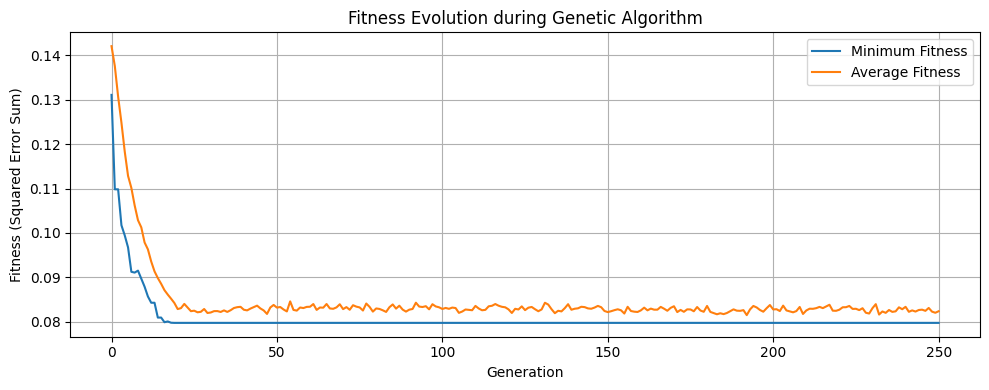

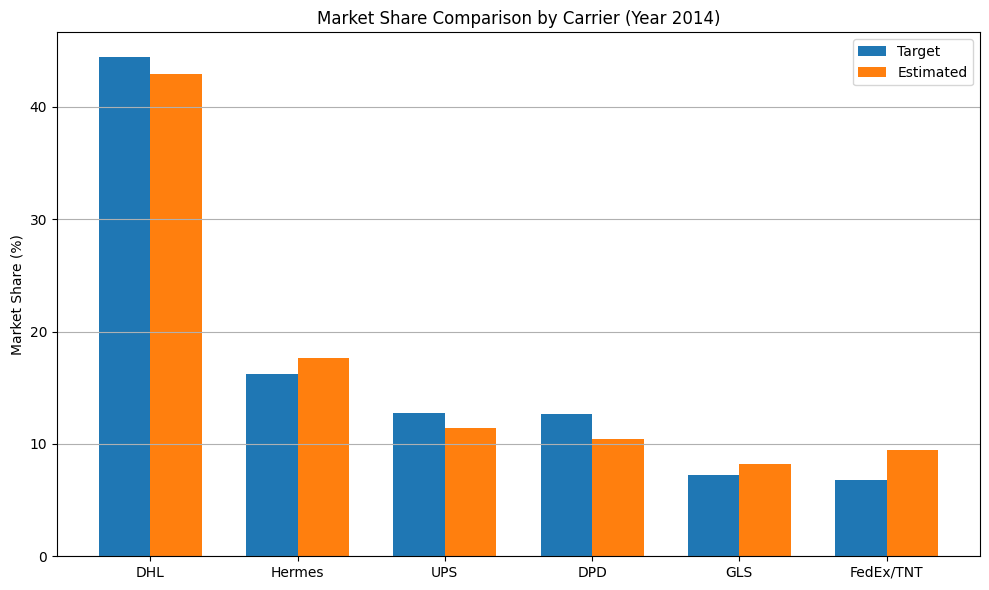

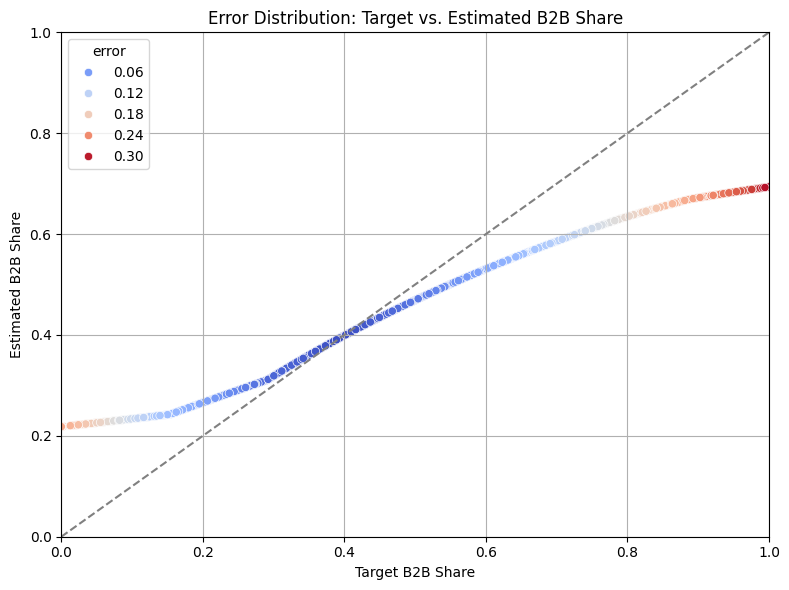


Weighted RMSE per cell: 0.1875
Estimated national B2B share (weighted): 0.3946
Target B2B share from input: 0.3900
Absolute deviation: 0.0046


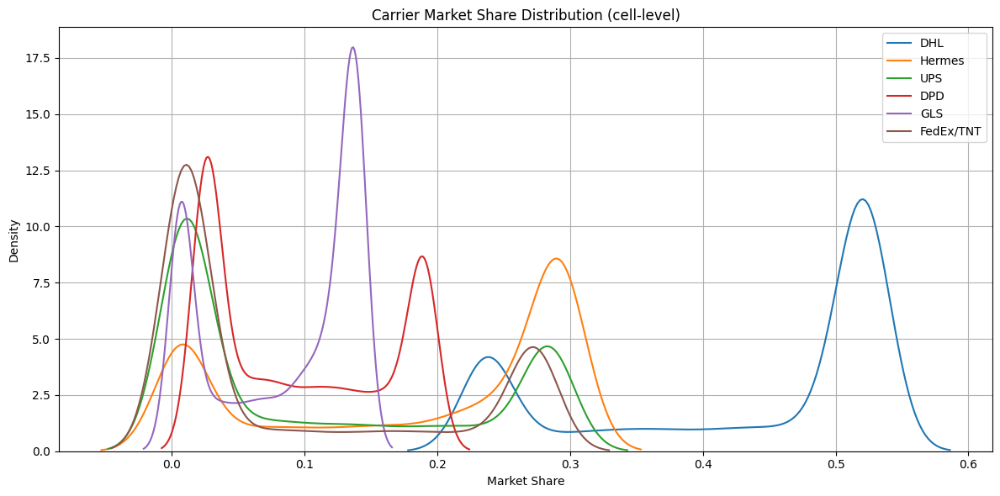

            mean    std  range
DHL        0.432  0.117  0.290
Hermes     0.185  0.118  0.287
UPS        0.108  0.115  0.275
DPD        0.097  0.067  0.164
GLS        0.086  0.055  0.131
FedEx/TNT  0.092  0.110  0.263


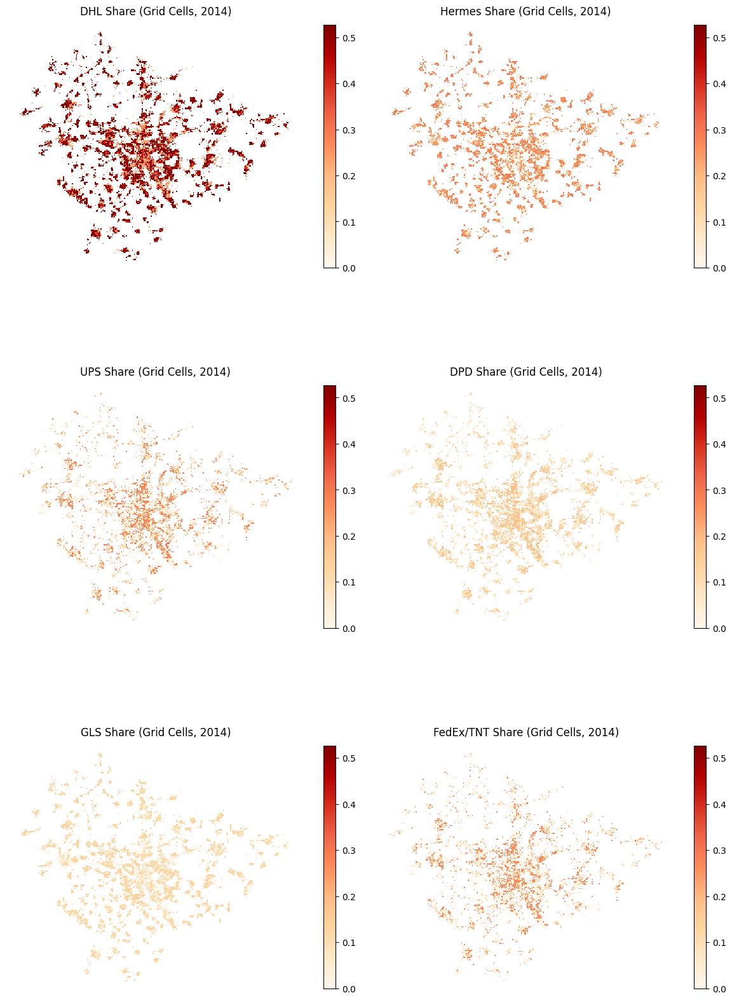

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

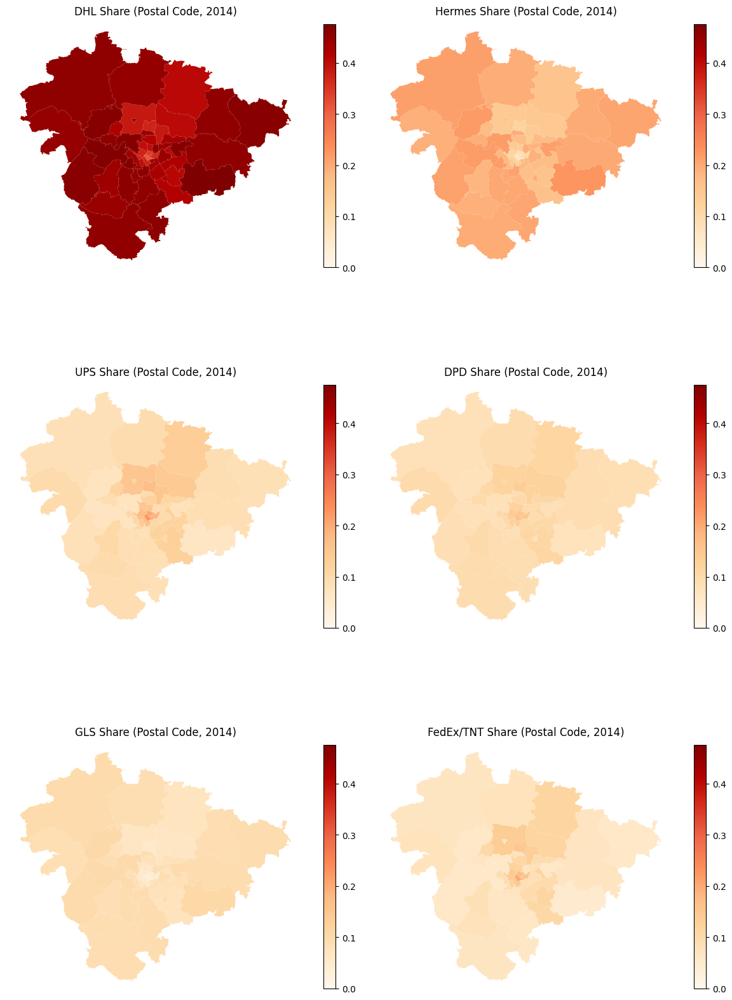

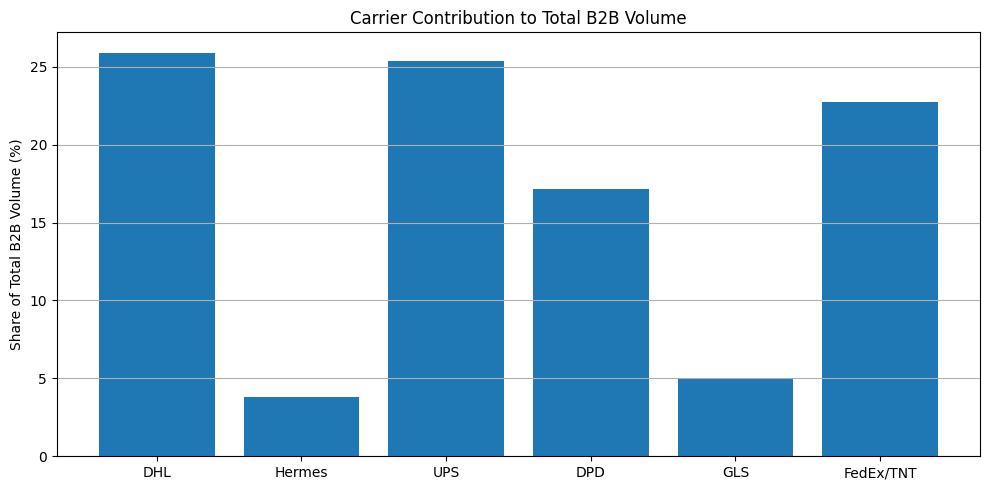

     Carrier  B2B Share (%)
0        DHL          25.91
2        UPS          25.40
5  FedEx/TNT          22.75
3        DPD          17.18
4        GLS           4.96
1     Hermes           3.80


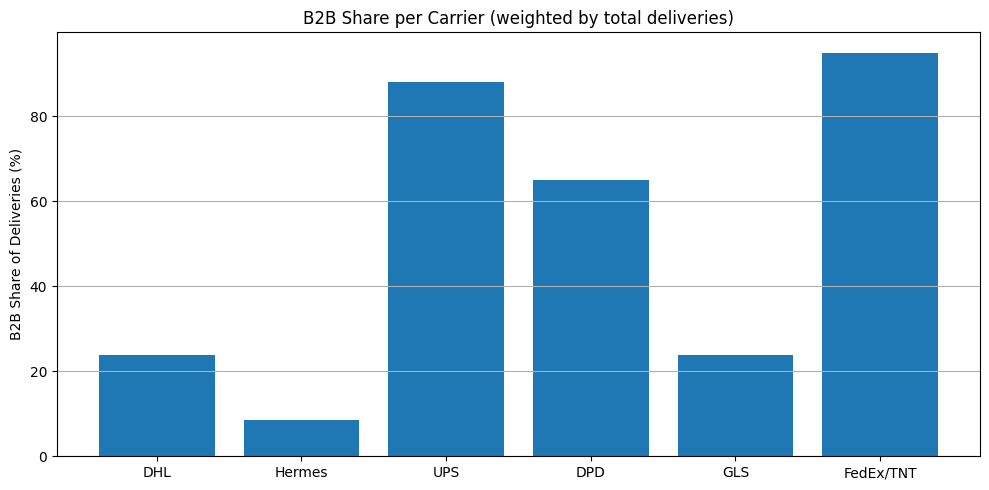

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          65.00
0        DHL          23.85
4        GLS          23.85
1     Hermes           8.50
✅ Optimized B2B shares for 2014:
  DHL: 0.238
  Hermes: 0.085
  UPS: 0.880
  DPD: 0.650
  GLS: 0.238
  FedEx/TNT: 0.950
✅ DONE — Year 2014
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2015 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


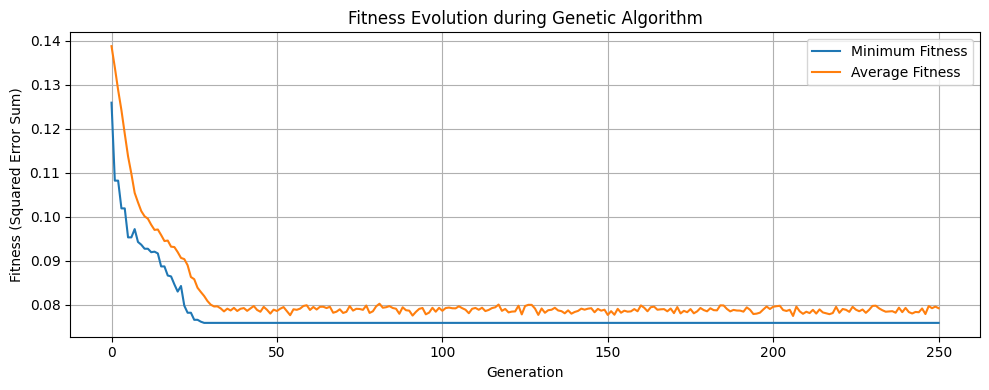

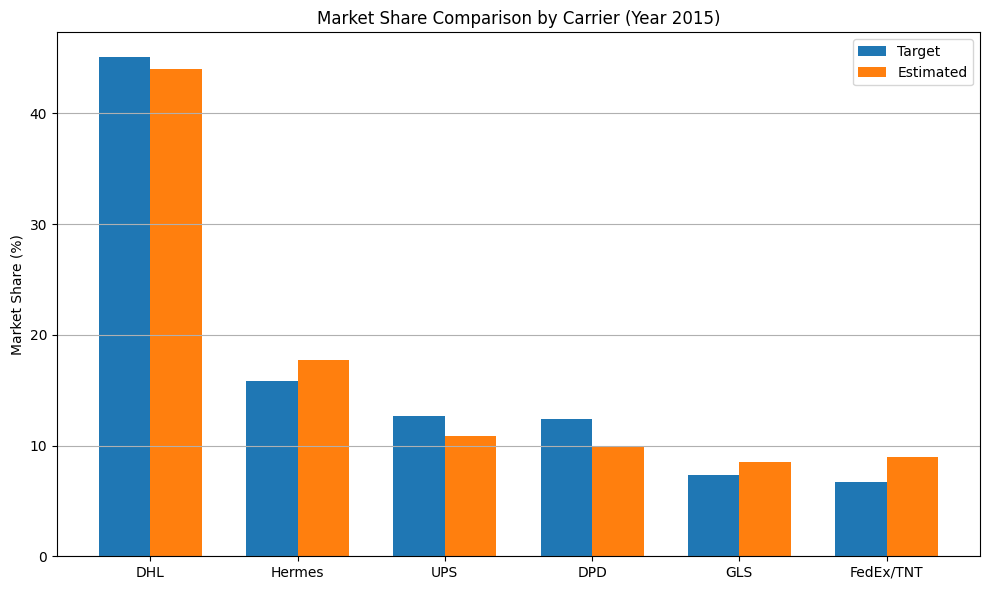

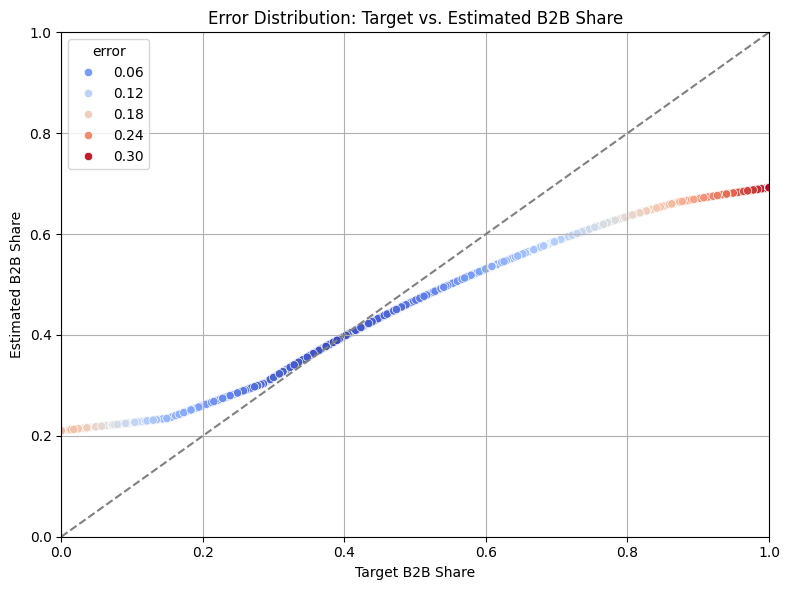


Weighted RMSE per cell: 0.1818
Estimated national B2B share (weighted): 0.3795
Target B2B share from input: 0.3700
Absolute deviation: 0.0095


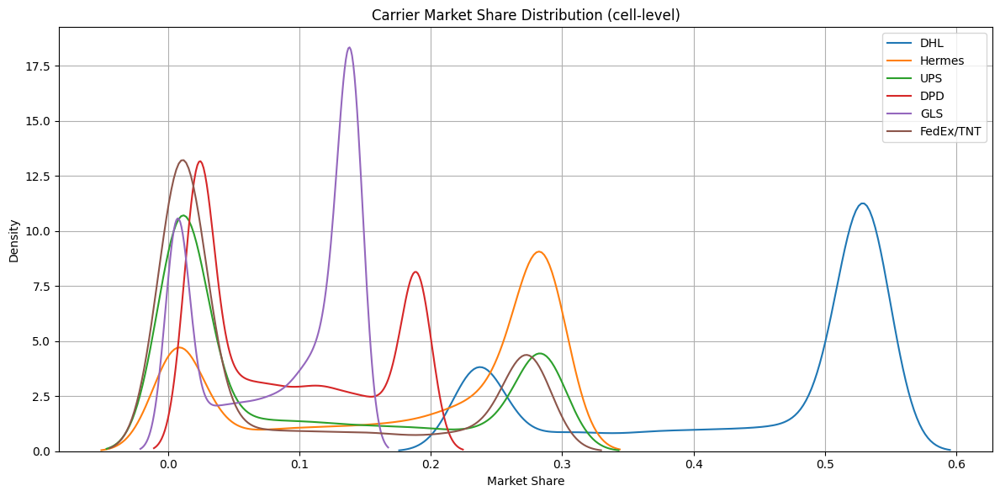

            mean    std  range
DHL        0.442  0.119  0.299
Hermes     0.183  0.114  0.280
UPS        0.104  0.113  0.275
DPD        0.093  0.067  0.167
GLS        0.089  0.055  0.133
FedEx/TNT  0.088  0.109  0.264


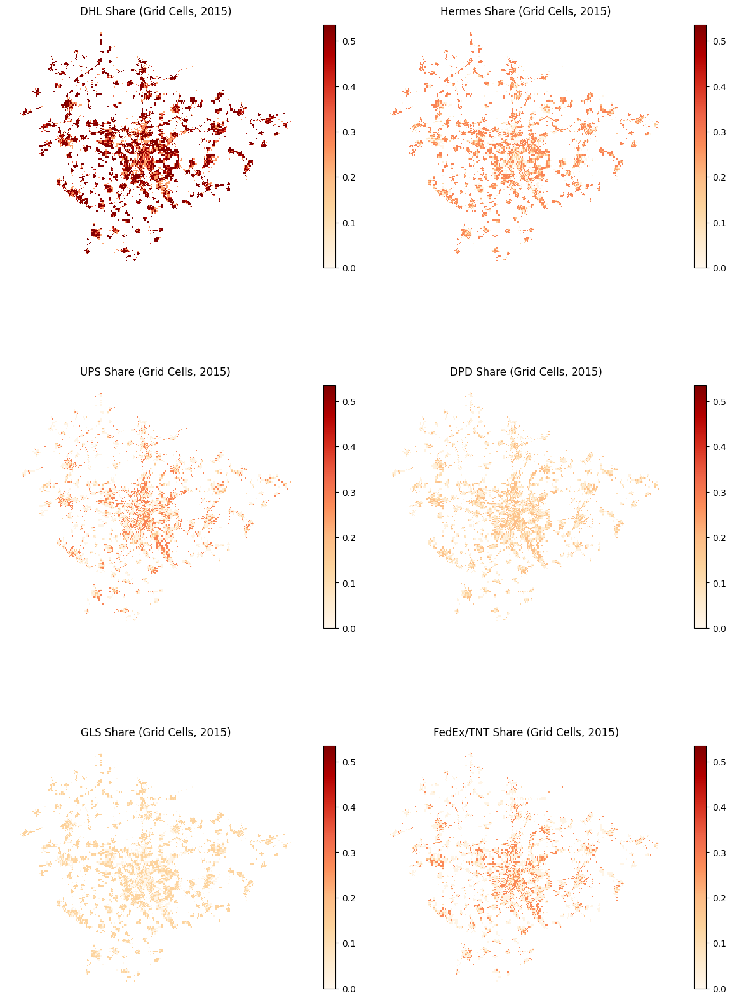

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

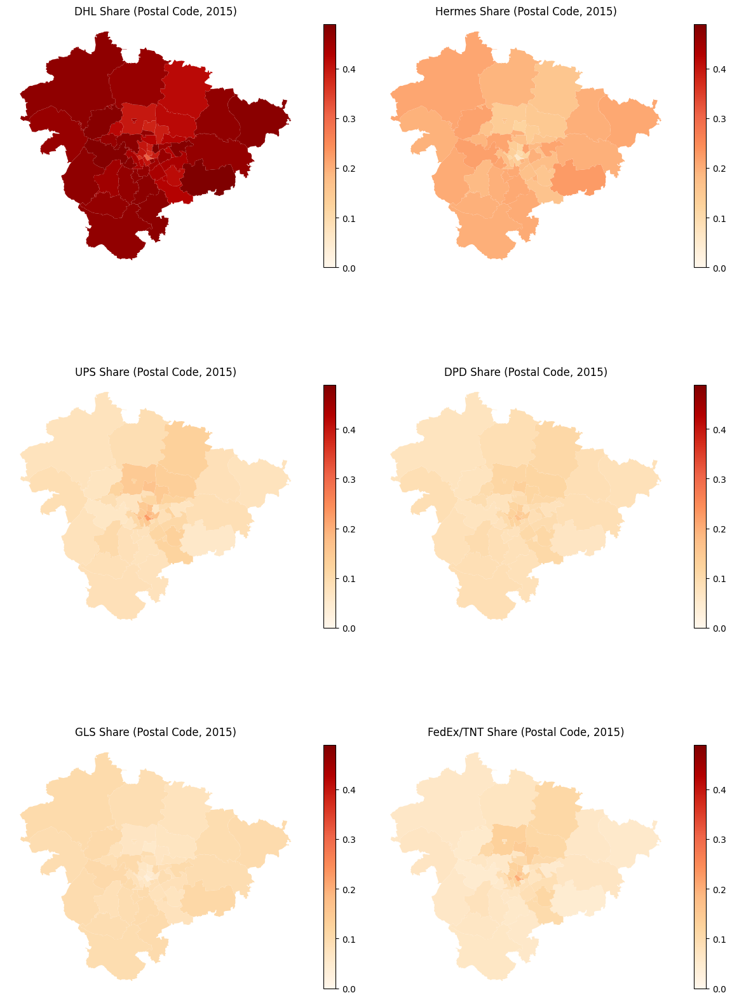

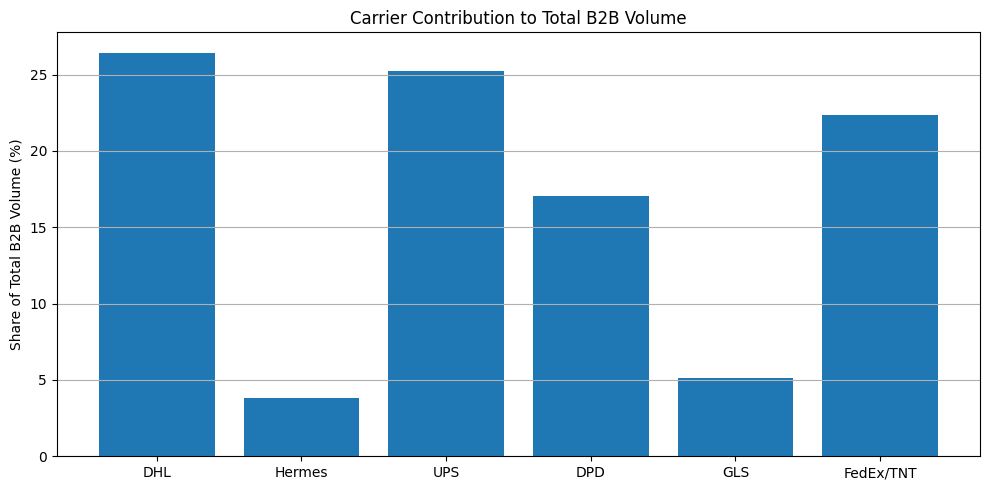

     Carrier  B2B Share (%)
0        DHL          26.44
2        UPS          25.20
5  FedEx/TNT          22.37
3        DPD          17.05
4        GLS           5.14
1     Hermes           3.80


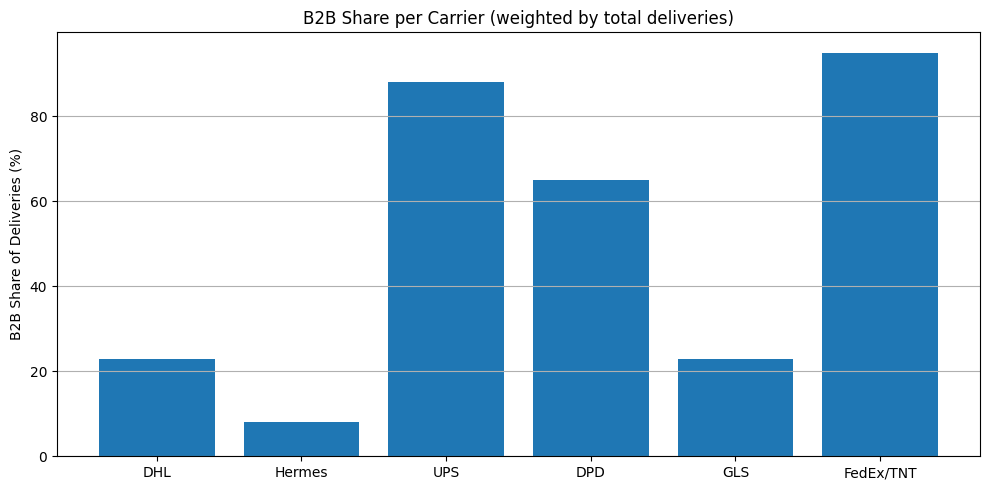

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          65.00
0        DHL          22.81
4        GLS          22.81
1     Hermes           8.15
✅ Optimized B2B shares for 2015:
  DHL: 0.228
  Hermes: 0.082
  UPS: 0.880
  DPD: 0.650
  GLS: 0.228
  FedEx/TNT: 0.950
✅ DONE — Year 2015
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2016 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


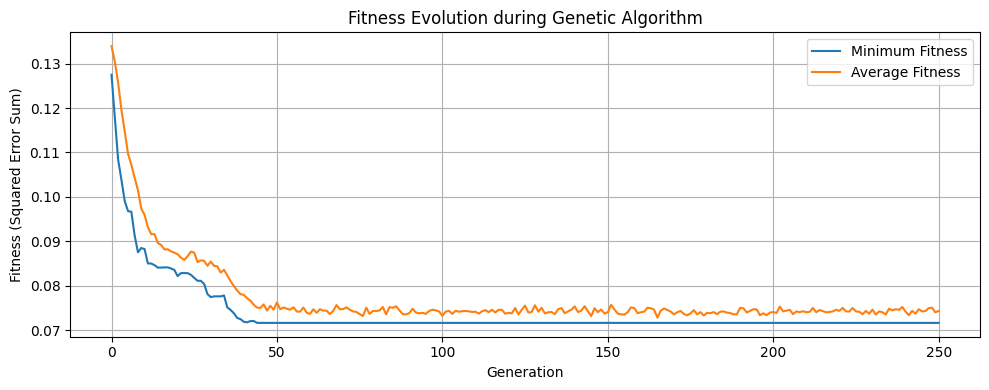

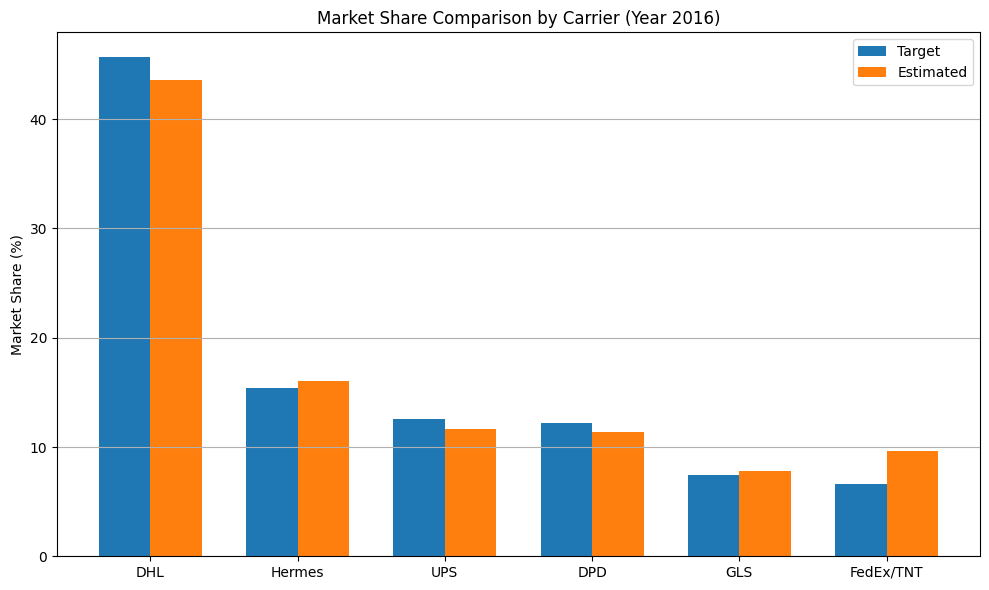

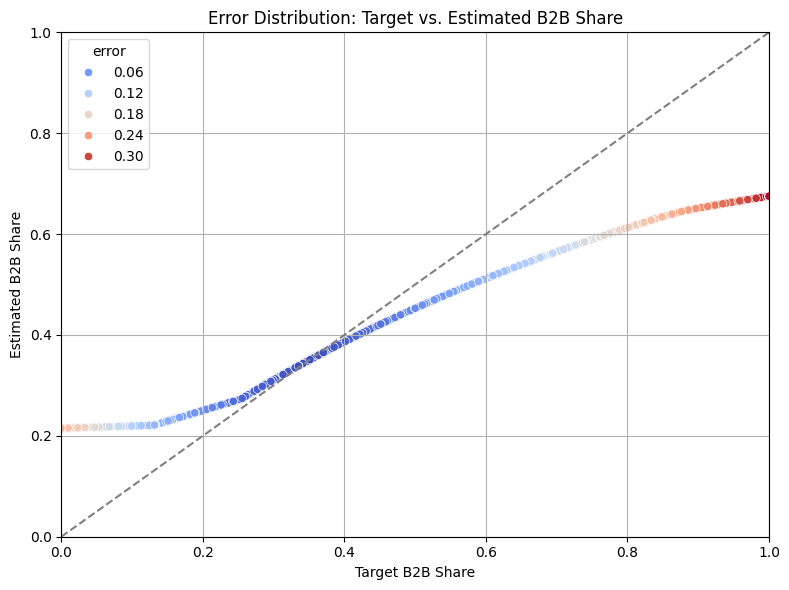


Weighted RMSE per cell: 0.1847
Estimated national B2B share (weighted): 0.3617
Target B2B share from input: 0.3500
Absolute deviation: 0.0117


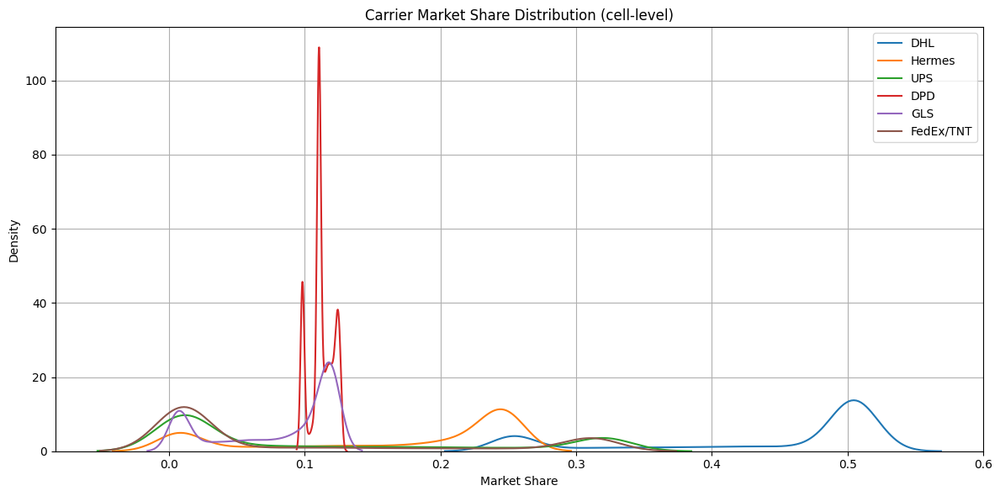

            mean    std  range
DHL        0.436  0.099  0.266
Hermes     0.165  0.096  0.241
UPS        0.112  0.124  0.312
DPD        0.112  0.008  0.028
GLS        0.080  0.045  0.113
FedEx/TNT  0.095  0.121  0.303


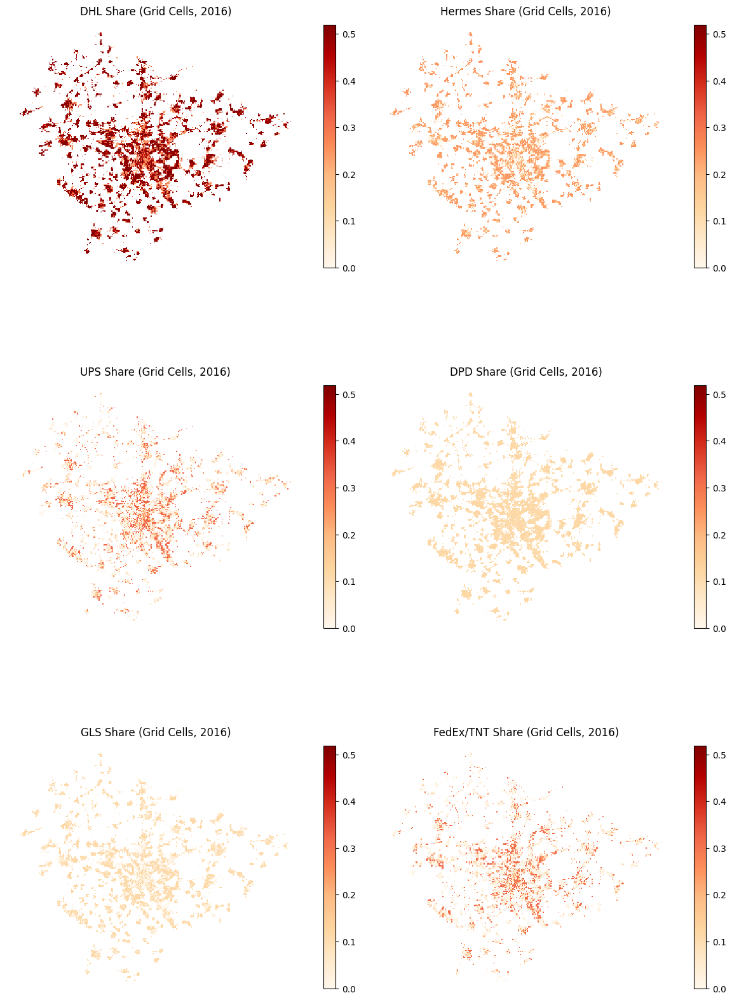

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

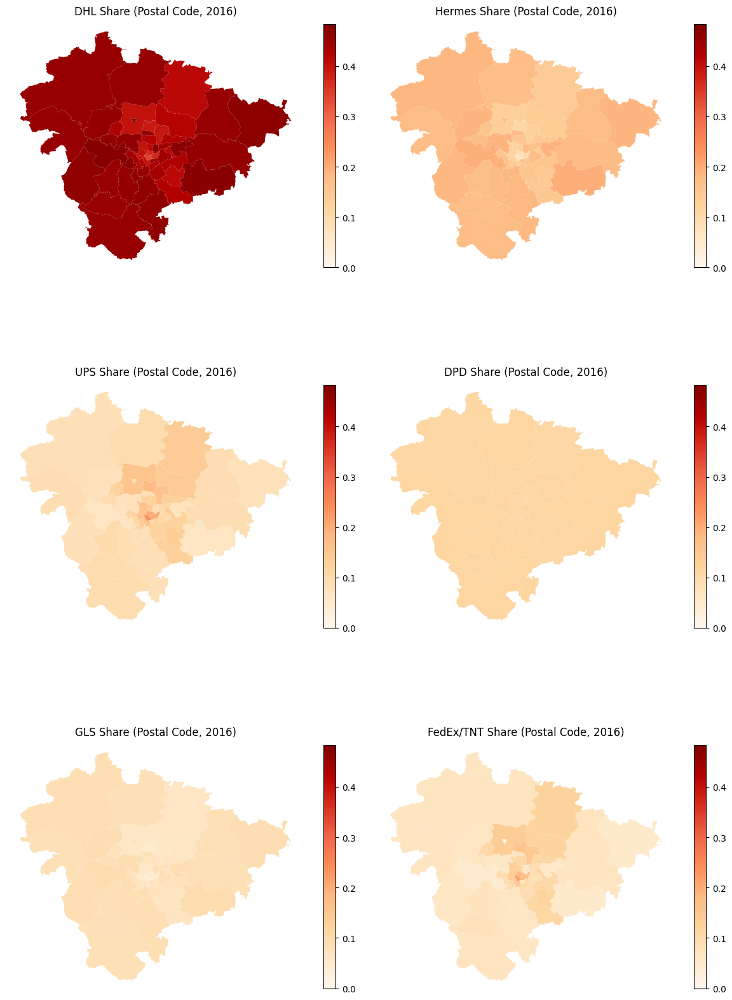

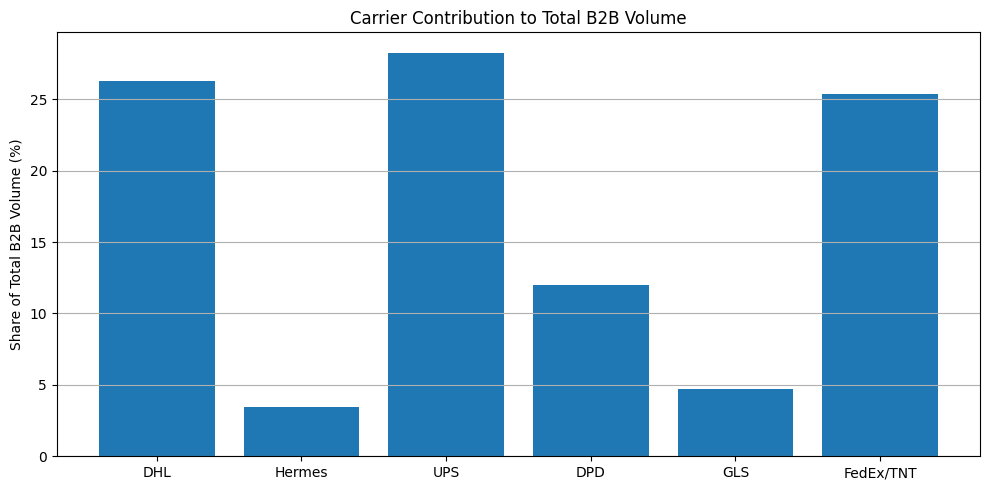

     Carrier  B2B Share (%)
2        UPS          28.27
0        DHL          26.24
5  FedEx/TNT          25.40
3        DPD          11.97
4        GLS           4.68
1     Hermes           3.44


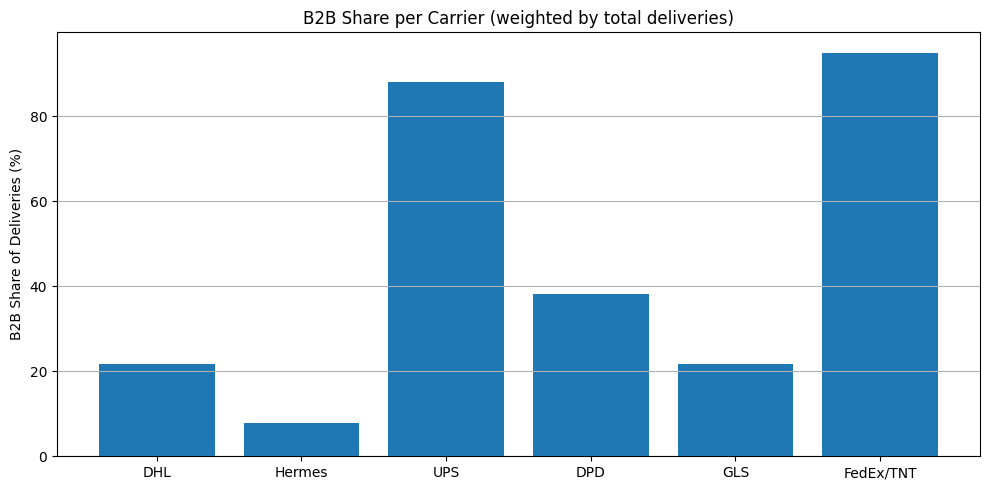

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          38.11
0        DHL          21.78
4        GLS          21.78
1     Hermes           7.78
✅ Optimized B2B shares for 2016:
  DHL: 0.218
  Hermes: 0.078
  UPS: 0.880
  DPD: 0.381
  GLS: 0.218
  FedEx/TNT: 0.950
✅ DONE — Year 2016
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2017 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


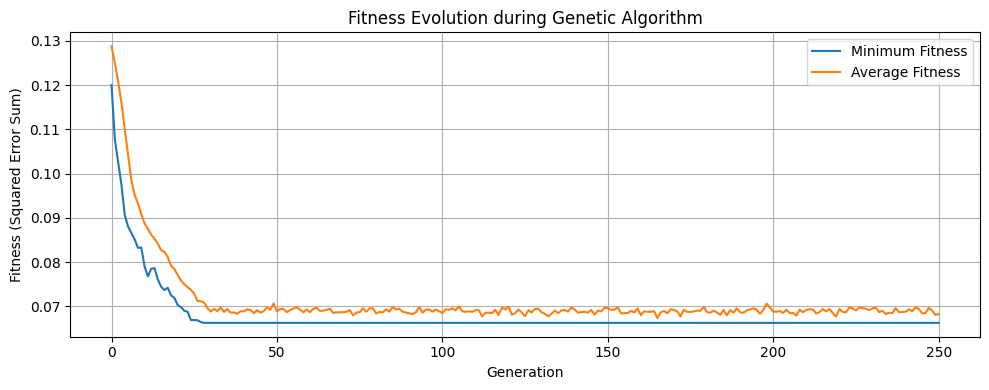

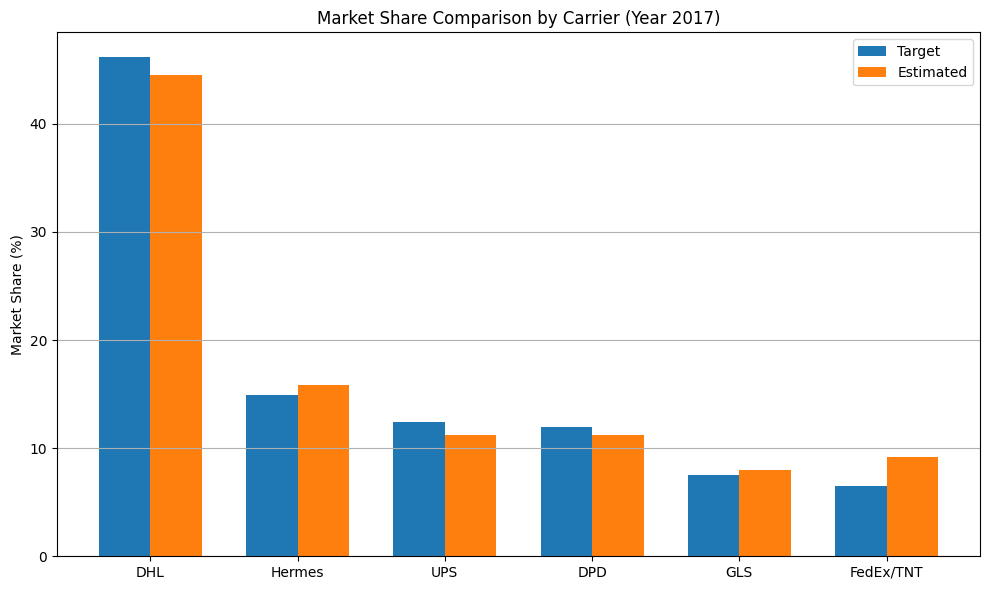

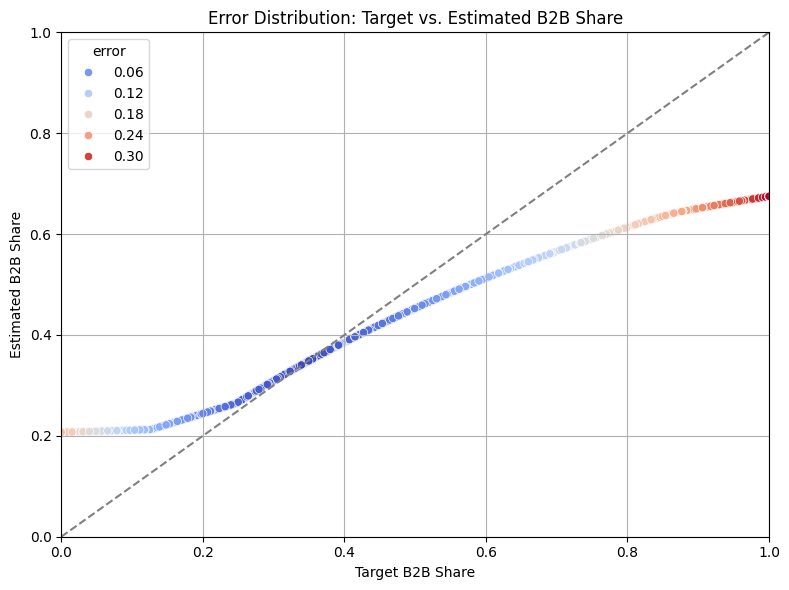


Weighted RMSE per cell: 0.1764
Estimated national B2B share (weighted): 0.3471
Target B2B share from input: 0.3300
Absolute deviation: 0.0171


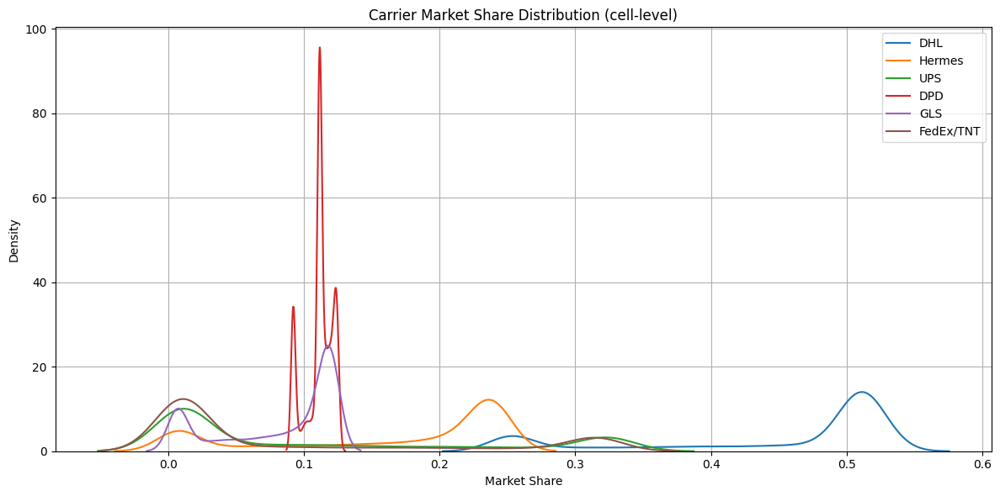

            mean    std  range
DHL        0.445  0.099  0.273
Hermes     0.163  0.091  0.233
UPS        0.108  0.122  0.315
DPD        0.111  0.010  0.033
GLS        0.082  0.044  0.113
FedEx/TNT  0.091  0.118  0.307


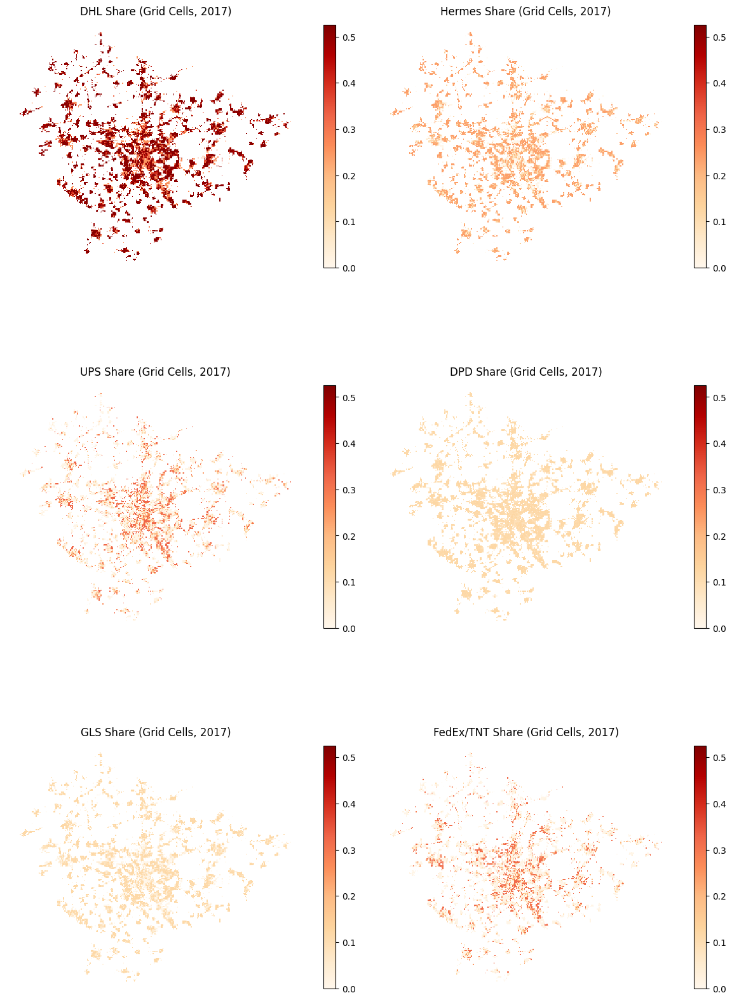

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

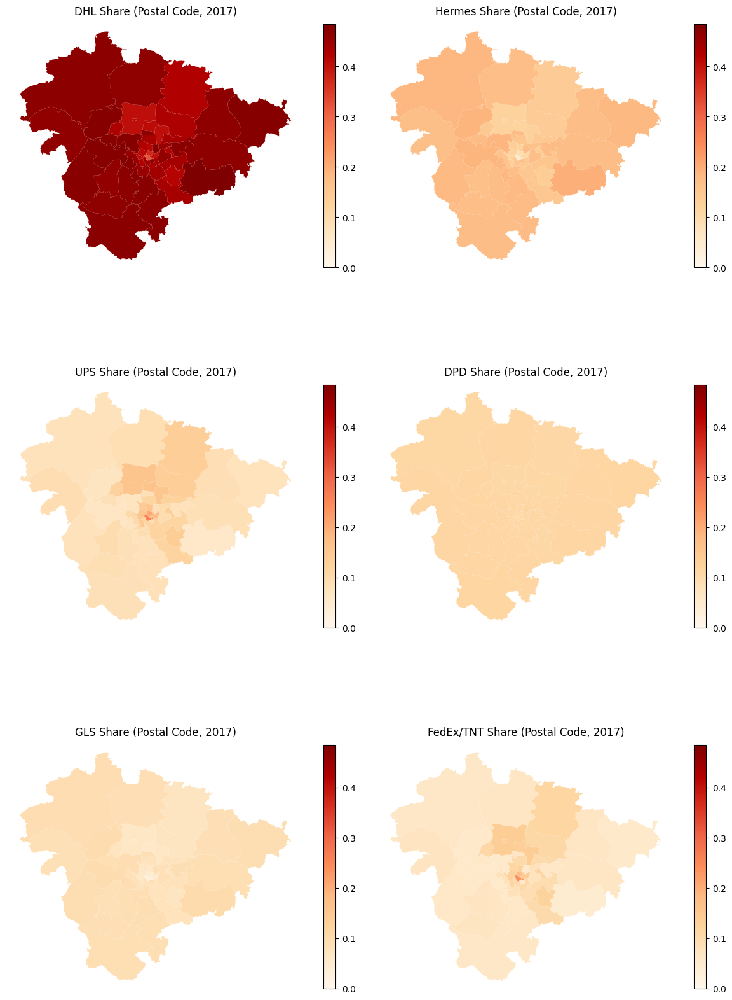

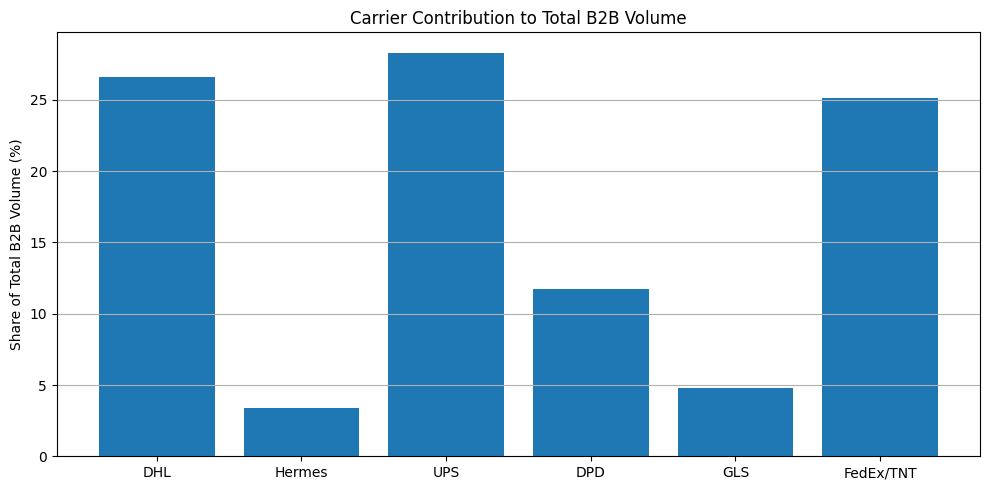

     Carrier  B2B Share (%)
2        UPS          28.33
0        DHL          26.61
5  FedEx/TNT          25.14
3        DPD          11.76
4        GLS           4.78
1     Hermes           3.39


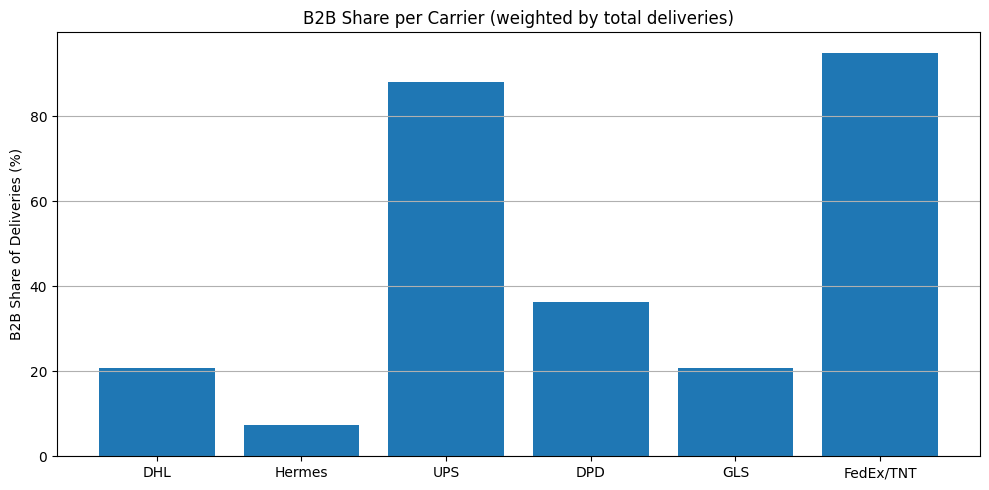

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          36.30
0        DHL          20.74
4        GLS          20.74
1     Hermes           7.41
✅ Optimized B2B shares for 2017:
  DHL: 0.207
  Hermes: 0.074
  UPS: 0.880
  DPD: 0.363
  GLS: 0.207
  FedEx/TNT: 0.950
✅ DONE — Year 2017
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2018 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


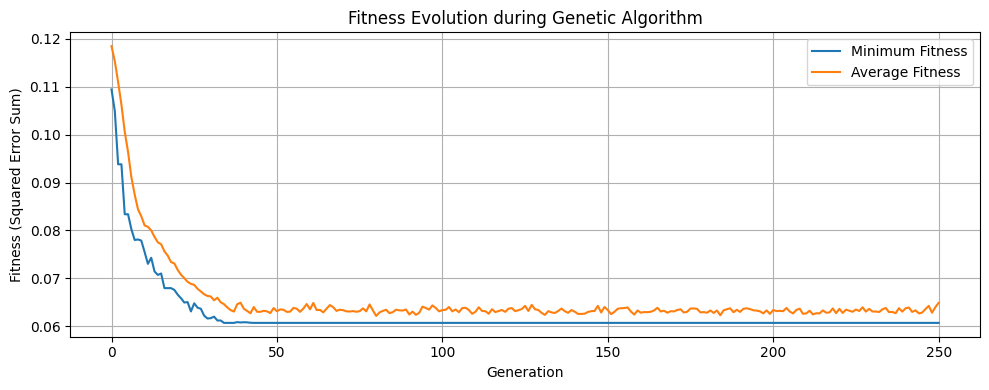

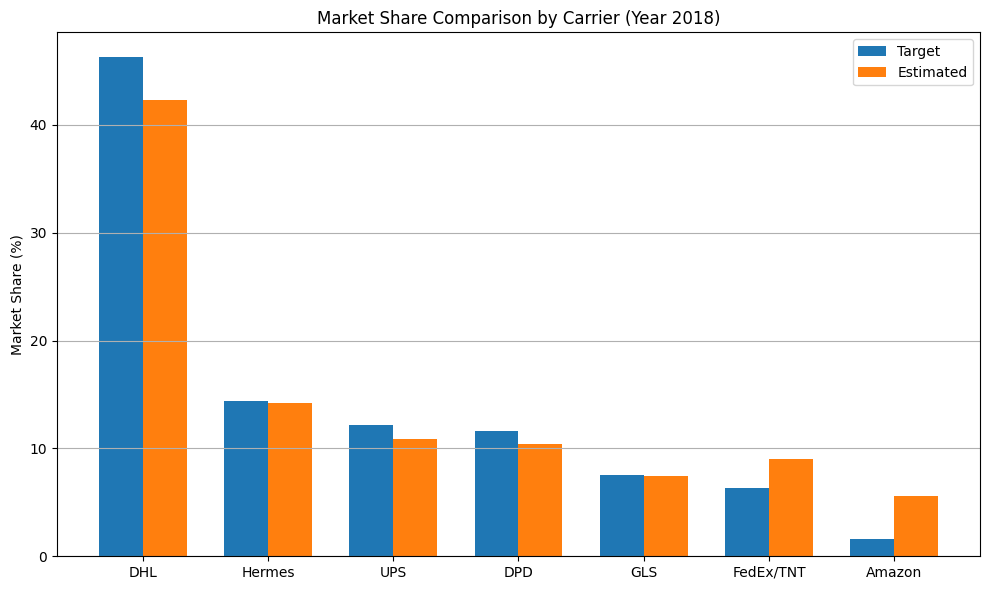

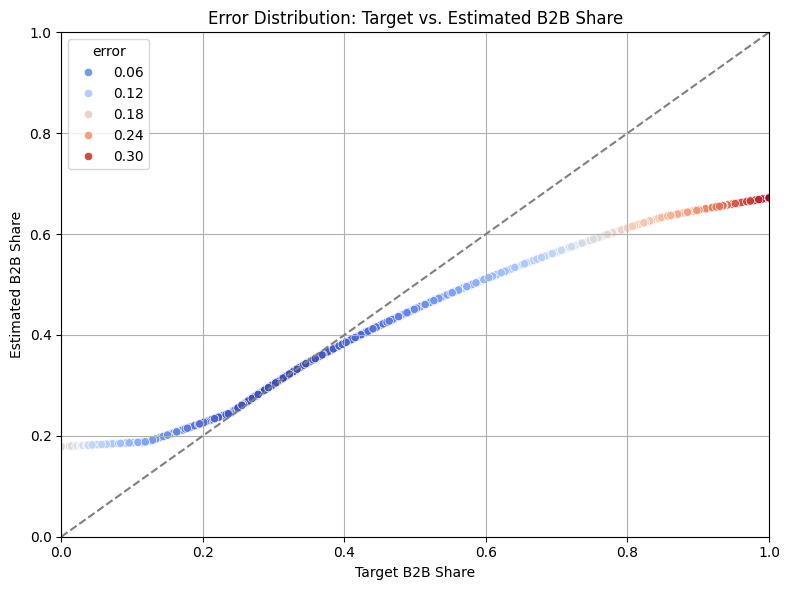


Weighted RMSE per cell: 0.1623
Estimated national B2B share (weighted): 0.3263
Target B2B share from input: 0.3200
Absolute deviation: 0.0063


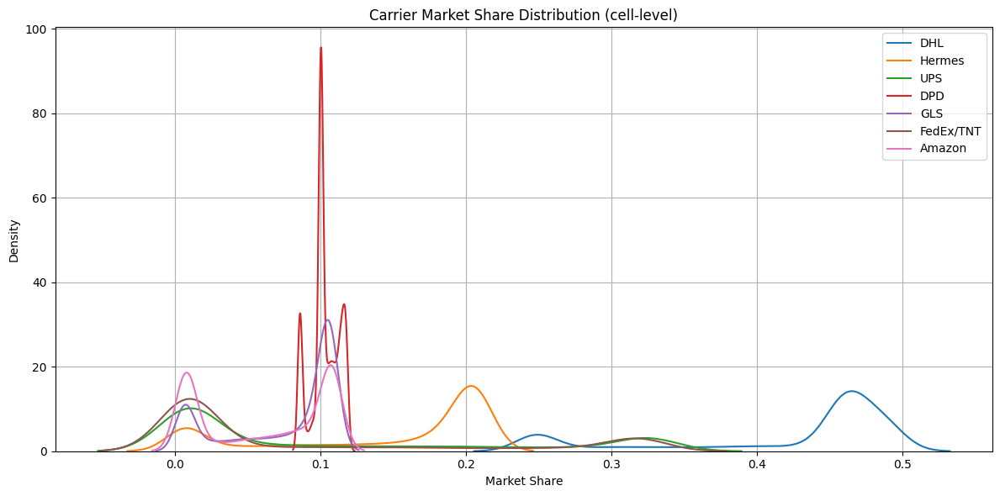

            mean    std  range
DHL        0.419  0.083  0.243
Hermes     0.145  0.078  0.200
UPS        0.106  0.123  0.318
DPD        0.103  0.009  0.033
GLS        0.076  0.039  0.100
FedEx/TNT  0.090  0.119  0.310
Amazon     0.061  0.044  0.101


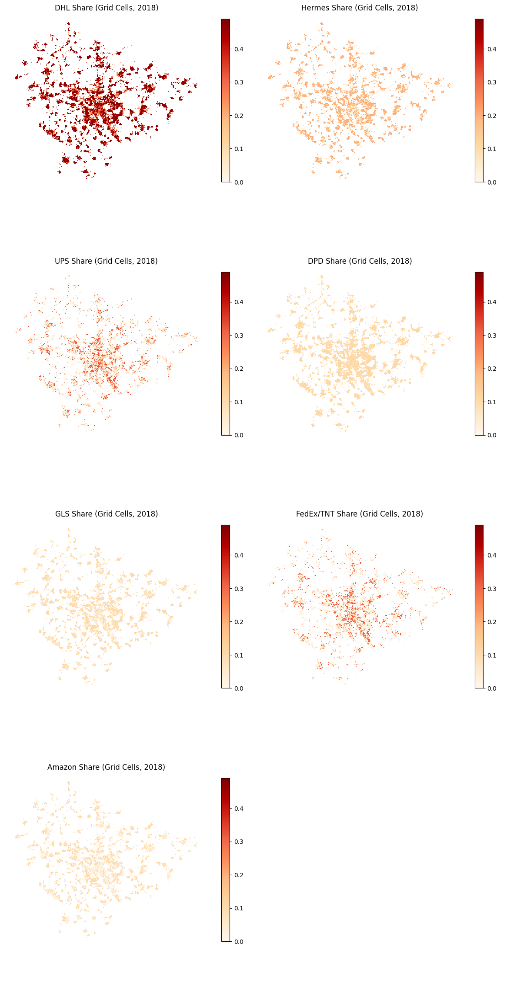

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

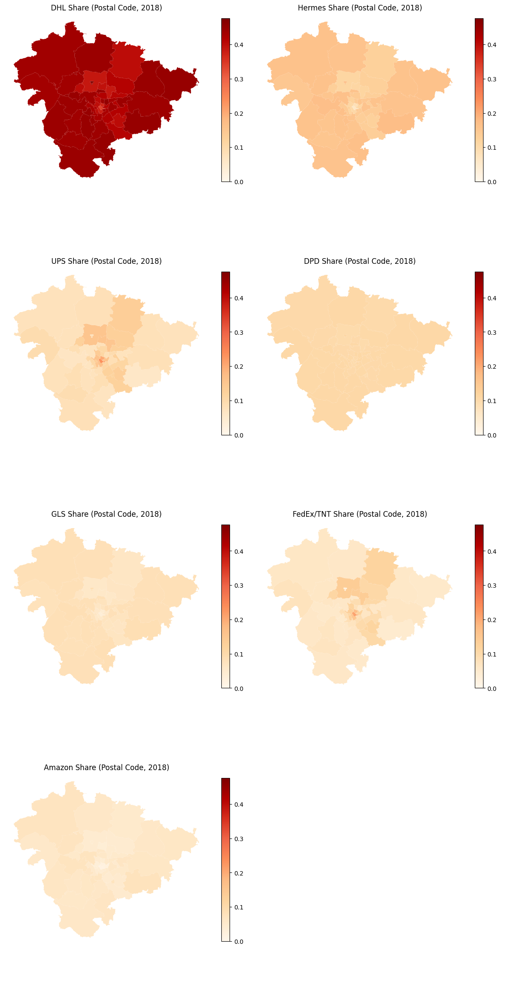

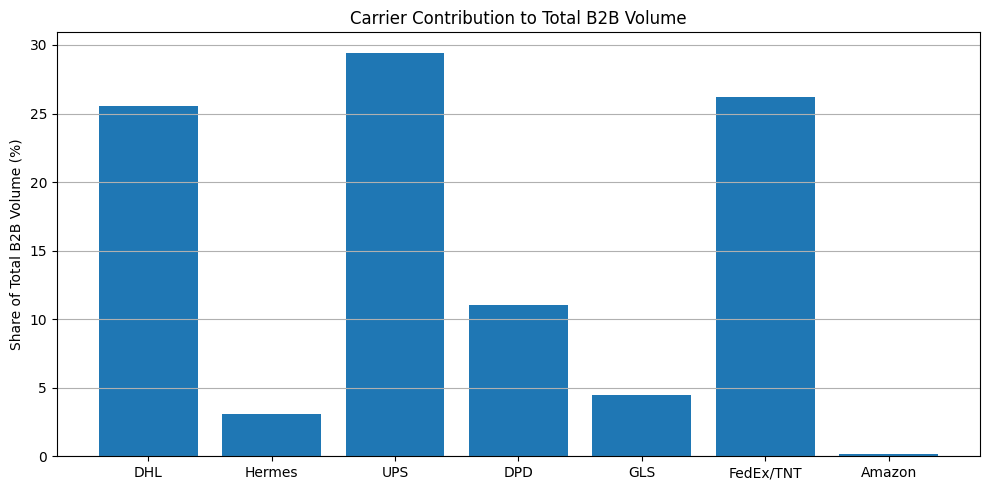

     Carrier  B2B Share (%)
2        UPS          29.45
5  FedEx/TNT          26.22
0        DHL          25.54
3        DPD          11.05
4        GLS           4.50
1     Hermes           3.07
6     Amazon           0.17


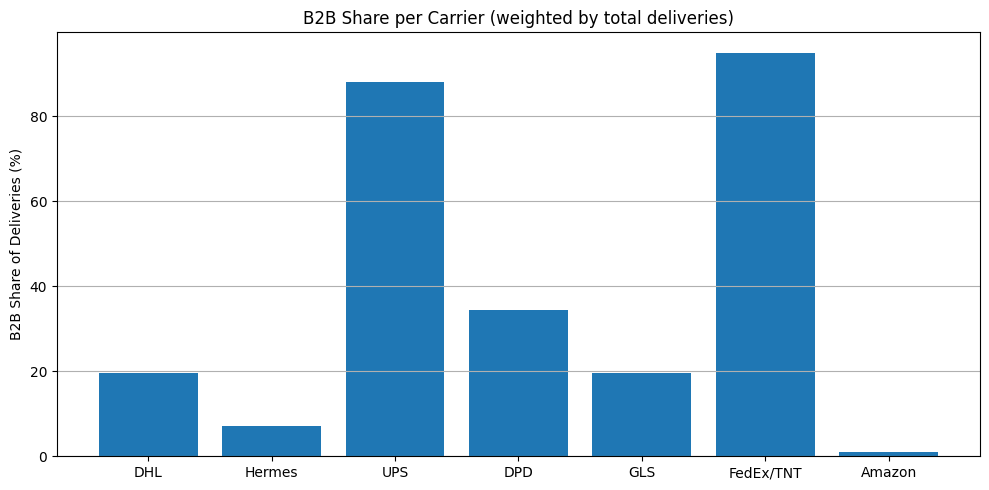

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          34.48
0        DHL          19.70
4        GLS          19.70
1     Hermes           7.04
6     Amazon           1.00
✅ Optimized B2B shares for 2018:
  DHL: 0.197
  Hermes: 0.070
  UPS: 0.880
  DPD: 0.345
  GLS: 0.197
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2018
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2019 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


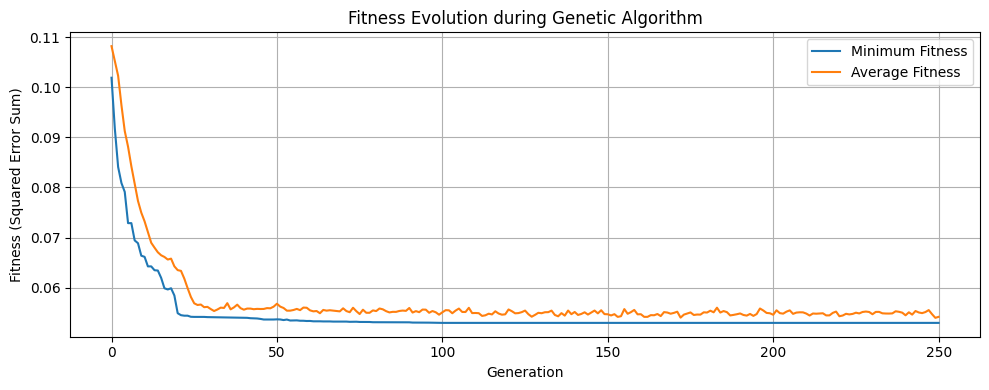

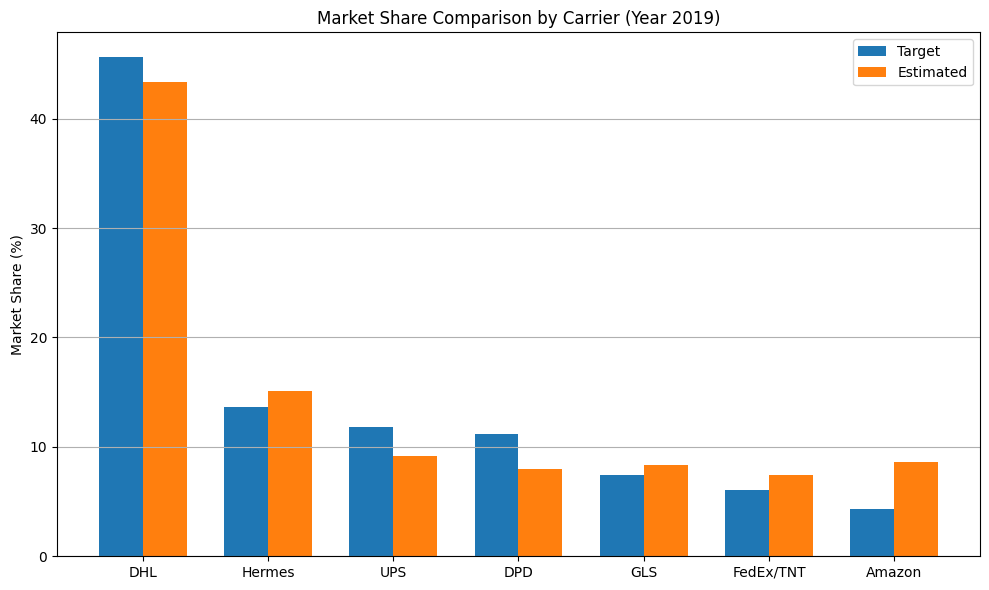

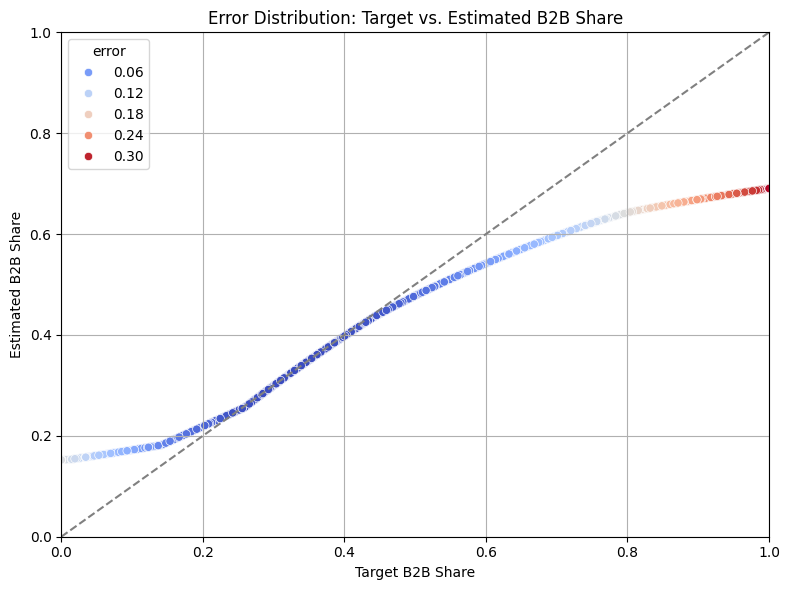


Weighted RMSE per cell: 0.1403
Estimated national B2B share (weighted): 0.3107
Target B2B share from input: 0.3000
Absolute deviation: 0.0107


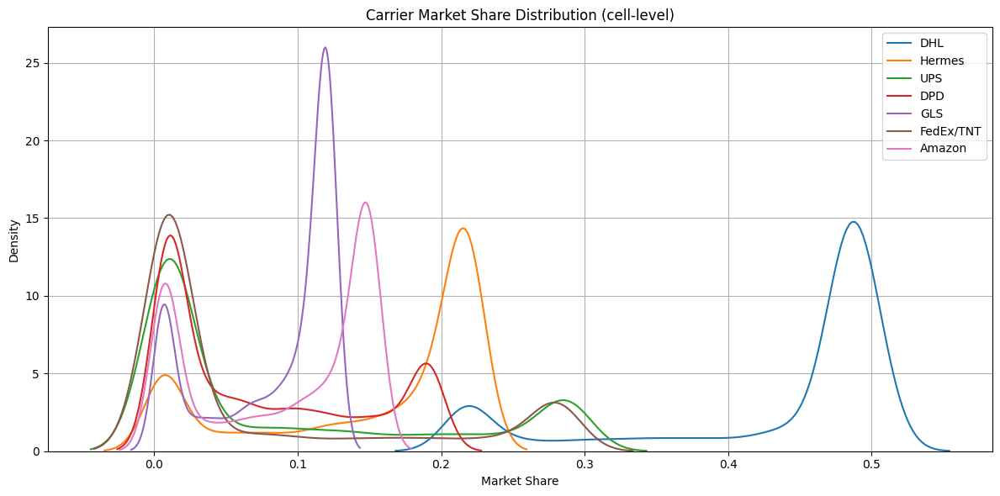

            mean    std  range
DHL        0.431  0.097  0.288
Hermes     0.154  0.081  0.213
UPS        0.089  0.106  0.280
DPD        0.075  0.070  0.183
GLS        0.085  0.044  0.115
FedEx/TNT  0.074  0.101  0.273
Amazon     0.091  0.060  0.143


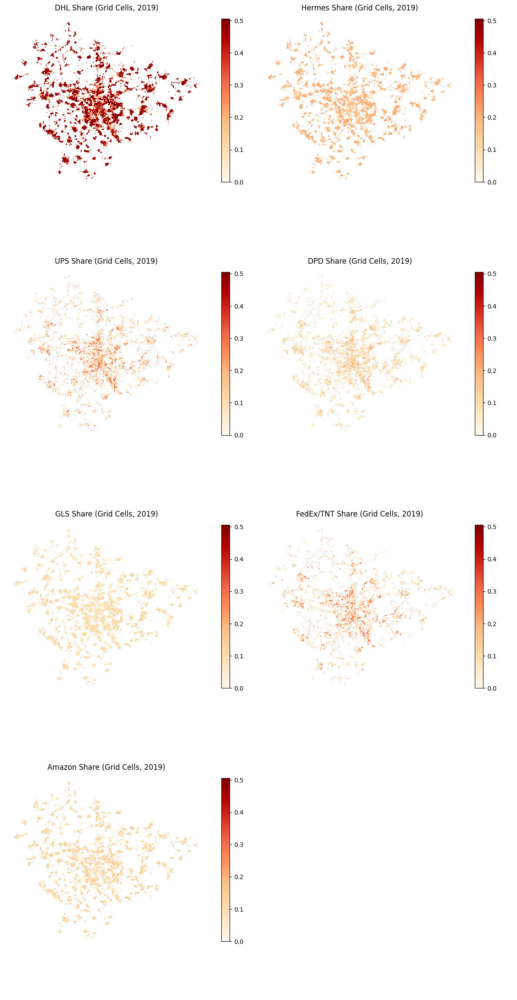

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

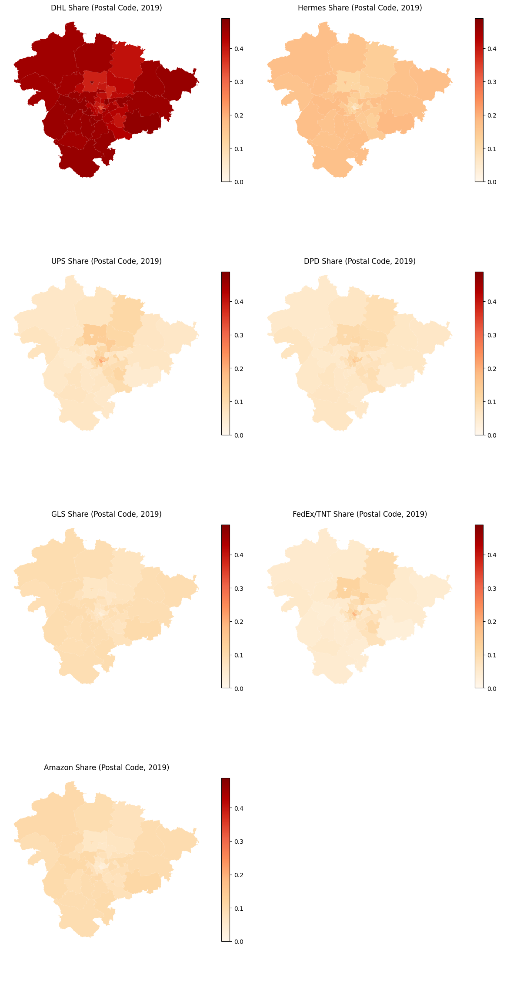

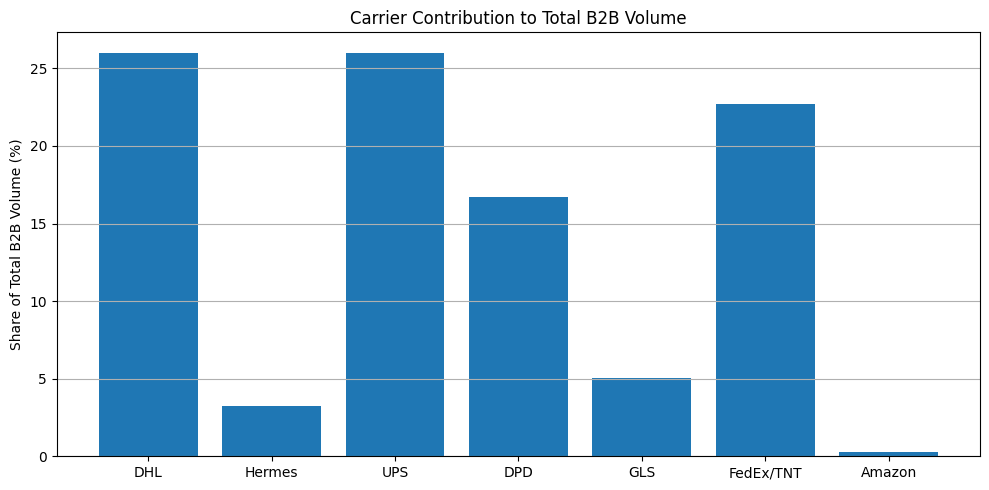

     Carrier  B2B Share (%)
2        UPS          26.02
0        DHL          26.02
5  FedEx/TNT          22.69
3        DPD          16.73
4        GLS           5.02
1     Hermes           3.24
6     Amazon           0.28


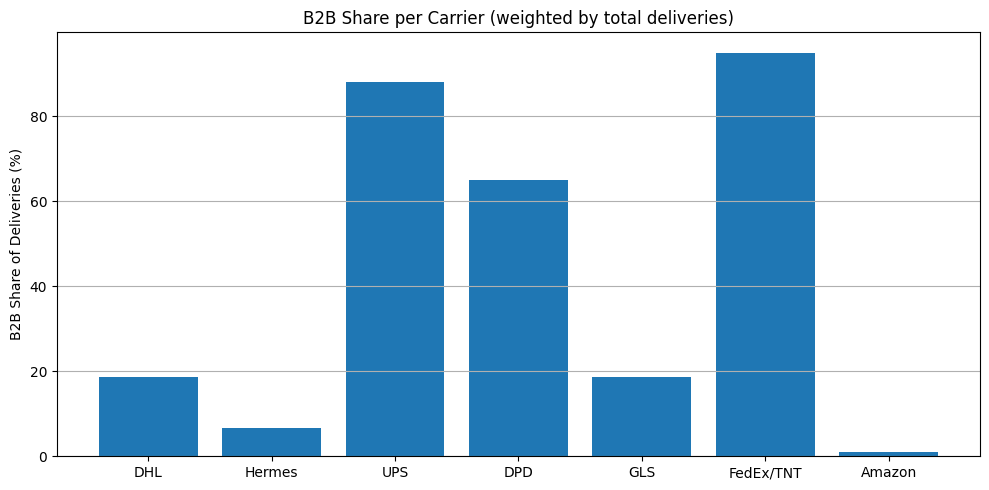

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          65.00
0        DHL          18.67
4        GLS          18.67
1     Hermes           6.67
6     Amazon           1.00
✅ Optimized B2B shares for 2019:
  DHL: 0.187
  Hermes: 0.067
  UPS: 0.880
  DPD: 0.650
  GLS: 0.187
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2019
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2020 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


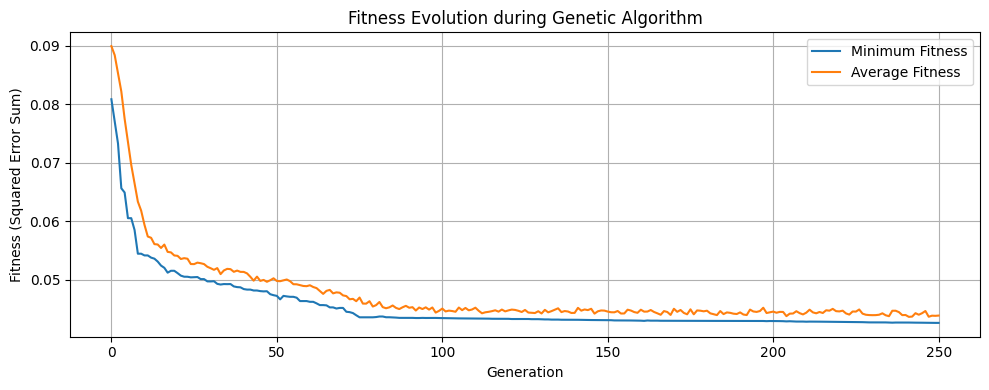

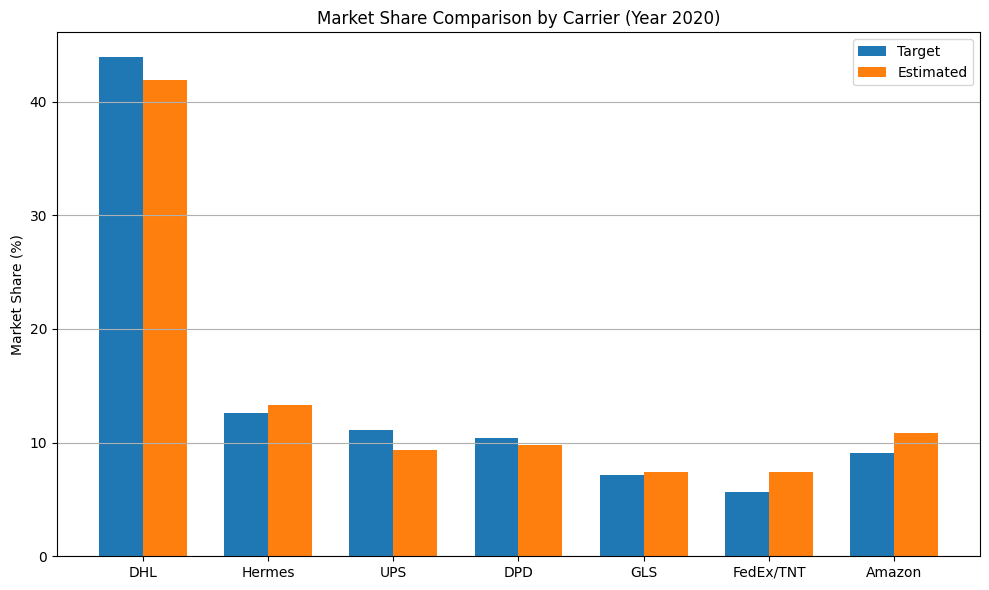

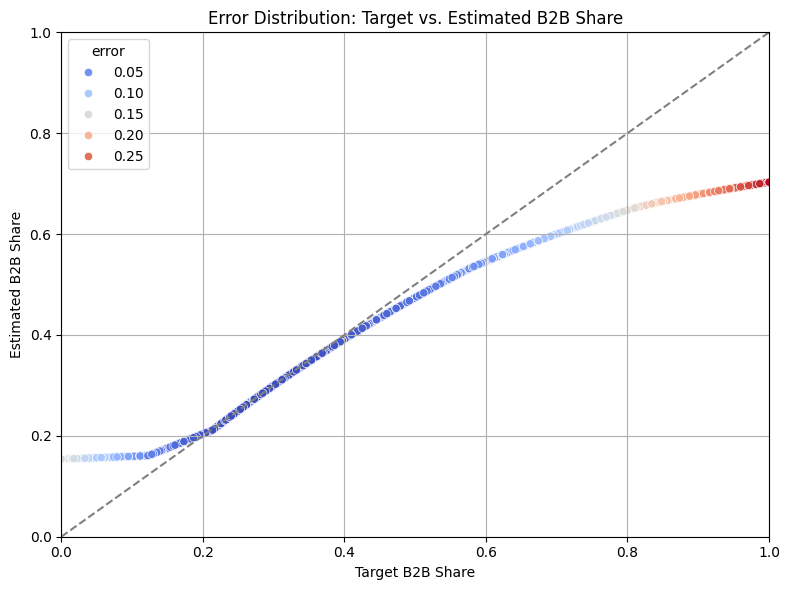


Weighted RMSE per cell: 0.1200
Estimated national B2B share (weighted): 0.2791
Target B2B share from input: 0.2500
Absolute deviation: 0.0291


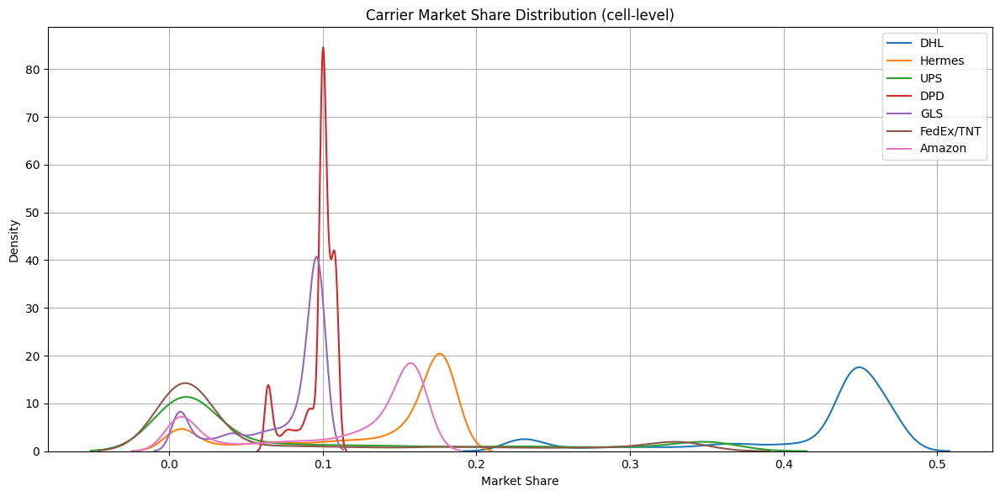

            mean    std  range
DHL        0.414  0.071  0.245
Hermes     0.134  0.061  0.173
UPS        0.093  0.120  0.345
DPD        0.097  0.012  0.045
GLS        0.074  0.032  0.091
FedEx/TNT  0.076  0.110  0.326
Amazon     0.111  0.059  0.154


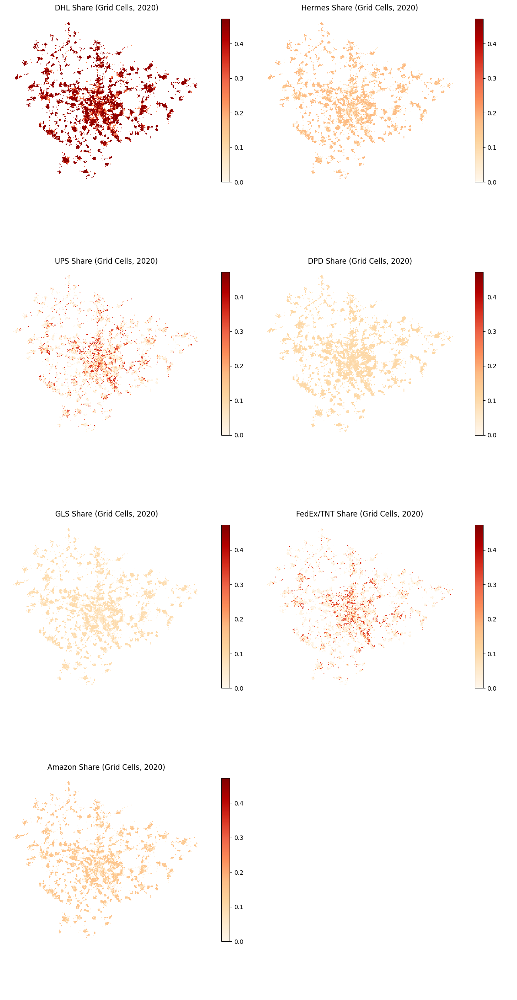

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

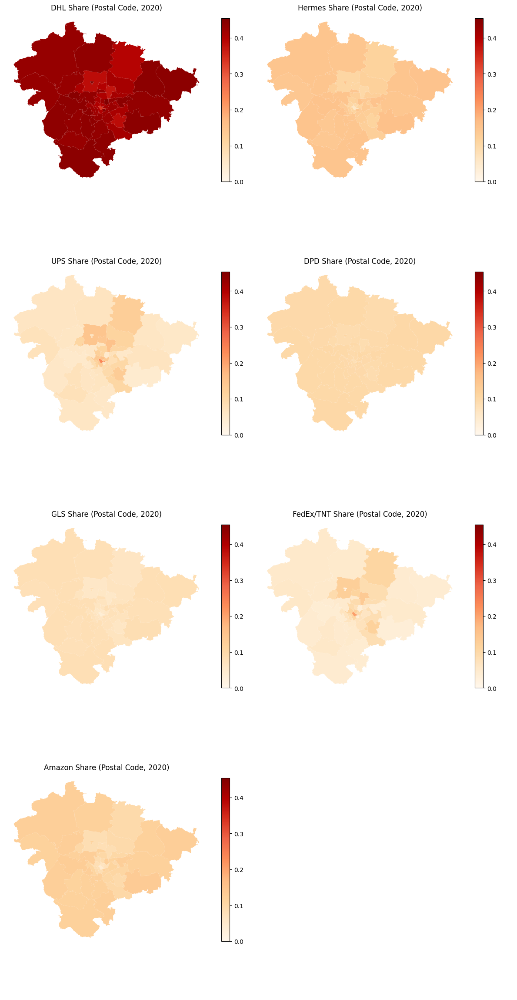

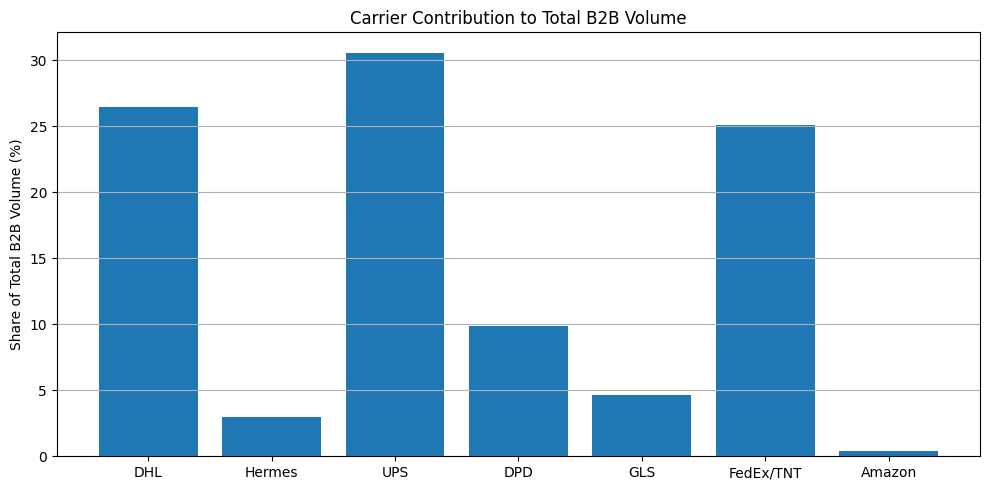

     Carrier  B2B Share (%)
2        UPS          30.57
0        DHL          26.44
5  FedEx/TNT          25.11
3        DPD           9.85
4        GLS           4.64
1     Hermes           3.00
6     Amazon           0.39


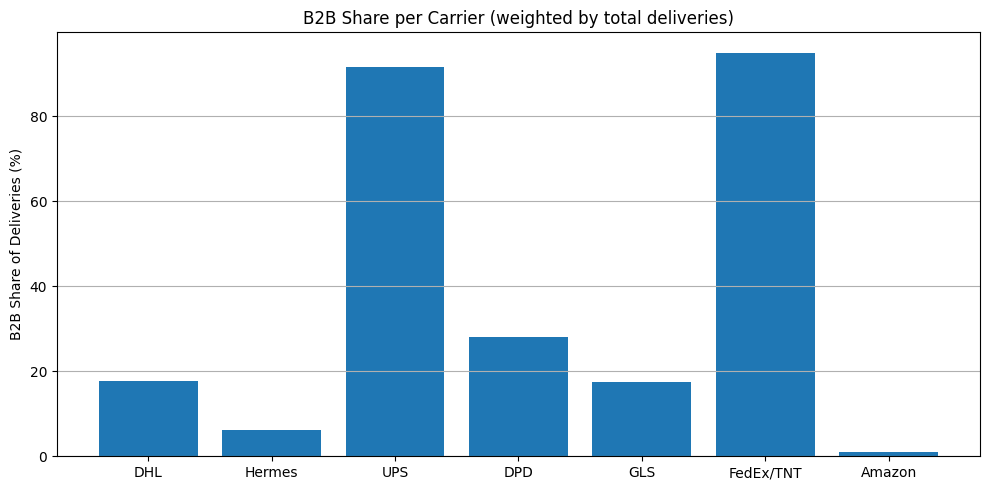

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          91.61
3        DPD          28.00
0        DHL          17.62
4        GLS          17.44
1     Hermes           6.28
6     Amazon           1.00
✅ Optimized B2B shares for 2020:
  DHL: 0.176
  Hermes: 0.063
  UPS: 0.916
  DPD: 0.280
  GLS: 0.174
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2020
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2021 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


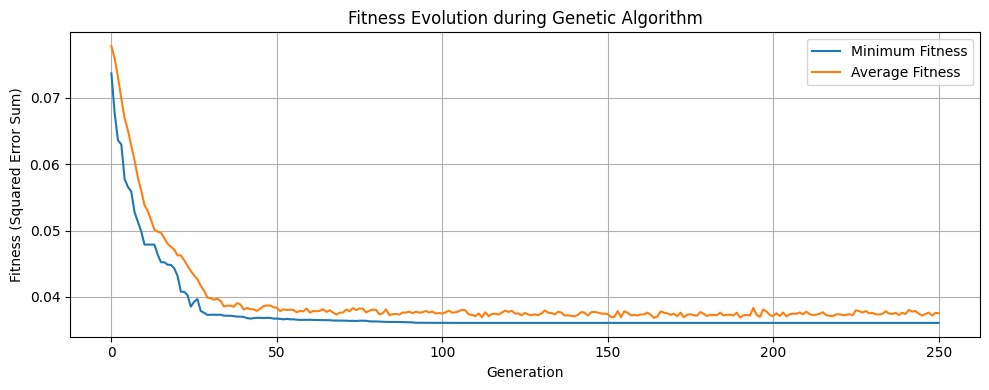

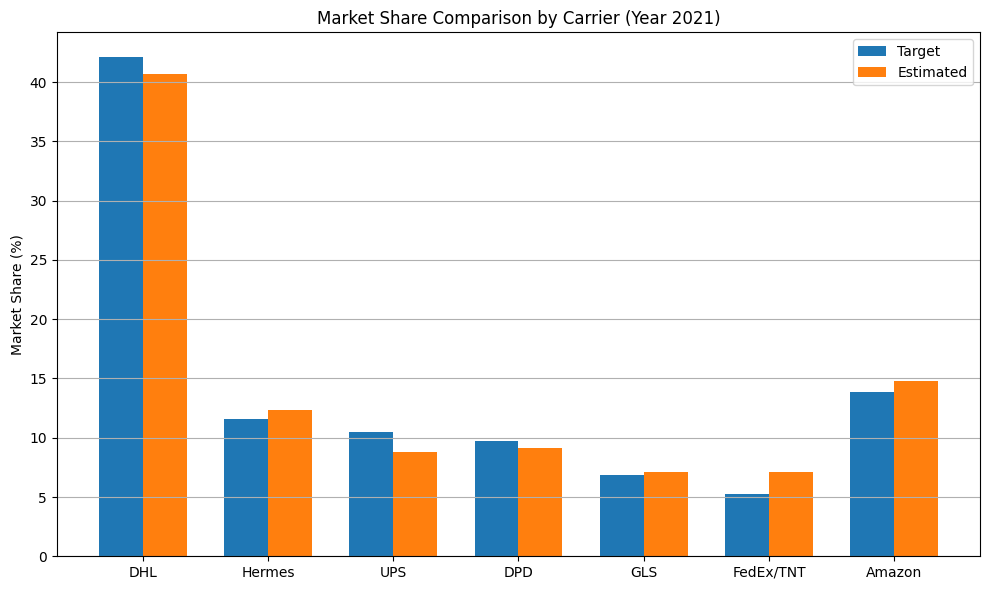

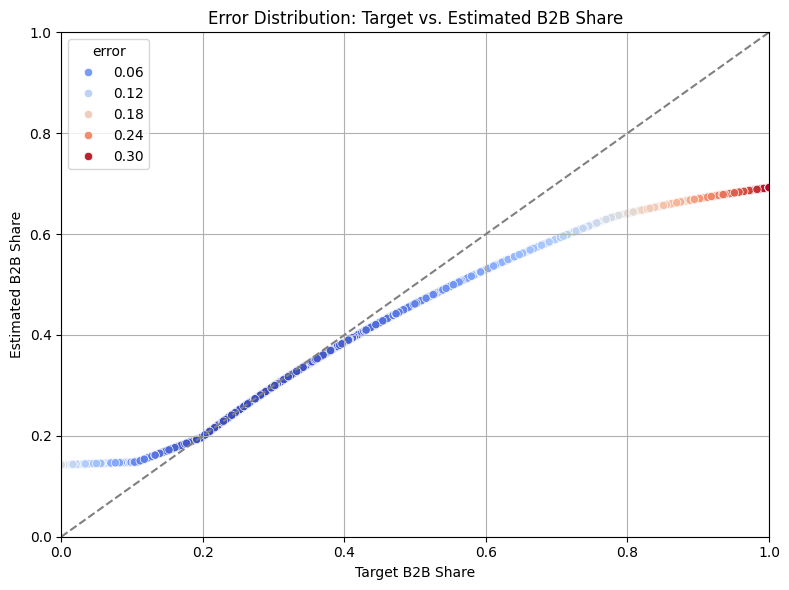


Weighted RMSE per cell: 0.1083
Estimated national B2B share (weighted): 0.2596
Target B2B share from input: 0.2300
Absolute deviation: 0.0296


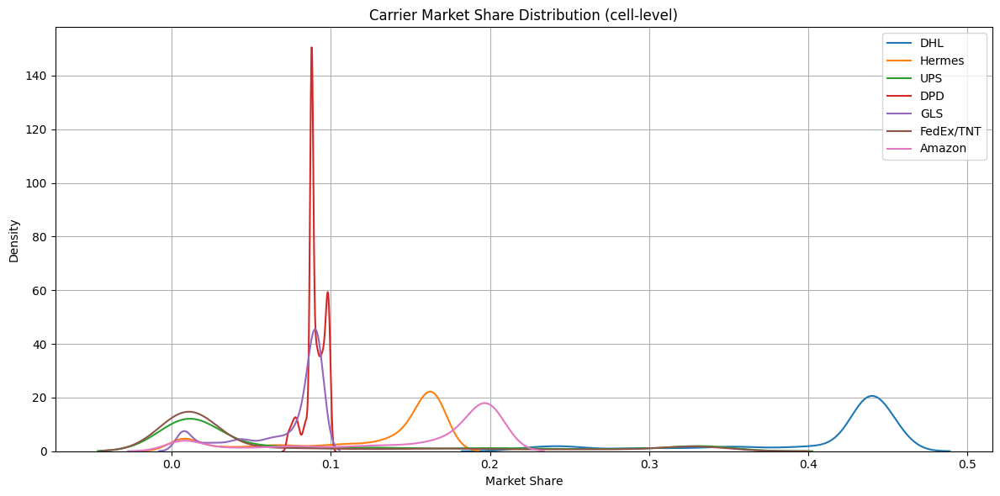

            mean    std  range
DHL        0.404  0.066  0.240
Hermes     0.124  0.055  0.159
UPS        0.088  0.112  0.337
DPD        0.090  0.006  0.027
GLS        0.071  0.028  0.085
FedEx/TNT  0.074  0.108  0.337
Amazon     0.149  0.067  0.194


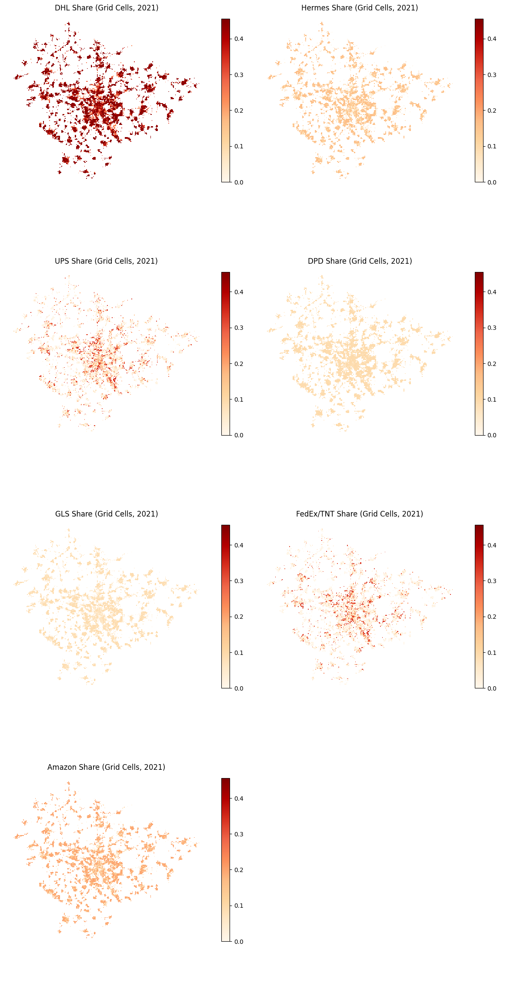

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

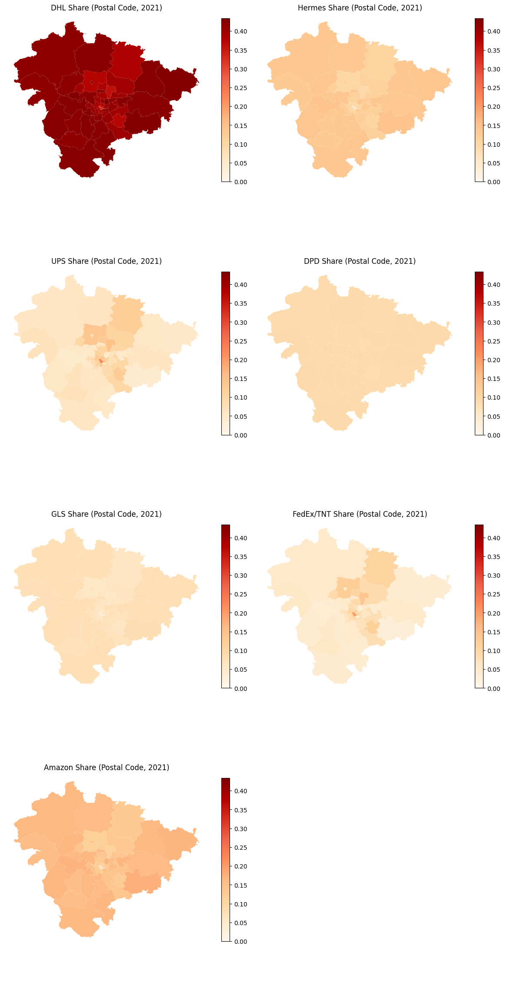

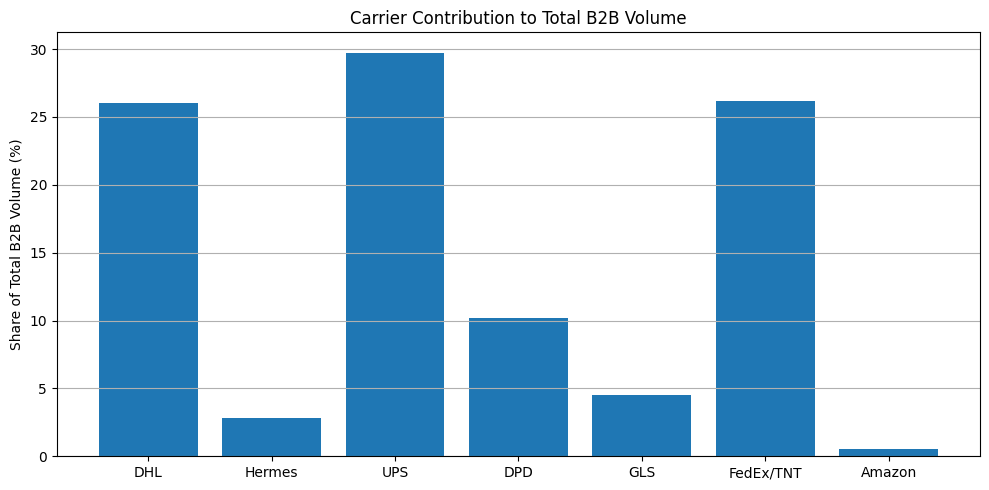

     Carrier  B2B Share (%)
2        UPS          29.75
5  FedEx/TNT          26.15
0        DHL          26.03
3        DPD          10.15
4        GLS           4.54
1     Hermes           2.82
6     Amazon           0.57


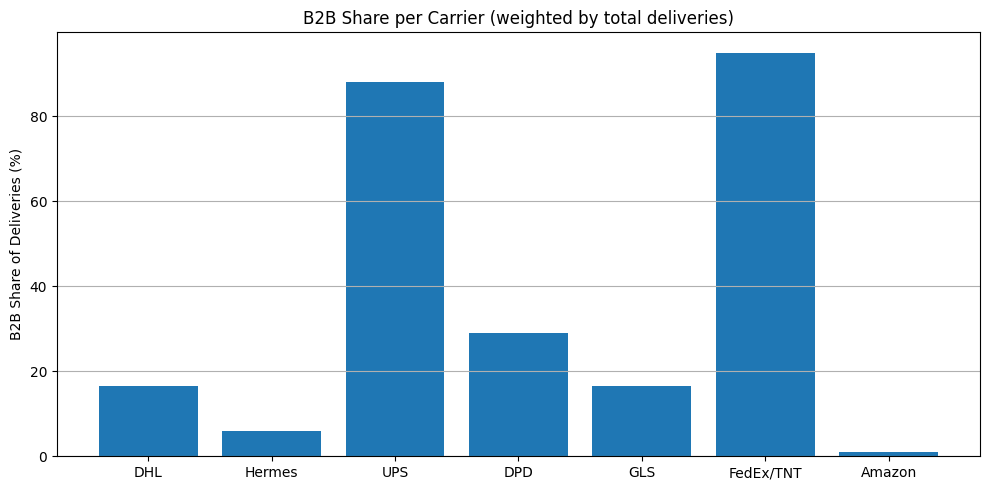

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          28.89
0        DHL          16.59
4        GLS          16.59
1     Hermes           5.93
6     Amazon           1.00
✅ Optimized B2B shares for 2021:
  DHL: 0.166
  Hermes: 0.059
  UPS: 0.880
  DPD: 0.289
  GLS: 0.166
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2021
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2022 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


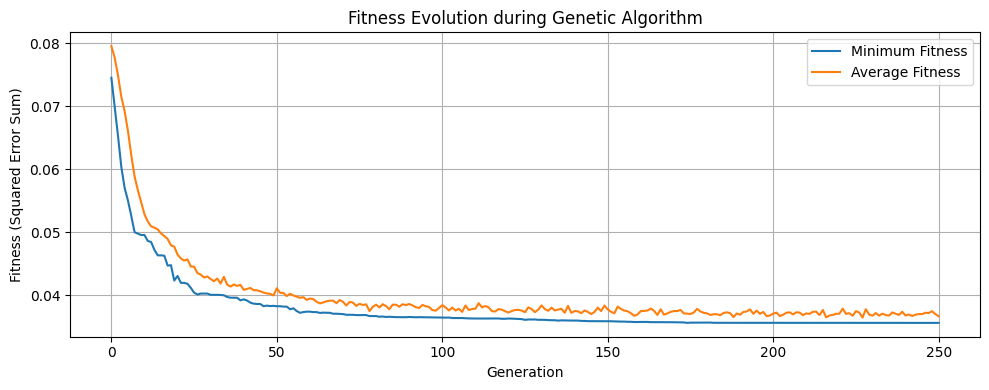

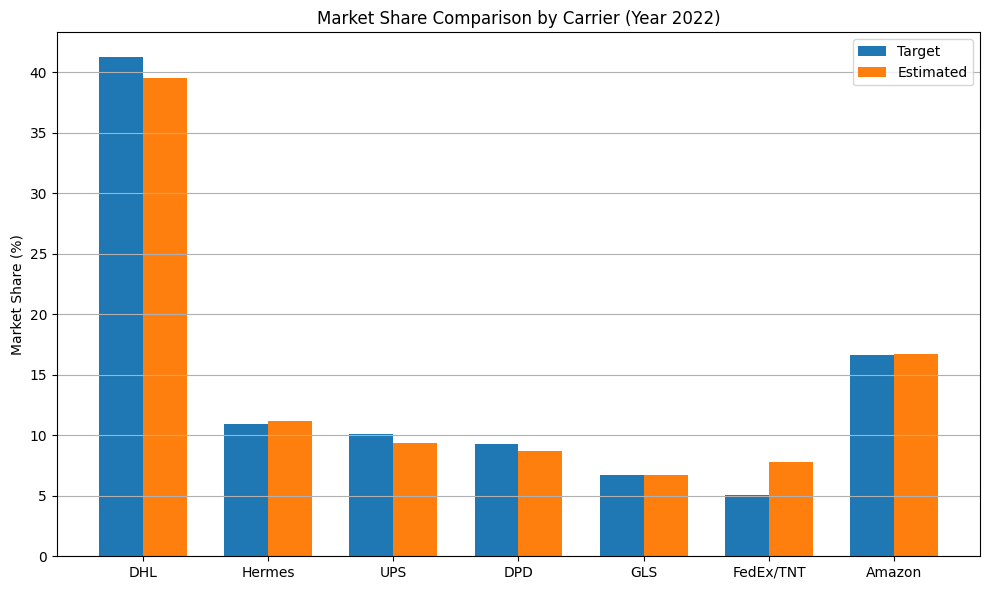

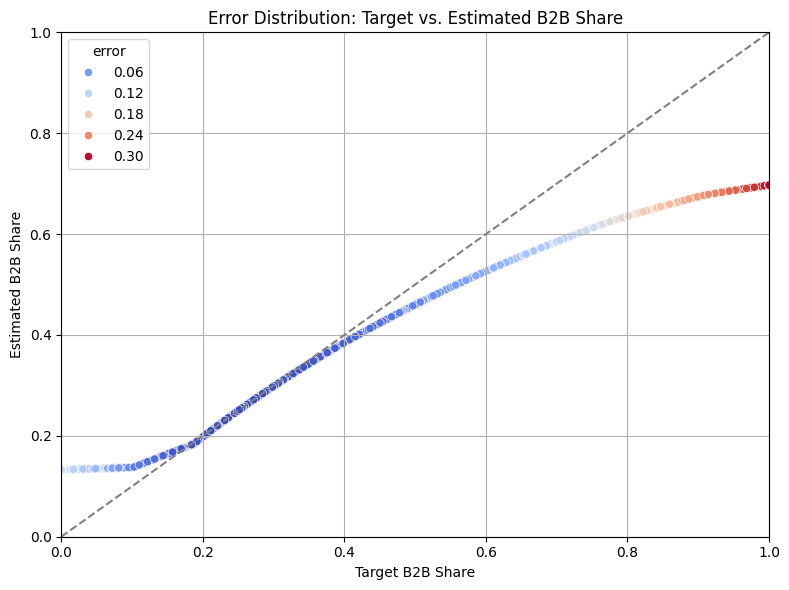


Weighted RMSE per cell: 0.1061
Estimated national B2B share (weighted): 0.2598
Target B2B share from input: 0.2400
Absolute deviation: 0.0198


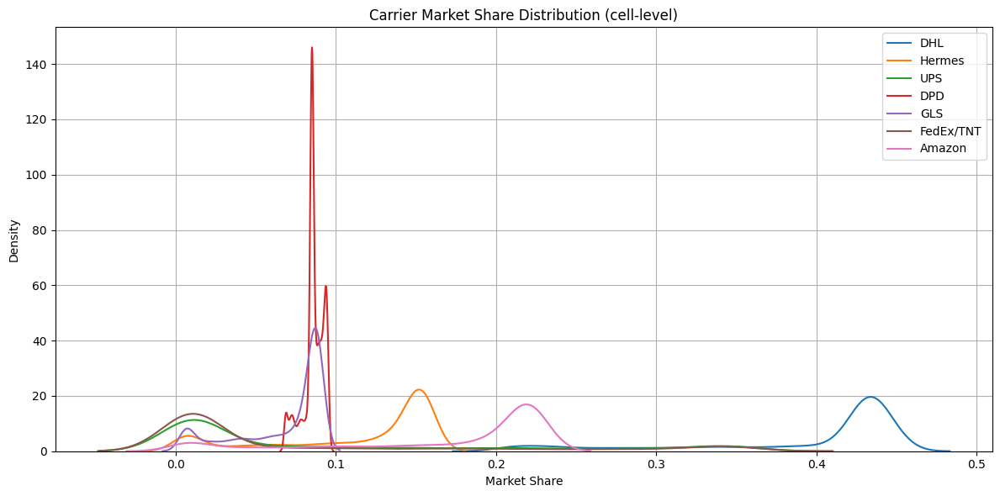

            mean    std  range
DHL        0.392  0.071  0.238
Hermes     0.113  0.053  0.148
UPS        0.094  0.116  0.342
DPD        0.086  0.006  0.027
GLS        0.068  0.028  0.082
FedEx/TNT  0.080  0.113  0.343
Amazon     0.168  0.073  0.216


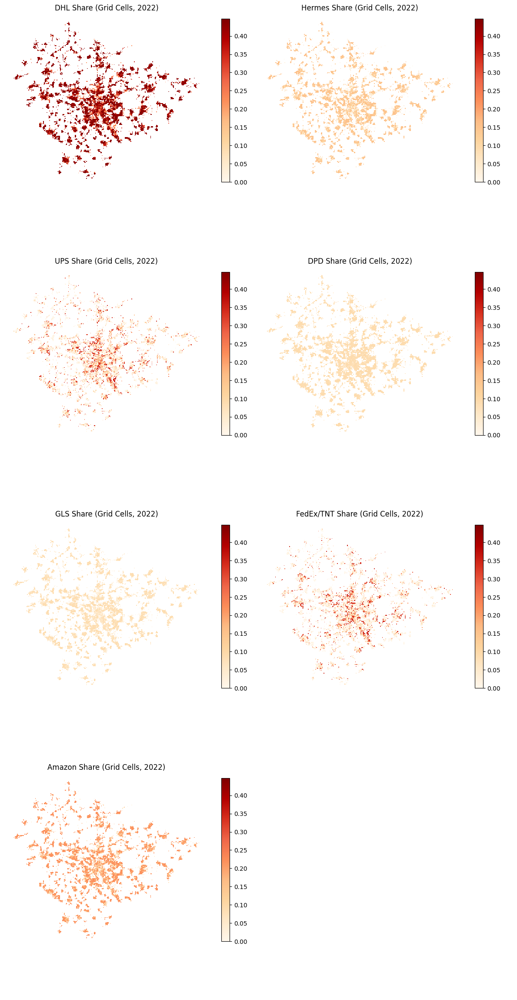

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

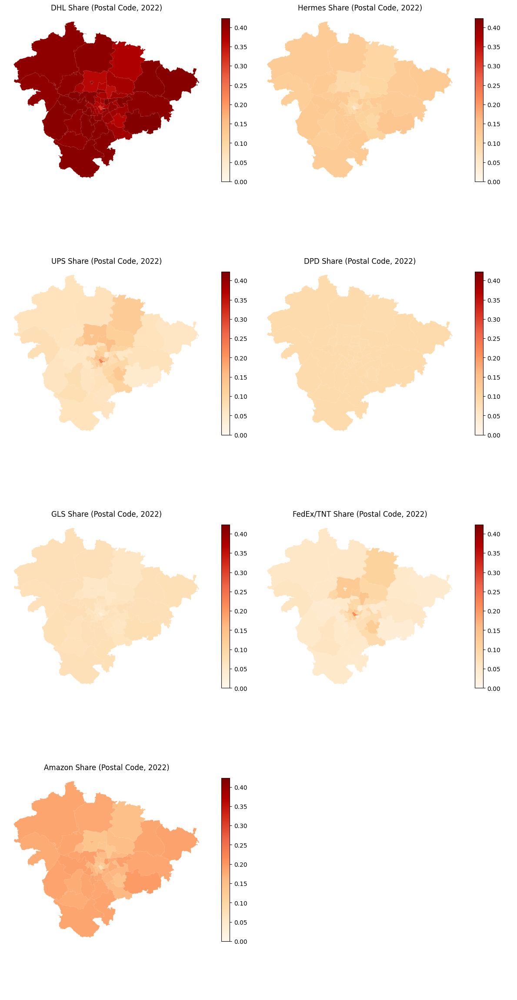

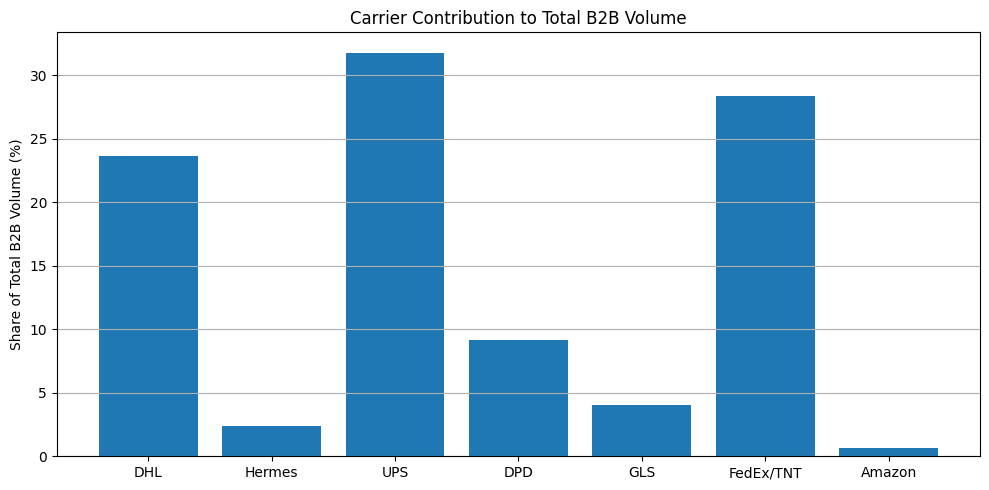

     Carrier  B2B Share (%)
2        UPS          31.77
5  FedEx/TNT          28.38
0        DHL          23.66
3        DPD           9.11
4        GLS           4.03
1     Hermes           2.40
6     Amazon           0.64


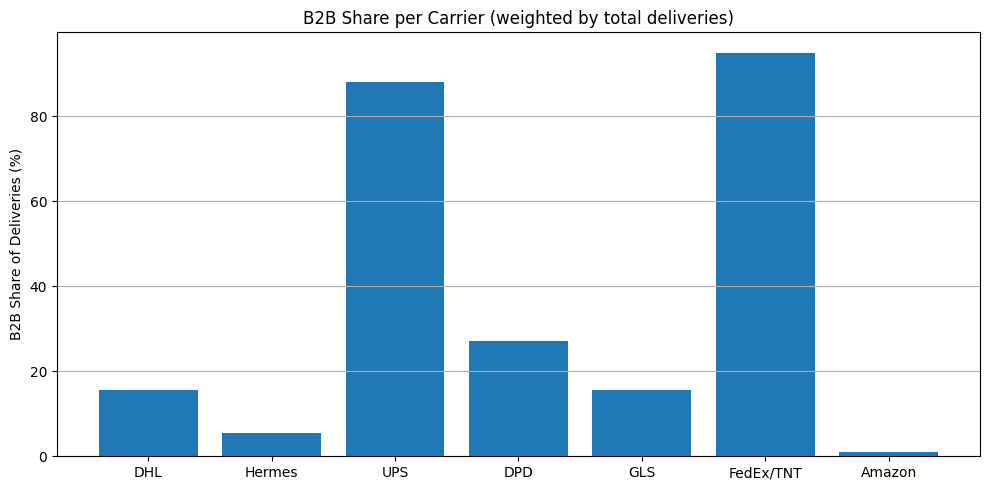

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          27.22
0        DHL          15.56
4        GLS          15.56
1     Hermes           5.56
6     Amazon           1.00
✅ Optimized B2B shares for 2022:
  DHL: 0.156
  Hermes: 0.056
  UPS: 0.880
  DPD: 0.272
  GLS: 0.156
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2022
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2023 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


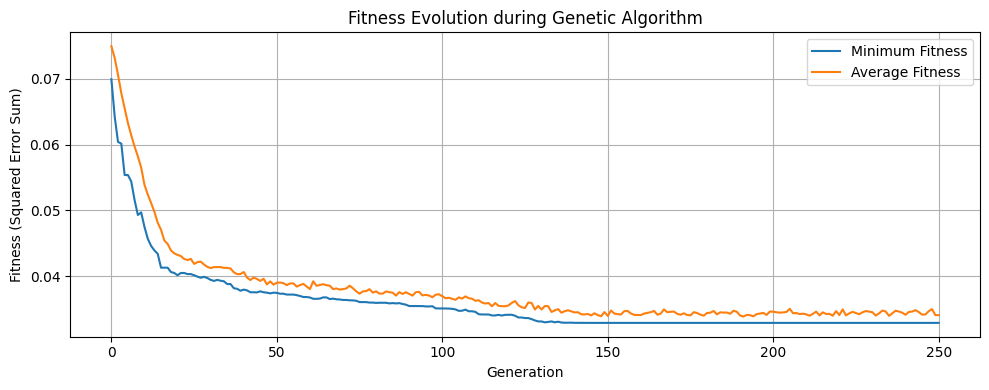

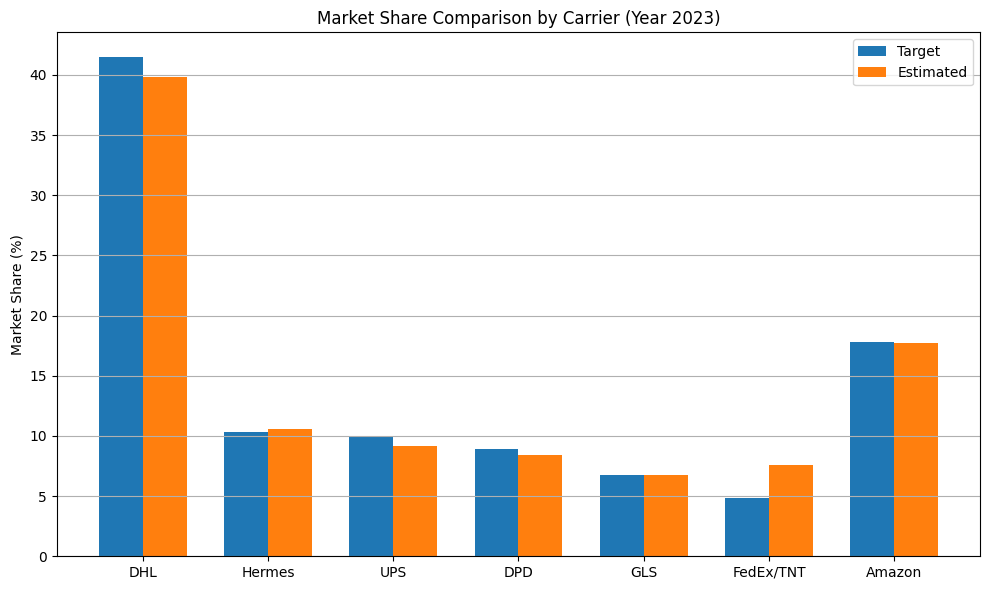

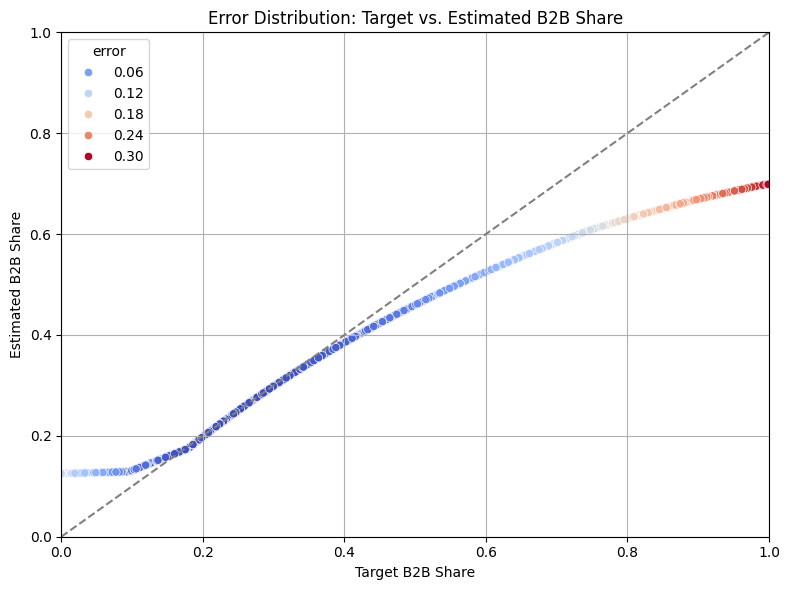


Weighted RMSE per cell: 0.0997
Estimated national B2B share (weighted): 0.2489
Target B2B share from input: 0.2300
Absolute deviation: 0.0189


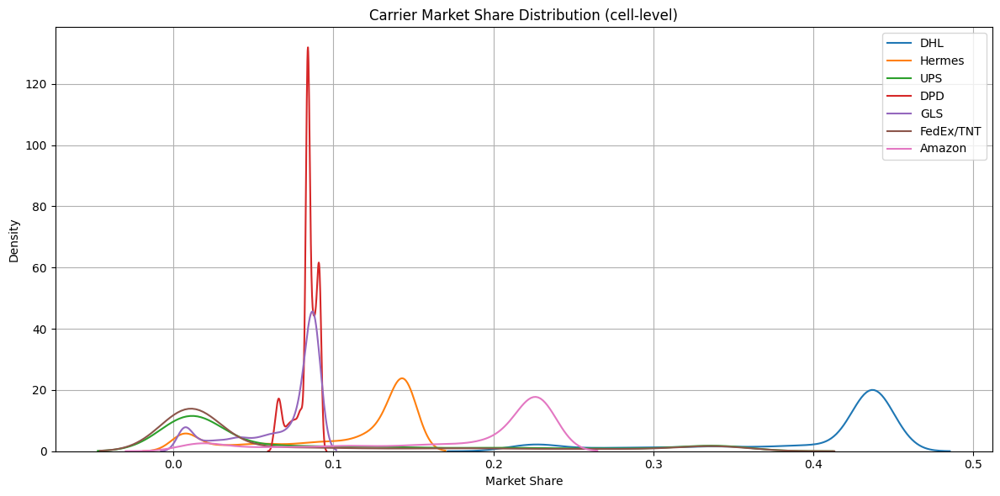

            mean    std  range
DHL        0.395  0.071  0.242
Hermes     0.107  0.049  0.139
UPS        0.092  0.113  0.345
DPD        0.083  0.007  0.029
GLS        0.068  0.027  0.082
FedEx/TNT  0.078  0.111  0.347
Amazon     0.177  0.071  0.223


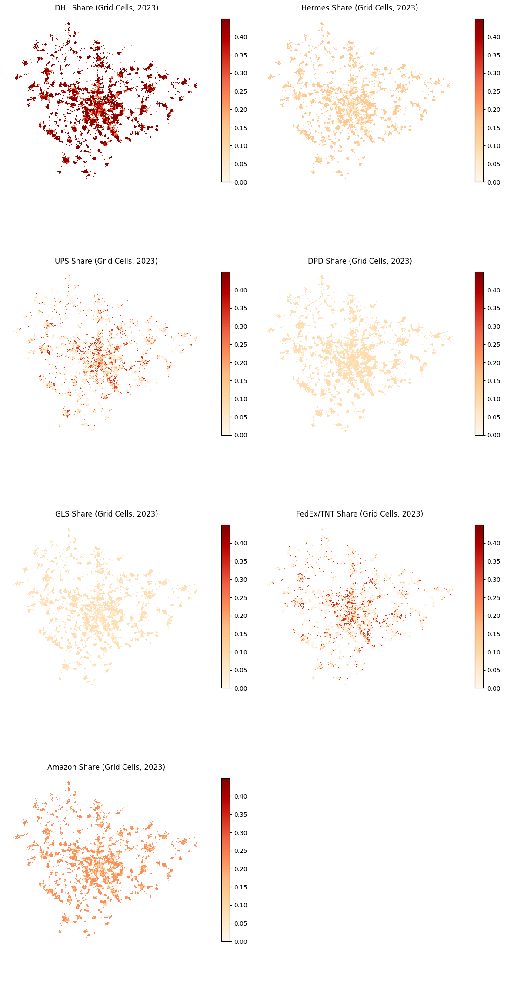

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

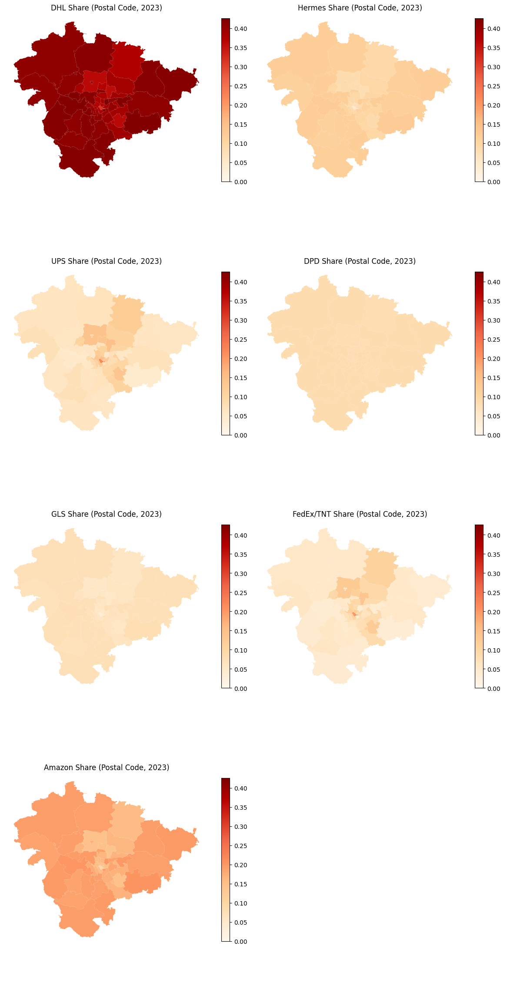

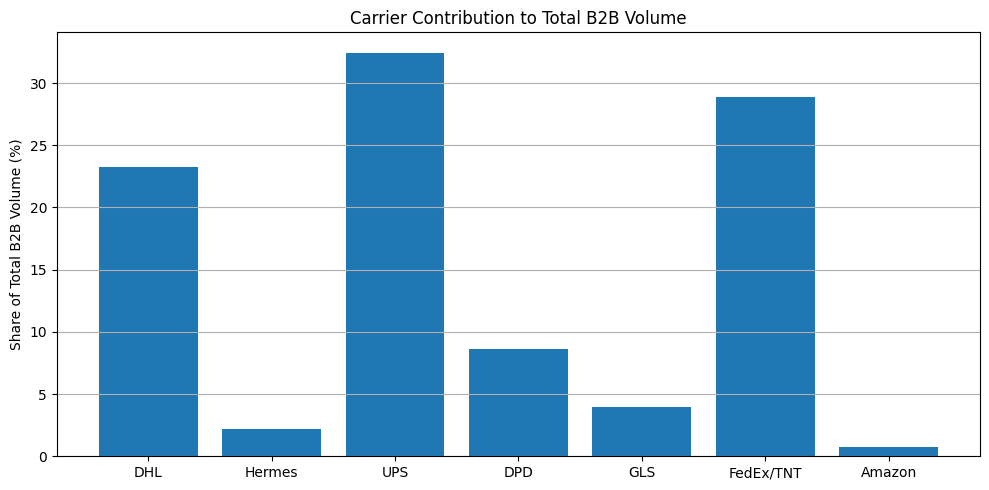

     Carrier  B2B Share (%)
2        UPS          32.45
5  FedEx/TNT          28.89
0        DHL          23.21
3        DPD           8.59
4        GLS           3.95
1     Hermes           2.21
6     Amazon           0.71


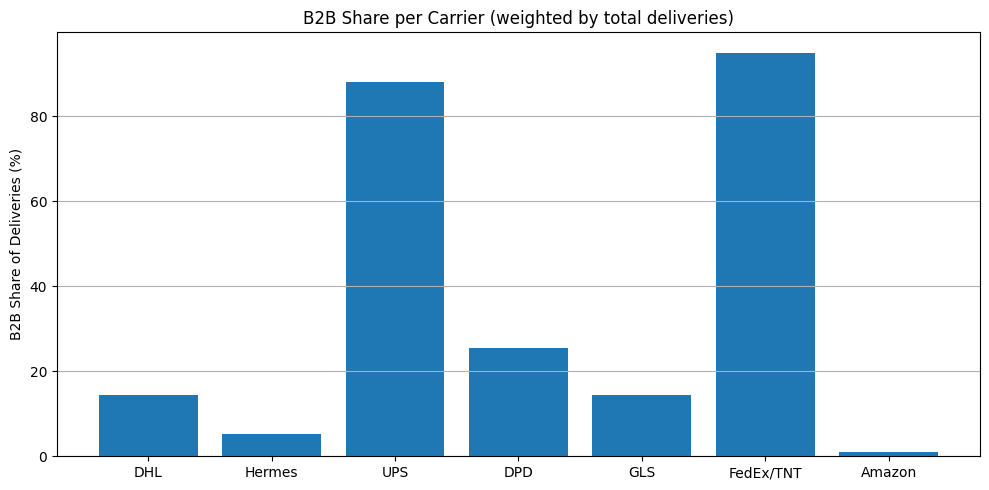

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          25.41
0        DHL          14.52
4        GLS          14.52
1     Hermes           5.19
6     Amazon           1.00
✅ Optimized B2B shares for 2023:
  DHL: 0.145
  Hermes: 0.052
  UPS: 0.880
  DPD: 0.254
  GLS: 0.145
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2023
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2024 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


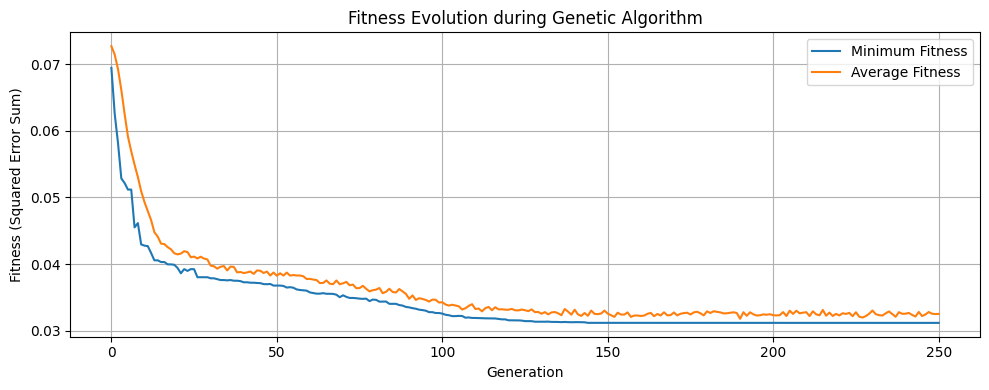

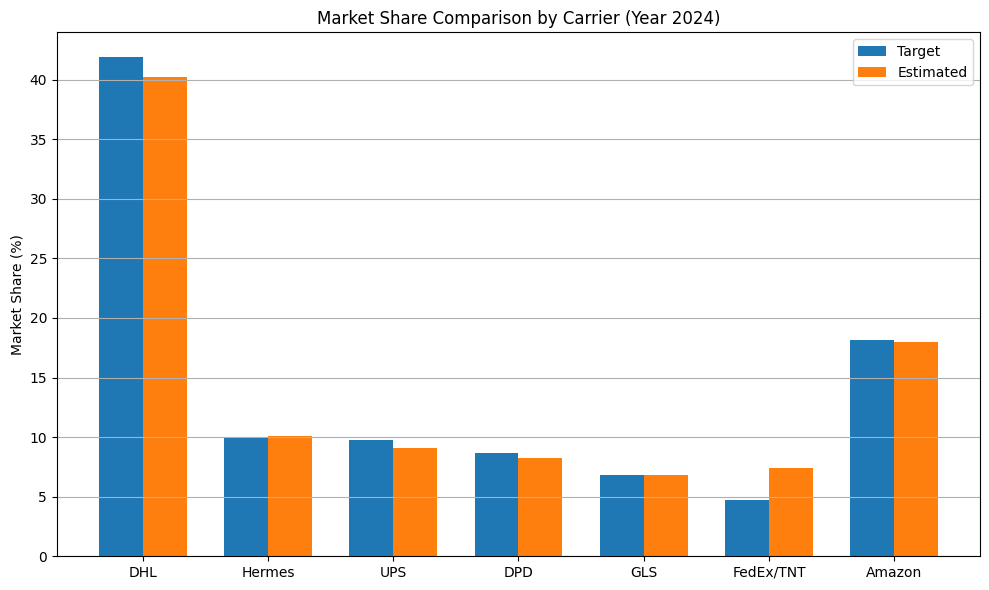

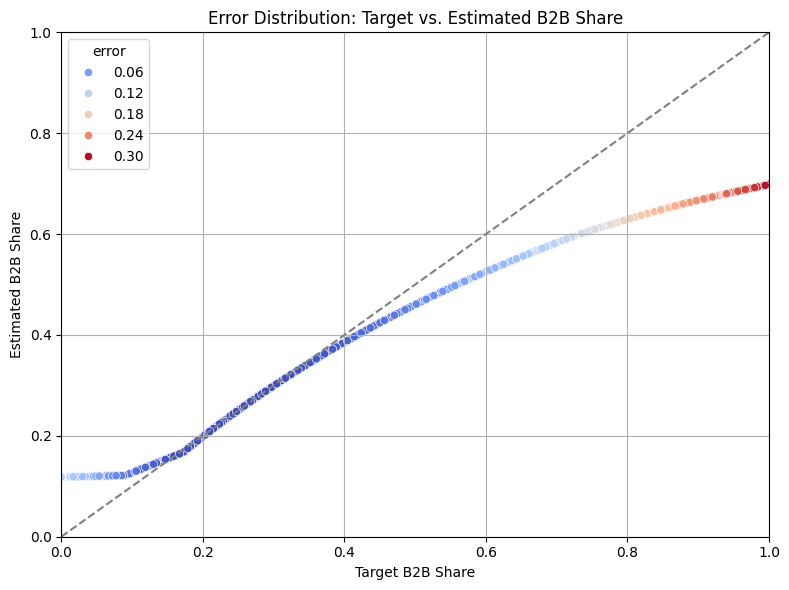


Weighted RMSE per cell: 0.0900
Estimated national B2B share (weighted): 0.2403
Target B2B share from input: 0.2210
Absolute deviation: 0.0194


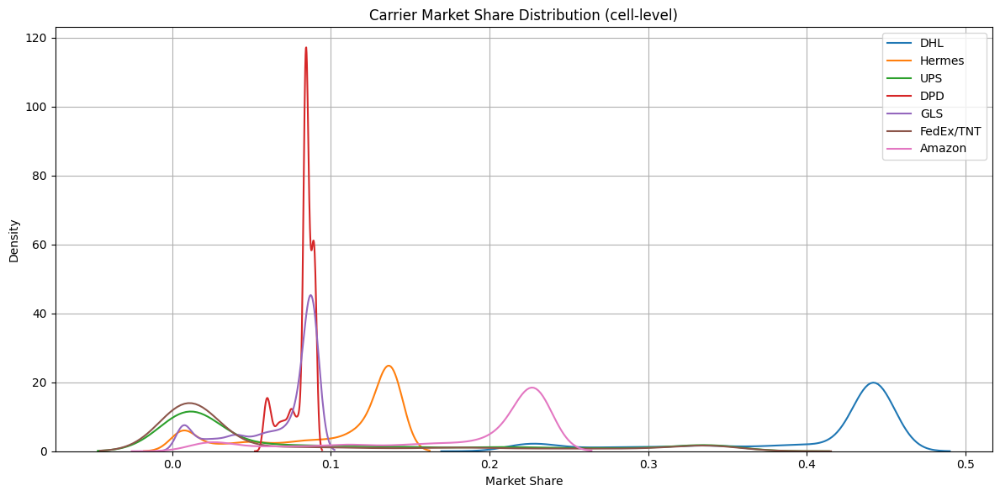

            mean    std  range
DHL        0.399  0.072  0.248
Hermes     0.102  0.047  0.133
UPS        0.092  0.113  0.347
DPD        0.082  0.009  0.034
GLS        0.068  0.027  0.083
FedEx/TNT  0.078  0.110  0.350
Amazon     0.180  0.069  0.220


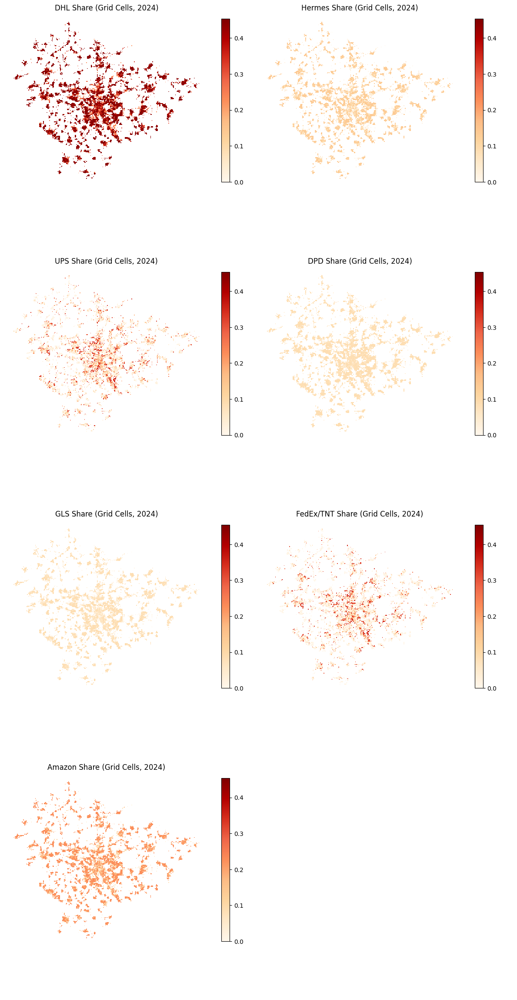

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

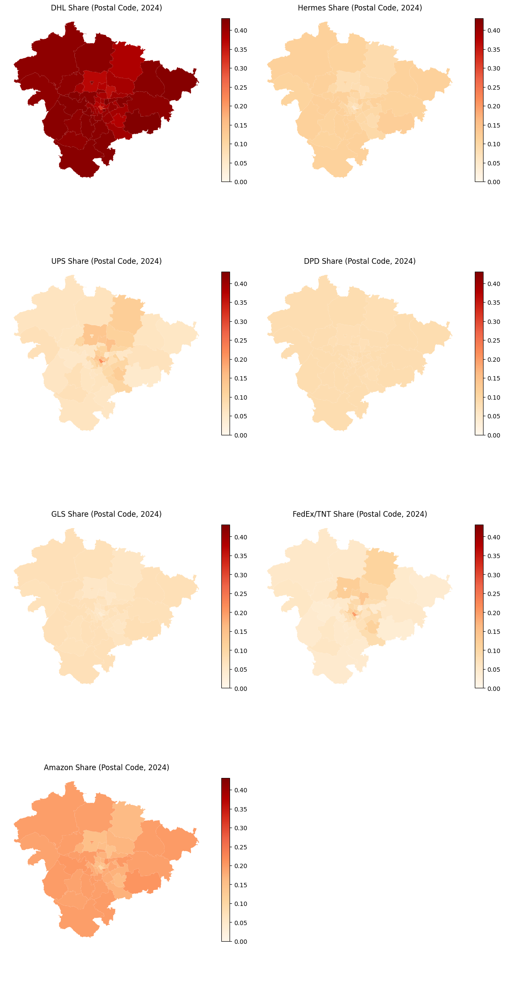

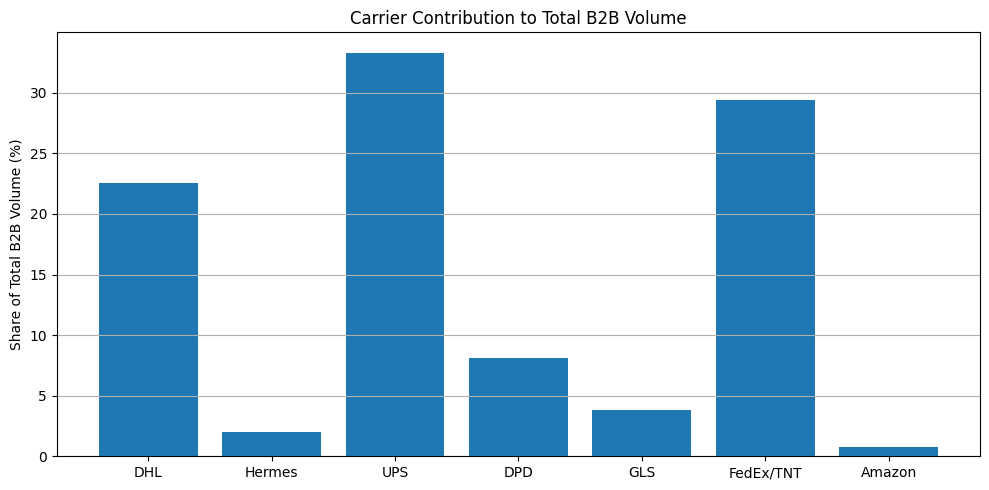

     Carrier  B2B Share (%)
2        UPS          33.32
5  FedEx/TNT          29.41
0        DHL          22.58
3        DPD           8.10
4        GLS           3.83
1     Hermes           2.03
6     Amazon           0.75


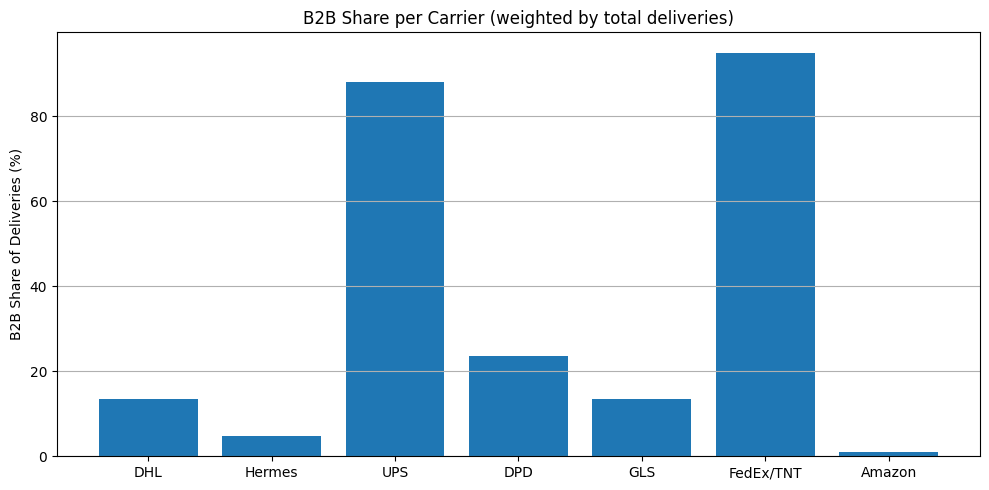

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          23.59
0        DHL          13.48
4        GLS          13.48
1     Hermes           4.81
6     Amazon           1.00
✅ Optimized B2B shares for 2024:
  DHL: 0.135
  Hermes: 0.048
  UPS: 0.880
  DPD: 0.236
  GLS: 0.135
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2024
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2025 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


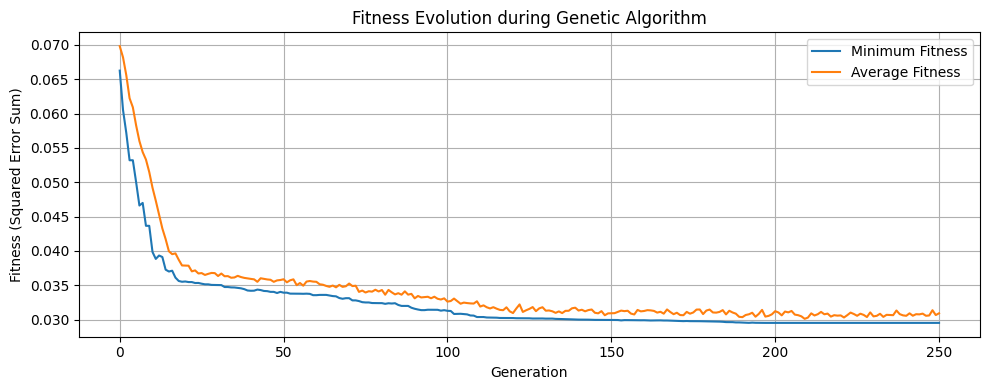

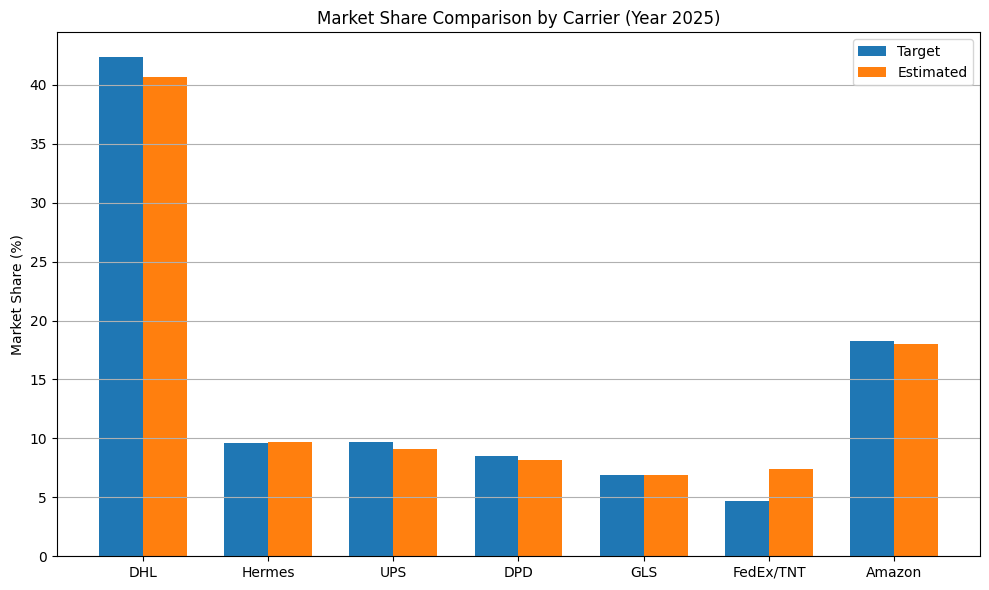

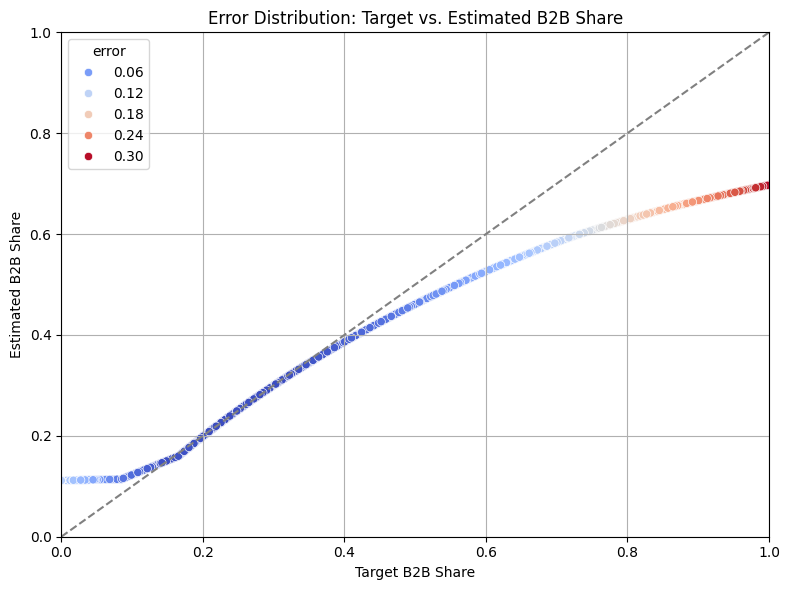


Weighted RMSE per cell: 0.0845
Estimated national B2B share (weighted): 0.2336
Target B2B share from input: 0.2154
Absolute deviation: 0.0182


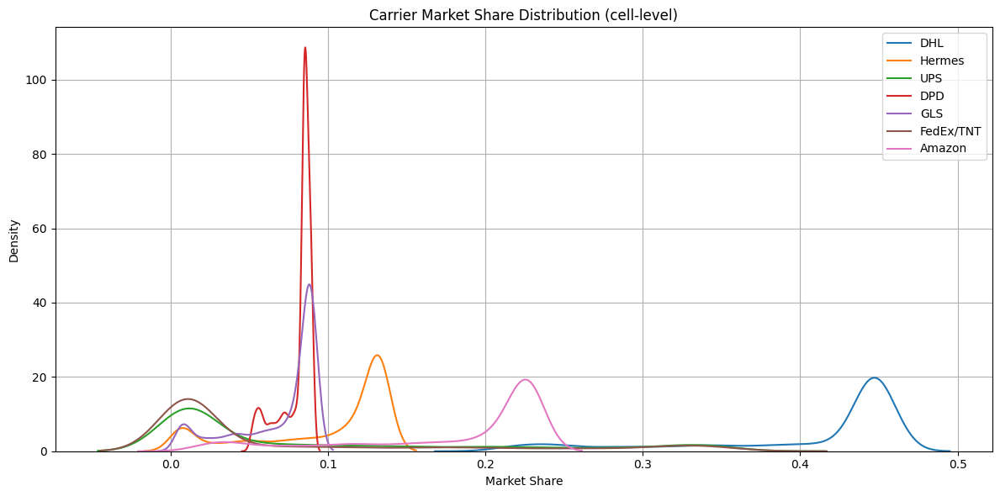

            mean    std  range
DHL        0.404  0.072  0.254
Hermes     0.098  0.045  0.127
UPS        0.092  0.112  0.349
DPD        0.081  0.010  0.039
GLS        0.069  0.027  0.083
FedEx/TNT  0.077  0.109  0.352
Amazon     0.180  0.066  0.215


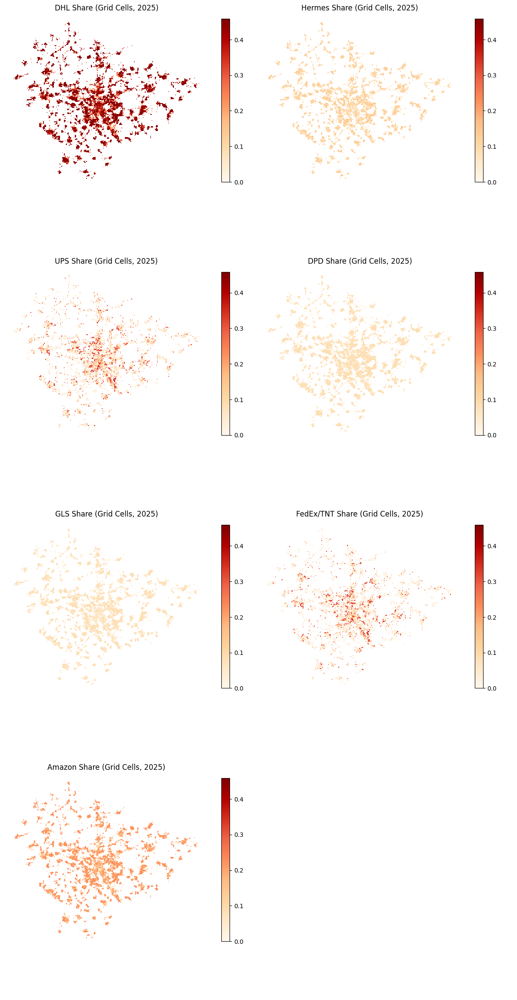

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

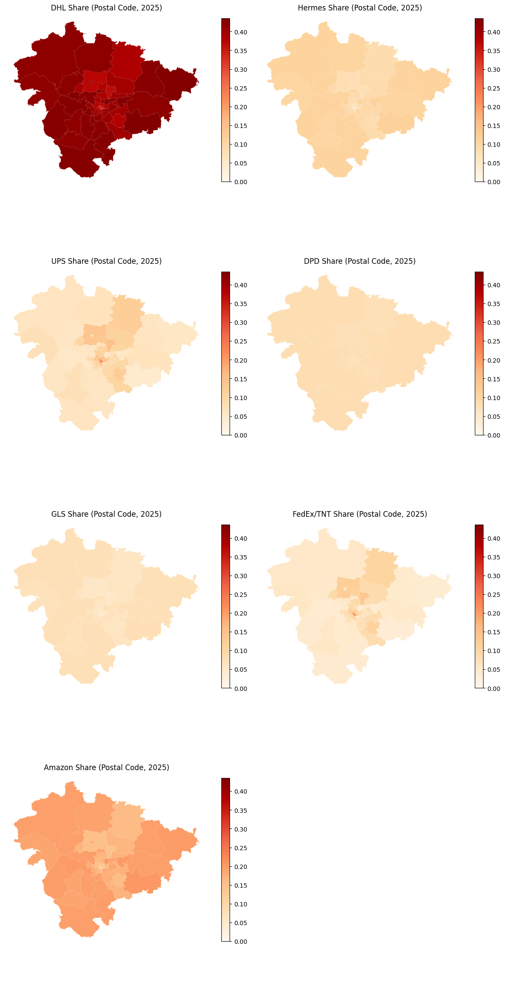

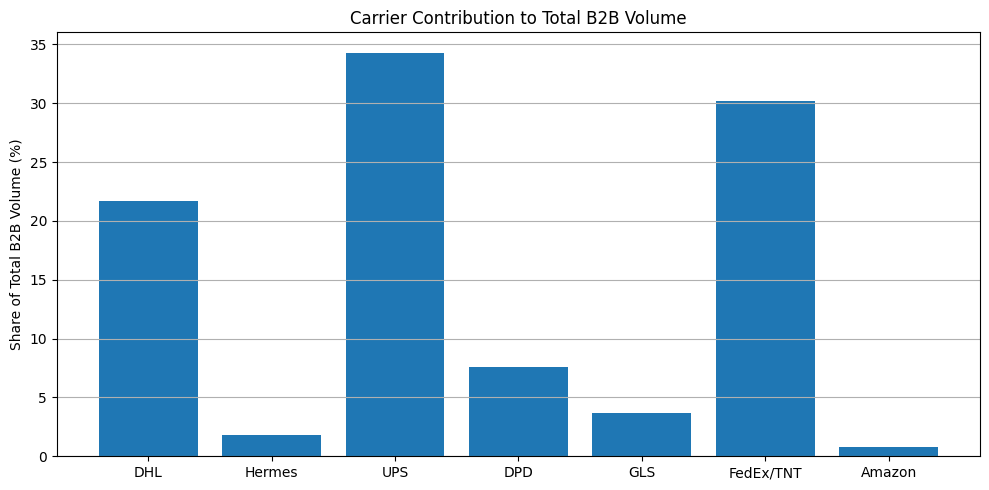

     Carrier  B2B Share (%)
2        UPS          34.31
5  FedEx/TNT          30.15
0        DHL          21.67
3        DPD           7.58
4        GLS           3.66
1     Hermes           1.85
6     Amazon           0.77


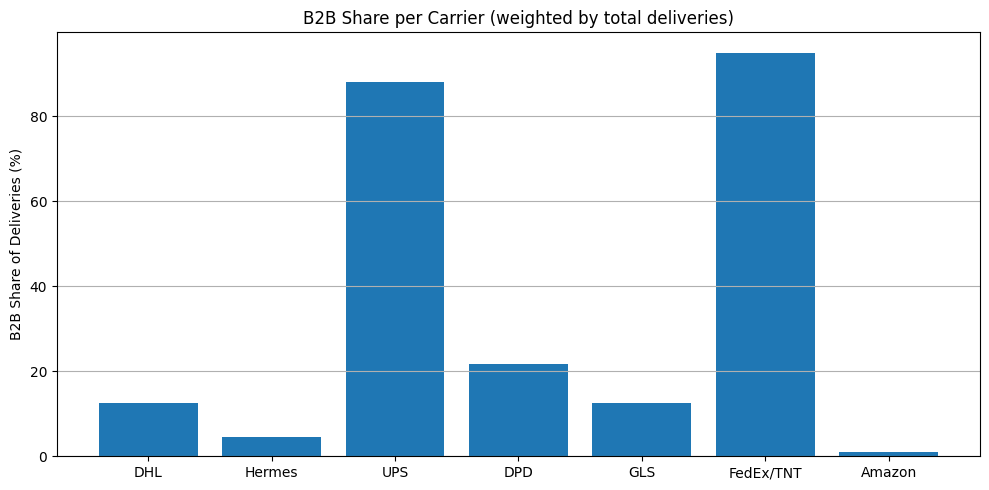

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00
✅ Optimized B2B shares for 2025:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2025
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2026 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


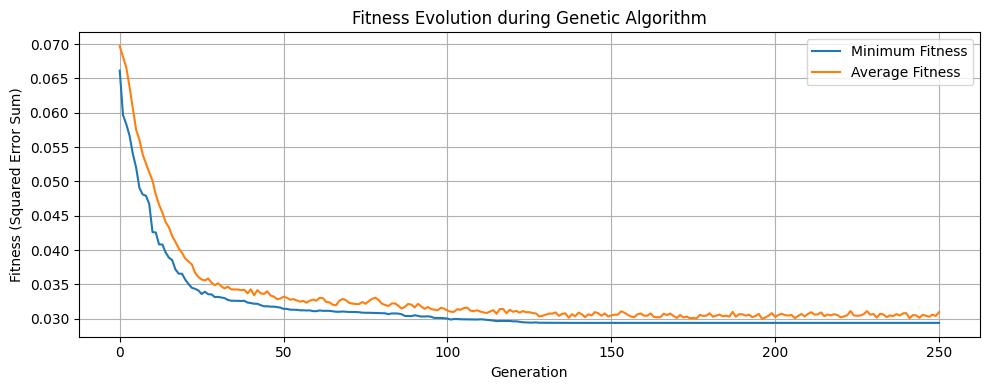

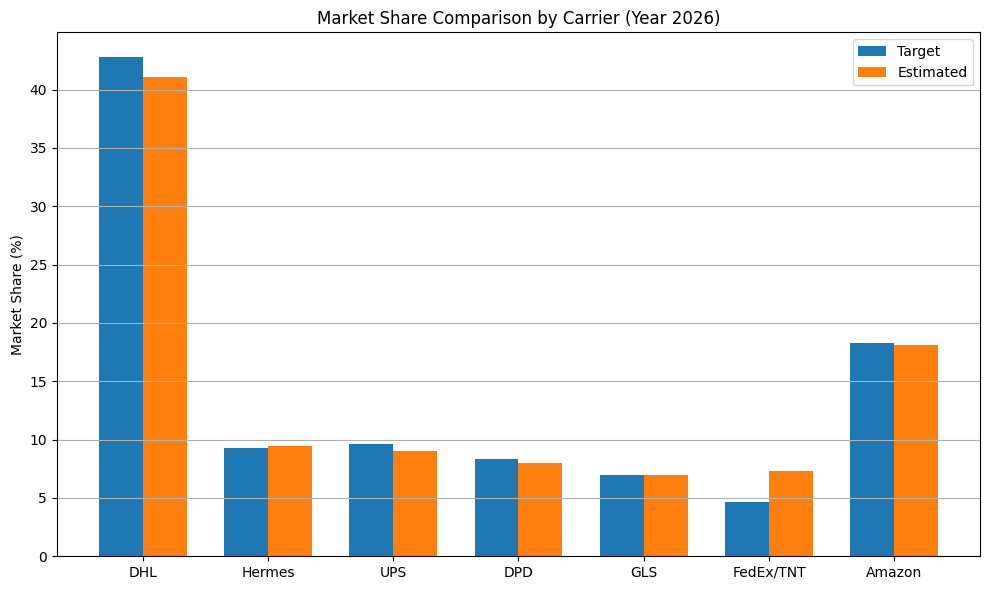

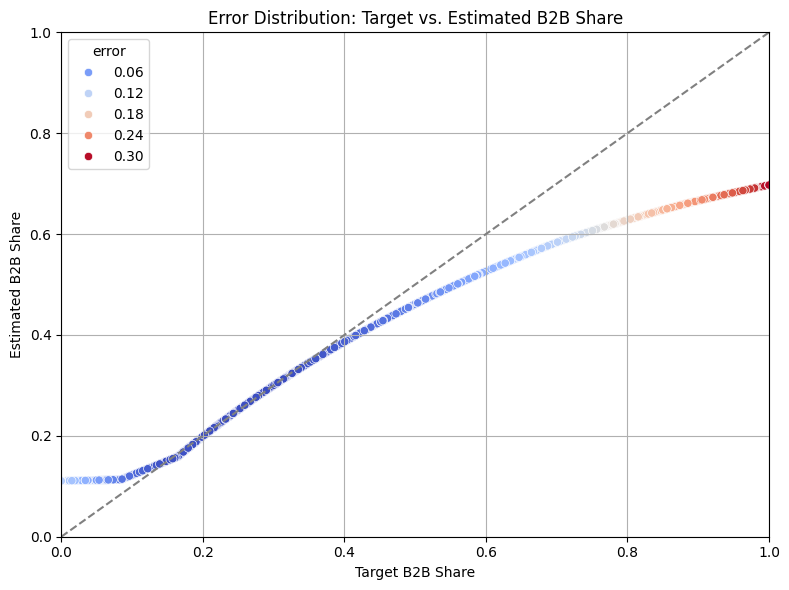


Weighted RMSE per cell: 0.0838
Estimated national B2B share (weighted): 0.2317
Target B2B share from input: 0.2113
Absolute deviation: 0.0204


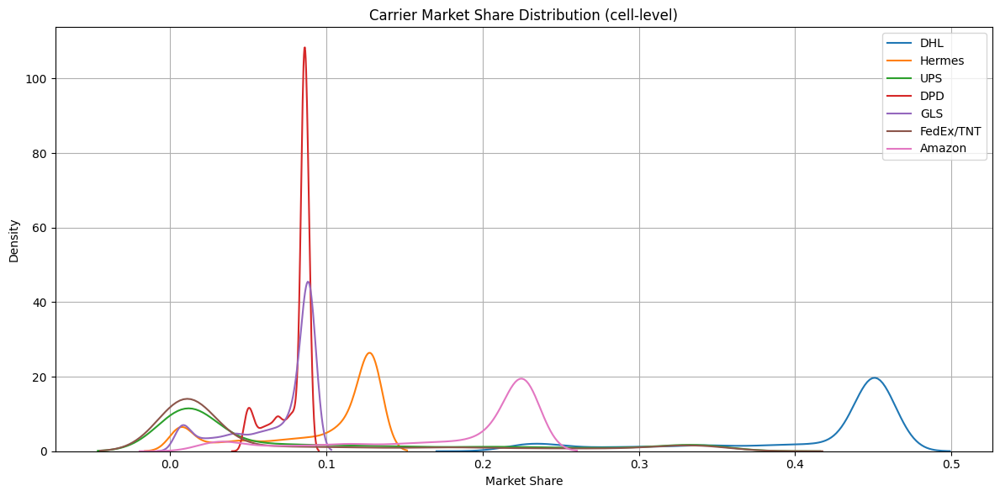

            mean    std  range
DHL        0.407  0.073  0.255
Hermes     0.095  0.044  0.124
UPS        0.092  0.112  0.350
DPD        0.079  0.012  0.043
GLS        0.069  0.027  0.084
FedEx/TNT  0.077  0.109  0.353
Amazon     0.180  0.065  0.214


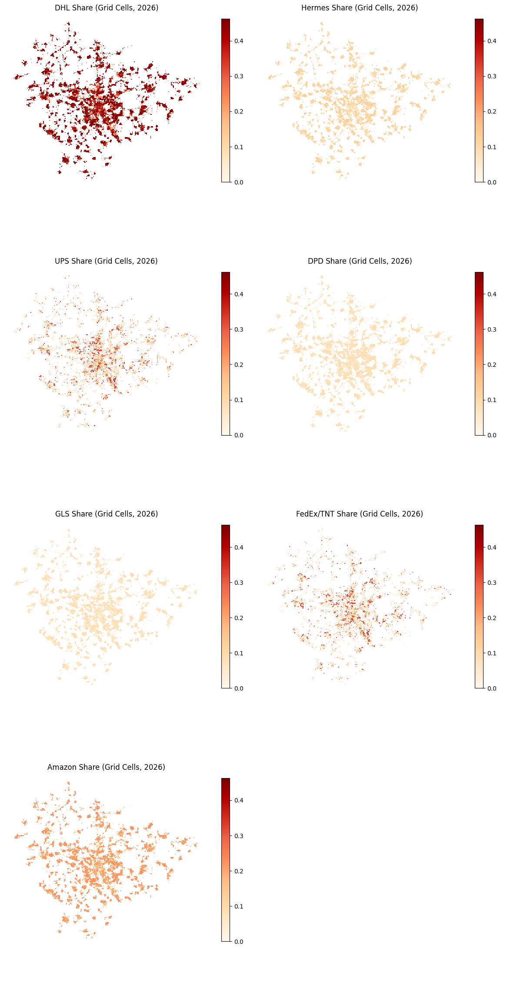

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

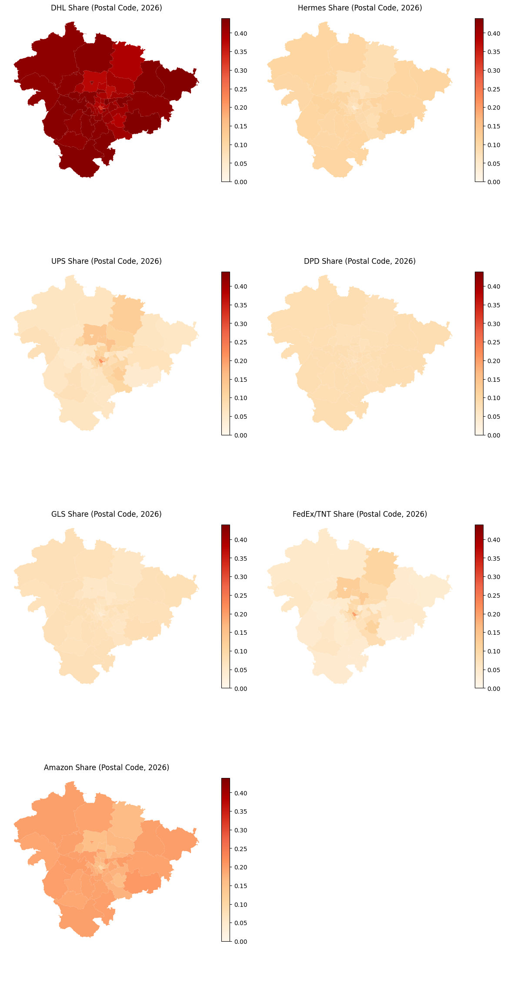

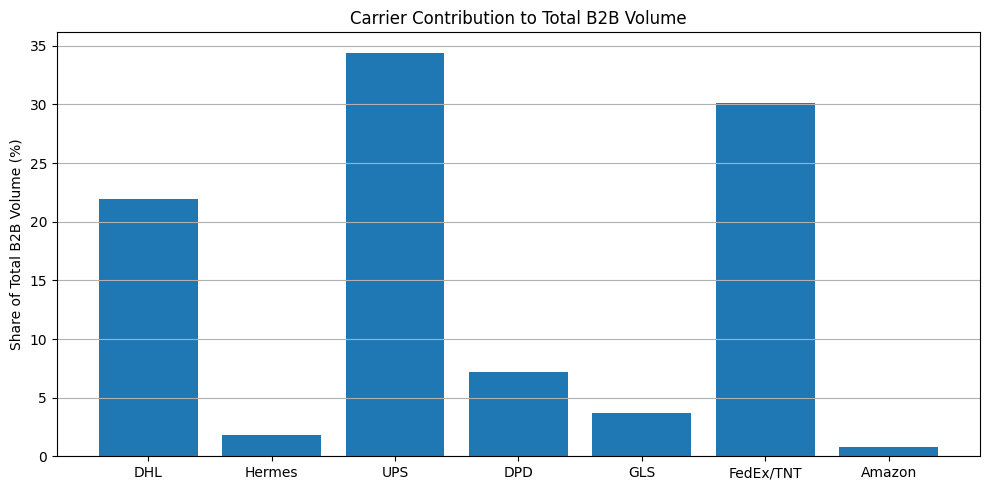

     Carrier  B2B Share (%)
2        UPS          34.43
5  FedEx/TNT          30.13
0        DHL          21.97
3        DPD           7.17
4        GLS           3.71
1     Hermes           1.80
6     Amazon           0.78


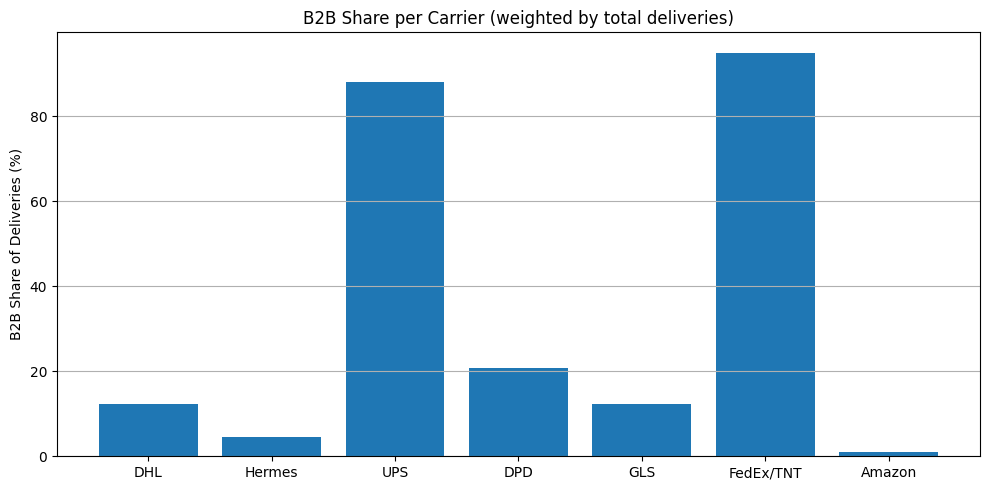

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          20.72
4        GLS          12.40
0        DHL          12.39
1     Hermes           4.42
6     Amazon           1.00
✅ Optimized B2B shares for 2026:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.207
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2026
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2027 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


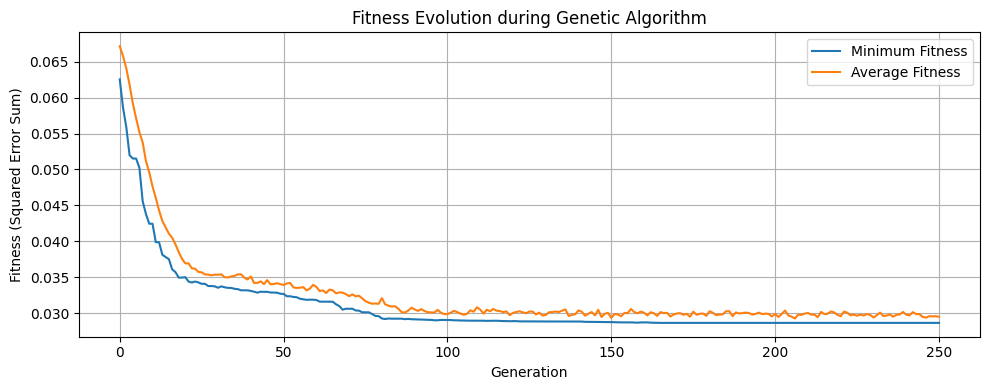

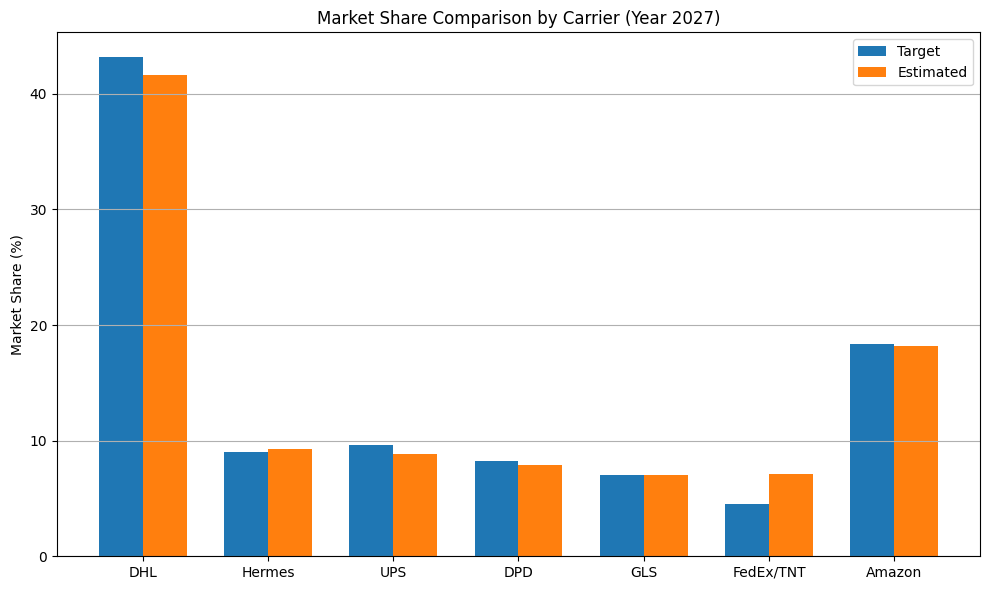

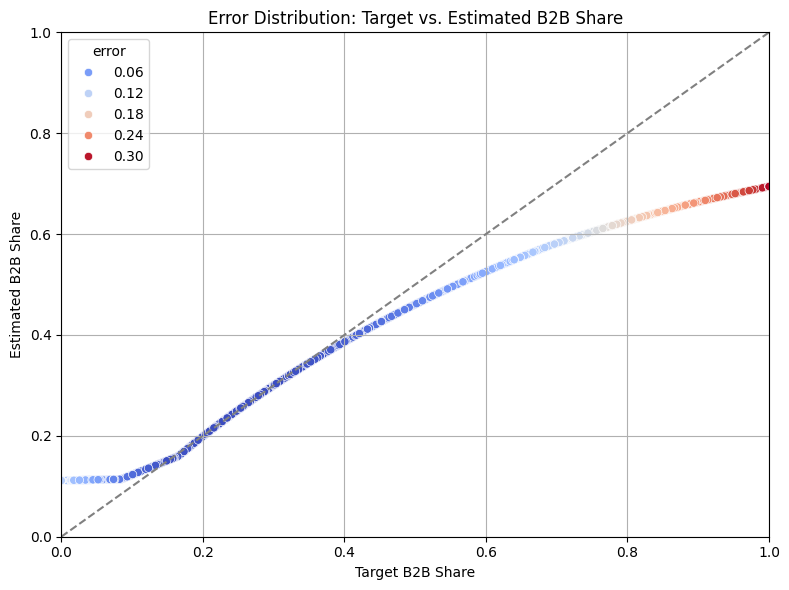


Weighted RMSE per cell: 0.0825
Estimated national B2B share (weighted): 0.2285
Target B2B share from input: 0.2082
Absolute deviation: 0.0204


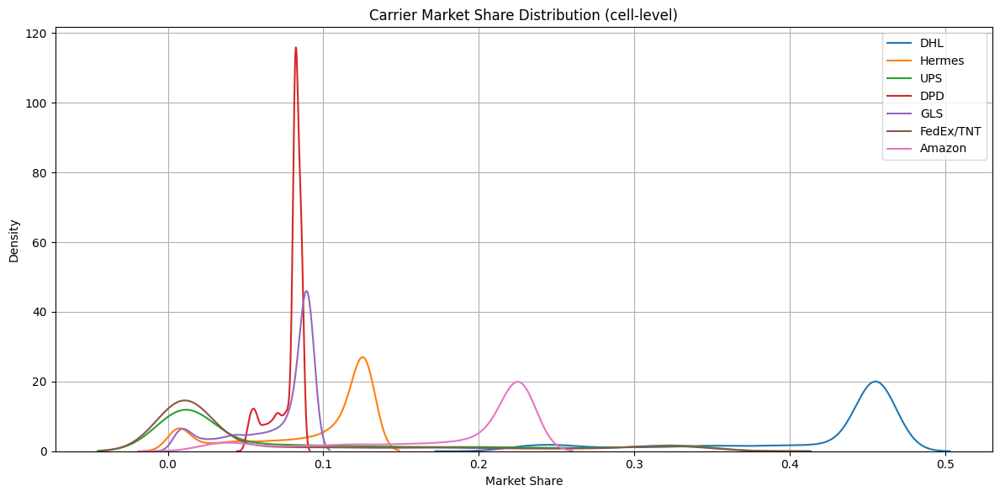

            mean    std  range
DHL        0.413  0.072  0.259
Hermes     0.094  0.043  0.121
UPS        0.089  0.109  0.347
DPD        0.078  0.010  0.037
GLS        0.070  0.027  0.085
FedEx/TNT  0.075  0.106  0.350
Amazon     0.181  0.064  0.214


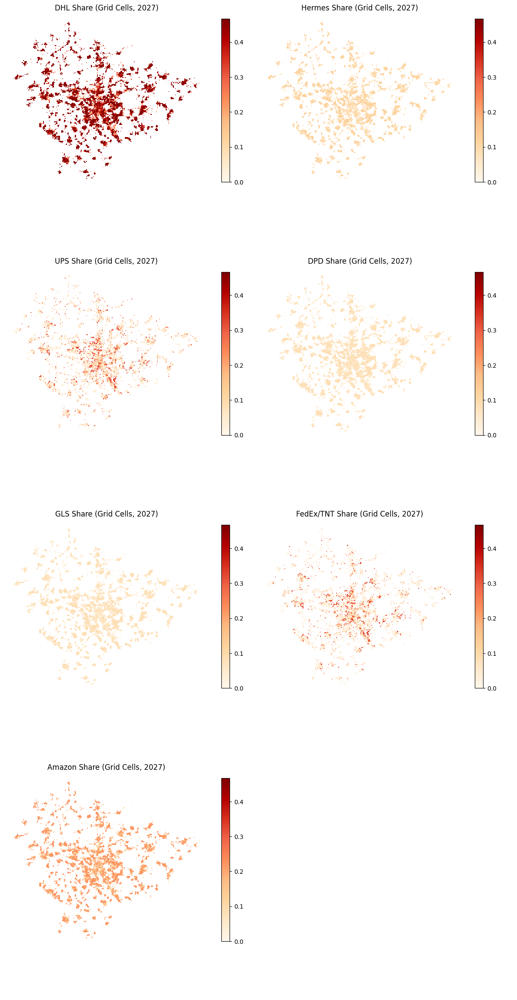

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

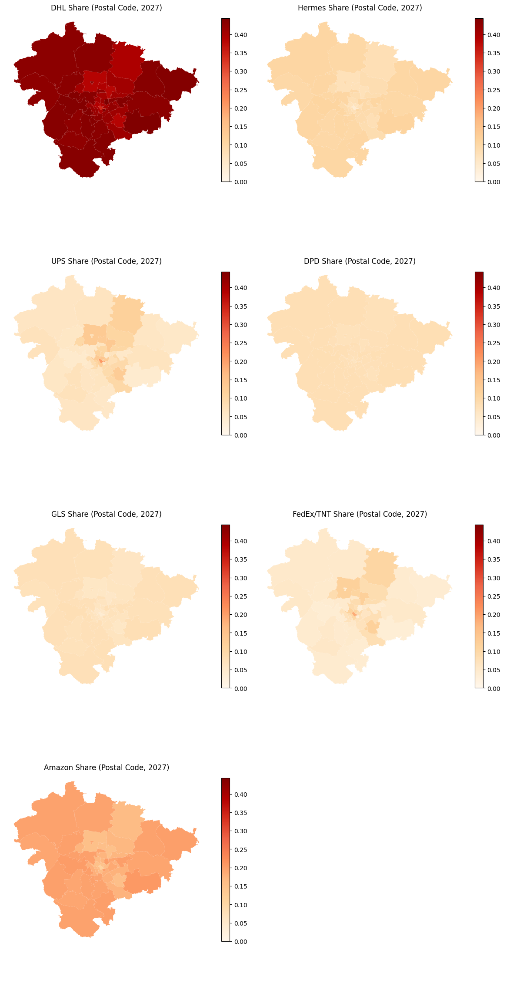

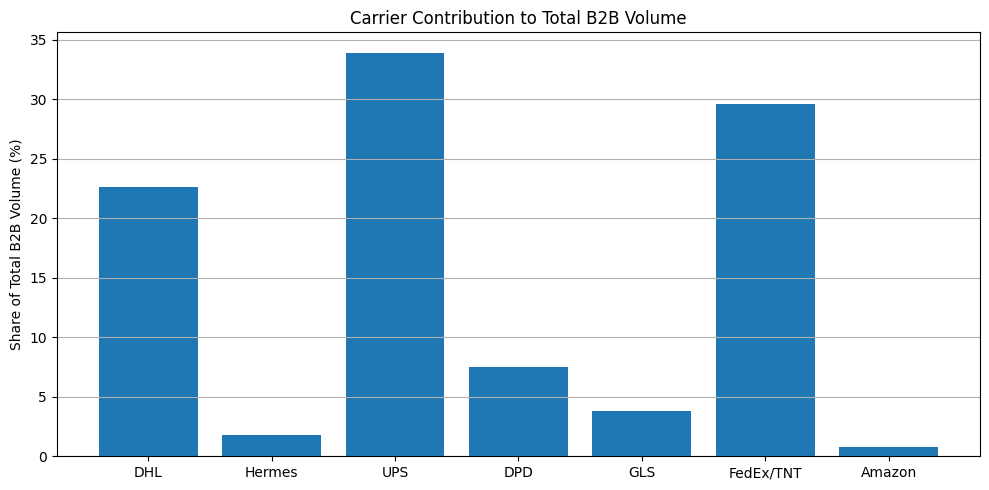

     Carrier  B2B Share (%)
2        UPS          33.91
5  FedEx/TNT          29.59
0        DHL          22.60
3        DPD           7.51
4        GLS           3.80
1     Hermes           1.80
6     Amazon           0.80


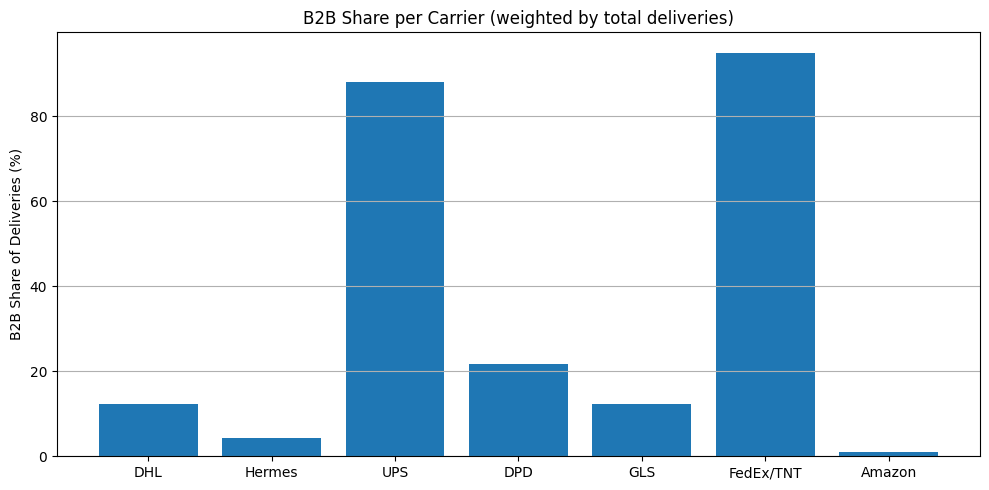

     Carrier  B2B Share (%)
5  FedEx/TNT          95.03
2        UPS          88.00
3        DPD          21.76
0        DHL          12.41
4        GLS          12.30
1     Hermes           4.41
6     Amazon           1.00
✅ Optimized B2B shares for 2027:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.123
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2027
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2028 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


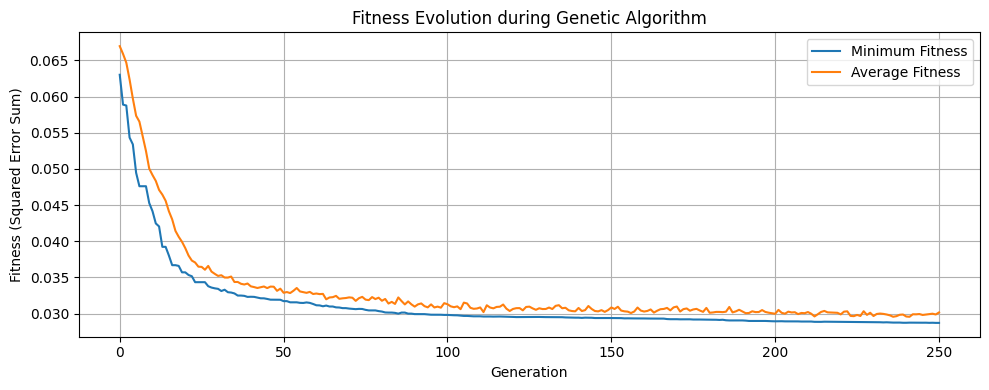

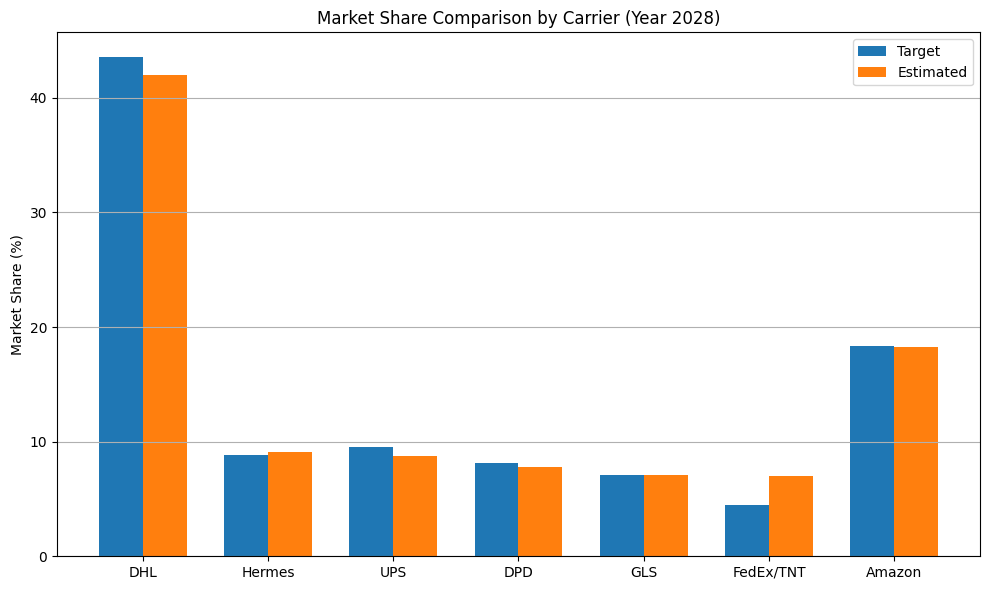

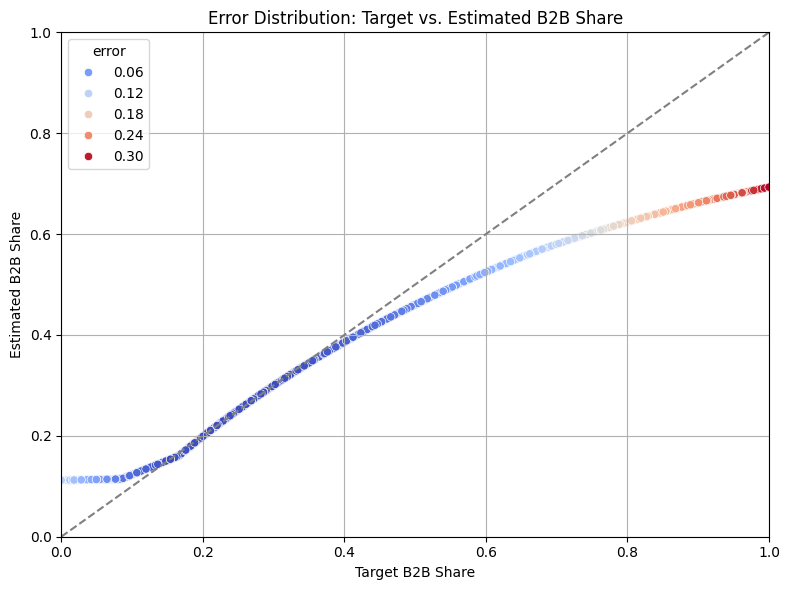


Weighted RMSE per cell: 0.0821
Estimated national B2B share (weighted): 0.2277
Target B2B share from input: 0.2059
Absolute deviation: 0.0218


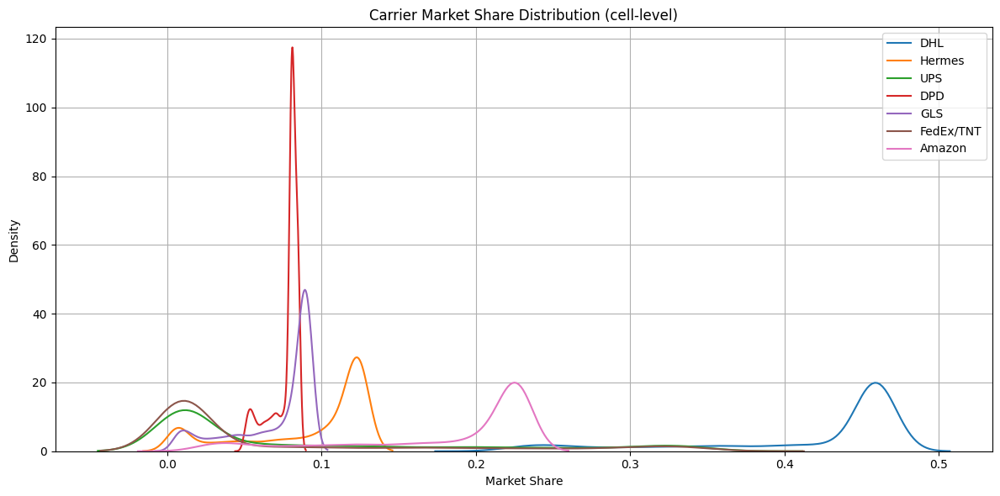

            mean    std  range
DHL        0.416  0.072  0.260
Hermes     0.092  0.042  0.119
UPS        0.089  0.109  0.347
DPD        0.077  0.009  0.036
GLS        0.071  0.027  0.085
FedEx/TNT  0.074  0.105  0.349
Amazon     0.181  0.064  0.214


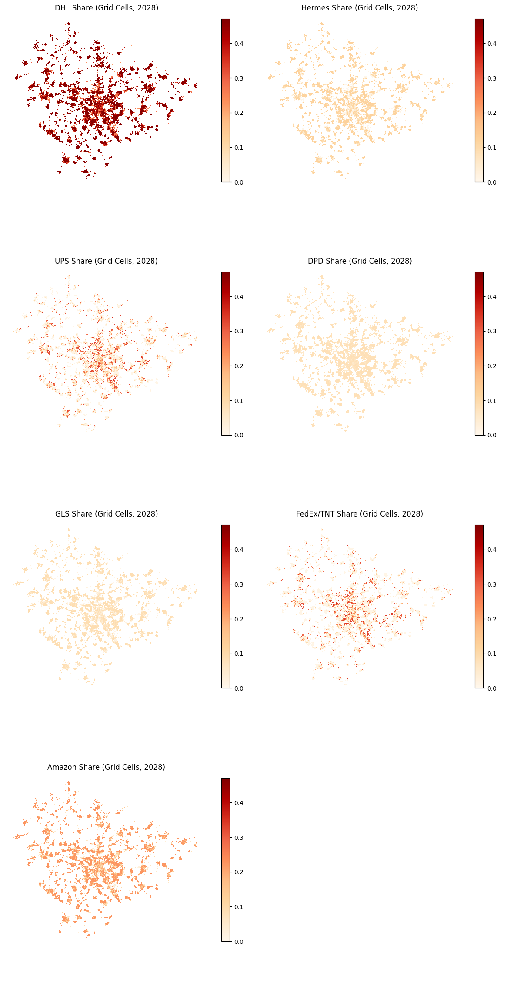

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

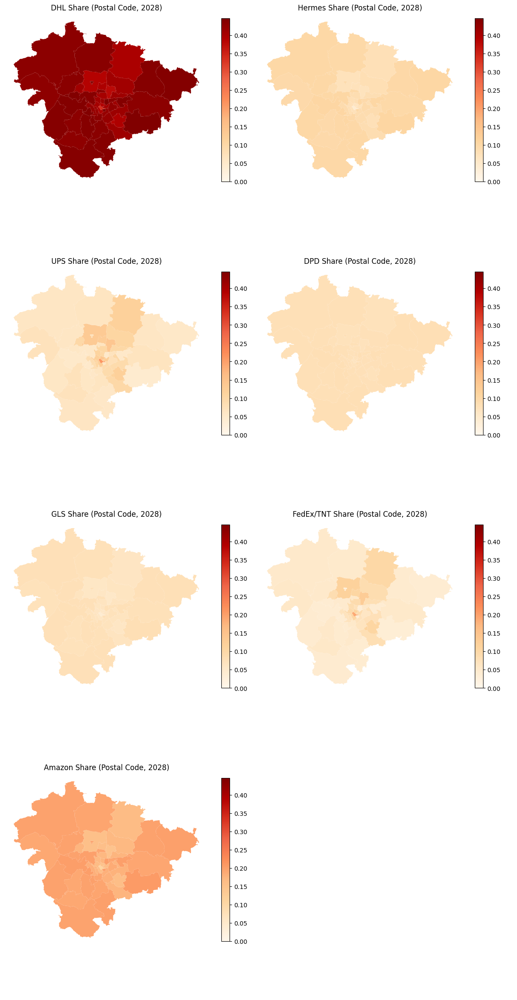

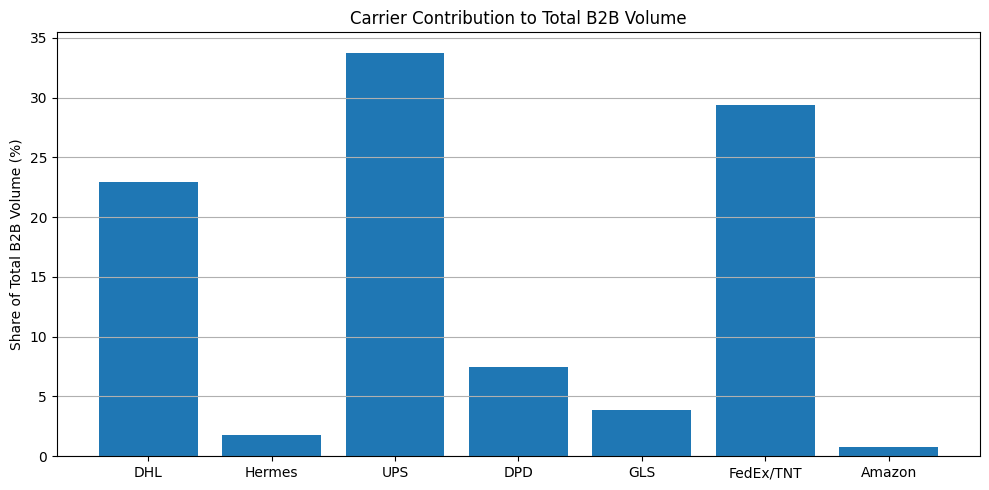

     Carrier  B2B Share (%)
2        UPS          33.77
5  FedEx/TNT          29.36
0        DHL          22.94
3        DPD           7.44
4        GLS           3.91
1     Hermes           1.78
6     Amazon           0.80


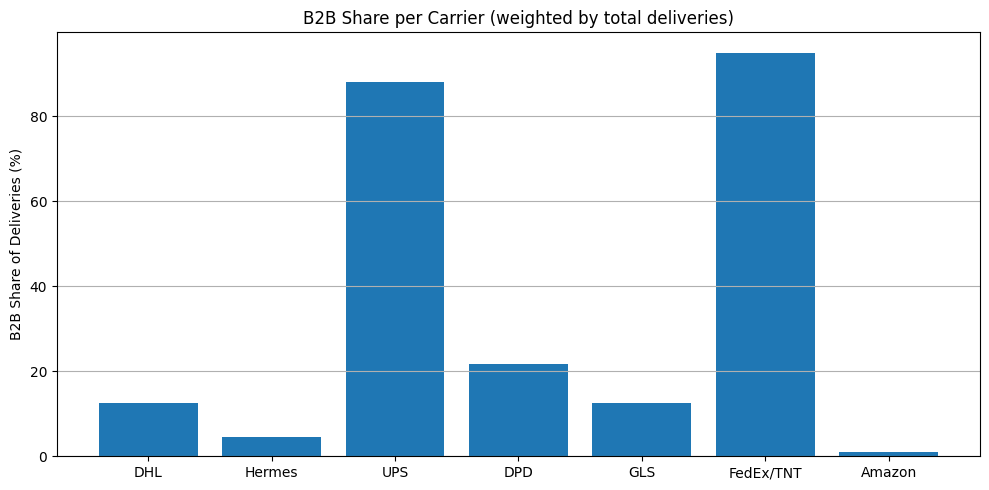

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
4        GLS          12.52
0        DHL          12.44
1     Hermes           4.44
6     Amazon           1.00
✅ Optimized B2B shares for 2028:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.125
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2028
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2029 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


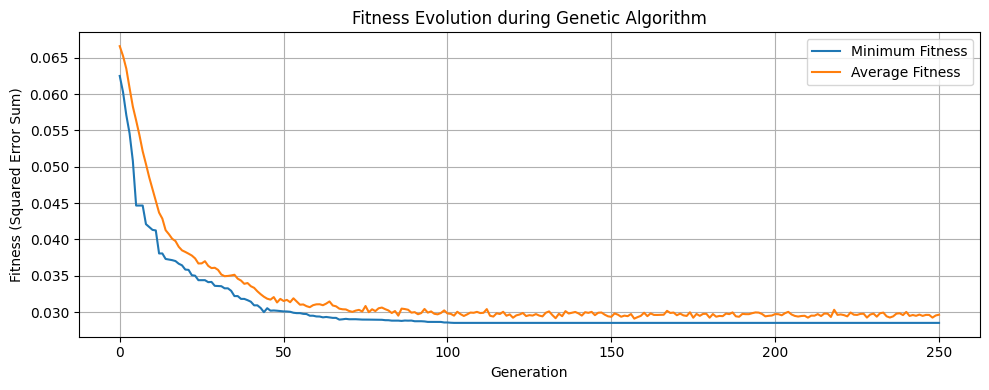

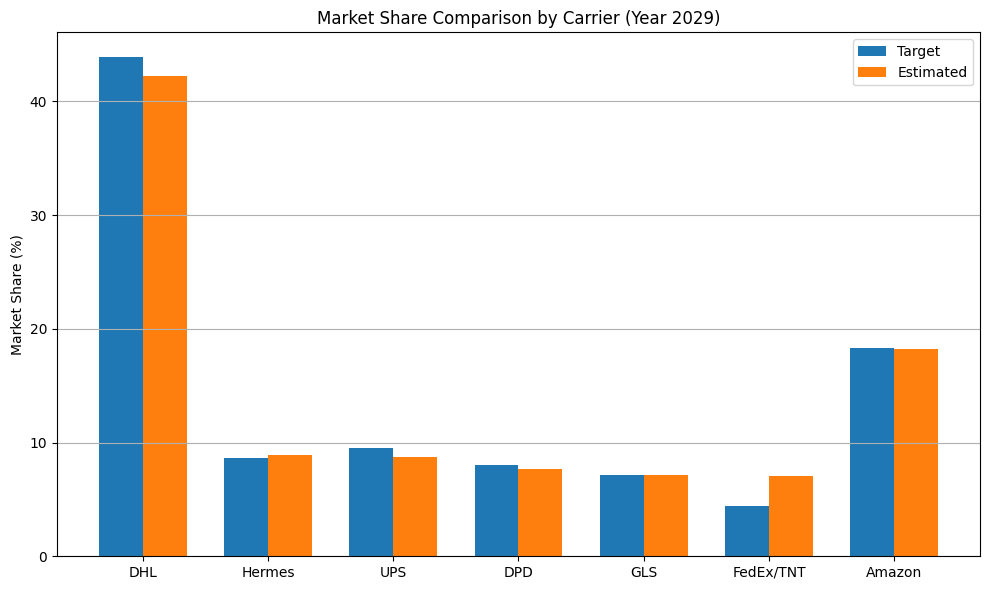

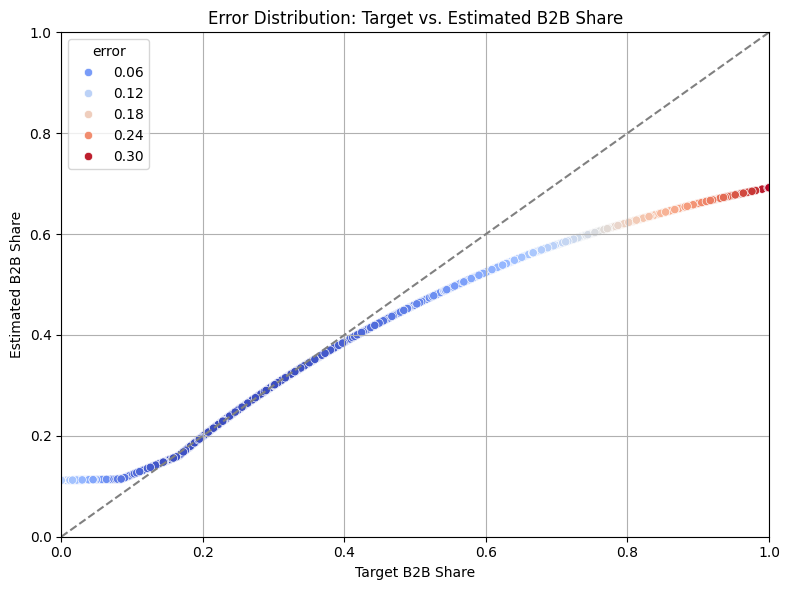


Weighted RMSE per cell: 0.0828
Estimated national B2B share (weighted): 0.2280
Target B2B share from input: 0.2043
Absolute deviation: 0.0237


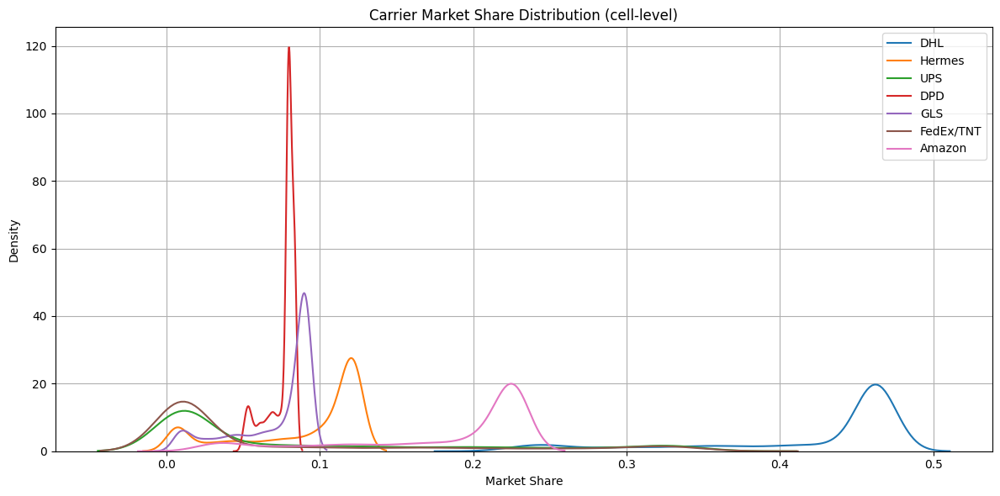

            mean    std  range
DHL        0.419  0.073  0.262
Hermes     0.090  0.041  0.117
UPS        0.089  0.108  0.346
DPD        0.076  0.009  0.035
GLS        0.071  0.027  0.085
FedEx/TNT  0.074  0.105  0.349
Amazon     0.181  0.064  0.214


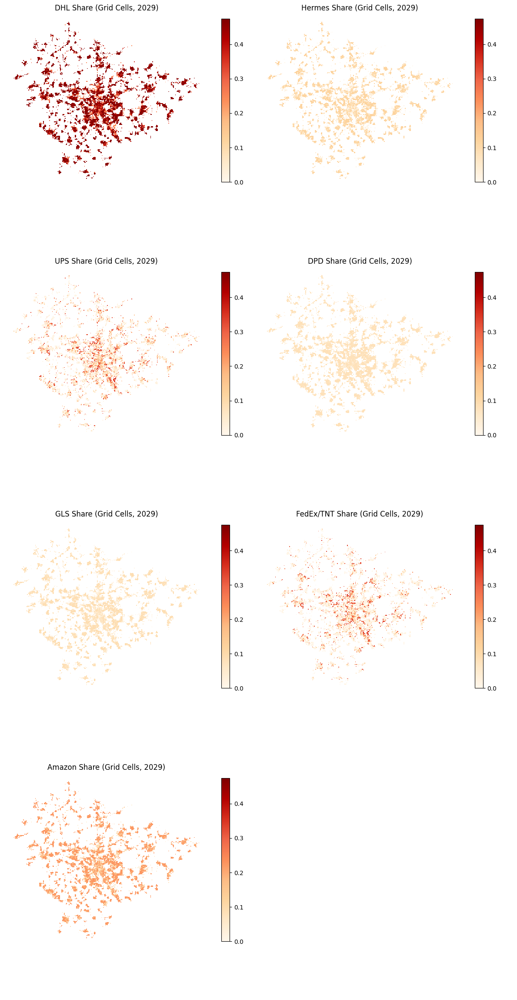

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

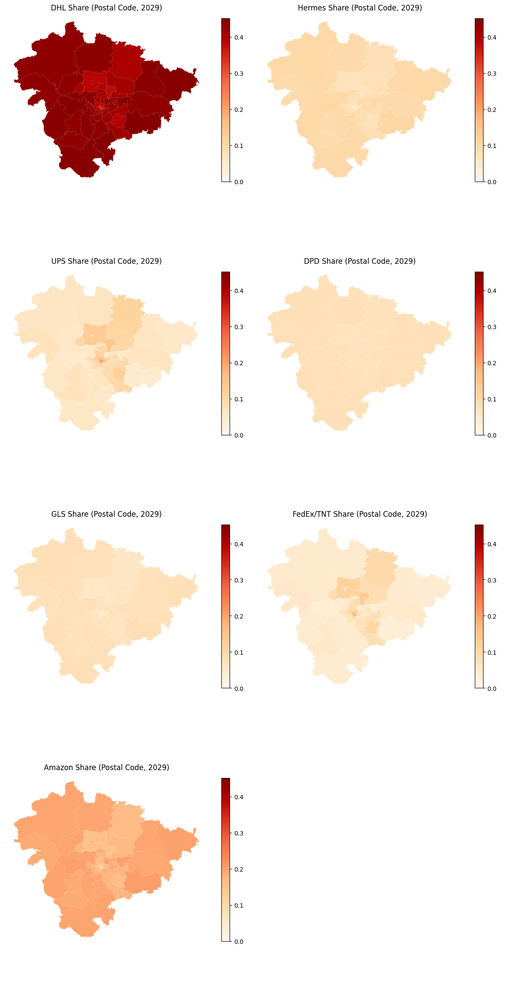

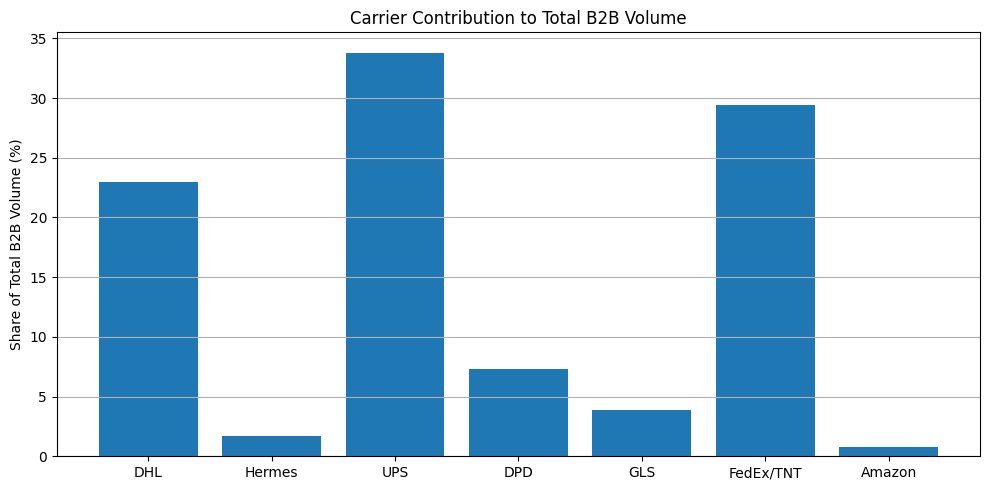

     Carrier  B2B Share (%)
2        UPS          33.81
5  FedEx/TNT          29.44
0        DHL          22.98
3        DPD           7.33
4        GLS           3.91
1     Hermes           1.73
6     Amazon           0.80


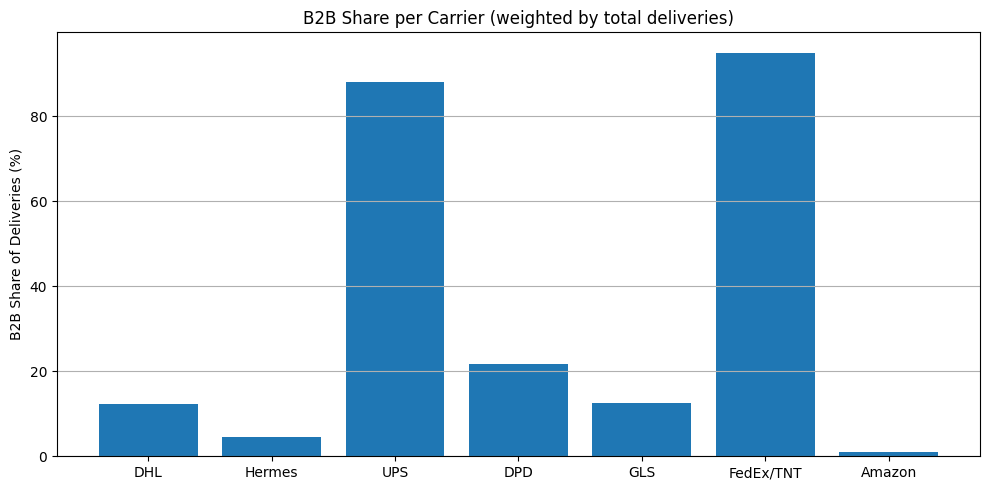

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
4        GLS          12.44
0        DHL          12.40
1     Hermes           4.44
6     Amazon           1.00
✅ Optimized B2B shares for 2029:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2029
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2030 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


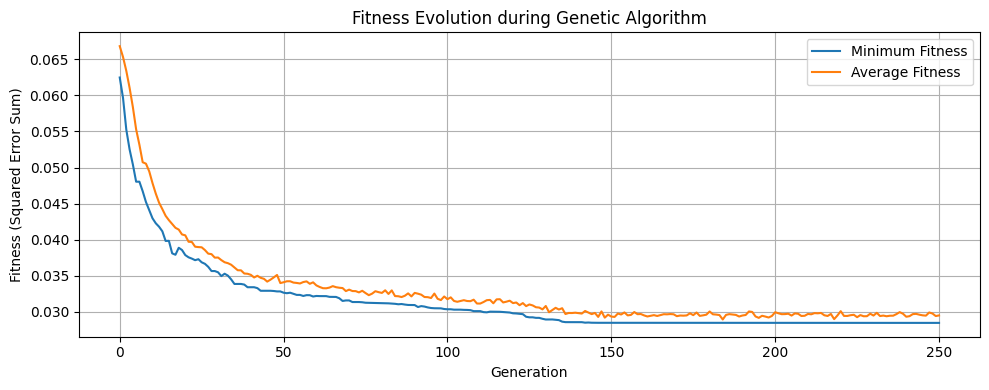

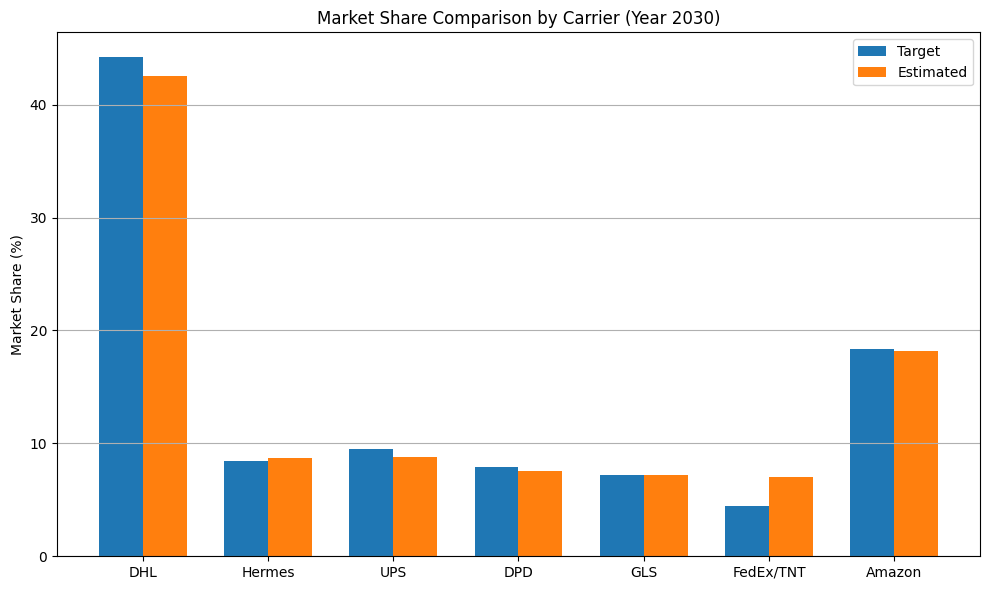

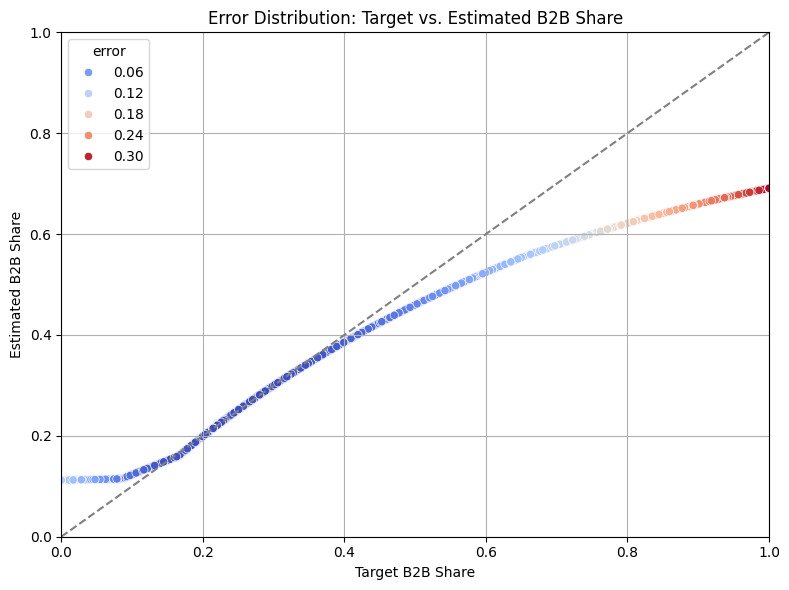


Weighted RMSE per cell: 0.0832
Estimated national B2B share (weighted): 0.2281
Target B2B share from input: 0.2031
Absolute deviation: 0.0249


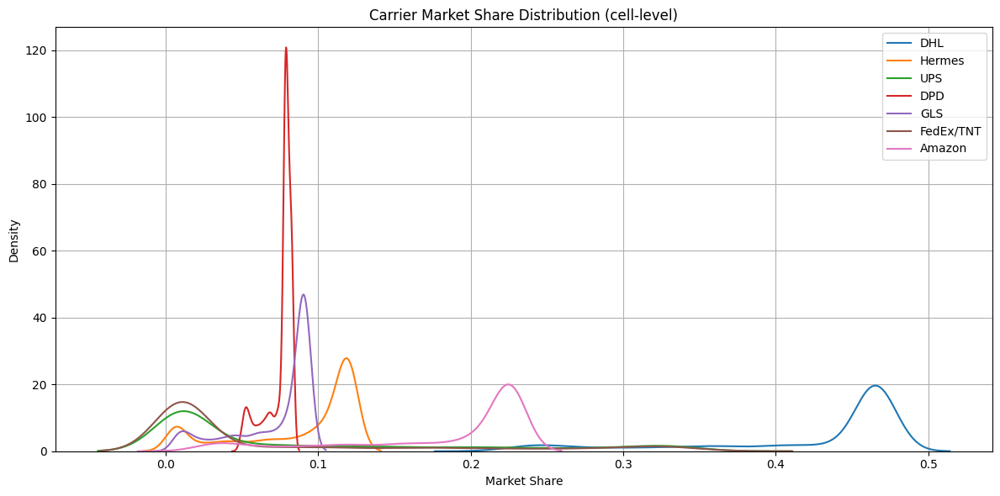

            mean    std  range
DHL        0.422  0.073  0.264
Hermes     0.088  0.041  0.114
UPS        0.088  0.108  0.345
DPD        0.075  0.009  0.035
GLS        0.072  0.027  0.086
FedEx/TNT  0.074  0.105  0.348
Amazon     0.181  0.064  0.213


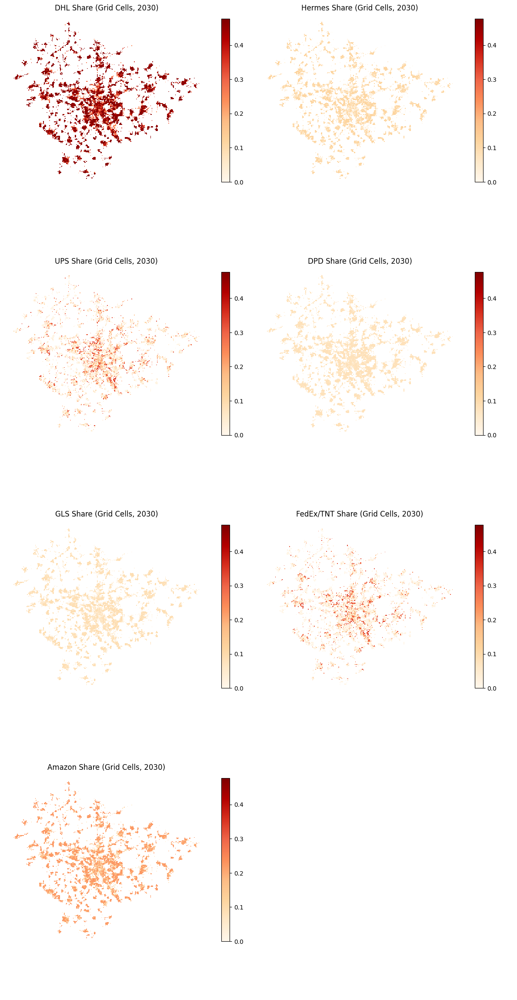

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

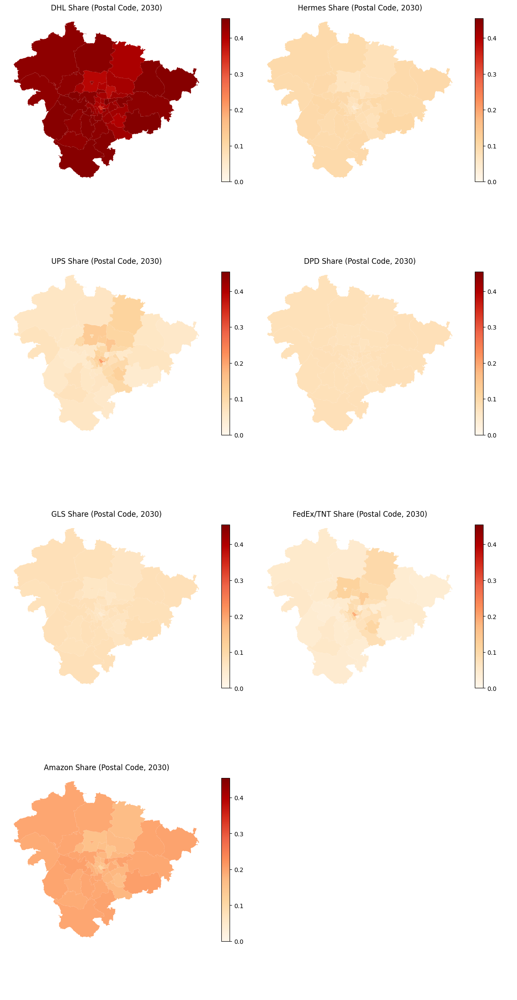

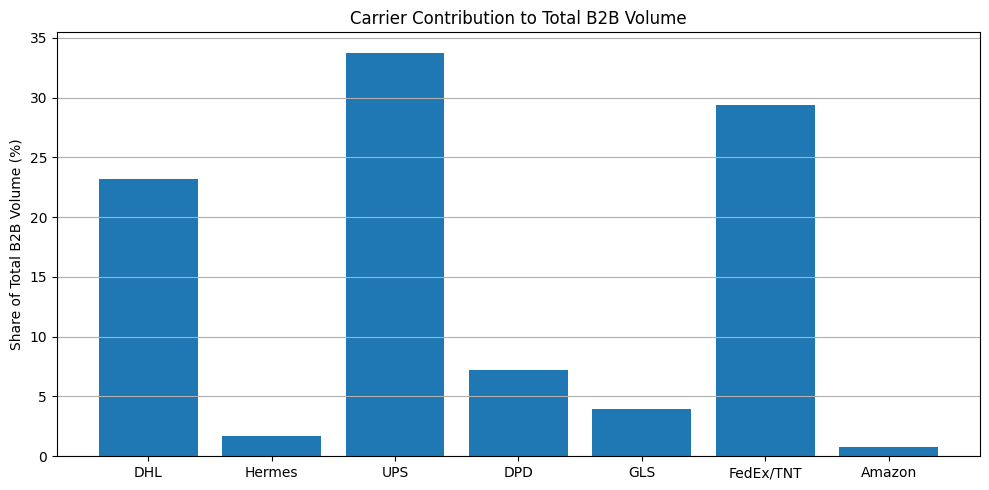

     Carrier  B2B Share (%)
2        UPS          33.76
5  FedEx/TNT          29.37
0        DHL          23.21
3        DPD           7.24
4        GLS           3.93
1     Hermes           1.69
6     Amazon           0.80


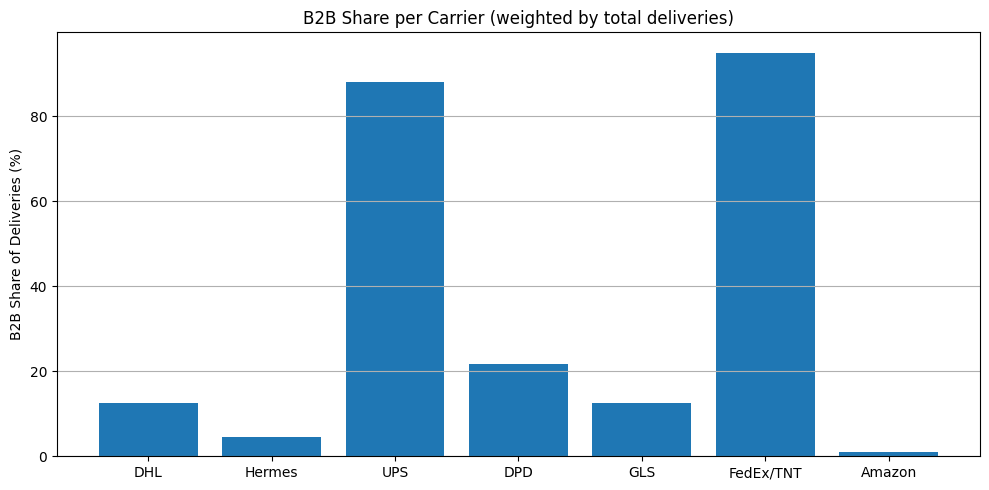

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00
✅ Optimized B2B shares for 2030:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2030
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2031 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


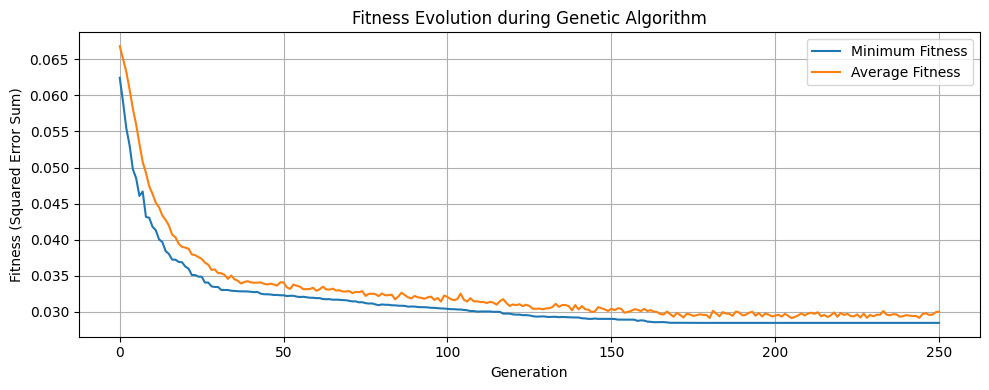

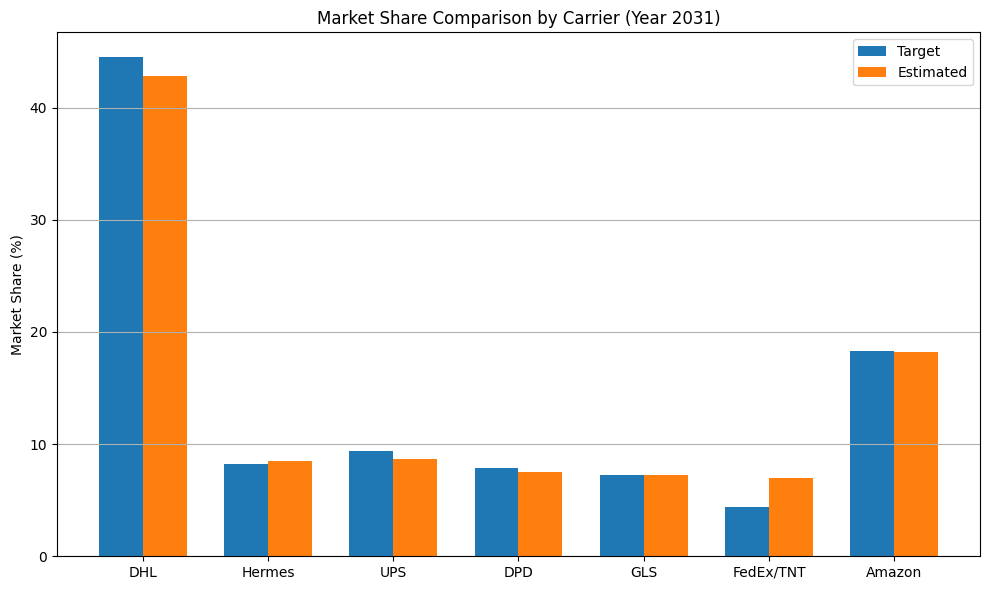

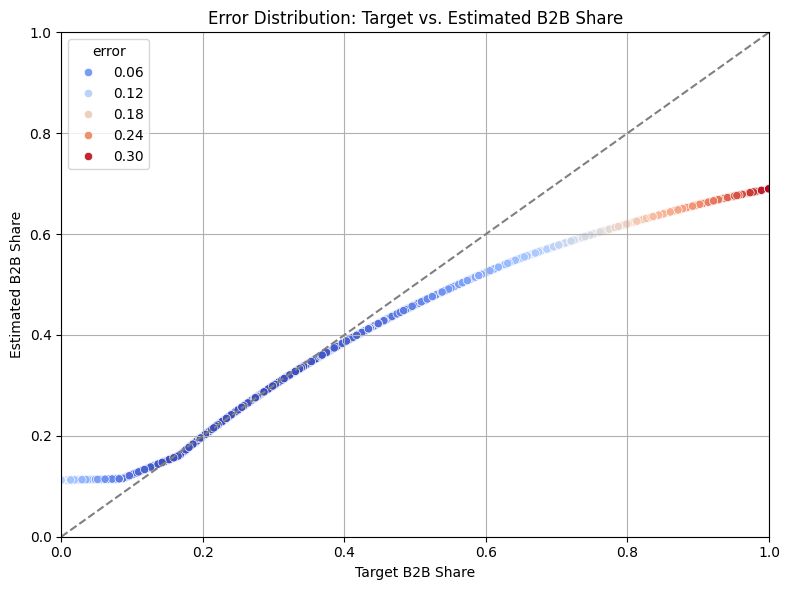


Weighted RMSE per cell: 0.0829
Estimated national B2B share (weighted): 0.2275
Target B2B share from input: 0.2022
Absolute deviation: 0.0252


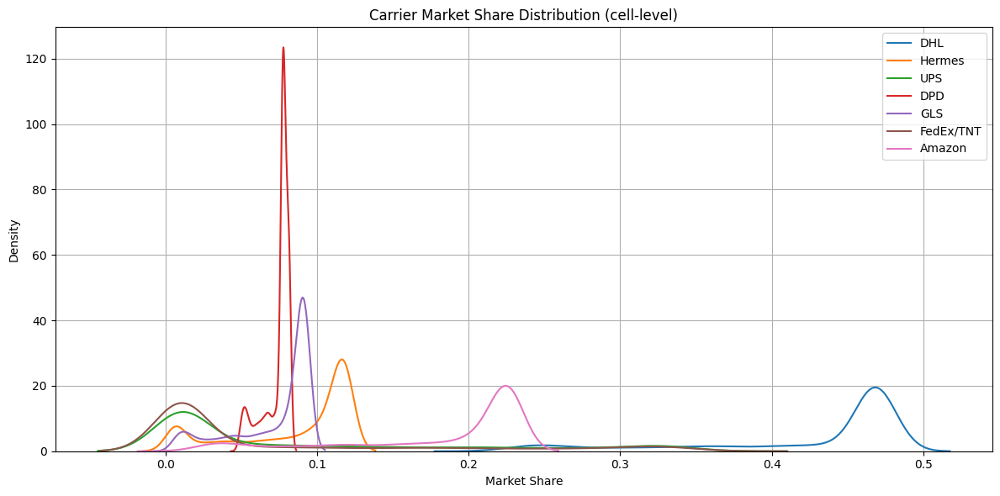

            mean    std  range
DHL        0.424  0.074  0.265
Hermes     0.086  0.040  0.112
UPS        0.088  0.108  0.345
DPD        0.074  0.009  0.034
GLS        0.072  0.027  0.086
FedEx/TNT  0.074  0.105  0.347
Amazon     0.181  0.064  0.213


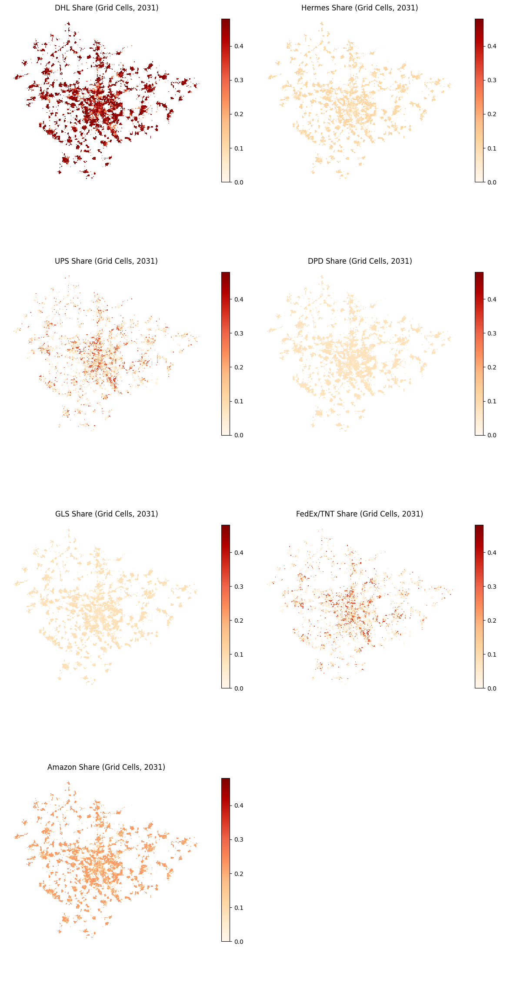

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

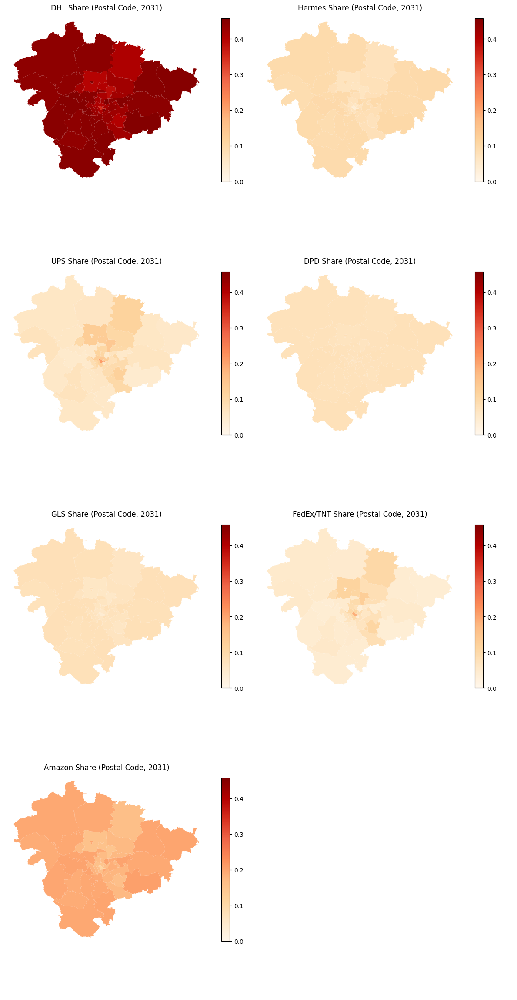

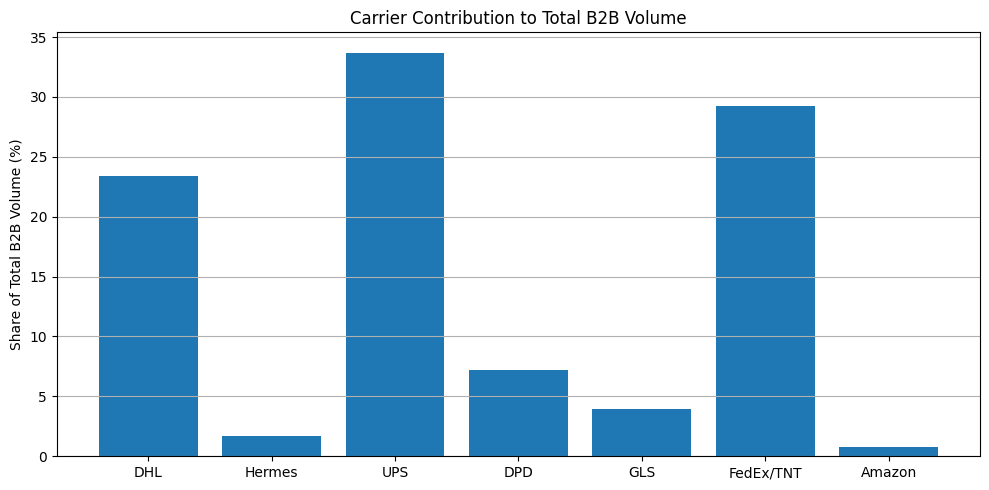

     Carrier  B2B Share (%)
2        UPS          33.70
5  FedEx/TNT          29.27
0        DHL          23.42
3        DPD           7.17
4        GLS           3.96
1     Hermes           1.67
6     Amazon           0.80


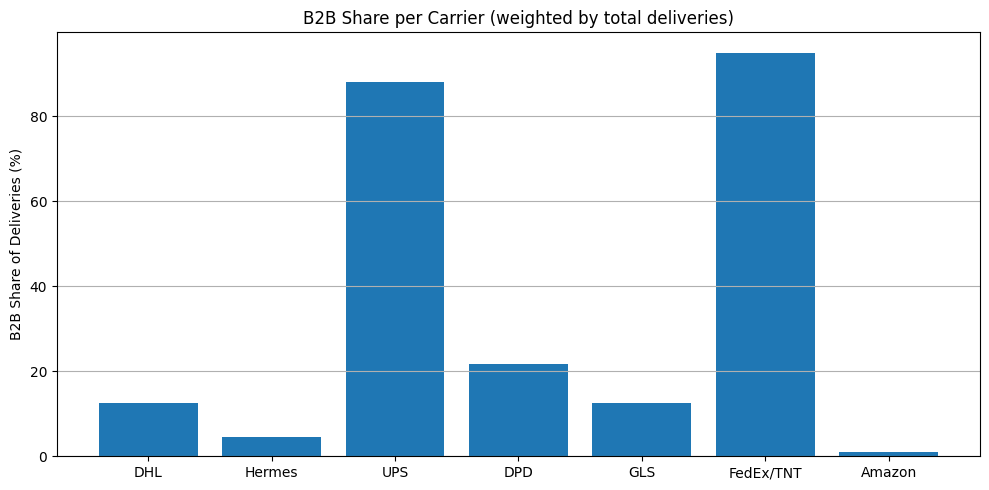

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00
✅ Optimized B2B shares for 2031:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2031
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2032 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


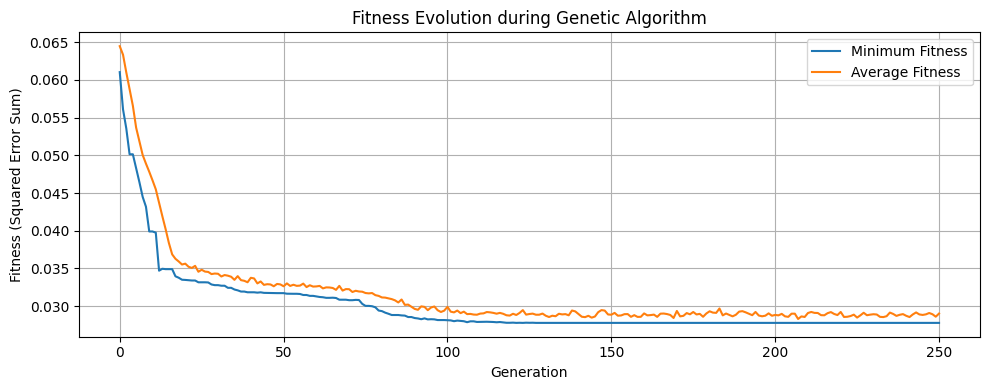

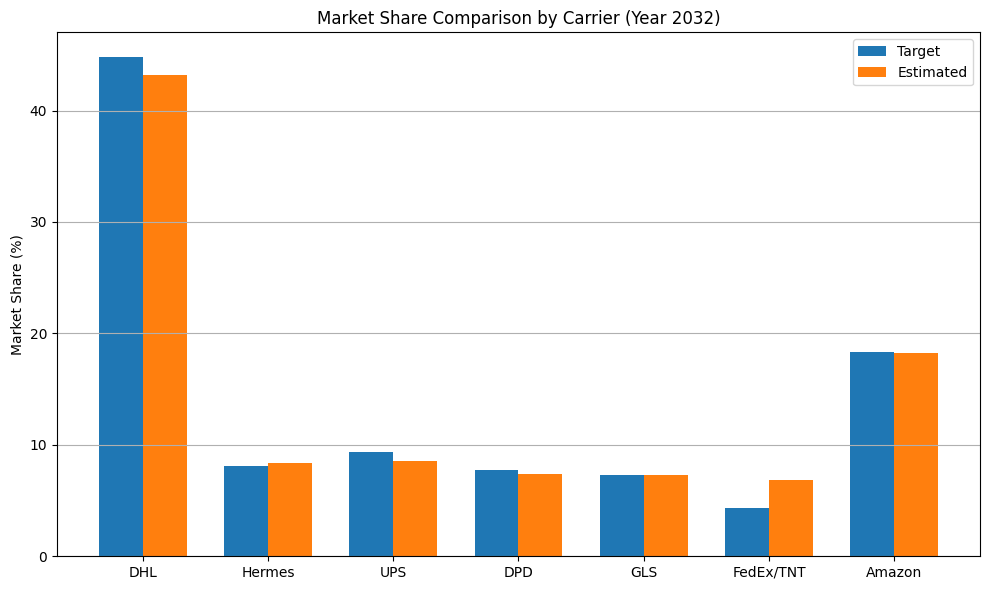

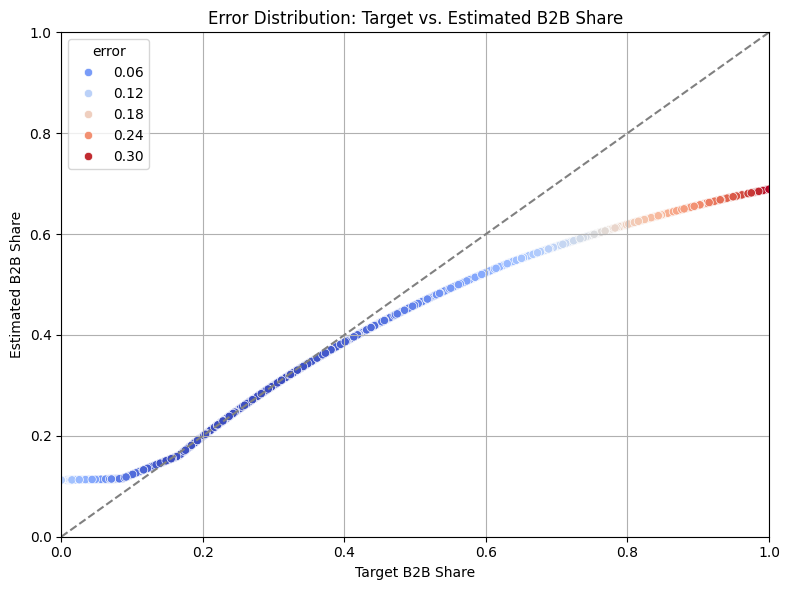


Weighted RMSE per cell: 0.0805
Estimated national B2B share (weighted): 0.2245
Target B2B share from input: 0.2016
Absolute deviation: 0.0229


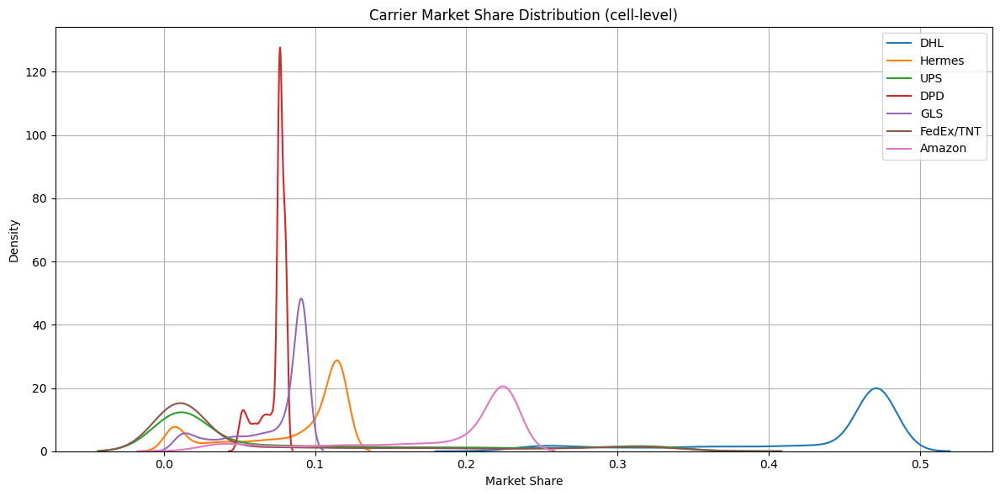

            mean    std  range
DHL        0.428  0.073  0.267
Hermes     0.085  0.039  0.111
UPS        0.086  0.106  0.344
DPD        0.073  0.008  0.034
GLS        0.073  0.026  0.086
FedEx/TNT  0.072  0.102  0.347
Amazon     0.182  0.062  0.213


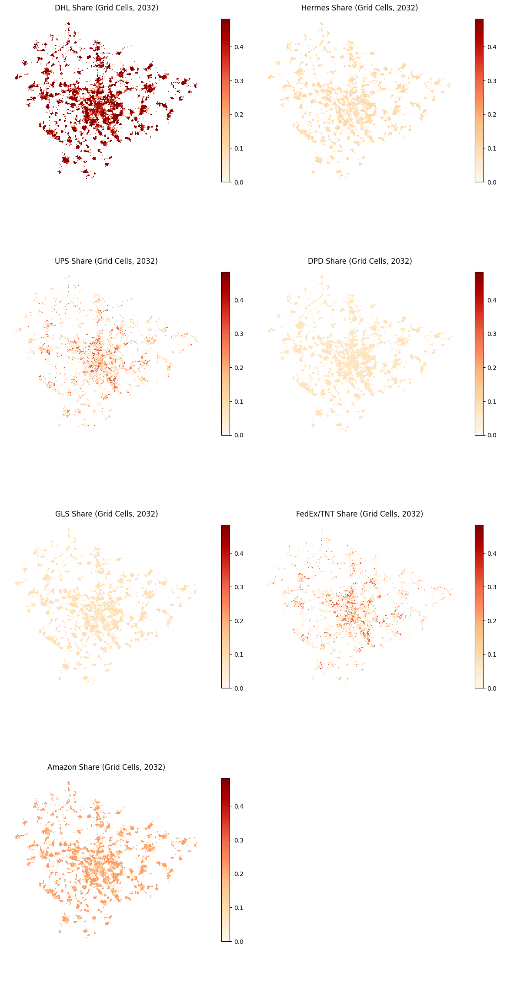

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

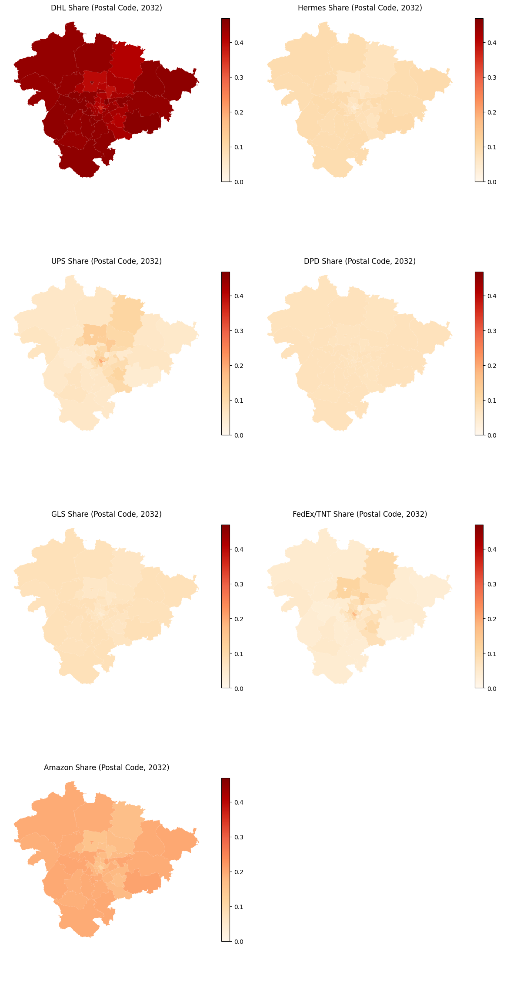

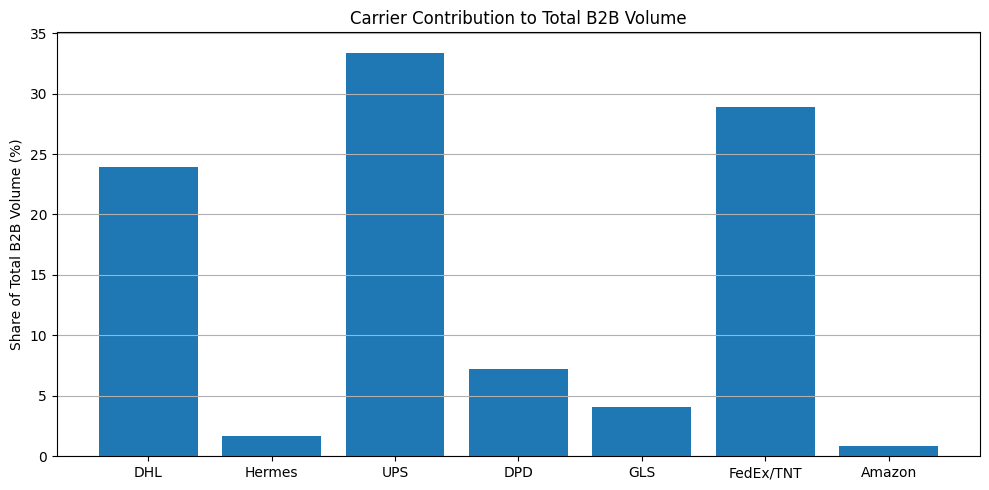

     Carrier  B2B Share (%)
2        UPS          33.40
5  FedEx/TNT          28.93
0        DHL          23.94
3        DPD           7.20
4        GLS           4.06
1     Hermes           1.66
6     Amazon           0.81


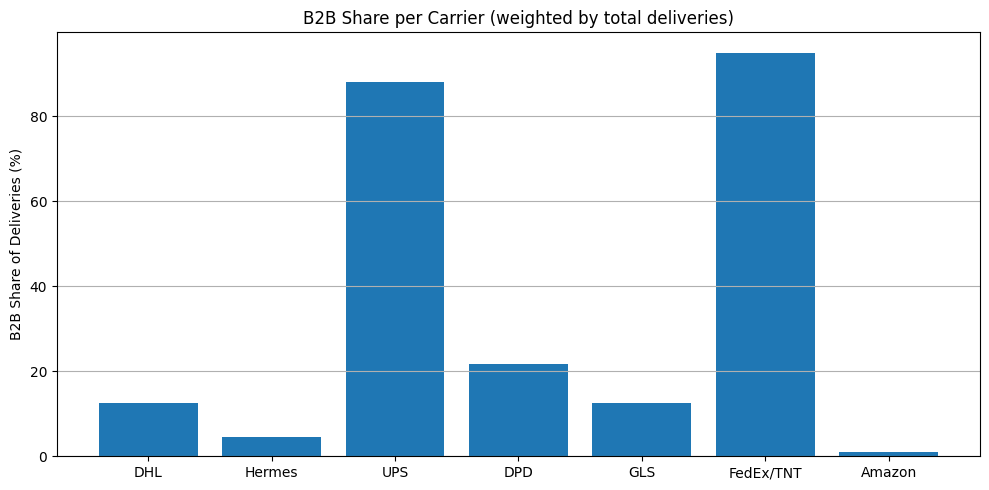

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00
✅ Optimized B2B shares for 2032:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2032
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2033 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


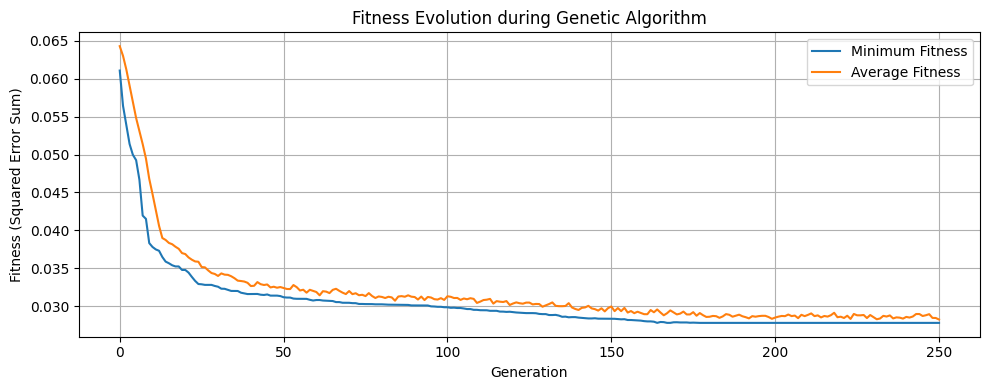

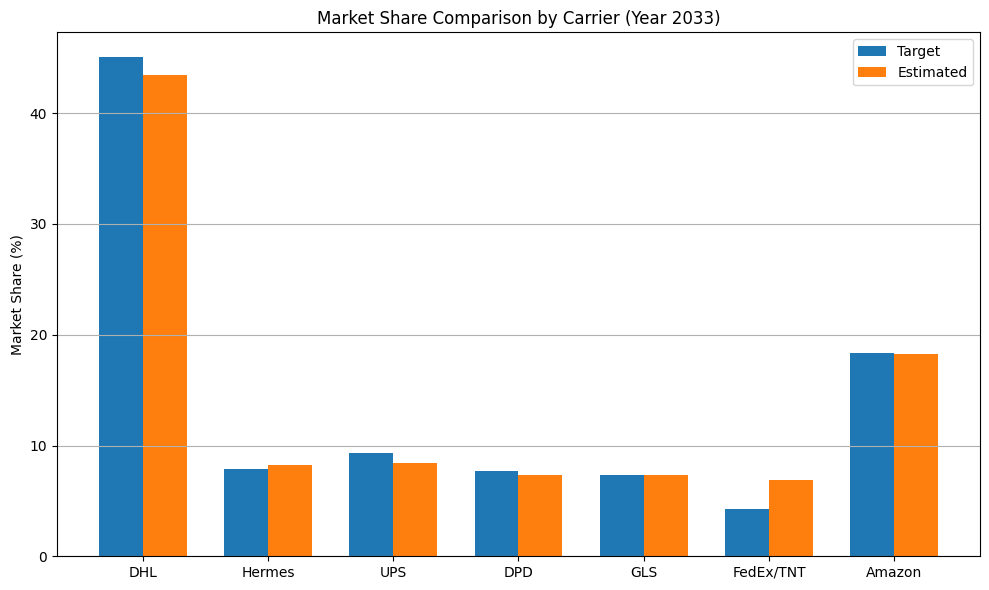

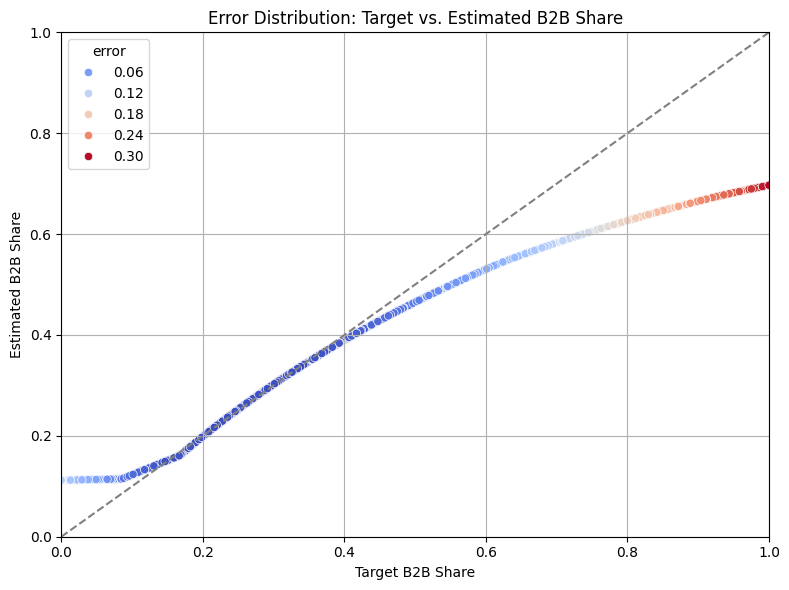


Weighted RMSE per cell: 0.0790
Estimated national B2B share (weighted): 0.2253
Target B2B share from input: 0.2012
Absolute deviation: 0.0241


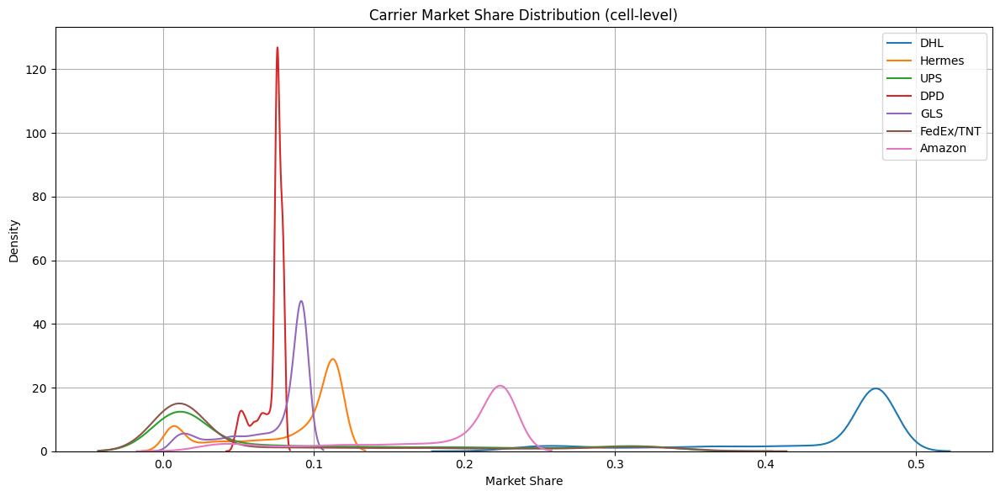

            mean    std  range
DHL        0.430  0.073  0.270
Hermes     0.083  0.039  0.109
UPS        0.086  0.105  0.341
DPD        0.073  0.008  0.034
GLS        0.073  0.027  0.087
FedEx/TNT  0.073  0.104  0.352
Amazon     0.182  0.062  0.212


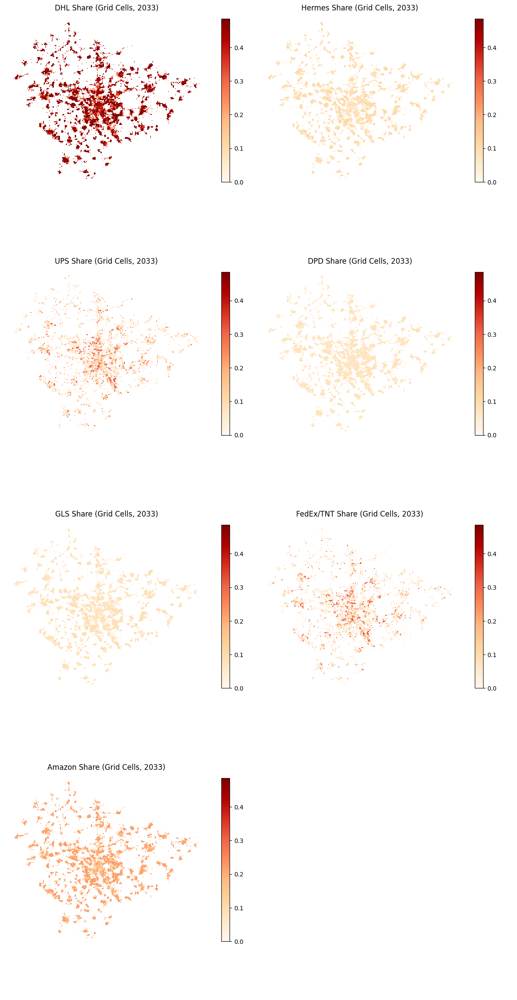

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

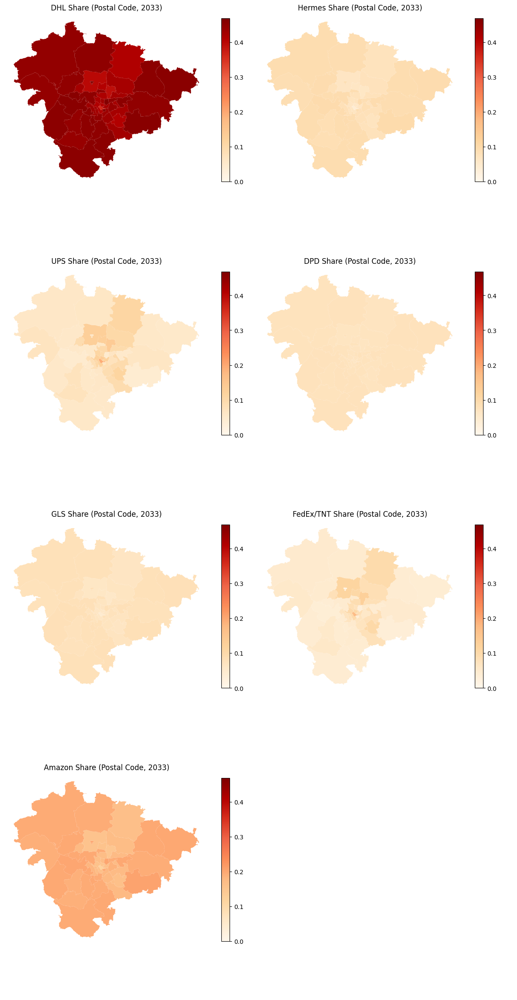

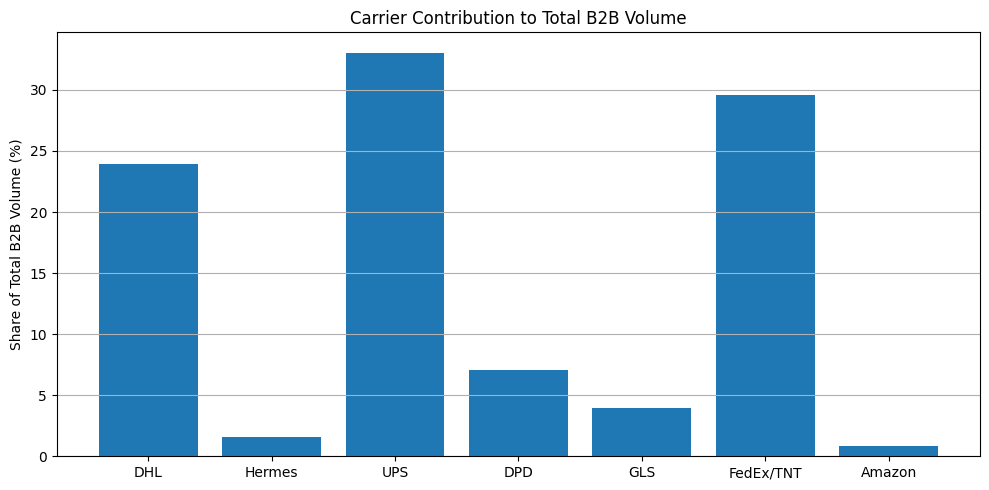

     Carrier  B2B Share (%)
2        UPS          33.06
5  FedEx/TNT          29.56
0        DHL          23.90
3        DPD           7.08
4        GLS           3.98
1     Hermes           1.60
6     Amazon           0.81


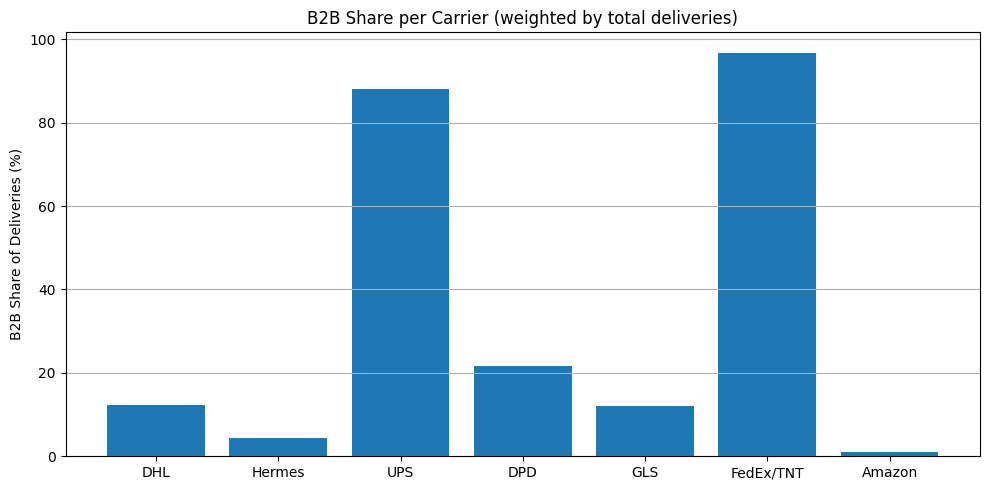

     Carrier  B2B Share (%)
5  FedEx/TNT          96.80
2        UPS          88.01
3        DPD          21.75
0        DHL          12.40
4        GLS          12.16
1     Hermes           4.37
6     Amazon           1.00
✅ Optimized B2B shares for 2033:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.217
  GLS: 0.122
  FedEx/TNT: 0.968
  Amazon: 0.010
✅ DONE — Year 2033
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2034 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


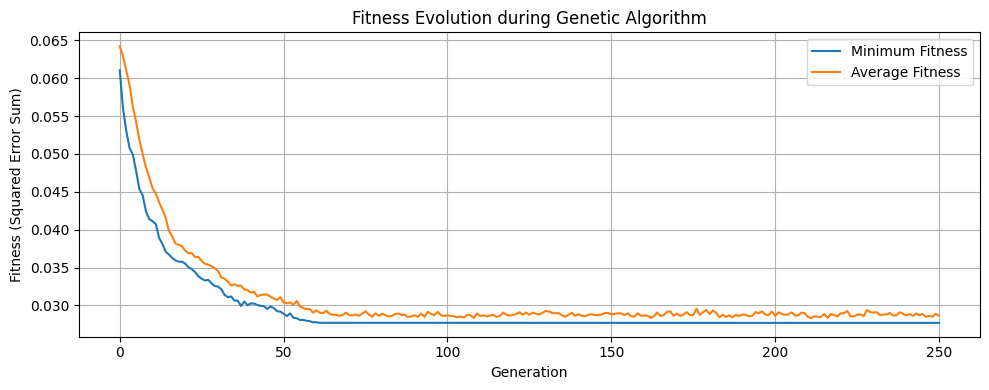

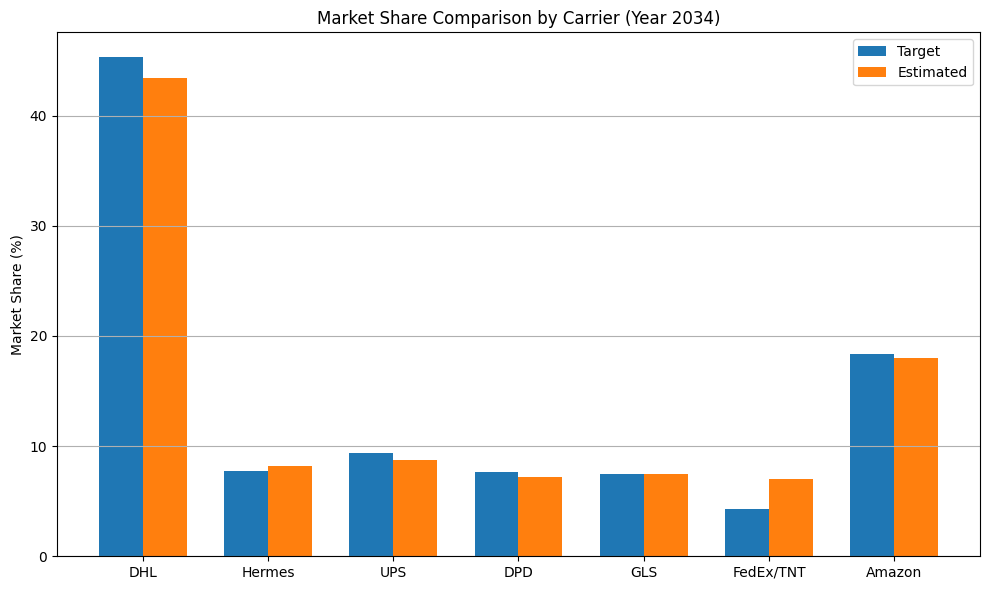

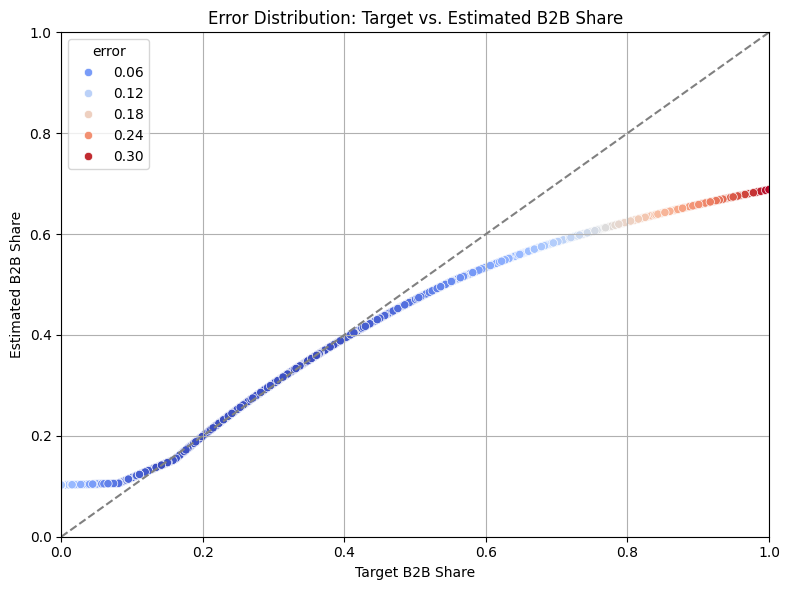


Weighted RMSE per cell: 0.0743
Estimated national B2B share (weighted): 0.2211
Target B2B share from input: 0.2008
Absolute deviation: 0.0202


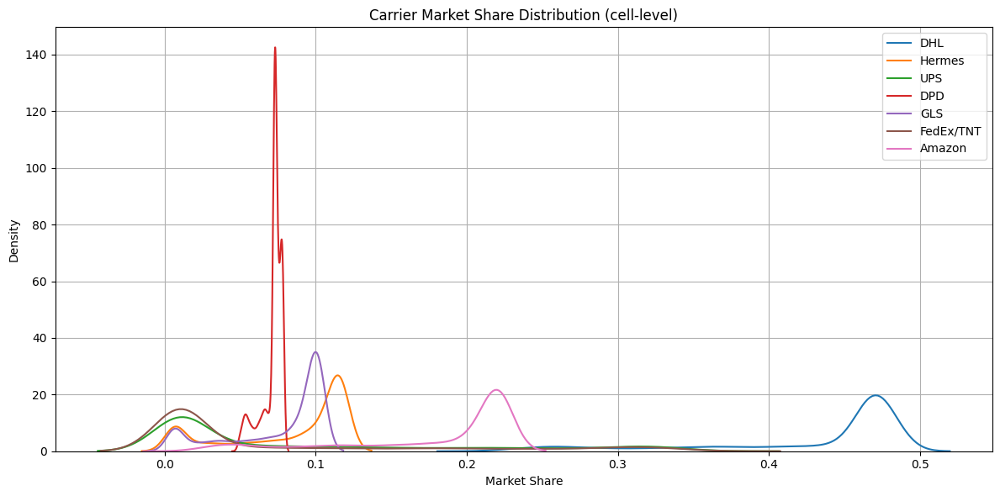

            mean    std  range
DHL        0.430  0.071  0.267
Hermes     0.083  0.041  0.111
UPS        0.088  0.107  0.343
DPD        0.071  0.007  0.030
GLS        0.075  0.033  0.096
FedEx/TNT  0.074  0.103  0.345
Amazon     0.179  0.060  0.206


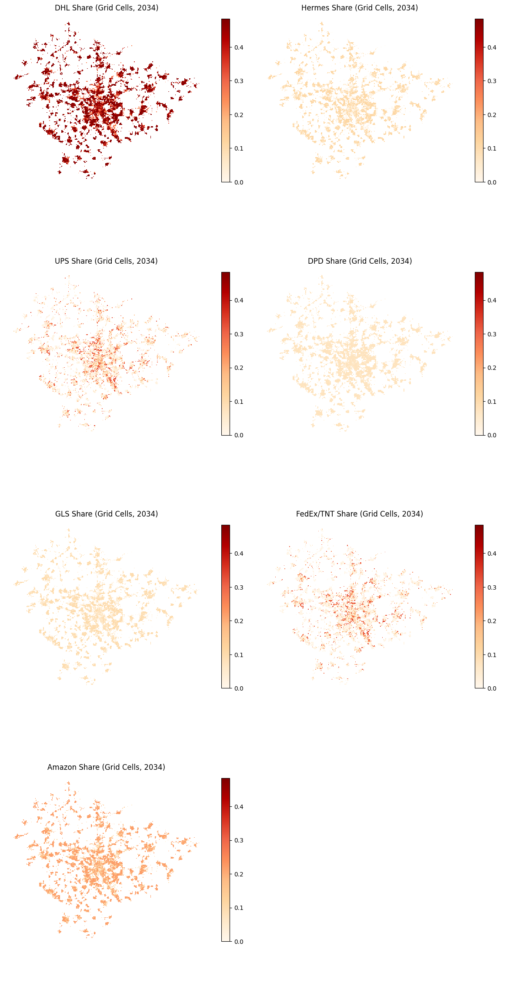

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

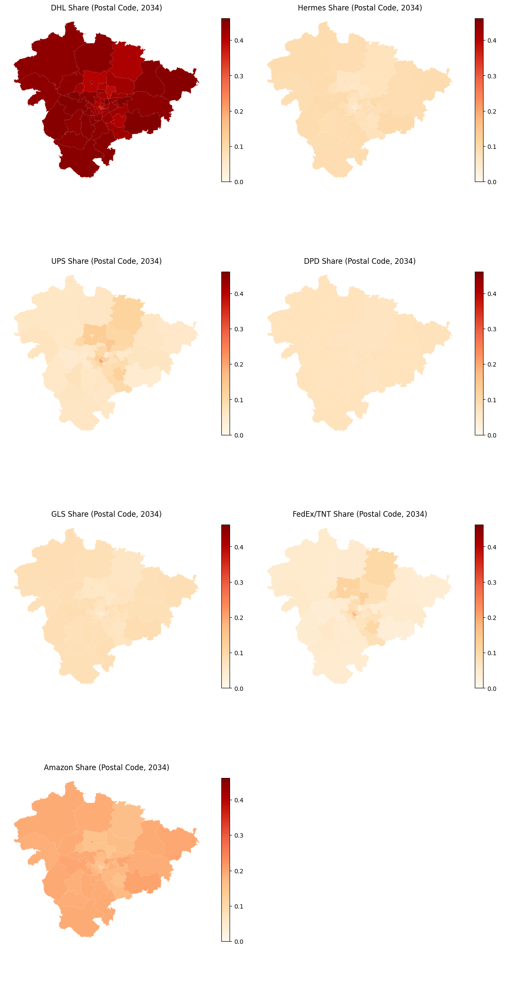

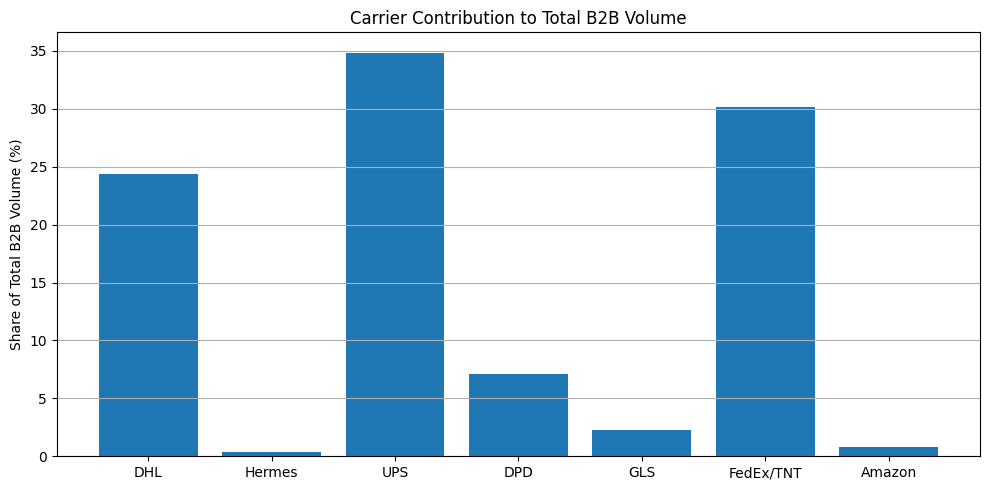

     Carrier  B2B Share (%)
2        UPS          34.86
5  FedEx/TNT          30.20
0        DHL          24.37
3        DPD           7.09
4        GLS           2.31
6     Amazon           0.81
1     Hermes           0.37


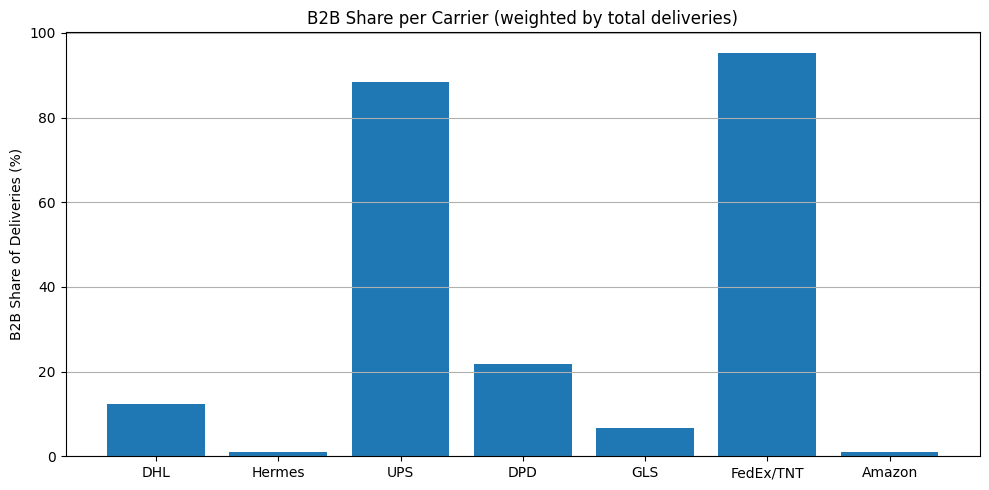

     Carrier  B2B Share (%)
5  FedEx/TNT          95.35
2        UPS          88.34
3        DPD          21.72
0        DHL          12.42
4        GLS           6.79
1     Hermes           1.00
6     Amazon           1.00
✅ Optimized B2B shares for 2034:
  DHL: 0.124
  Hermes: 0.010
  UPS: 0.883
  DPD: 0.217
  GLS: 0.068
  FedEx/TNT: 0.954
  Amazon: 0.010
✅ DONE — Year 2034
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2035 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


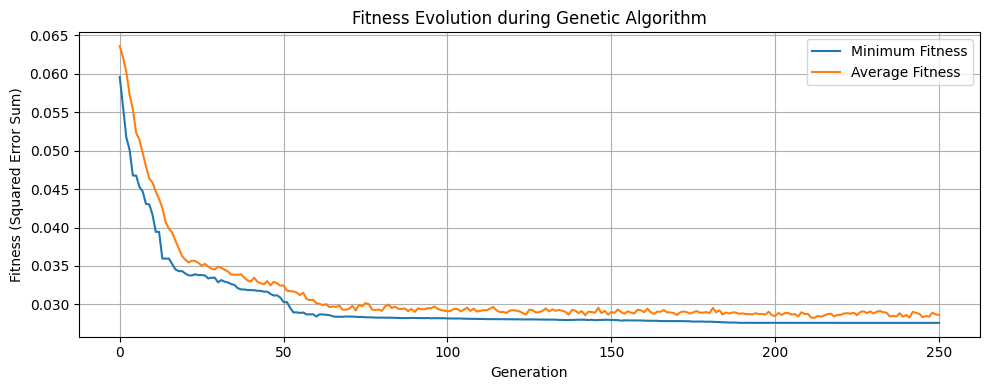

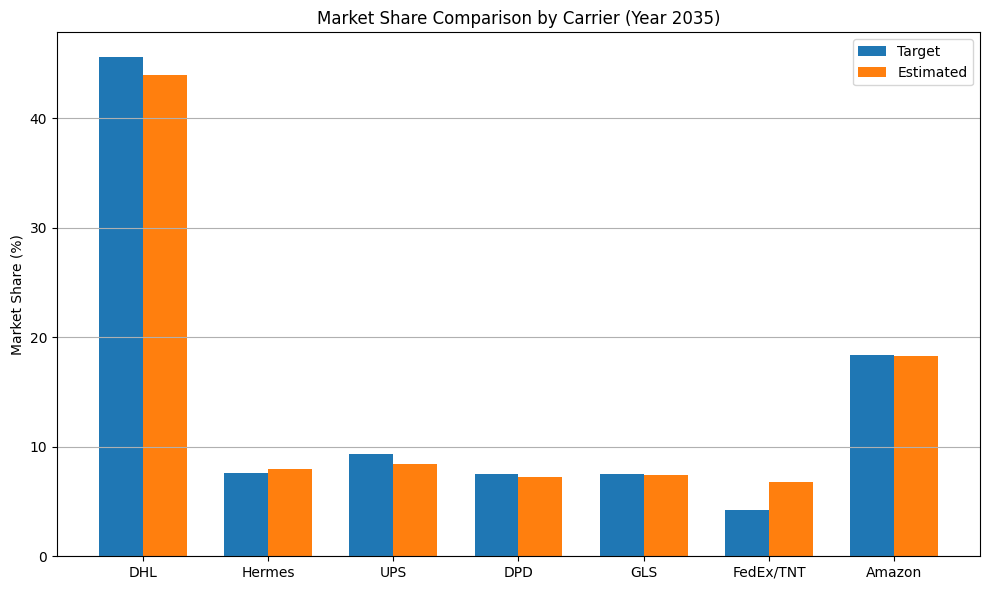

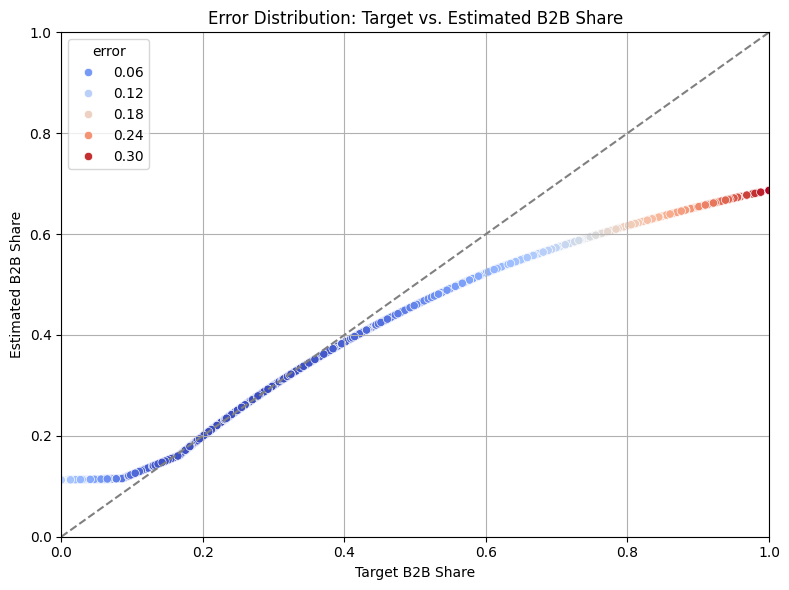


Weighted RMSE per cell: 0.0815
Estimated national B2B share (weighted): 0.2235
Target B2B share from input: 0.2006
Absolute deviation: 0.0229


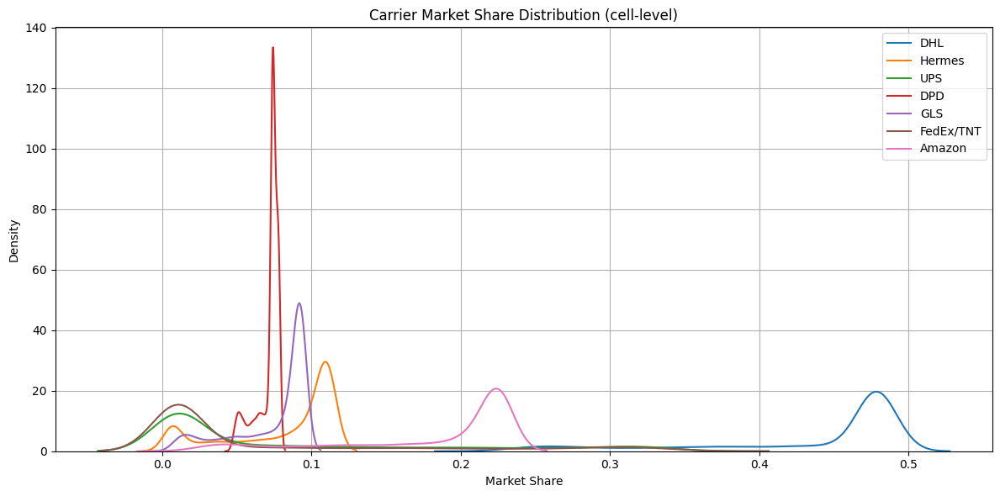

            mean    std  range
DHL        0.435  0.073  0.271
Hermes     0.081  0.038  0.105
UPS        0.086  0.105  0.343
DPD        0.071  0.008  0.032
GLS        0.074  0.026  0.087
FedEx/TNT  0.071  0.101  0.345
Amazon     0.182  0.062  0.212


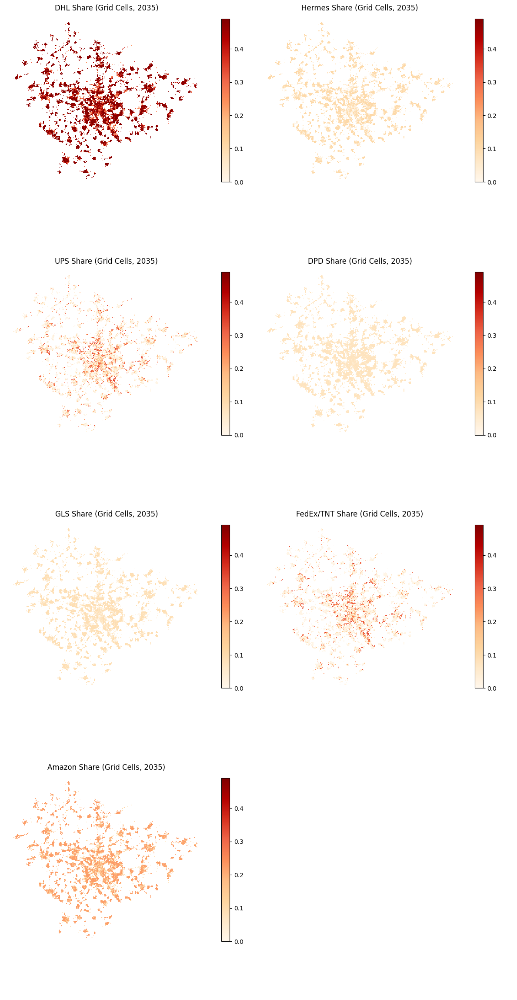

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

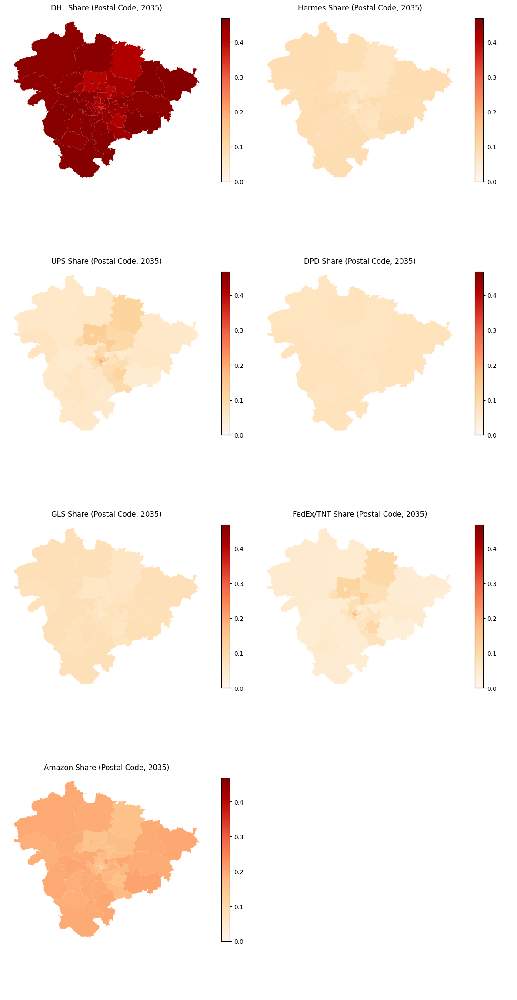

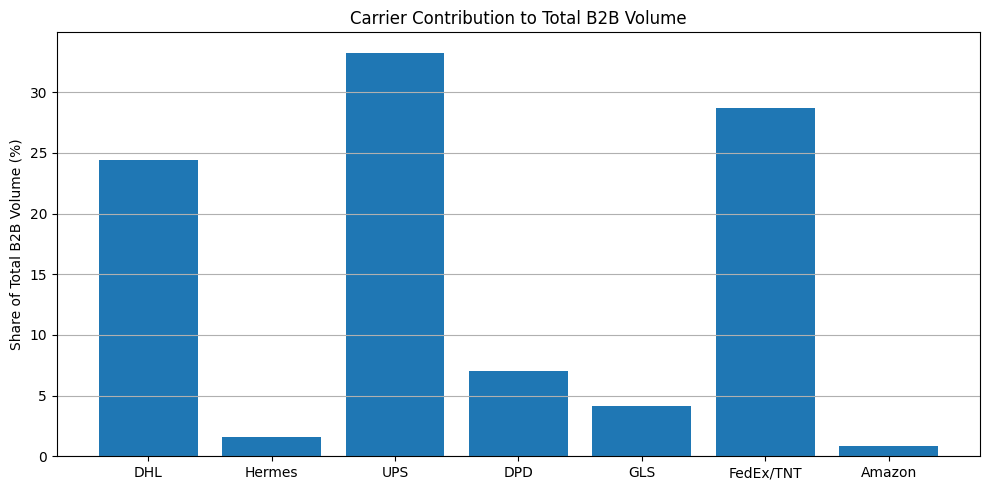

     Carrier  B2B Share (%)
2        UPS          33.28
5  FedEx/TNT          28.72
0        DHL          24.44
3        DPD           7.01
4        GLS           4.14
1     Hermes           1.59
6     Amazon           0.82


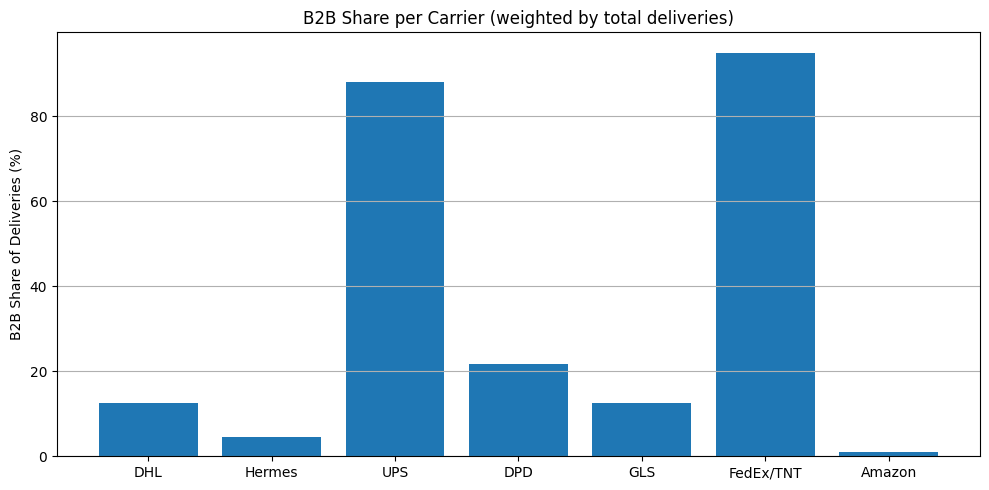

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00
✅ Optimized B2B shares for 2035:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2035
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2036 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


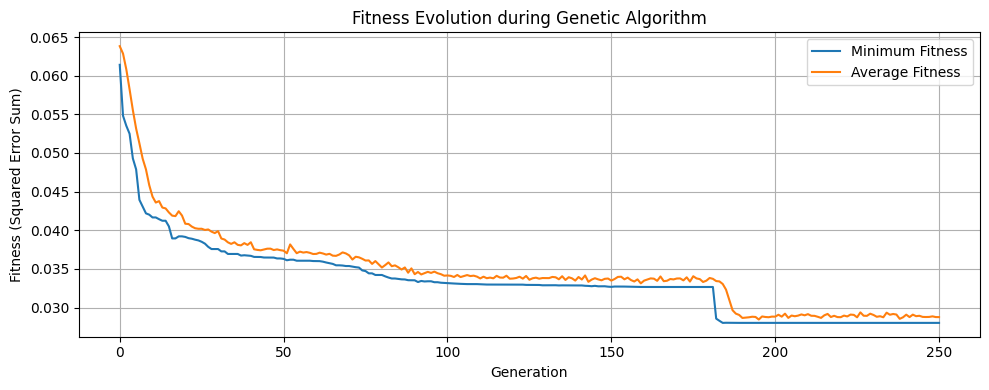

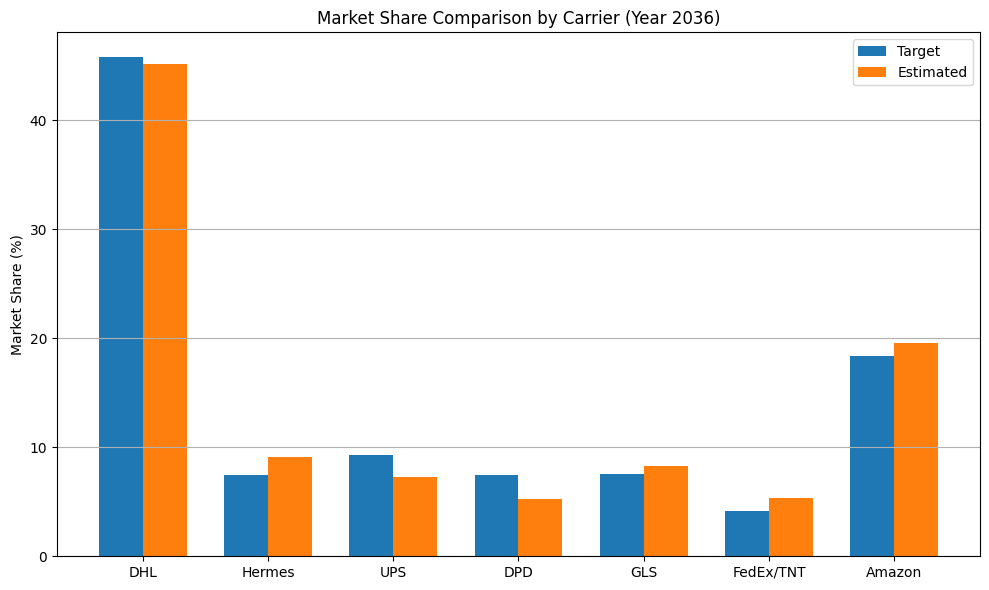

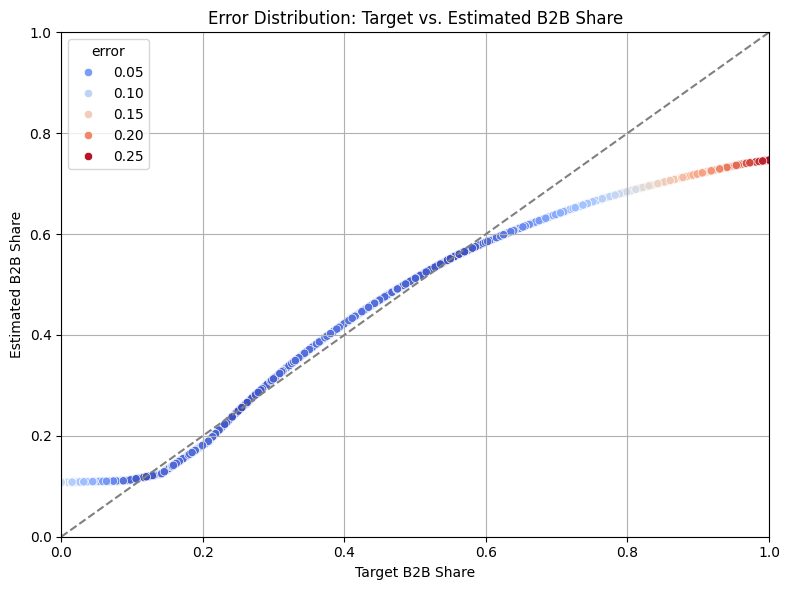


Weighted RMSE per cell: 0.0679
Estimated national B2B share (weighted): 0.2302
Target B2B share from input: 0.2004
Absolute deviation: 0.0298


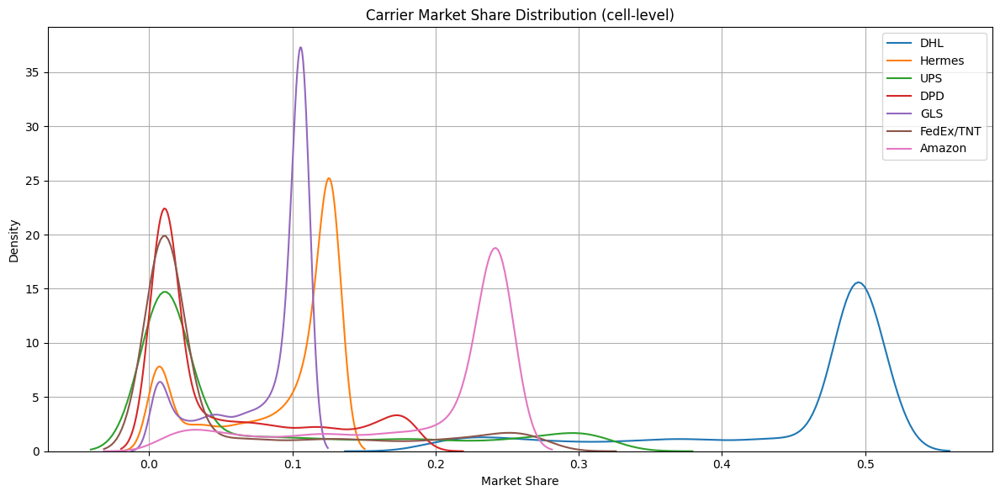

            mean    std  range
DHL        0.446  0.090  0.331
Hermes     0.092  0.045  0.123
UPS        0.075  0.101  0.319
DPD        0.053  0.059  0.180
GLS        0.082  0.034  0.102
FedEx/TNT  0.057  0.082  0.274
Amazon     0.194  0.073  0.240


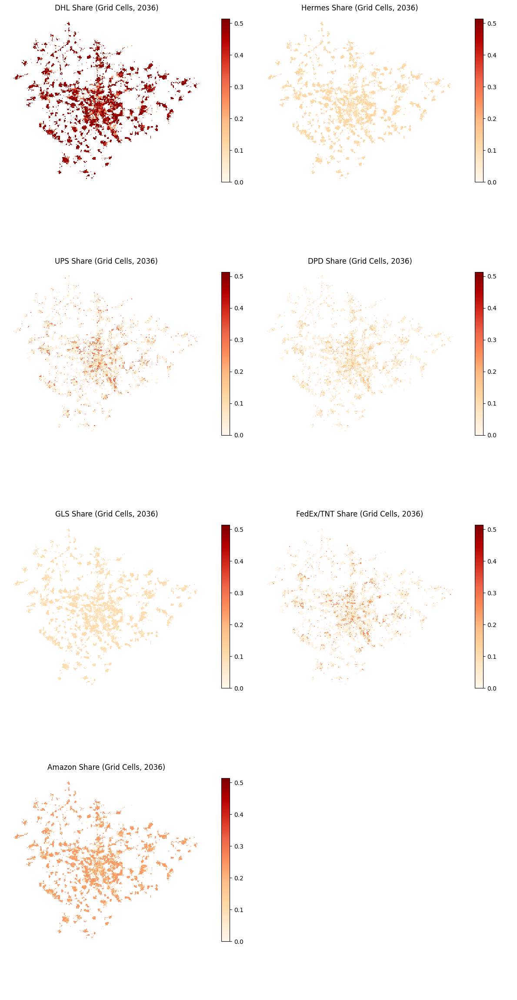

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

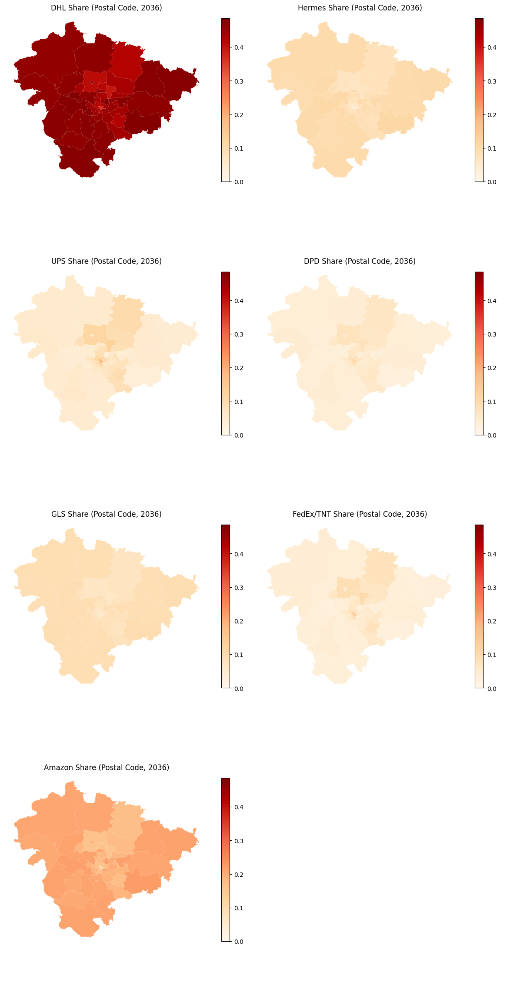

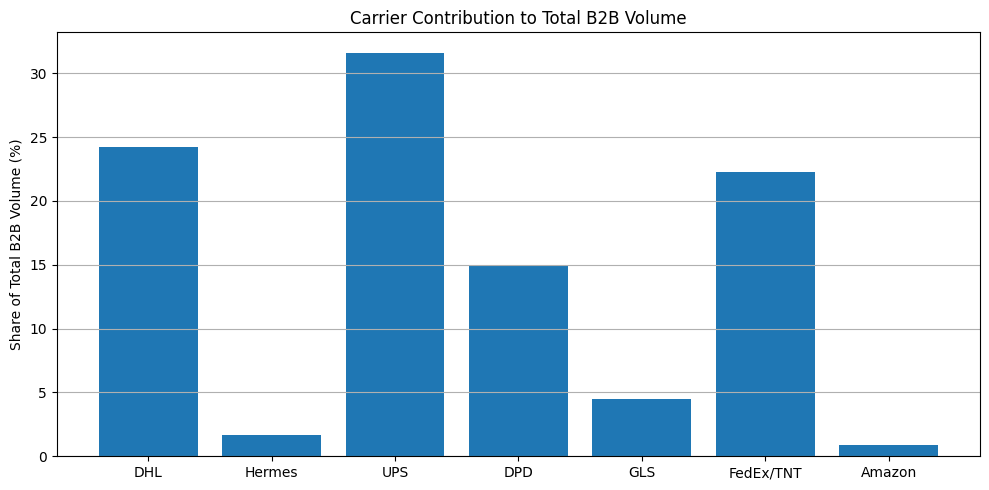

     Carrier  B2B Share (%)
2        UPS          31.63
0        DHL          24.21
5  FedEx/TNT          22.25
3        DPD          14.96
4        GLS           4.47
1     Hermes           1.64
6     Amazon           0.85


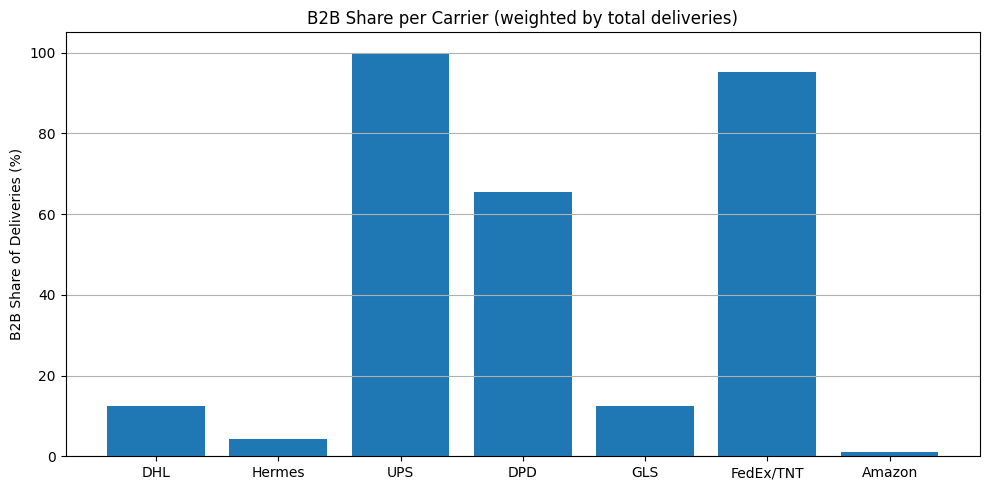

     Carrier  B2B Share (%)
2        UPS         100.00
5  FedEx/TNT          95.07
3        DPD          65.53
4        GLS          12.44
0        DHL          12.35
1     Hermes           4.17
6     Amazon           1.00
✅ Optimized B2B shares for 2036:
  DHL: 0.123
  Hermes: 0.042
  UPS: 1.000
  DPD: 0.655
  GLS: 0.124
  FedEx/TNT: 0.951
  Amazon: 0.010
✅ DONE — Year 2036
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2037 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


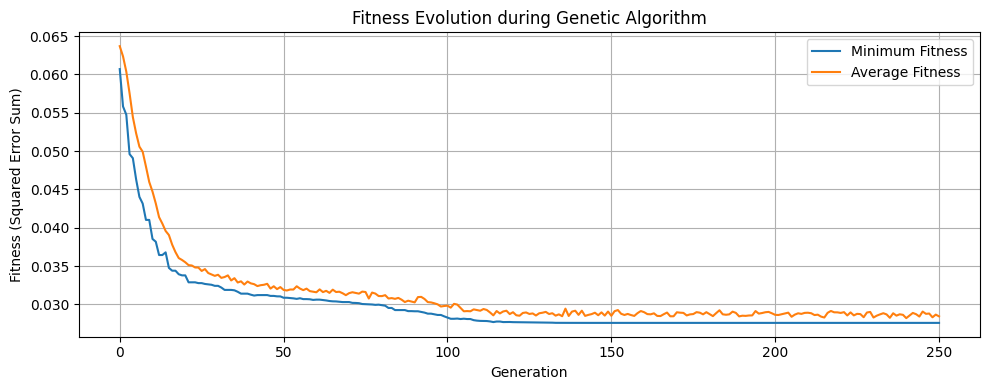

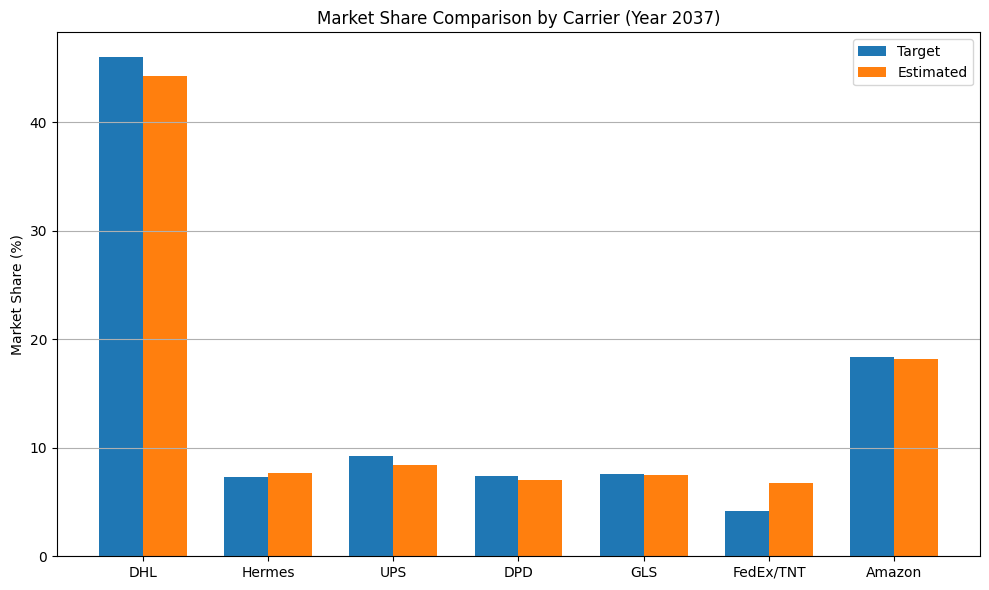

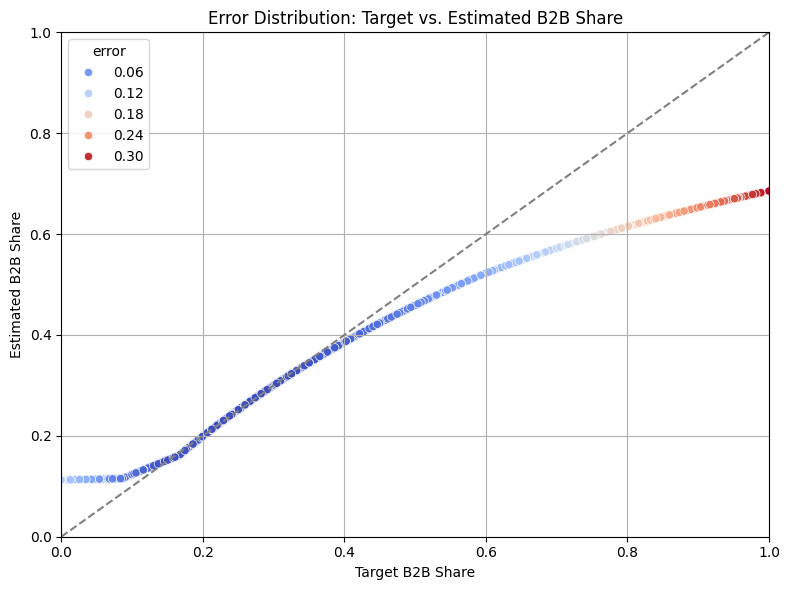


Weighted RMSE per cell: 0.0820
Estimated national B2B share (weighted): 0.2233
Target B2B share from input: 0.2003
Absolute deviation: 0.0230


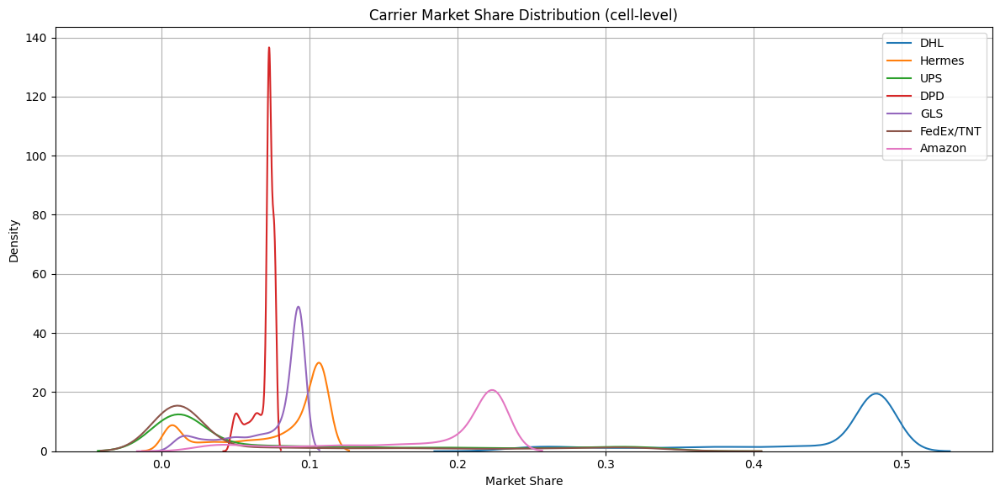

            mean    std  range
DHL        0.439  0.074  0.273
Hermes     0.078  0.037  0.102
UPS        0.085  0.105  0.342
DPD        0.070  0.008  0.031
GLS        0.075  0.026  0.088
FedEx/TNT  0.071  0.101  0.344
Amazon     0.182  0.062  0.211


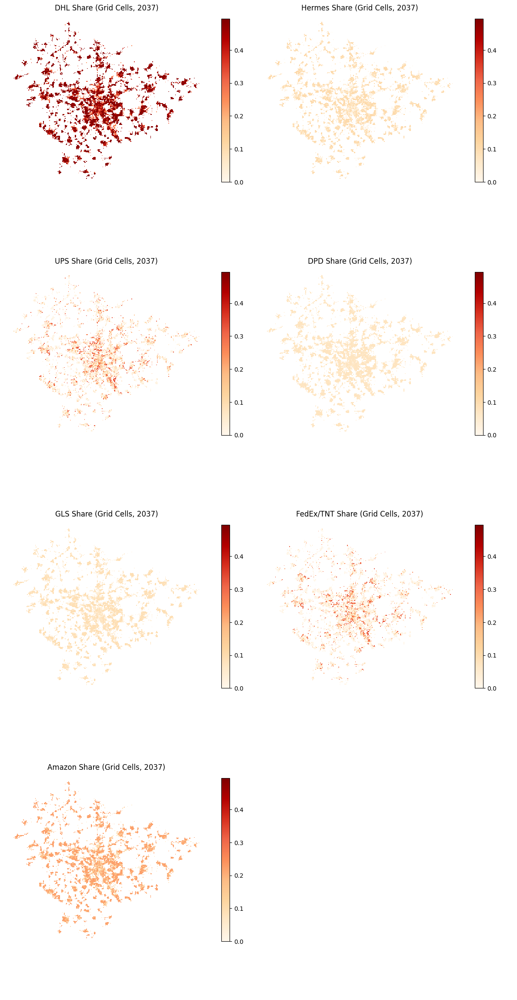

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

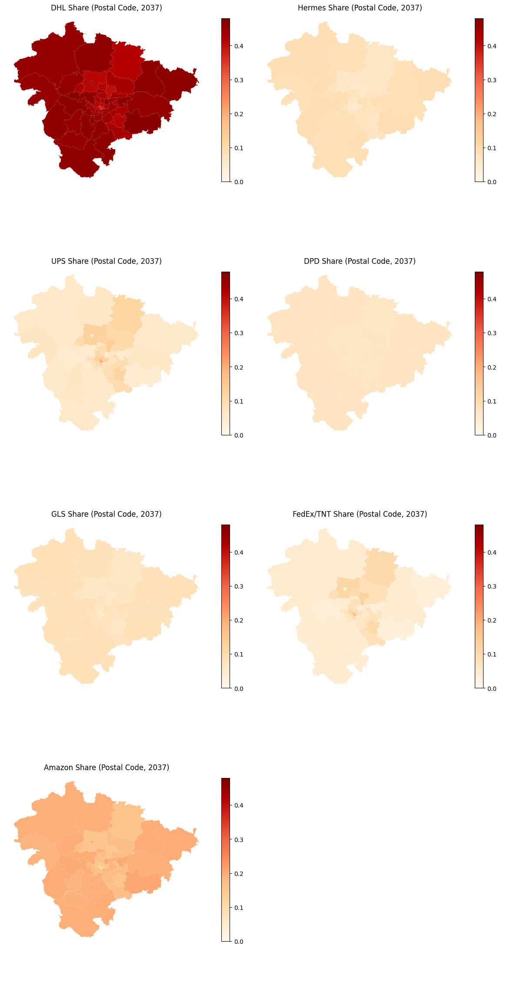

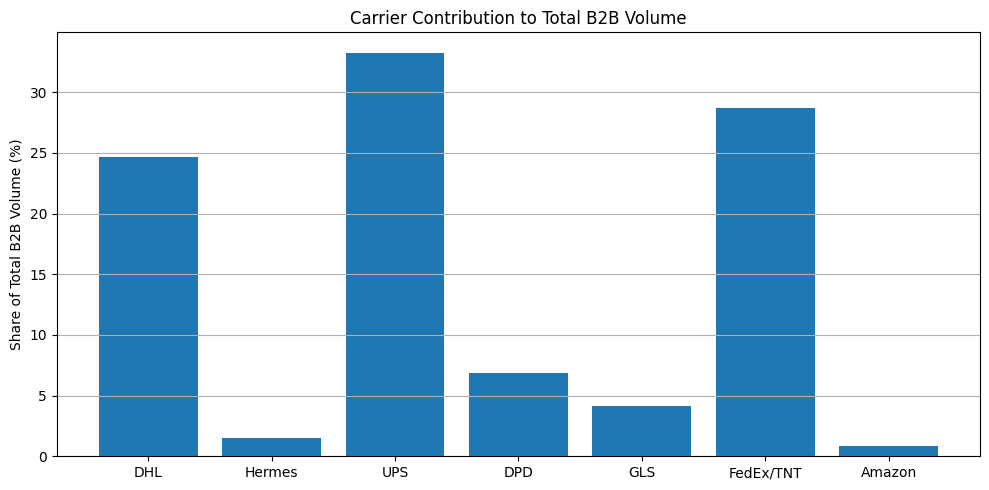

     Carrier  B2B Share (%)
2        UPS          33.27
5  FedEx/TNT          28.67
0        DHL          24.68
3        DPD           6.88
4        GLS           4.17
1     Hermes           1.52
6     Amazon           0.82


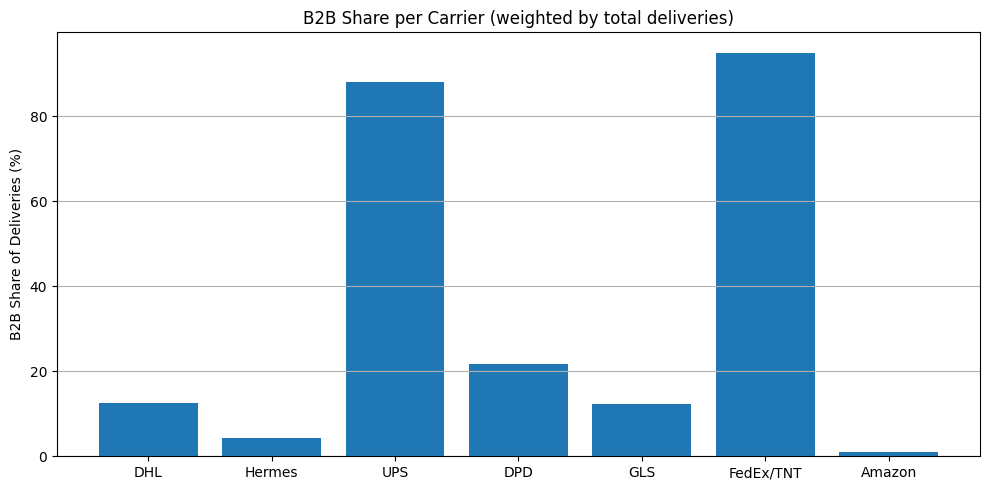

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.06
3        DPD          21.76
0        DHL          12.43
4        GLS          12.40
1     Hermes           4.41
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2037:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.881
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2037
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2038 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


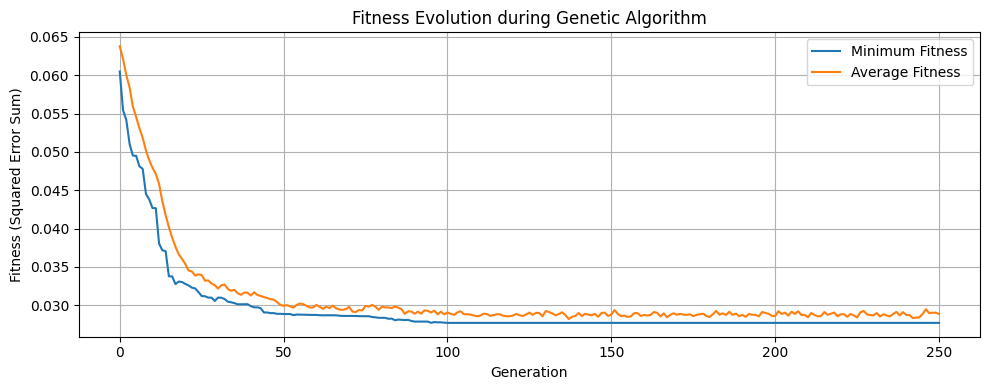

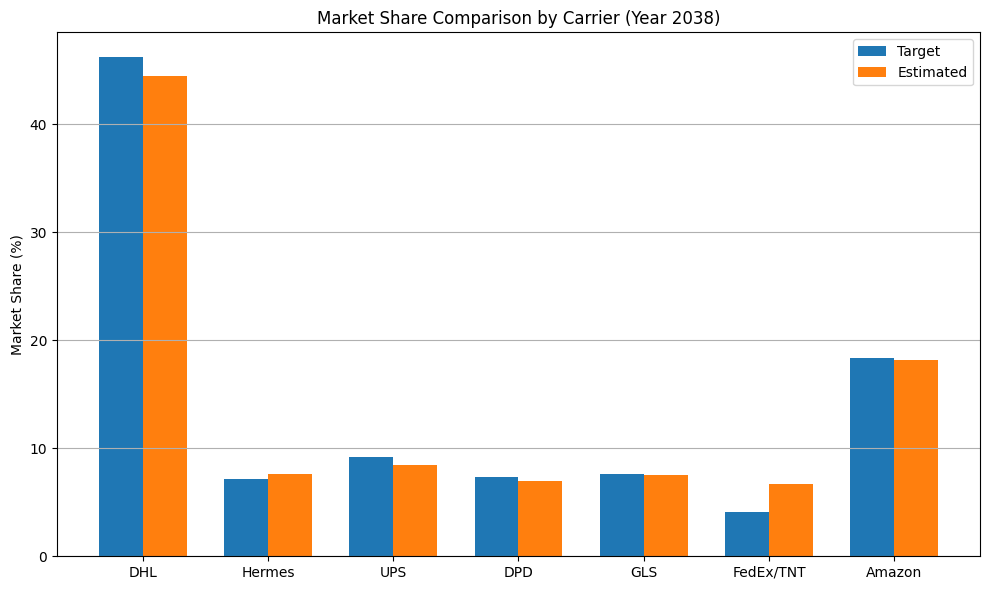

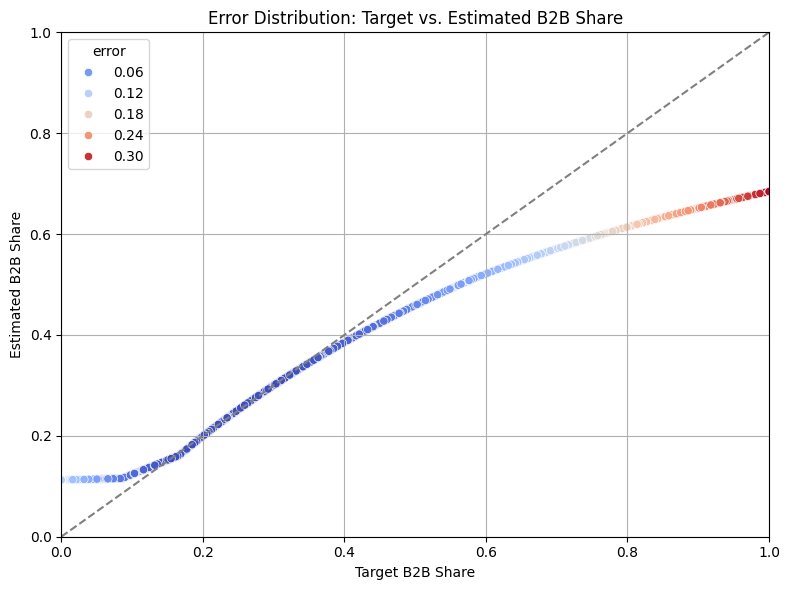


Weighted RMSE per cell: 0.0828
Estimated national B2B share (weighted): 0.2233
Target B2B share from input: 0.2002
Absolute deviation: 0.0231


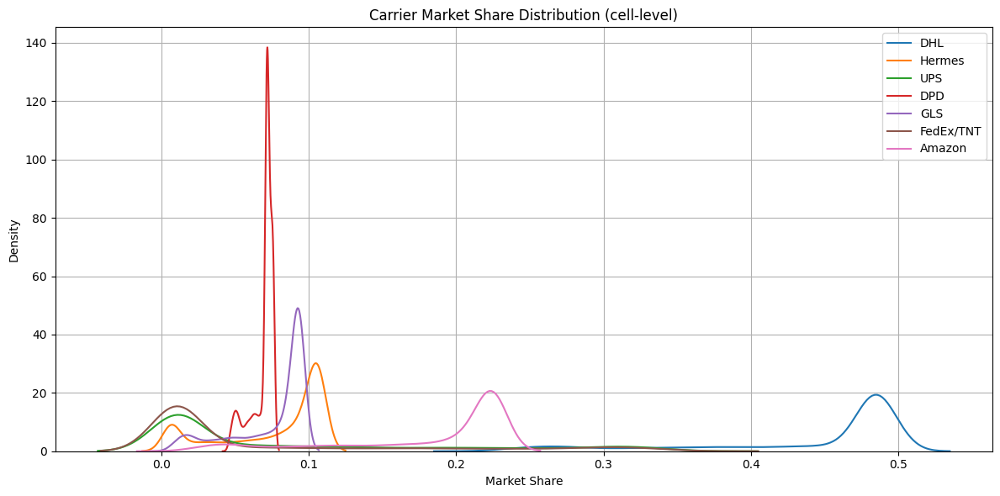

            mean    std  range
DHL        0.441  0.075  0.274
Hermes     0.077  0.037  0.101
UPS        0.086  0.105  0.341
DPD        0.069  0.008  0.030
GLS        0.075  0.026  0.088
FedEx/TNT  0.071  0.101  0.344
Amazon     0.181  0.062  0.211


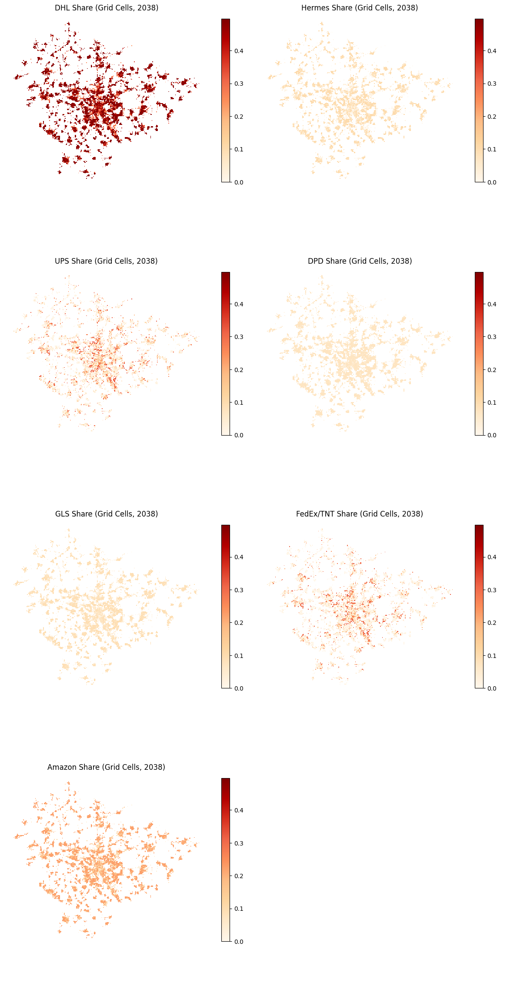

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

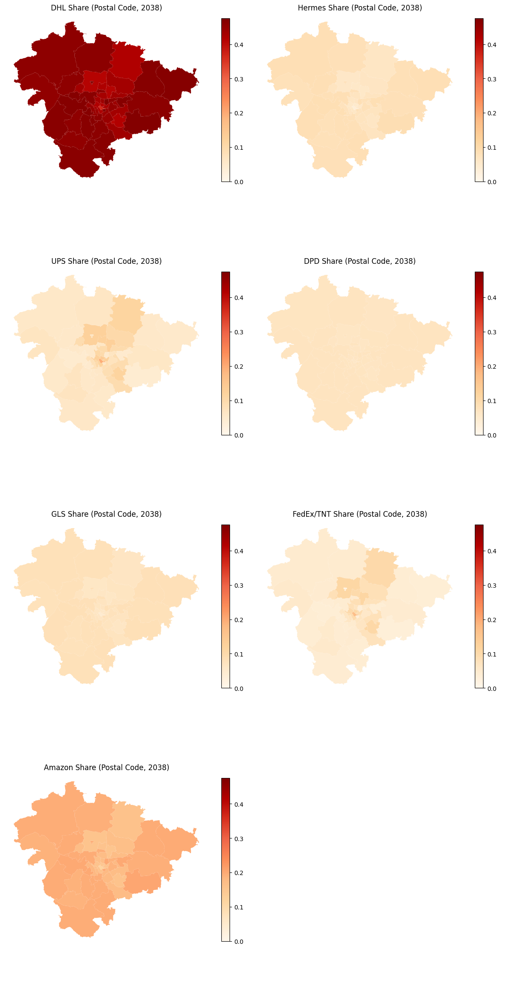

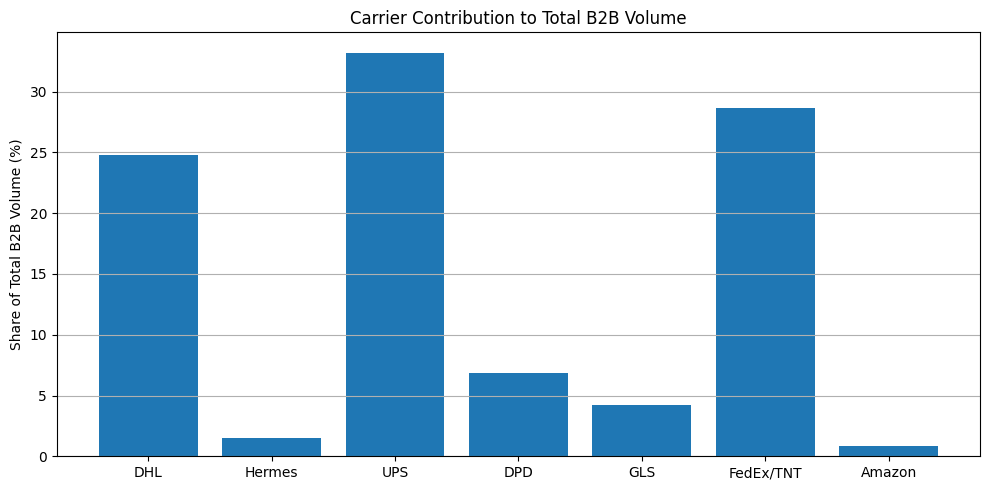

     Carrier  B2B Share (%)
2        UPS          33.23
5  FedEx/TNT          28.64
0        DHL          24.79
3        DPD           6.82
4        GLS           4.20
1     Hermes           1.51
6     Amazon           0.82


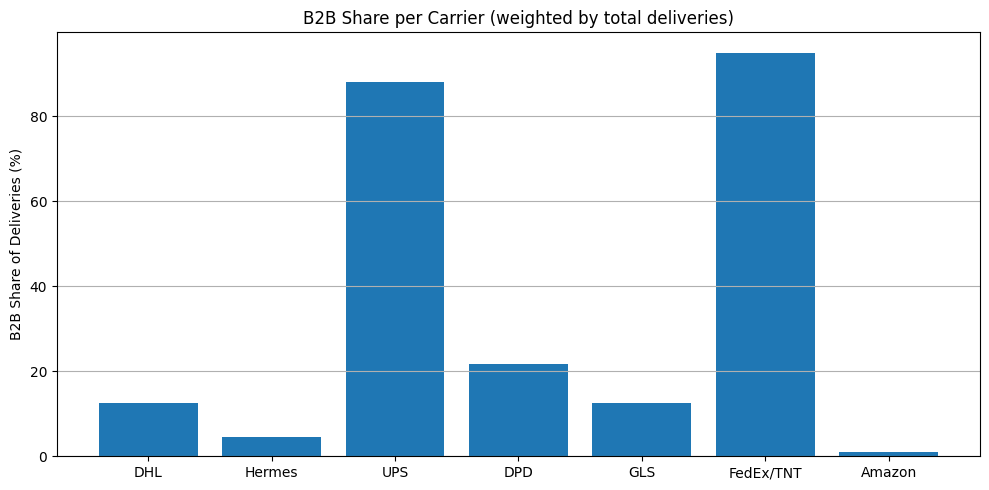

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2038:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2038
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2039 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


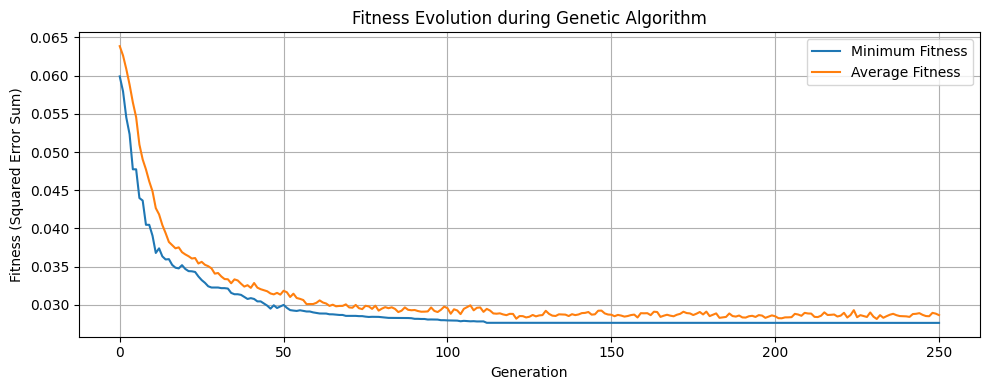

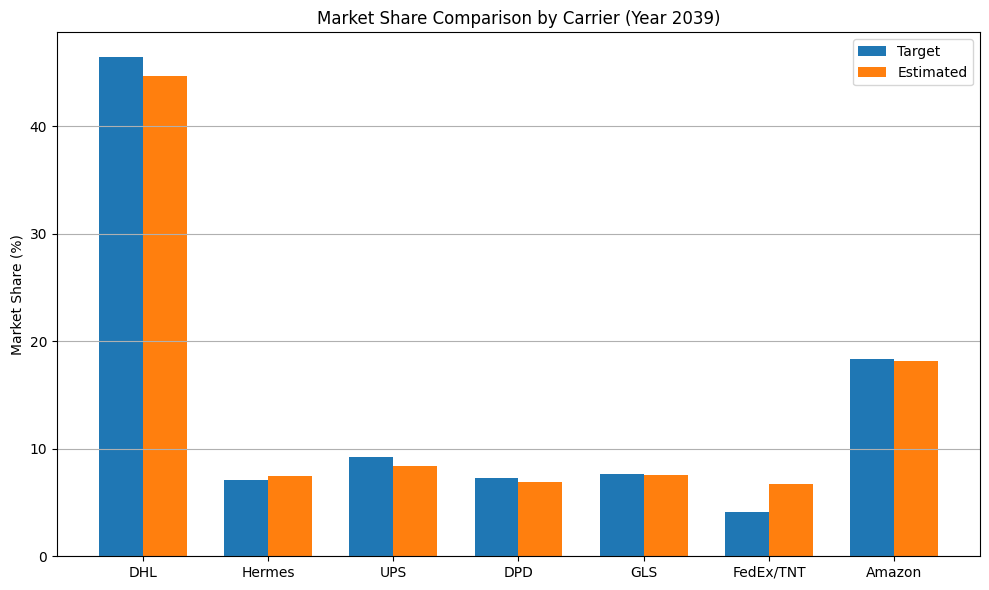

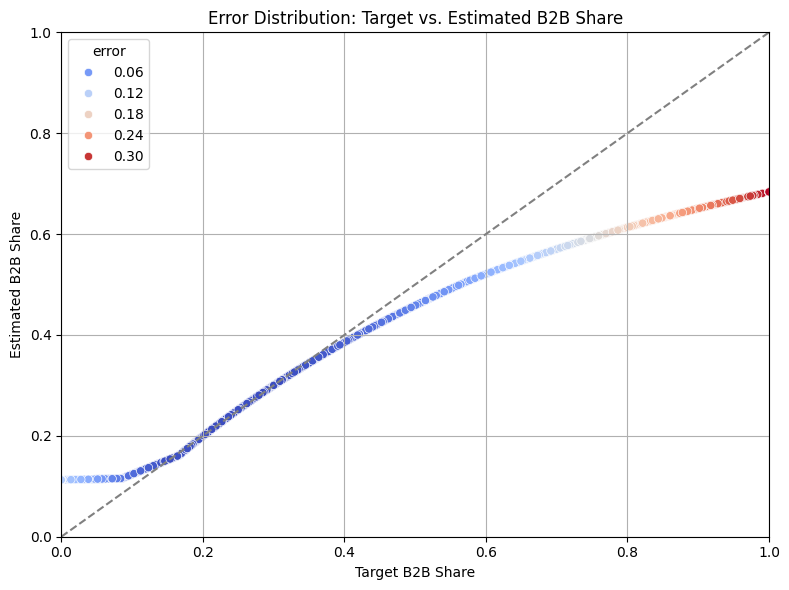


Weighted RMSE per cell: 0.0820
Estimated national B2B share (weighted): 0.2231
Target B2B share from input: 0.2002
Absolute deviation: 0.0229


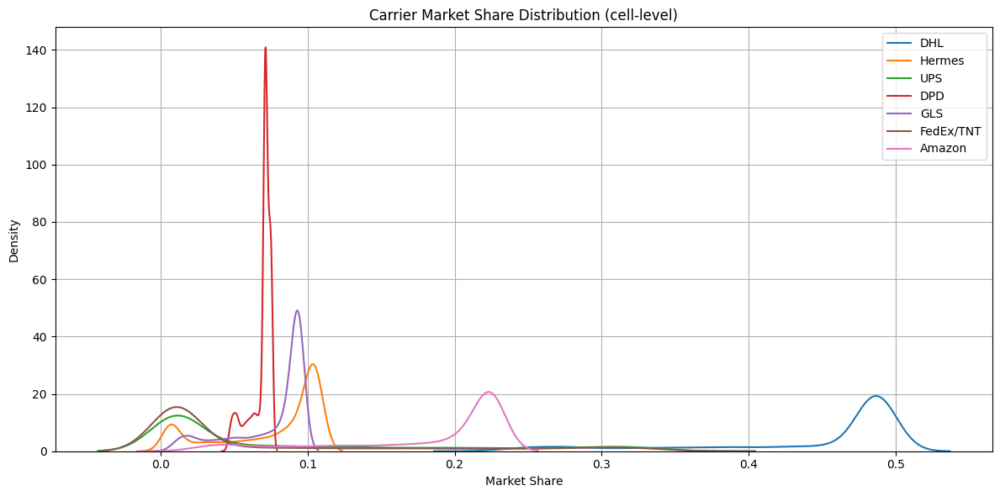

            mean    std  range
DHL        0.443  0.075  0.275
Hermes     0.075  0.036  0.099
UPS        0.085  0.105  0.341
DPD        0.069  0.008  0.030
GLS        0.075  0.026  0.088
FedEx/TNT  0.071  0.101  0.343
Amazon     0.181  0.062  0.211


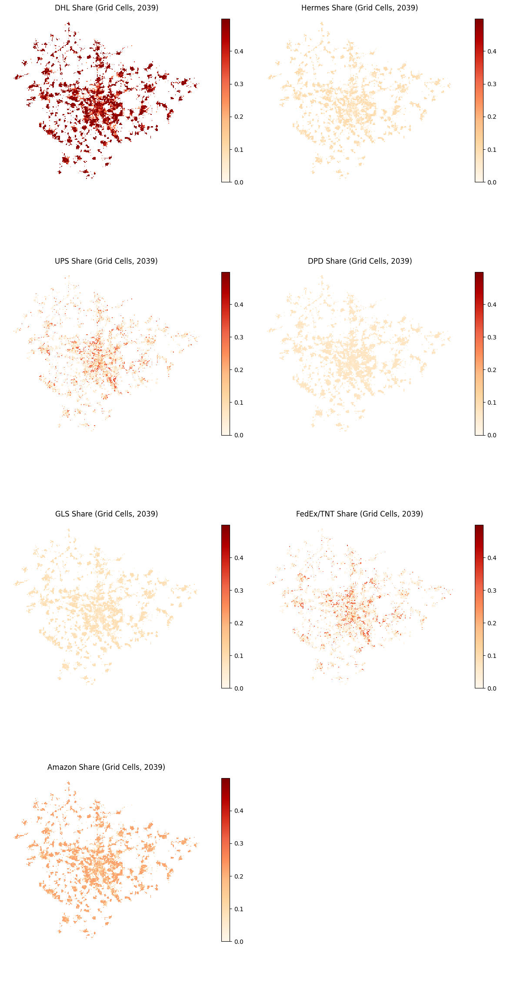

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

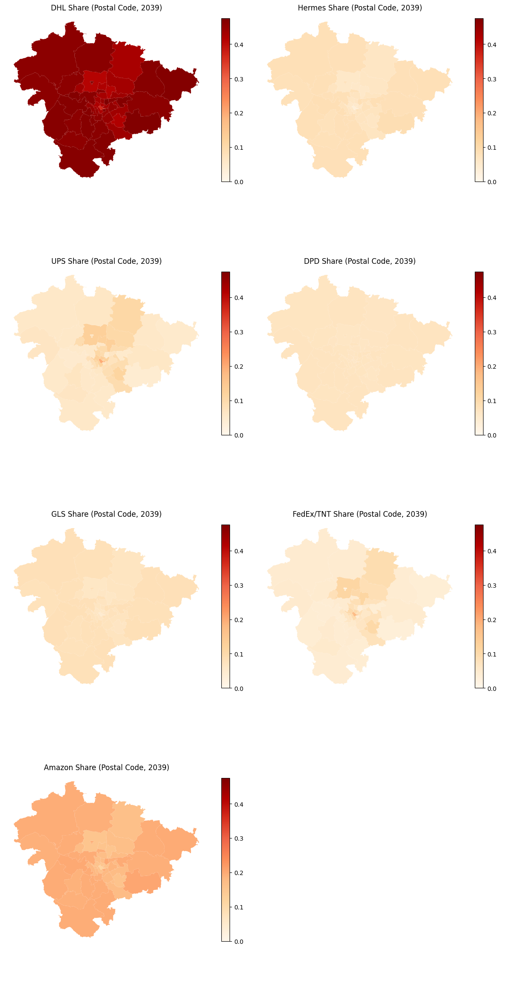

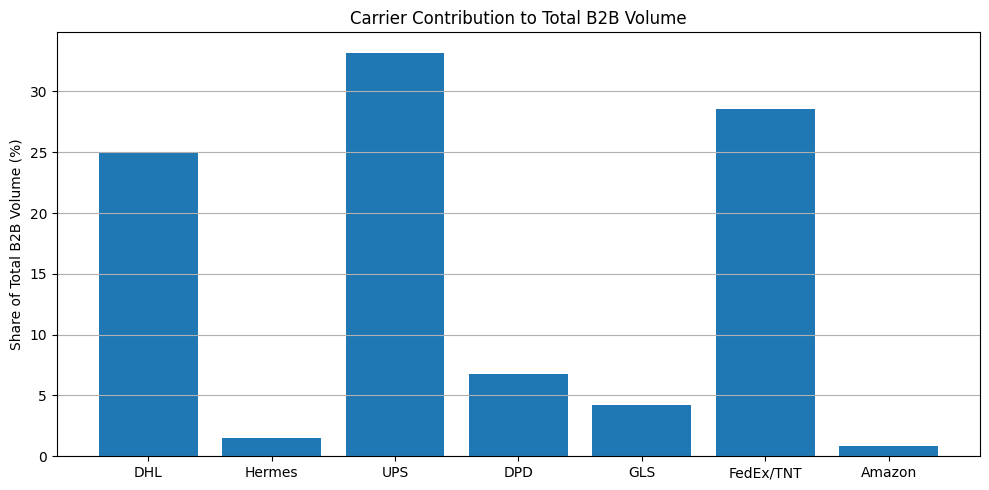

     Carrier  B2B Share (%)
2        UPS          33.20
5  FedEx/TNT          28.59
0        DHL          24.92
3        DPD           6.77
4        GLS           4.22
1     Hermes           1.49
6     Amazon           0.82


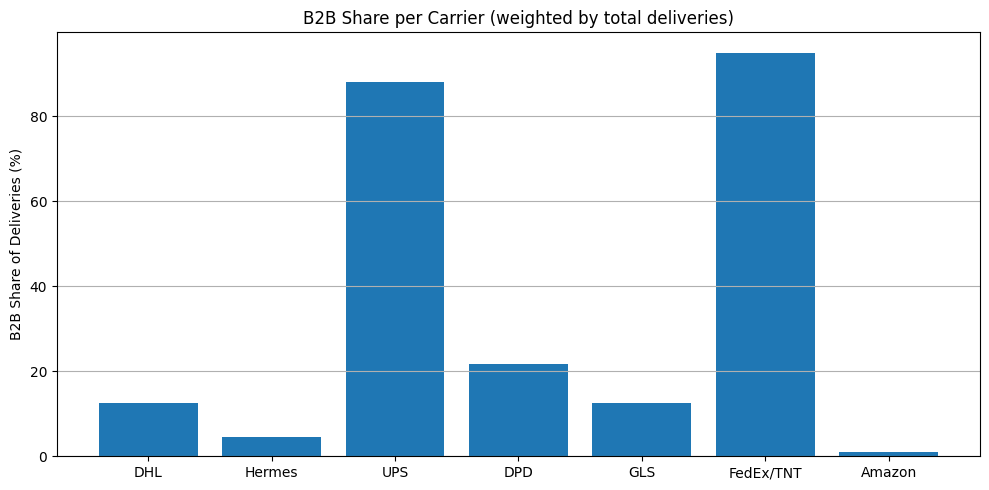

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2039:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2039
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2040 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


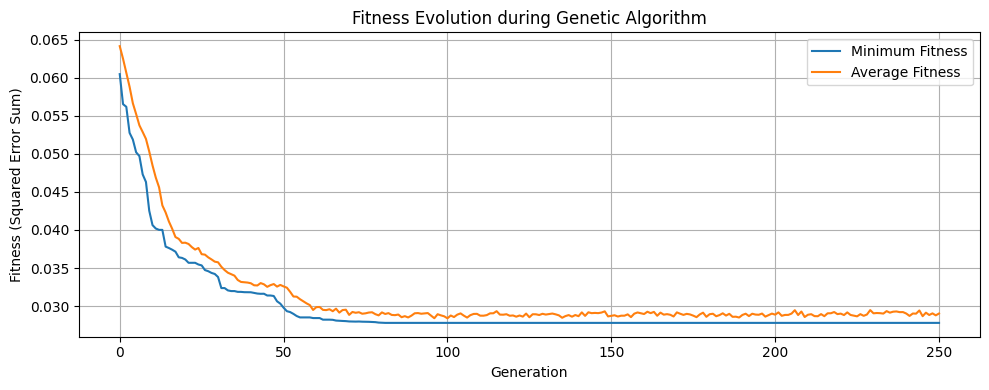

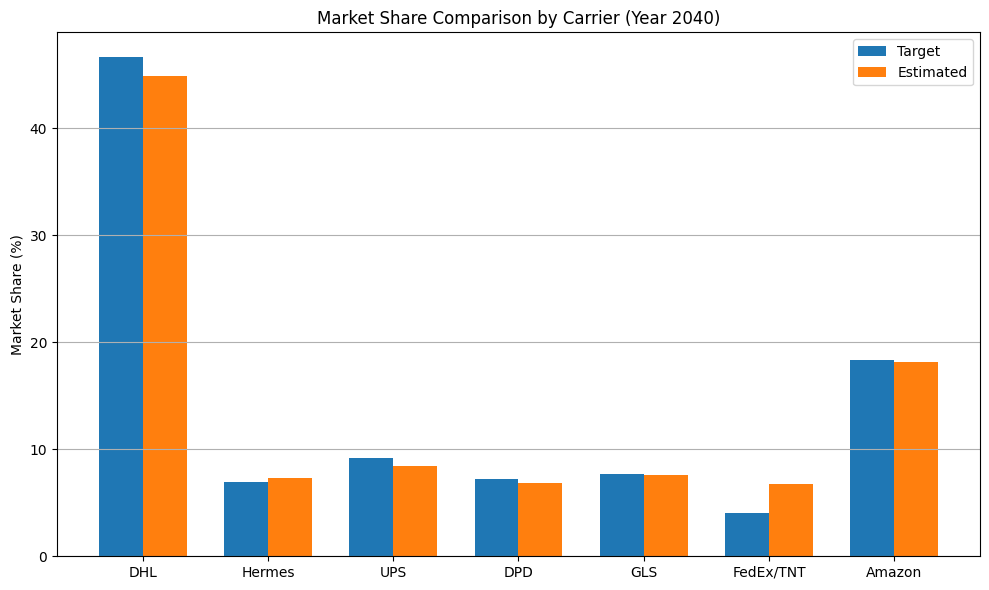

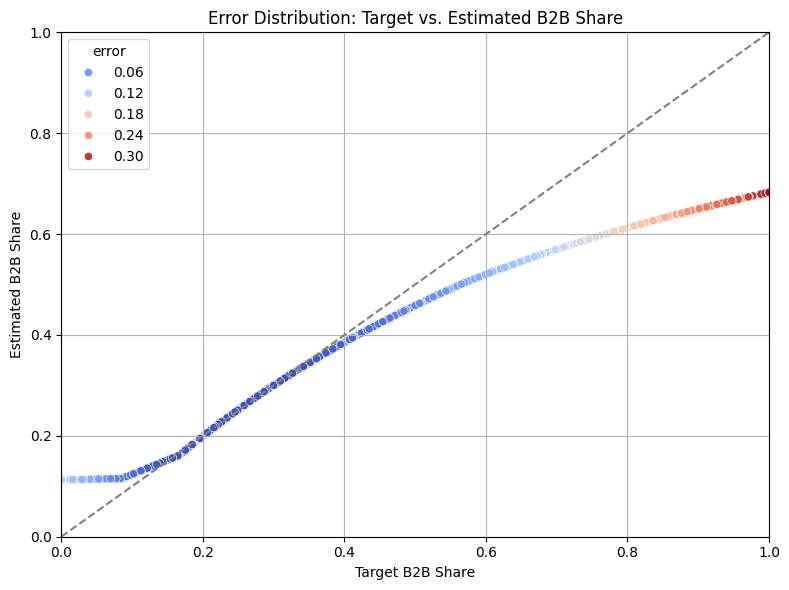


Weighted RMSE per cell: 0.0832
Estimated national B2B share (weighted): 0.2233
Target B2B share from input: 0.2001
Absolute deviation: 0.0232


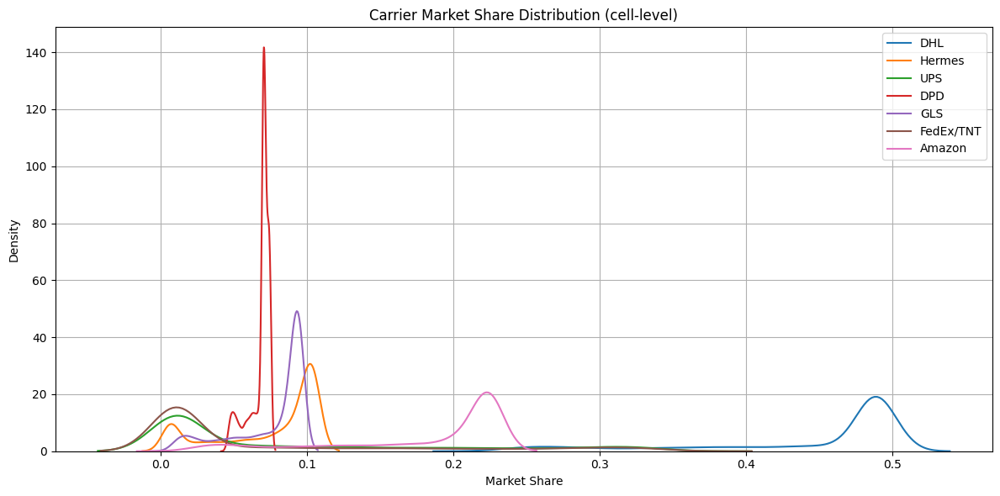

            mean    std  range
DHL        0.444  0.076  0.276
Hermes     0.074  0.036  0.098
UPS        0.086  0.105  0.341
DPD        0.068  0.007  0.030
GLS        0.076  0.026  0.088
FedEx/TNT  0.071  0.101  0.343
Amazon     0.181  0.062  0.210


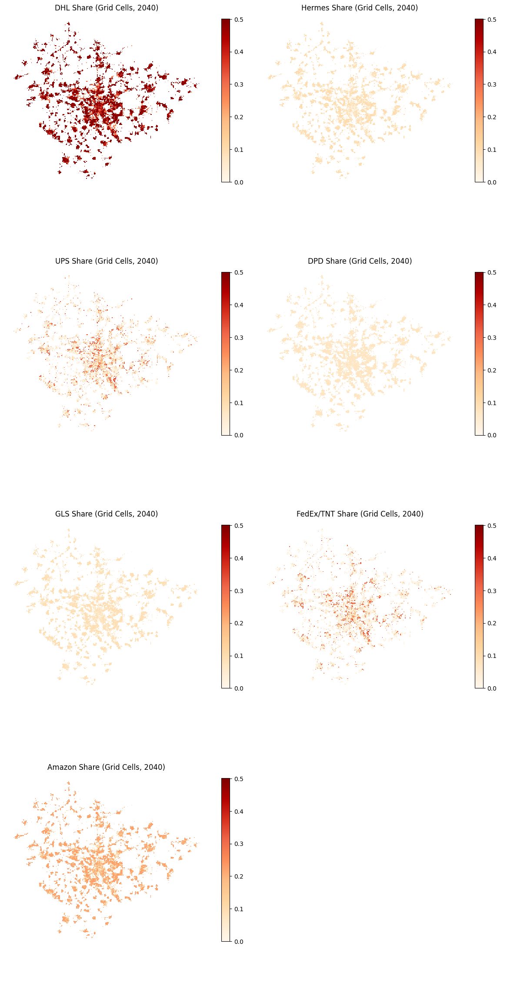

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

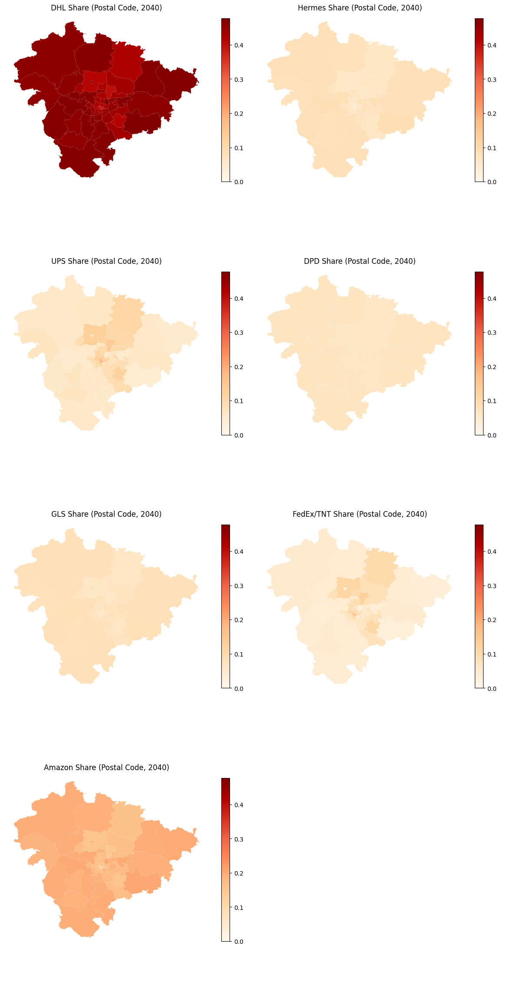

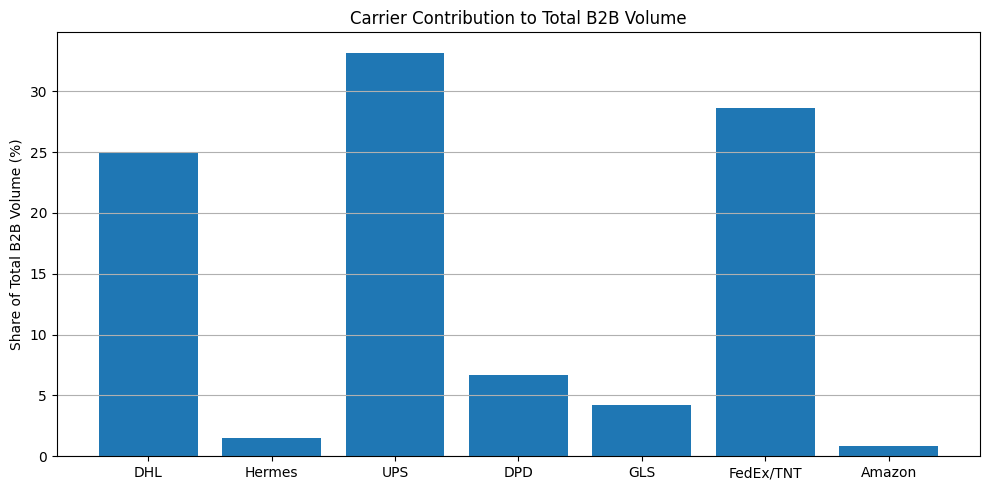

     Carrier  B2B Share (%)
2        UPS          33.19
5  FedEx/TNT          28.63
0        DHL          24.98
3        DPD           6.70
4        GLS           4.23
1     Hermes           1.46
6     Amazon           0.81


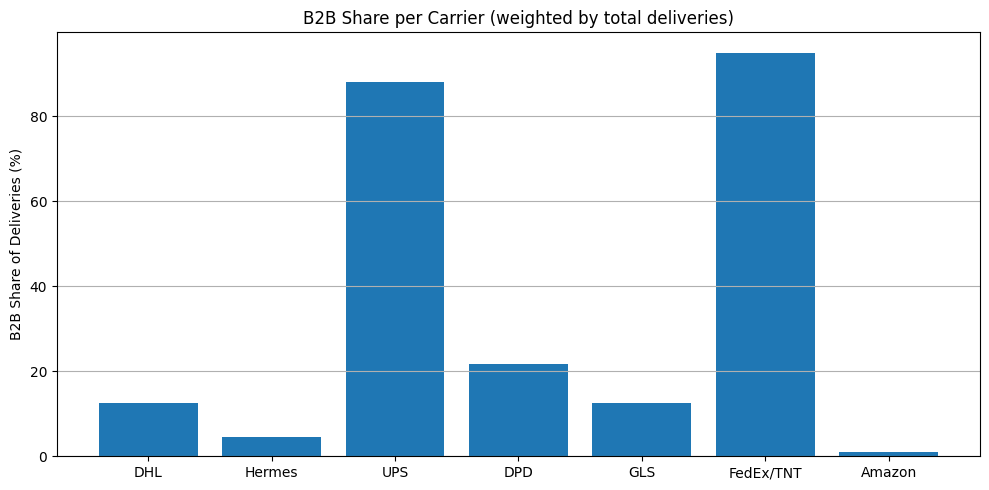

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2040:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2040
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2041 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


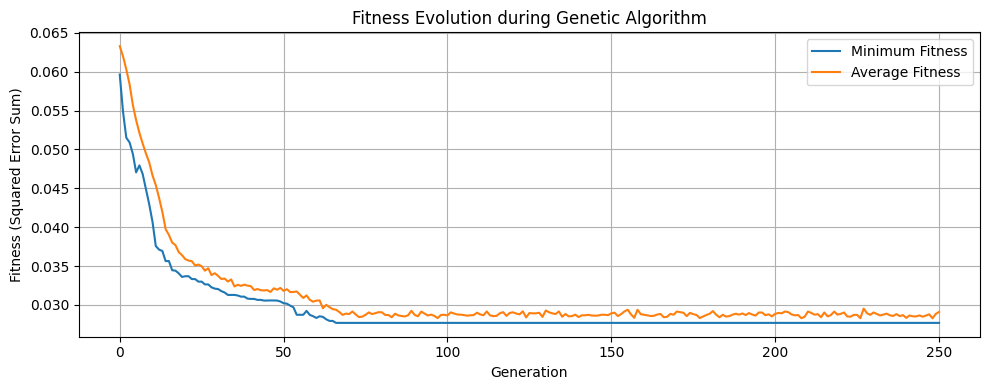

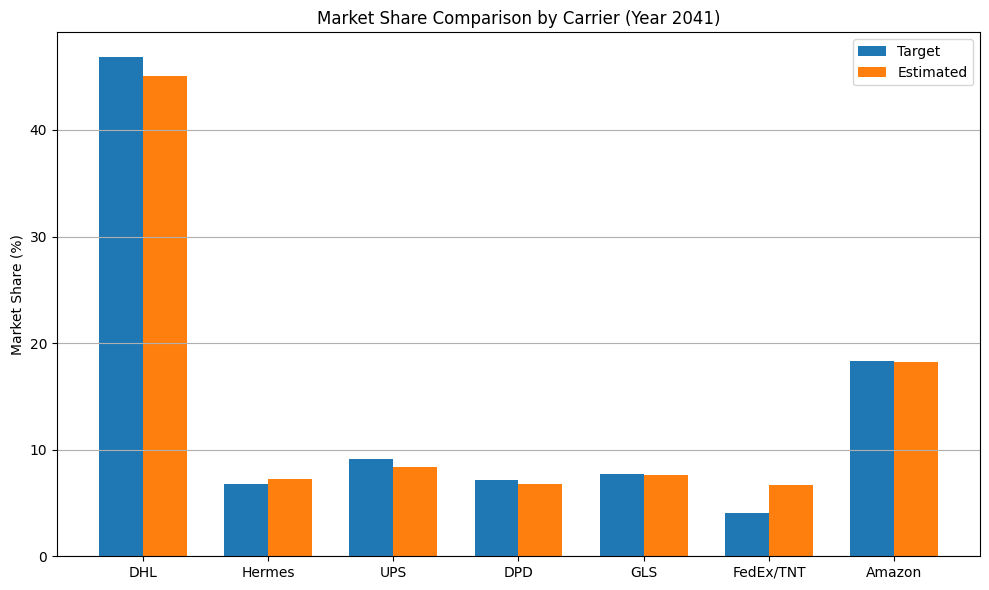

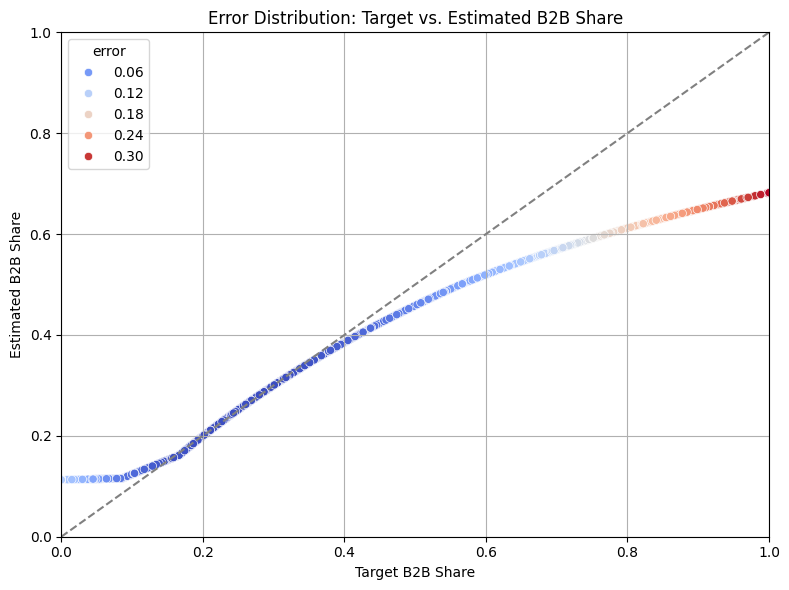


Weighted RMSE per cell: 0.0822
Estimated national B2B share (weighted): 0.2230
Target B2B share from input: 0.2001
Absolute deviation: 0.0229


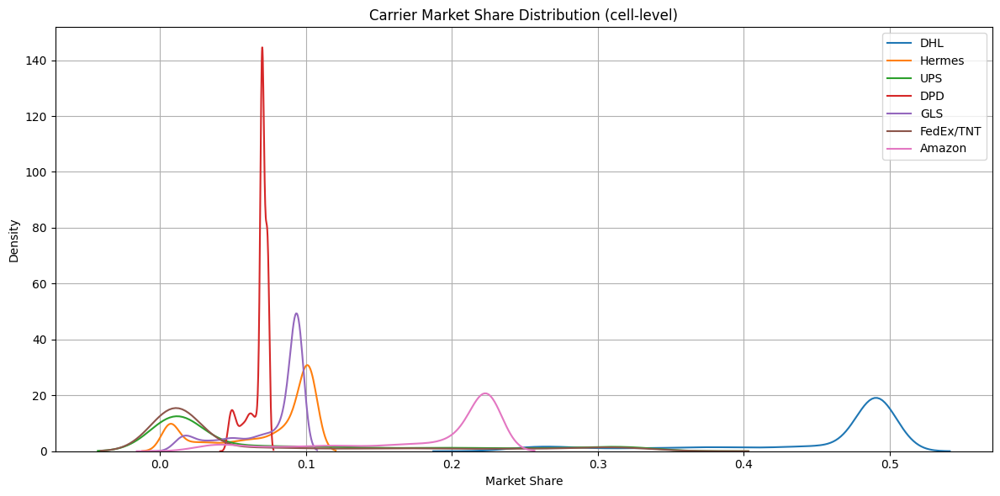

            mean    std  range
DHL        0.446  0.076  0.278
Hermes     0.073  0.035  0.097
UPS        0.085  0.105  0.340
DPD        0.067  0.007  0.029
GLS        0.076  0.026  0.088
FedEx/TNT  0.071  0.101  0.342
Amazon     0.181  0.062  0.210


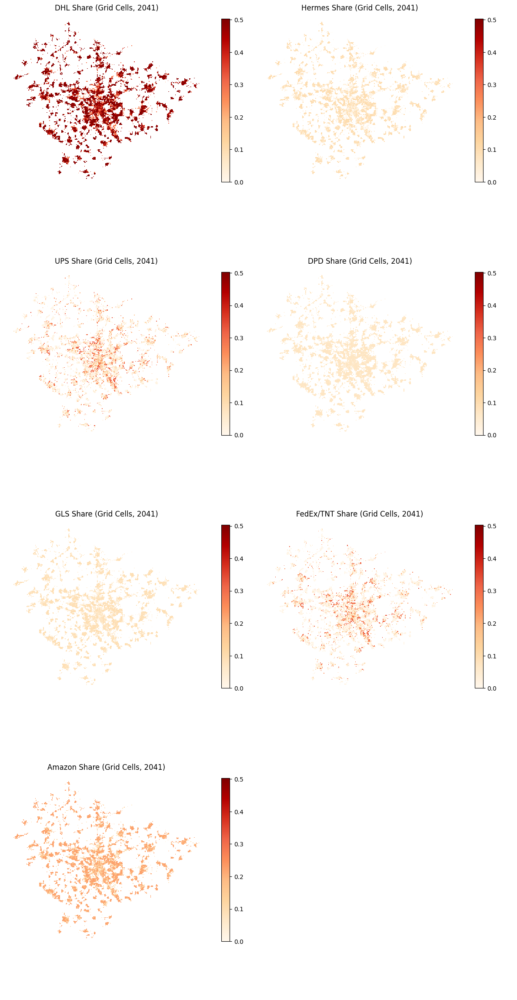

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

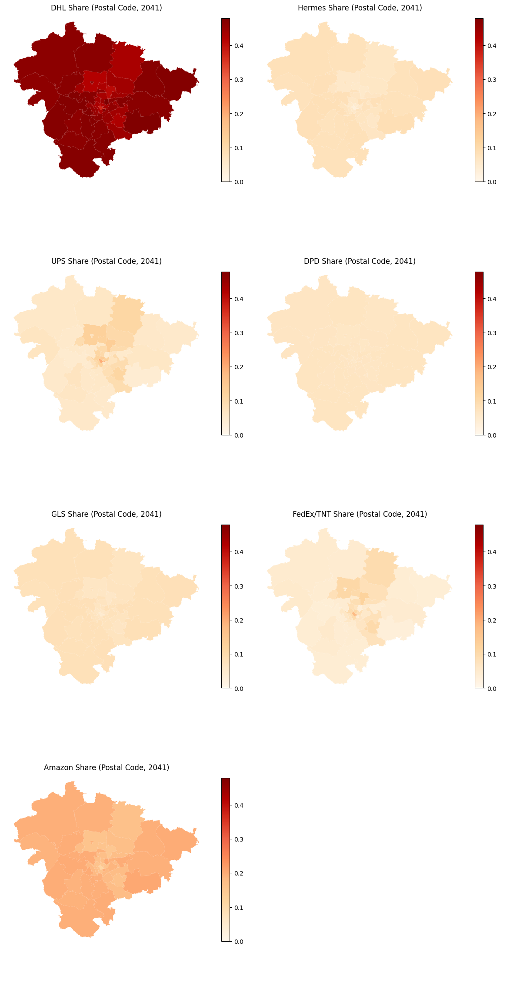

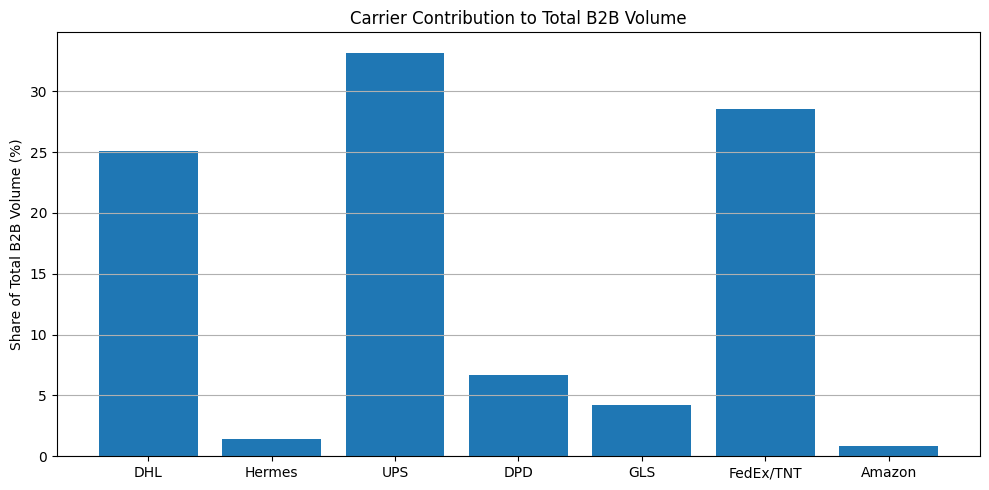

     Carrier  B2B Share (%)
2        UPS          33.18
5  FedEx/TNT          28.54
0        DHL          25.12
3        DPD           6.65
4        GLS           4.25
1     Hermes           1.44
6     Amazon           0.82


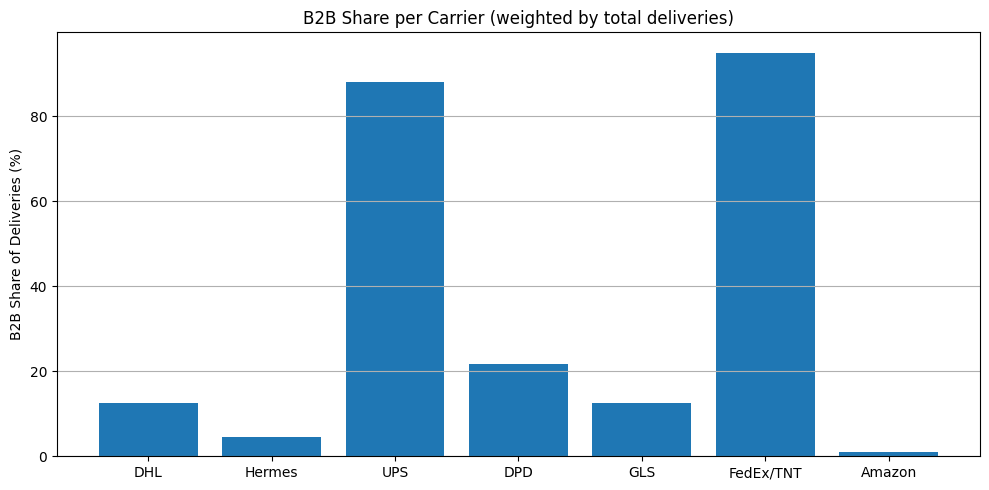

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2041:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2041
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2042 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


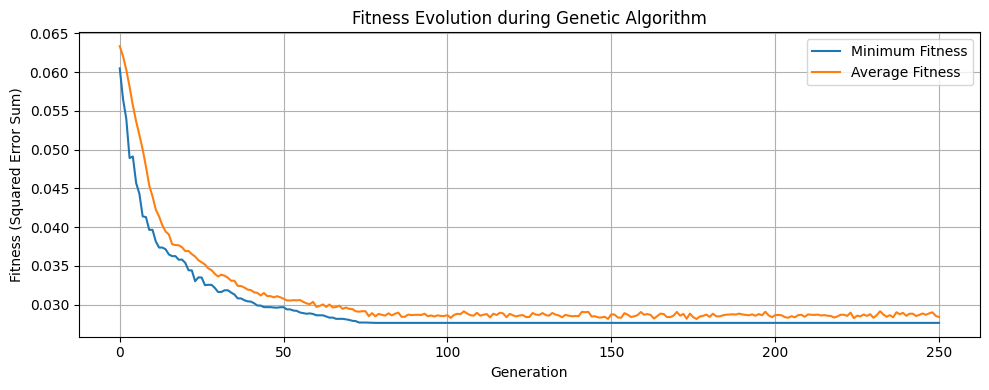

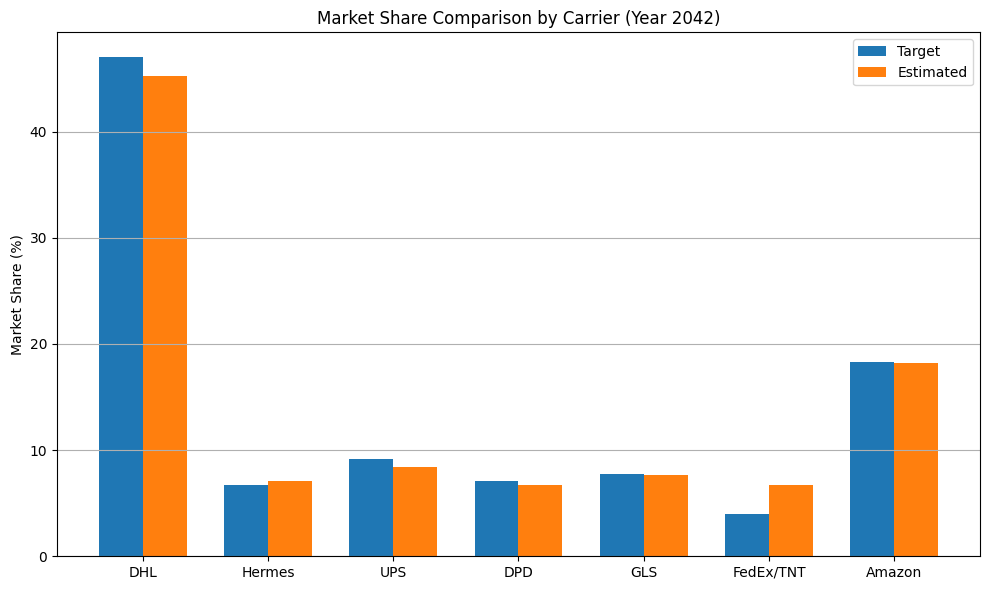

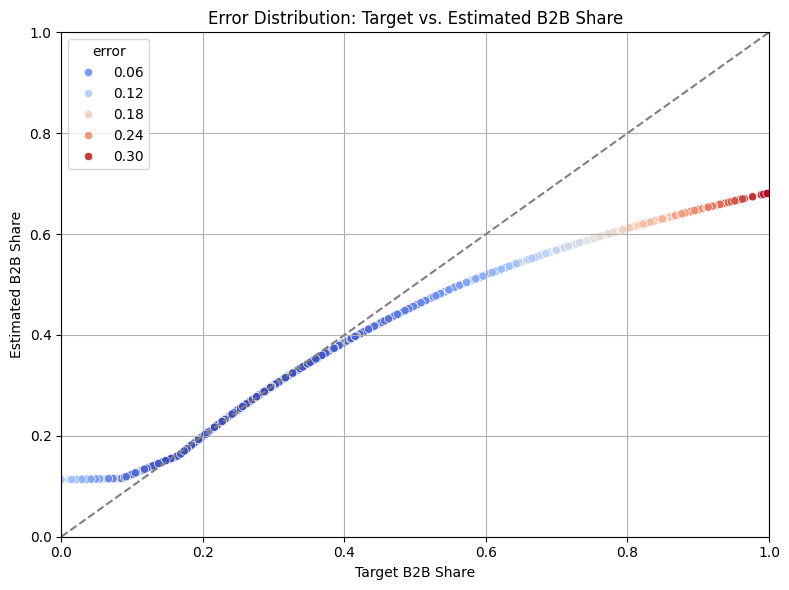


Weighted RMSE per cell: 0.0828
Estimated national B2B share (weighted): 0.2228
Target B2B share from input: 0.2001
Absolute deviation: 0.0228


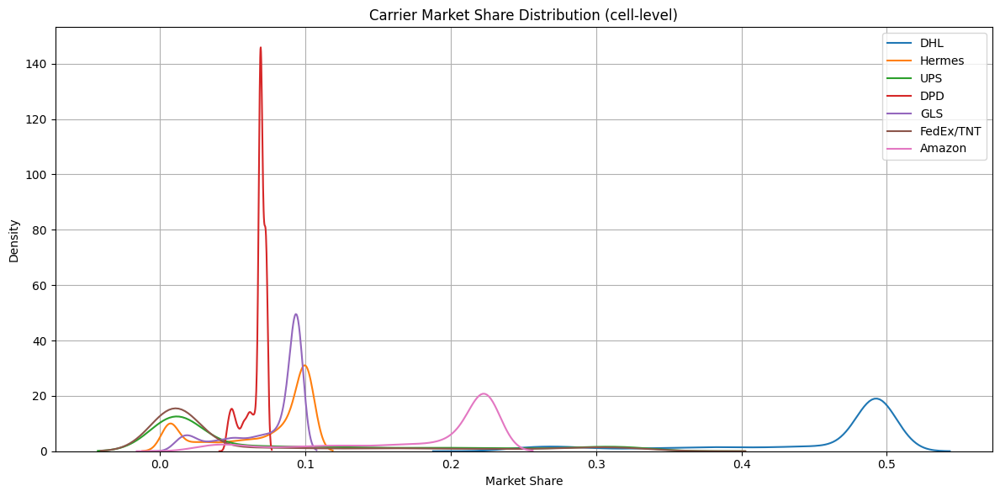

            mean    std  range
DHL        0.448  0.076  0.279
Hermes     0.072  0.035  0.096
UPS        0.085  0.104  0.340
DPD        0.067  0.007  0.029
GLS        0.076  0.026  0.088
FedEx/TNT  0.071  0.100  0.342
Amazon     0.181  0.062  0.210


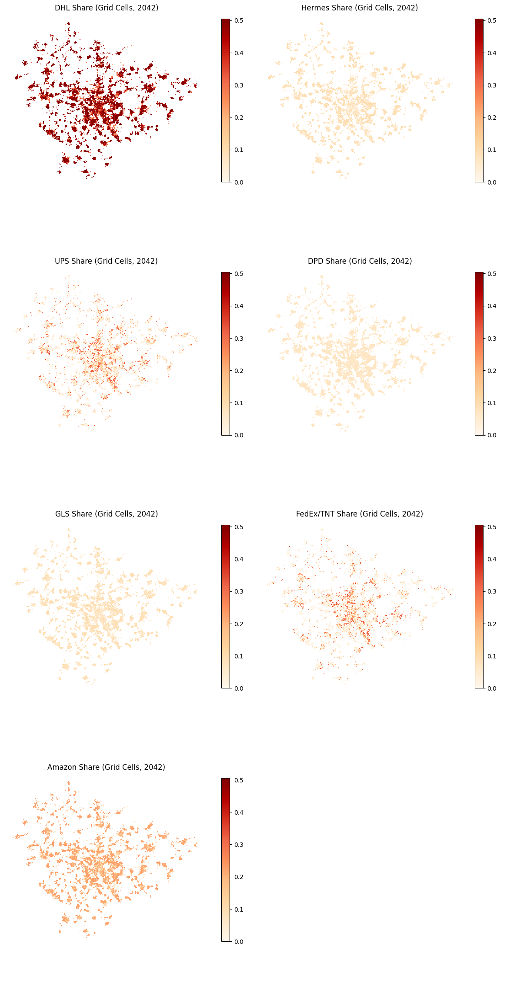

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

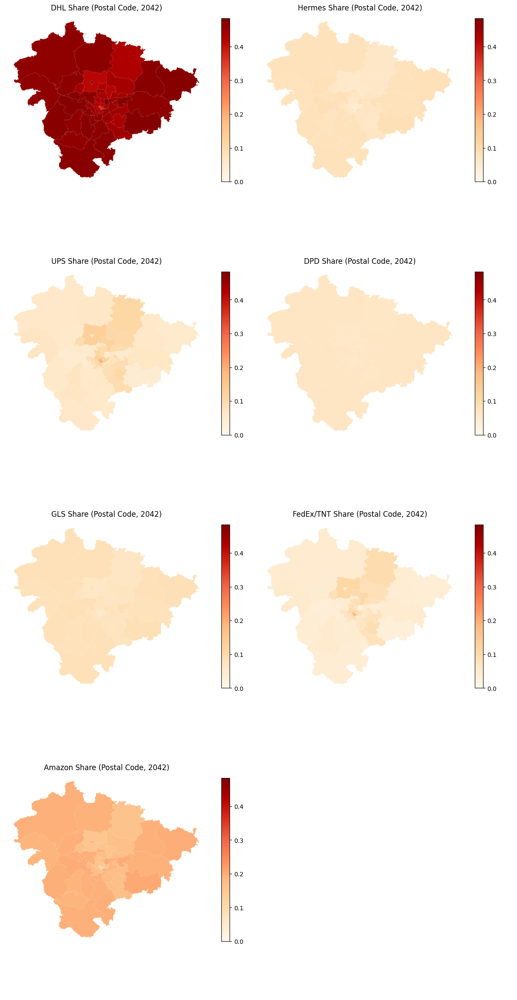

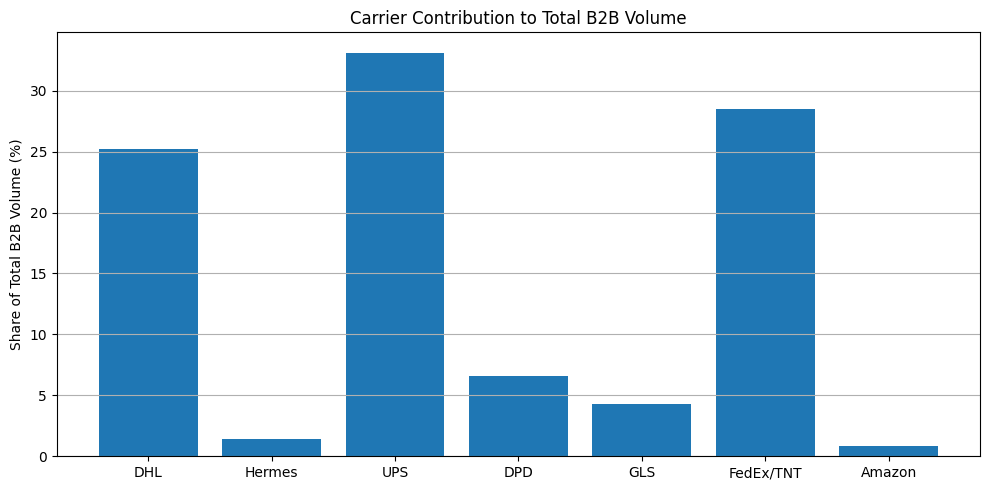

     Carrier  B2B Share (%)
2        UPS          33.13
5  FedEx/TNT          28.52
0        DHL          25.24
3        DPD           6.60
4        GLS           4.27
1     Hermes           1.42
6     Amazon           0.82


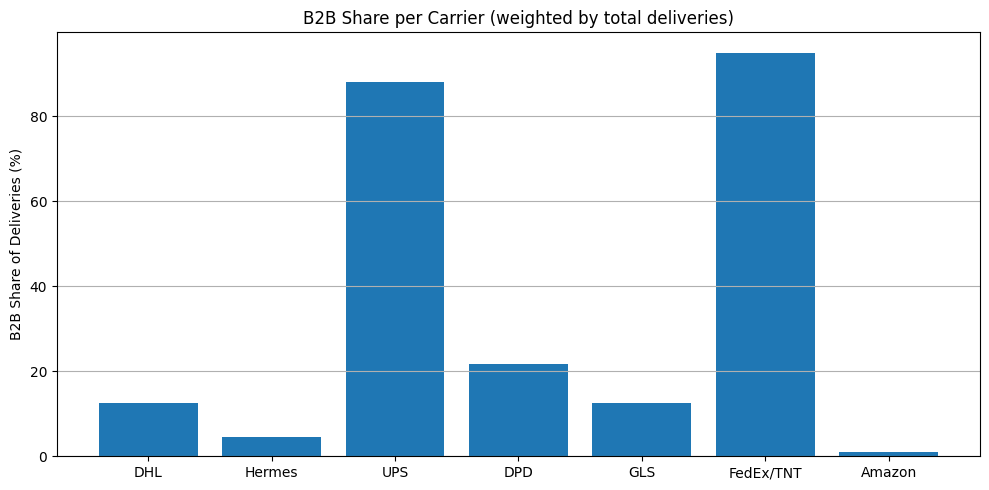

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)


✅ Optimized B2B shares for 2042:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2042
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2043 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


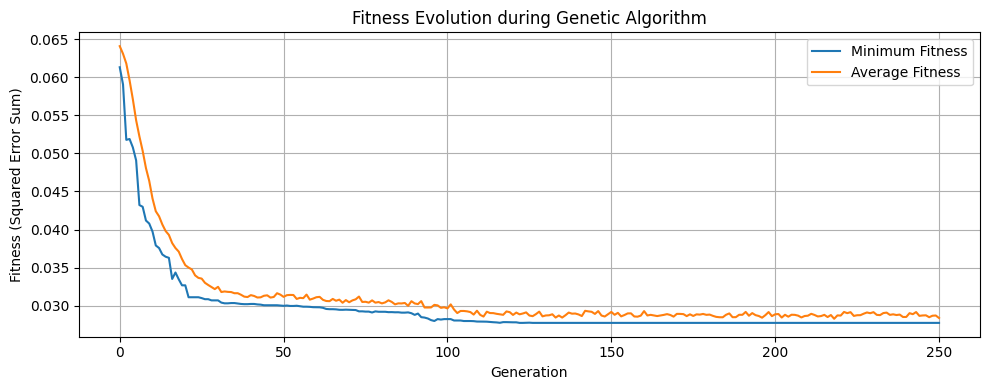

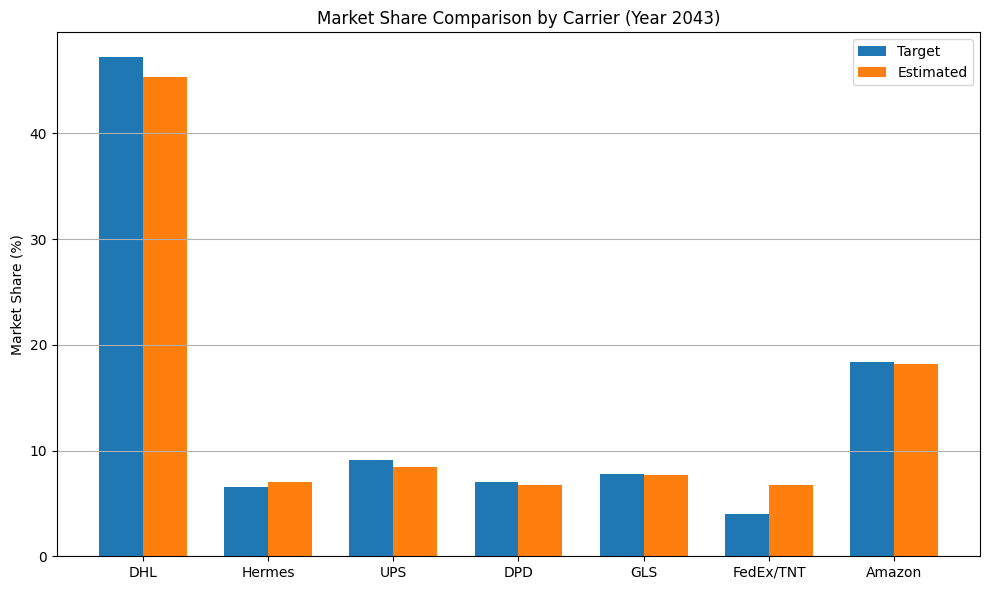

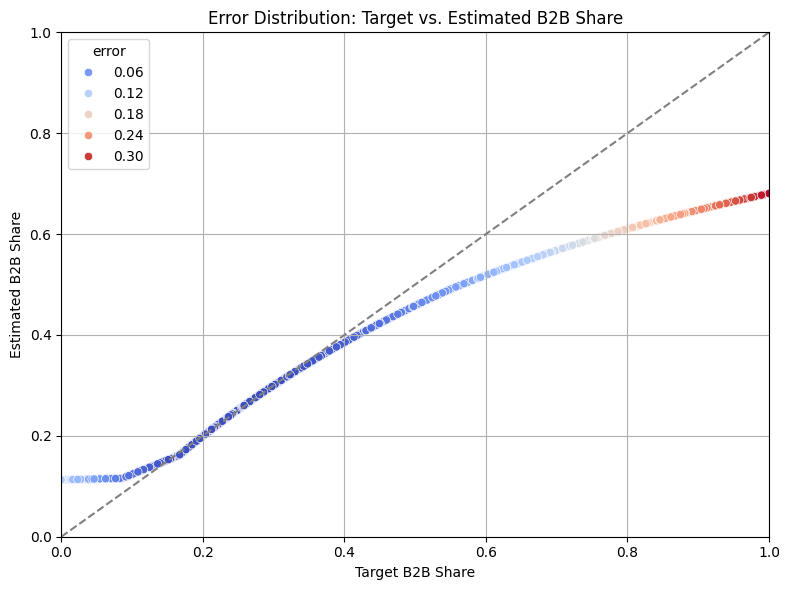


Weighted RMSE per cell: 0.0838
Estimated national B2B share (weighted): 0.2230
Target B2B share from input: 0.2000
Absolute deviation: 0.0230


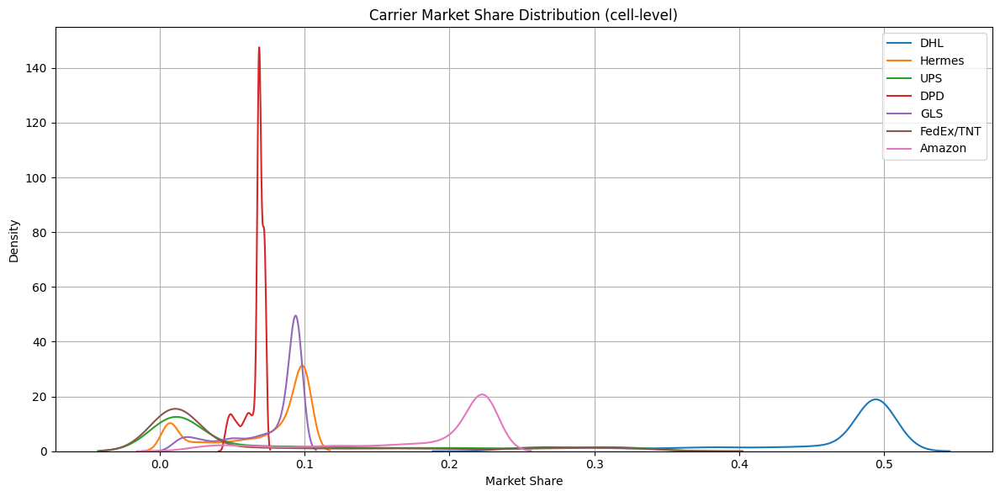

            mean    std  range
DHL        0.450  0.077  0.280
Hermes     0.071  0.035  0.094
UPS        0.085  0.104  0.339
DPD        0.066  0.007  0.028
GLS        0.076  0.026  0.088
FedEx/TNT  0.071  0.100  0.342
Amazon     0.181  0.062  0.210


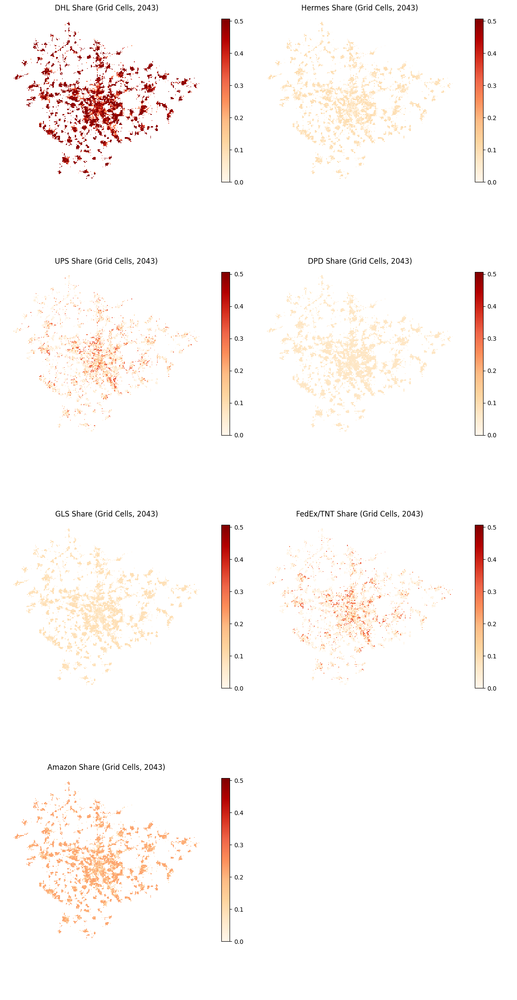

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

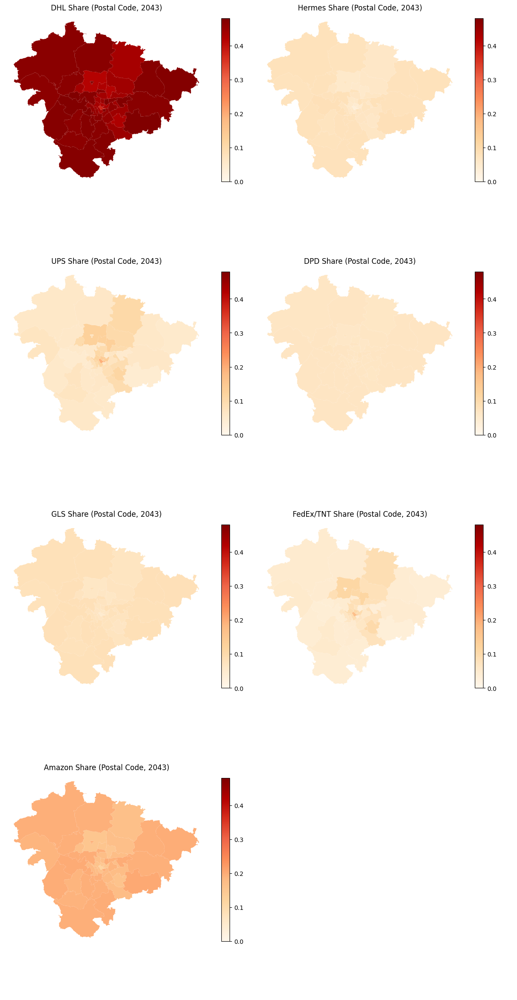

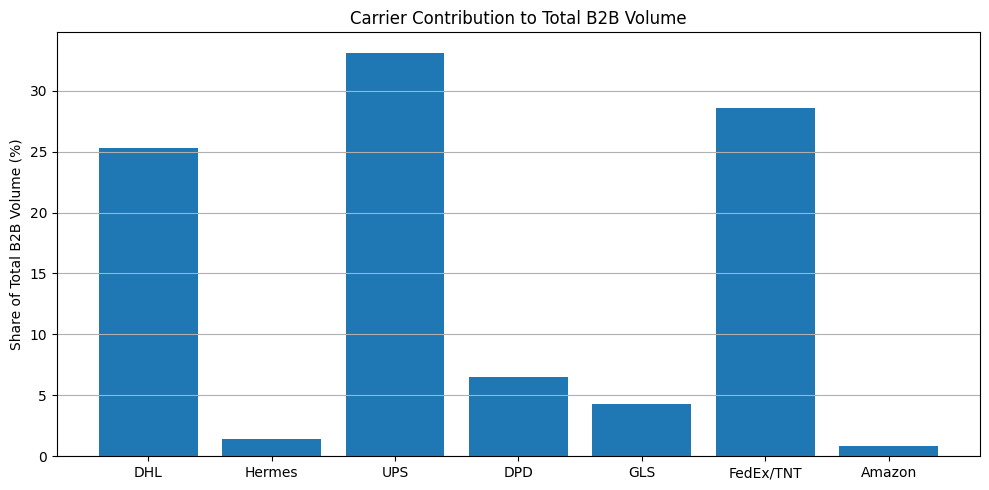

     Carrier  B2B Share (%)
2        UPS          33.13
5  FedEx/TNT          28.54
0        DHL          25.29
3        DPD           6.54
4        GLS           4.28
1     Hermes           1.40
6     Amazon           0.81


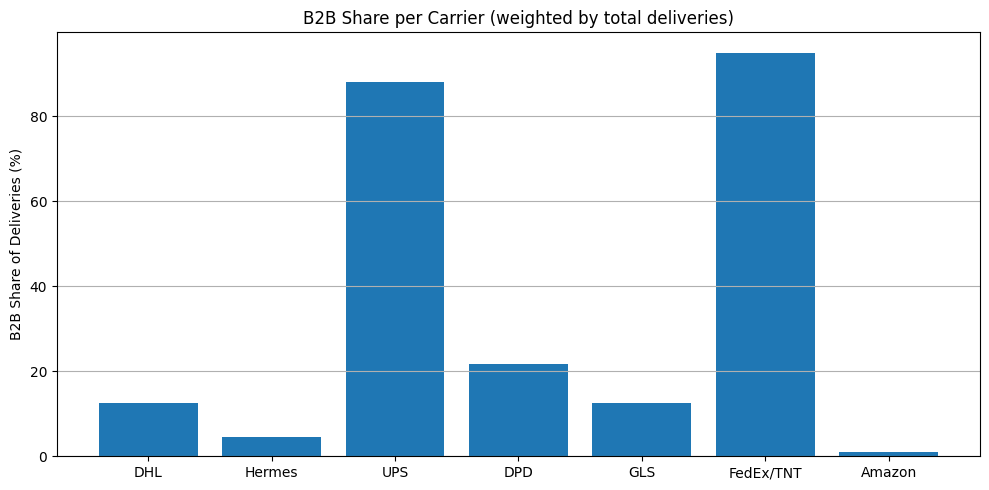

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2043:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2043
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2044 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


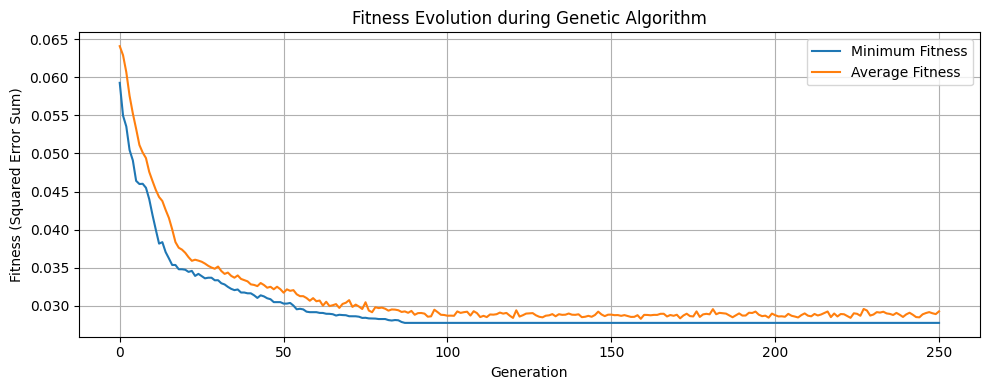

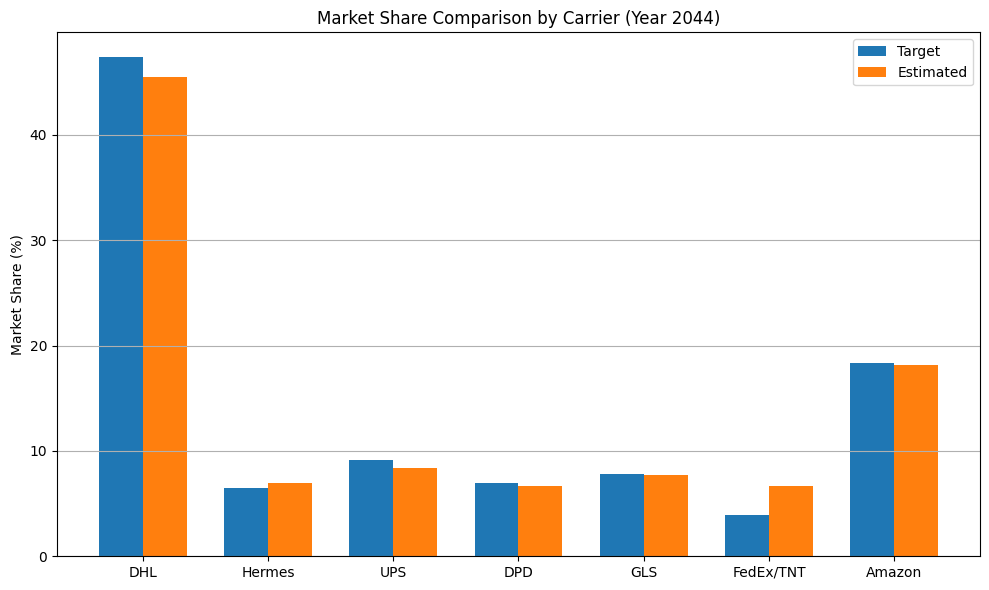

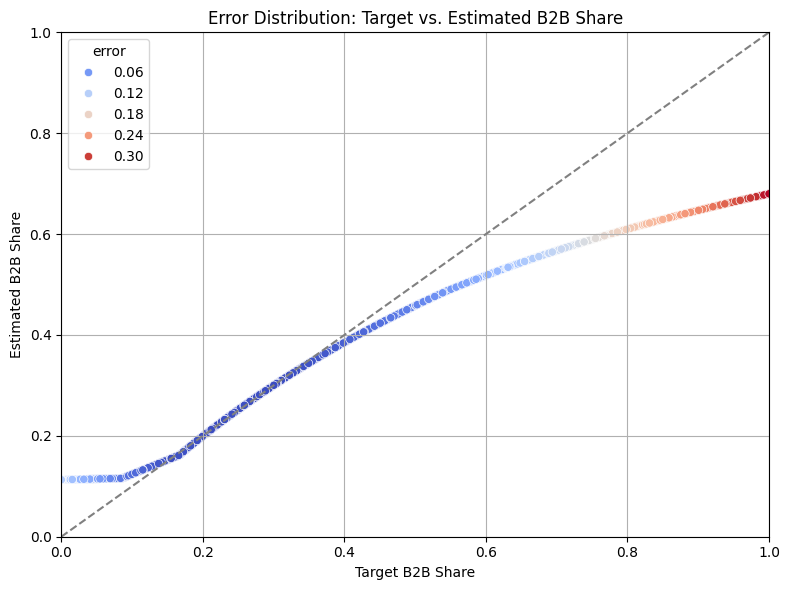


Weighted RMSE per cell: 0.0831
Estimated national B2B share (weighted): 0.2226
Target B2B share from input: 0.2000
Absolute deviation: 0.0226


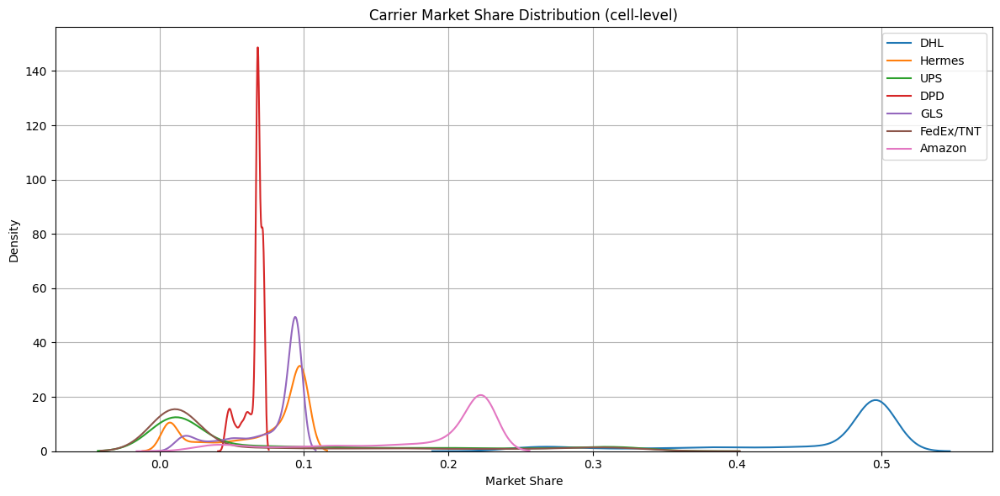

            mean    std  range
DHL        0.451  0.077  0.281
Hermes     0.070  0.034  0.093
UPS        0.085  0.104  0.339
DPD        0.066  0.007  0.028
GLS        0.077  0.026  0.088
FedEx/TNT  0.071  0.100  0.341
Amazon     0.181  0.062  0.210


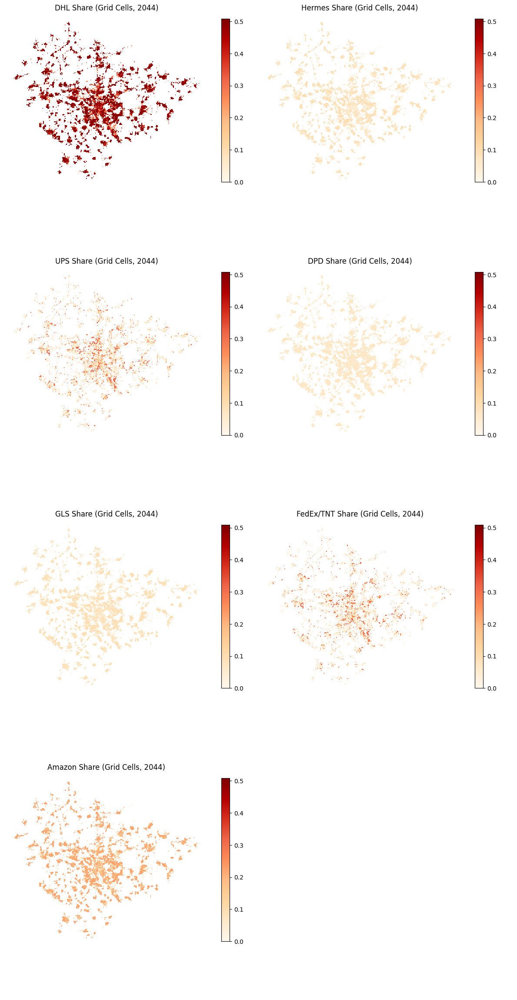

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

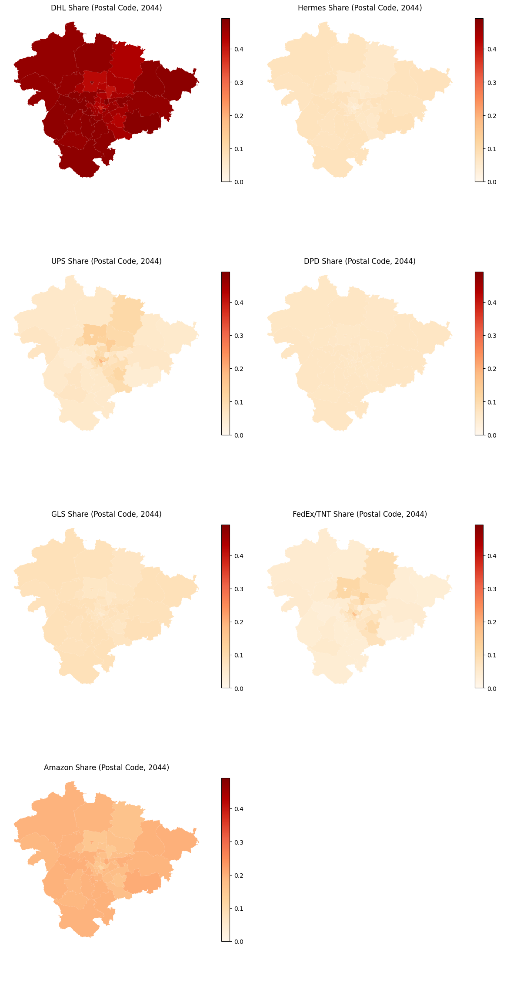

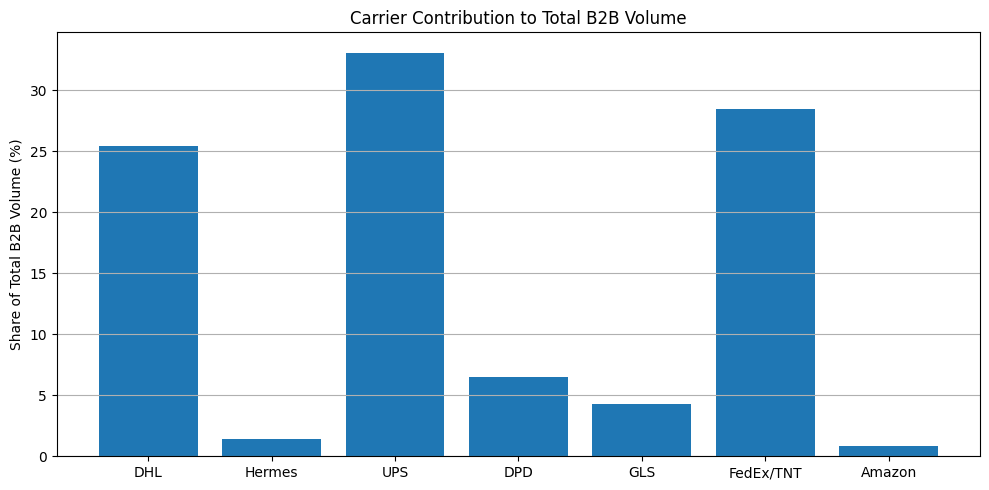

     Carrier  B2B Share (%)
2        UPS          33.11
5  FedEx/TNT          28.45
0        DHL          25.44
3        DPD           6.51
4        GLS           4.30
1     Hermes           1.38
6     Amazon           0.82


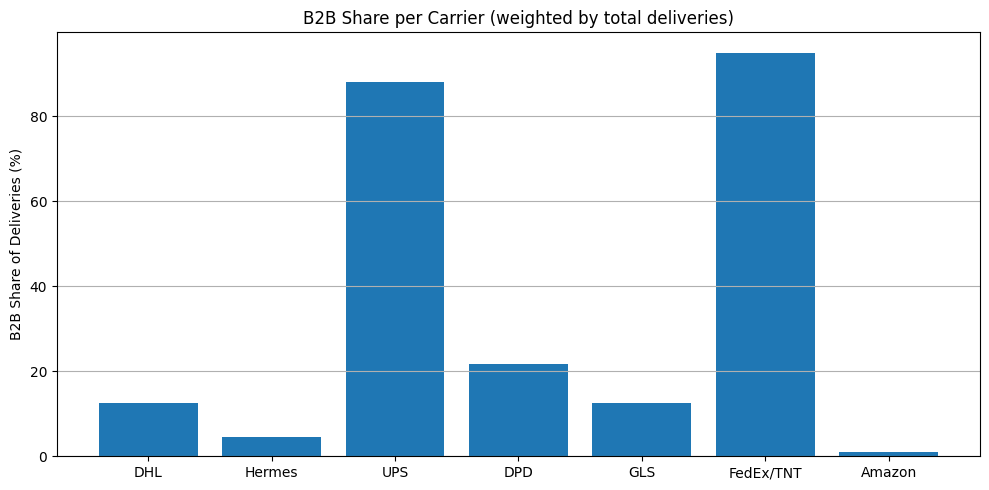

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)


✅ Optimized B2B shares for 2044:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2044
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2045 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


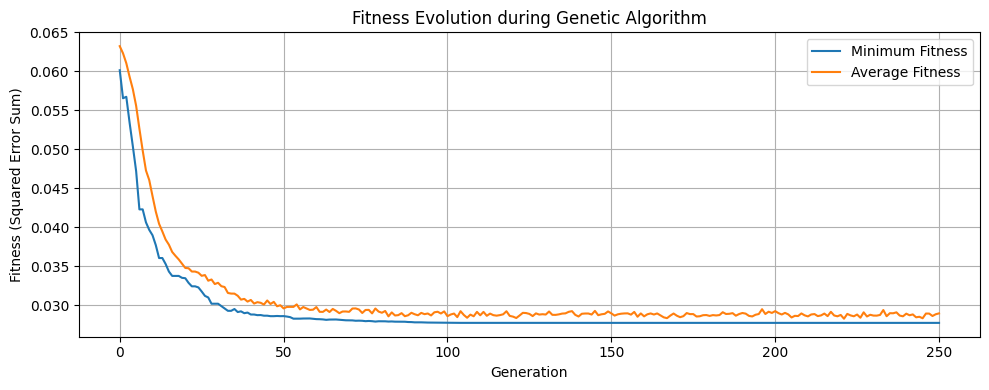

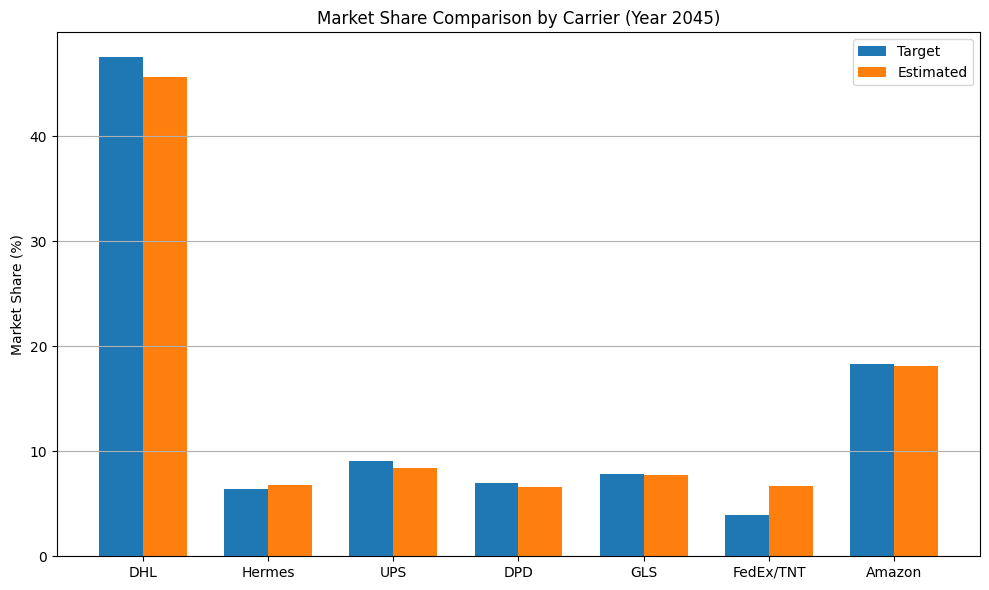

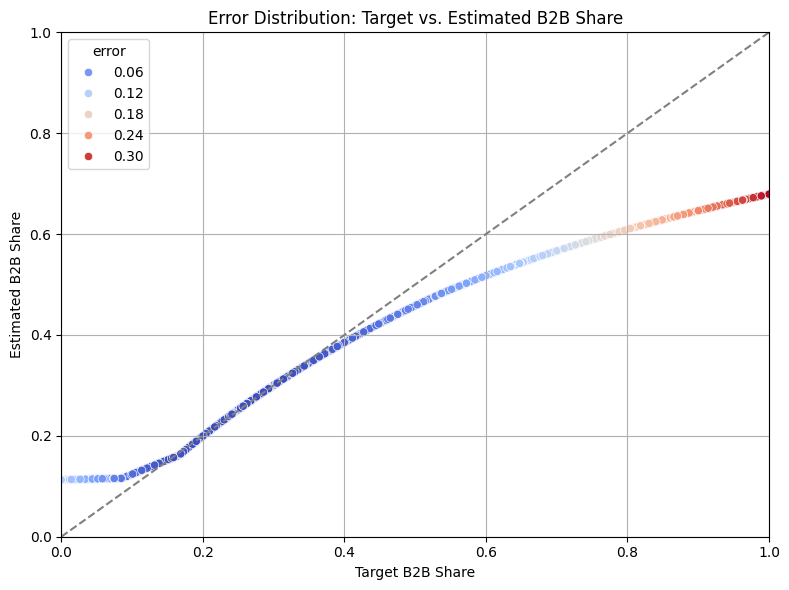


Weighted RMSE per cell: 0.0828
Estimated national B2B share (weighted): 0.2229
Target B2B share from input: 0.2000
Absolute deviation: 0.0228


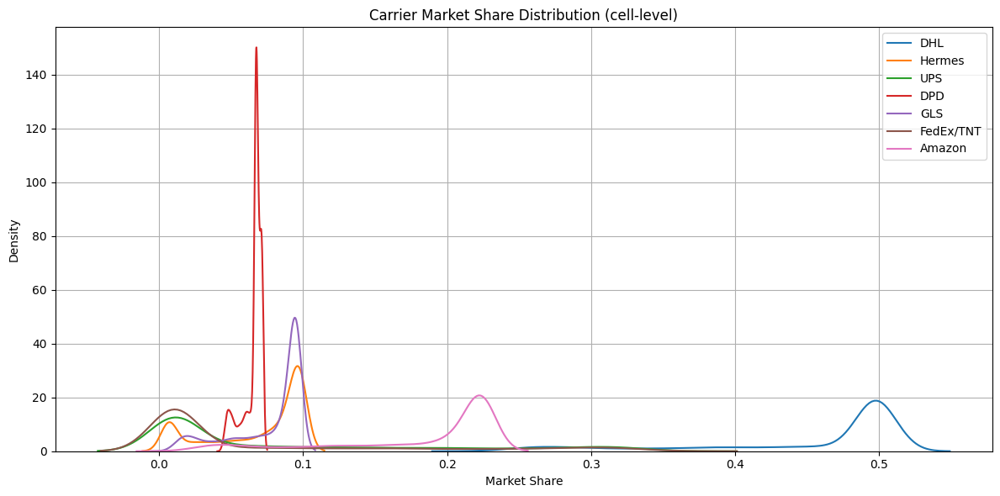

            mean    std  range
DHL        0.452  0.077  0.282
Hermes     0.069  0.034  0.092
UPS        0.085  0.104  0.338
DPD        0.065  0.007  0.028
GLS        0.077  0.026  0.088
FedEx/TNT  0.071  0.100  0.341
Amazon     0.181  0.062  0.209


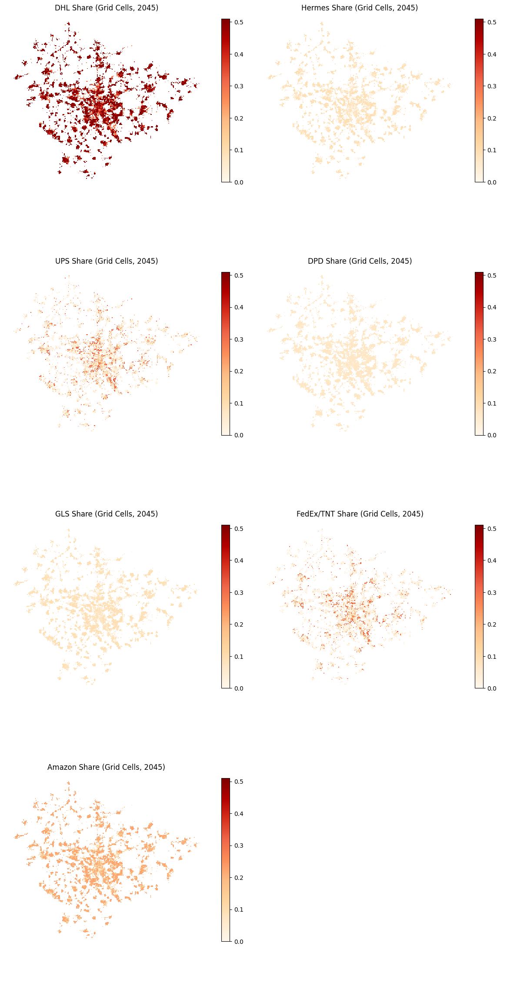

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

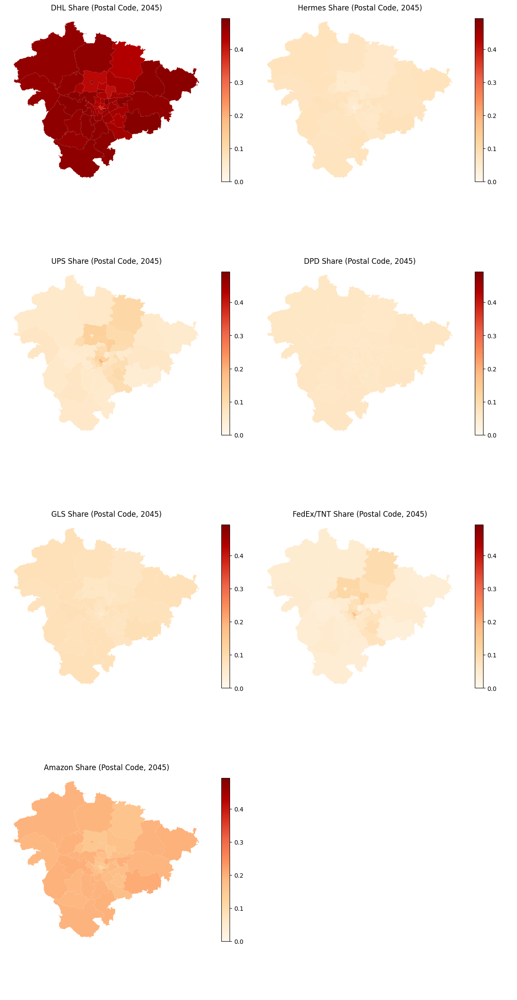

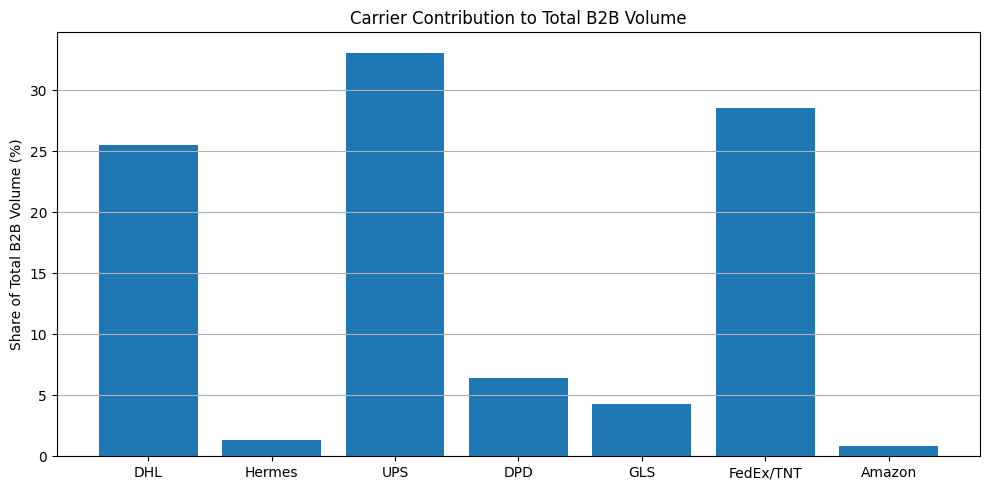

     Carrier  B2B Share (%)
2        UPS          33.07
5  FedEx/TNT          28.52
0        DHL          25.49
3        DPD           6.44
4        GLS           4.31
1     Hermes           1.36
6     Amazon           0.81


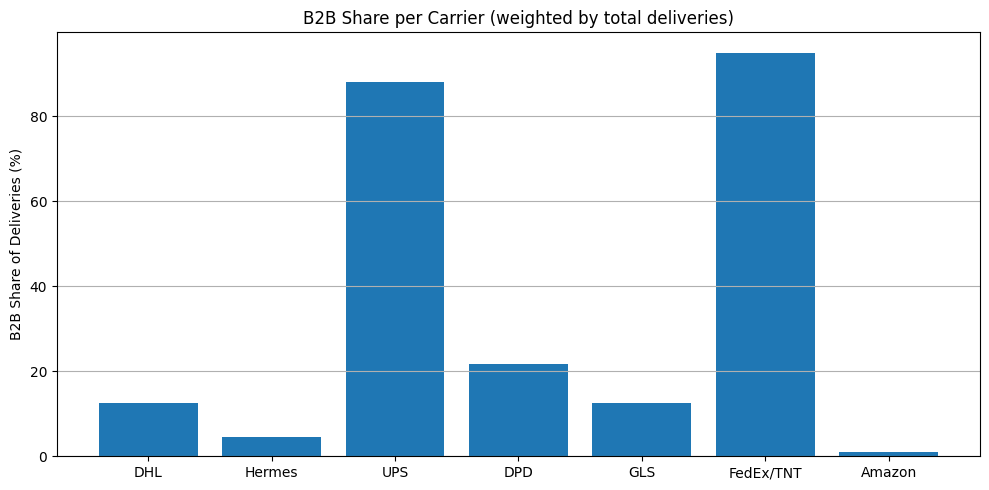

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2045:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2045
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2046 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


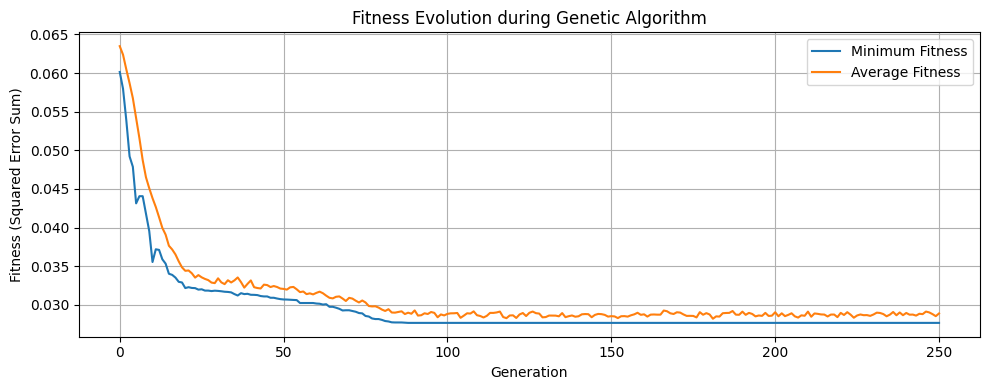

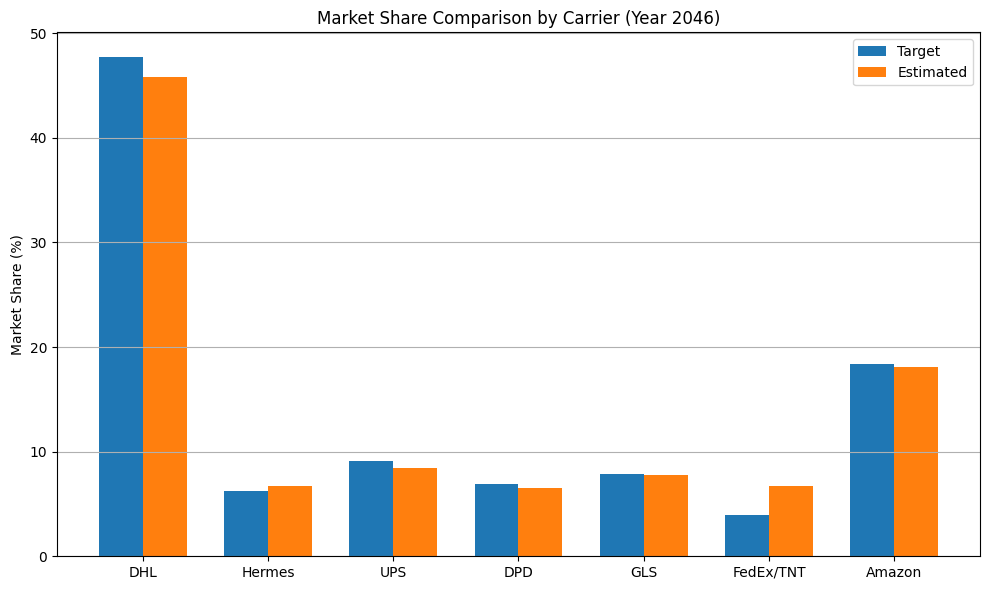

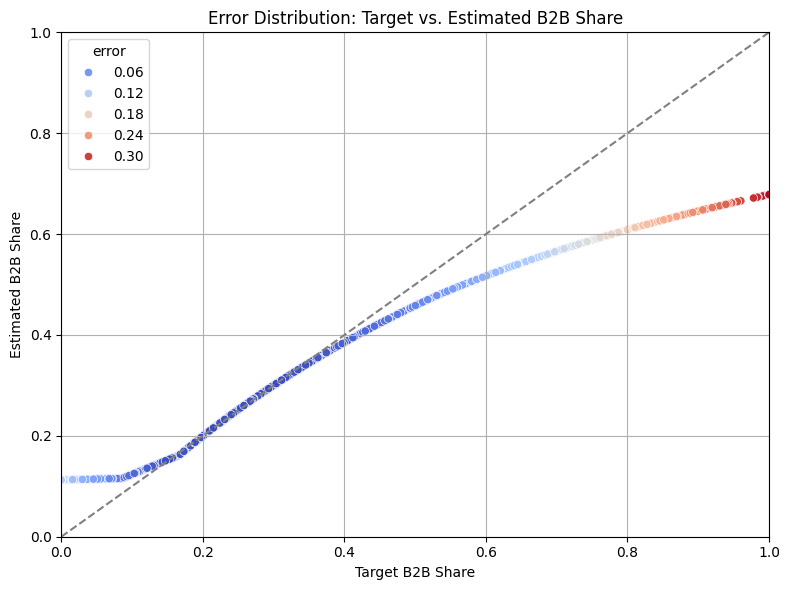


Weighted RMSE per cell: 0.0828
Estimated national B2B share (weighted): 0.2229
Target B2B share from input: 0.2000
Absolute deviation: 0.0229


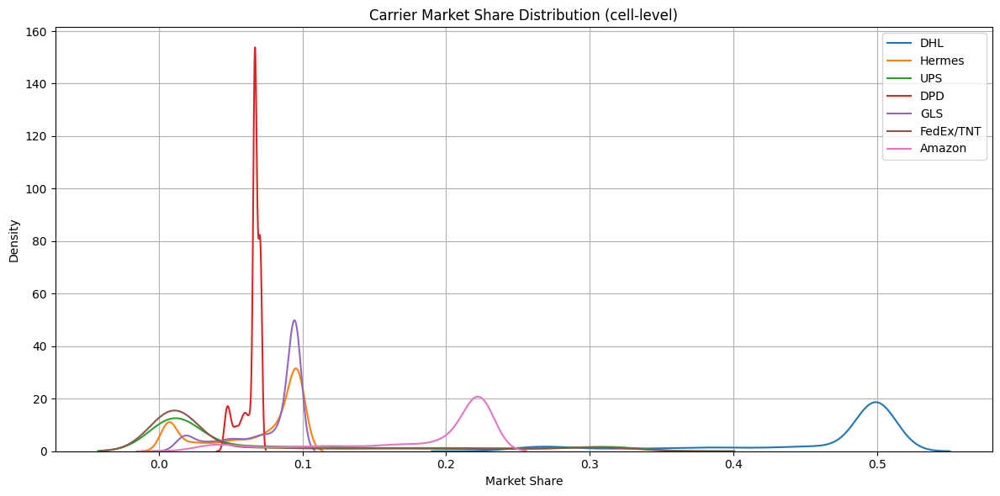

            mean    std  range
DHL        0.454  0.077  0.283
Hermes     0.068  0.034  0.091
UPS        0.085  0.104  0.338
DPD        0.065  0.007  0.027
GLS        0.077  0.026  0.088
FedEx/TNT  0.071  0.100  0.340
Amazon     0.180  0.061  0.209


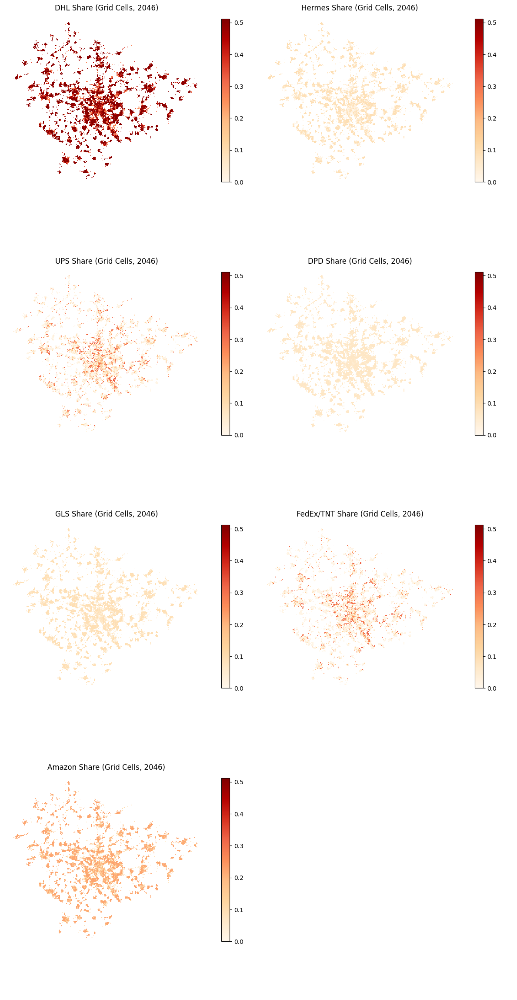

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

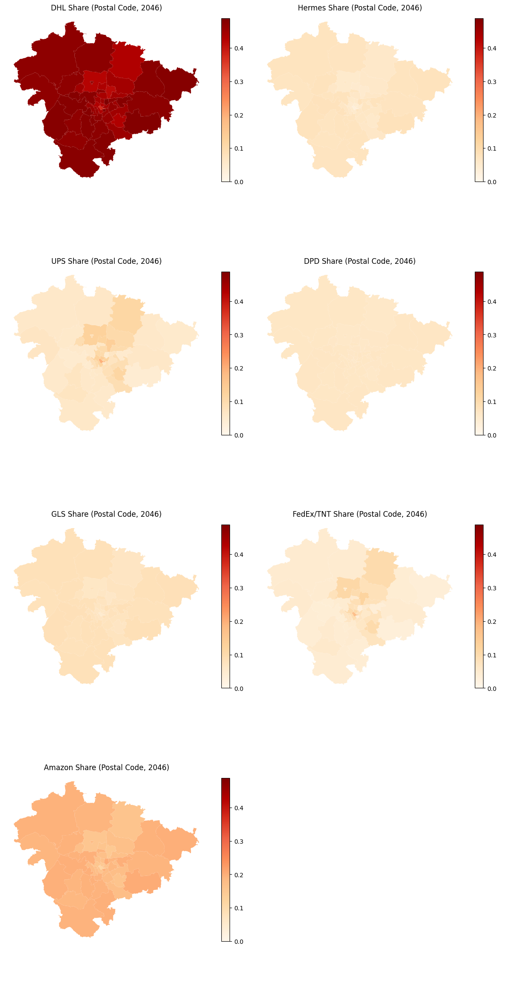

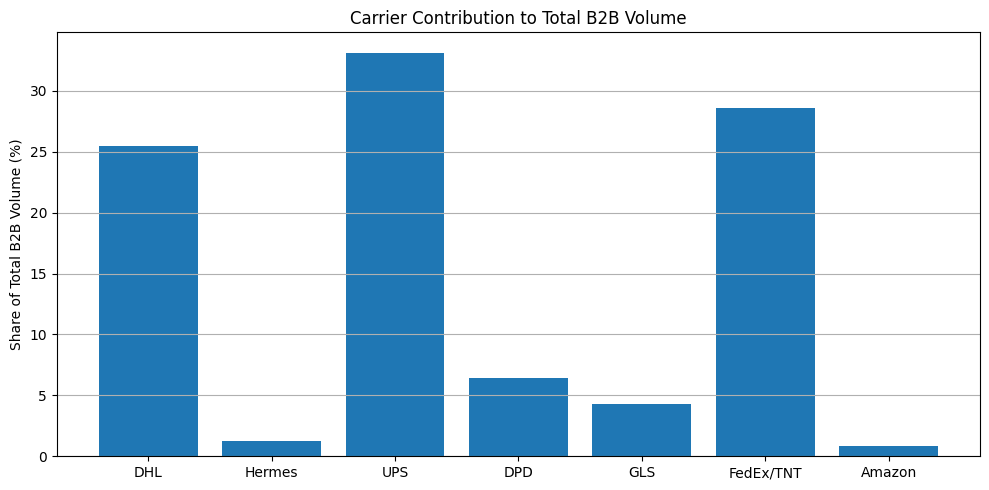

     Carrier  B2B Share (%)
2        UPS          33.15
5  FedEx/TNT          28.55
0        DHL          25.52
3        DPD           6.39
4        GLS           4.31
1     Hermes           1.26
6     Amazon           0.81


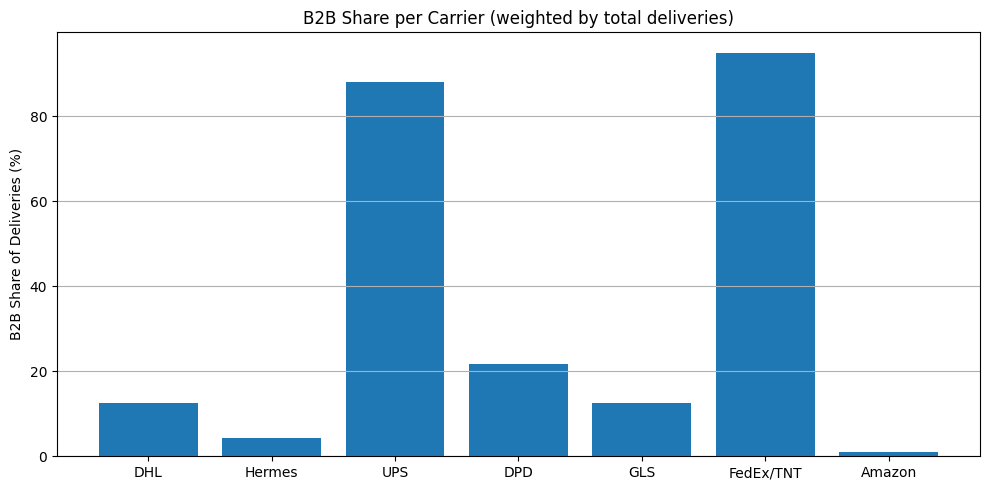

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.77
4        GLS          12.44
0        DHL          12.42
1     Hermes           4.19
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2046:
  DHL: 0.124
  Hermes: 0.042
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2046
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2047 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


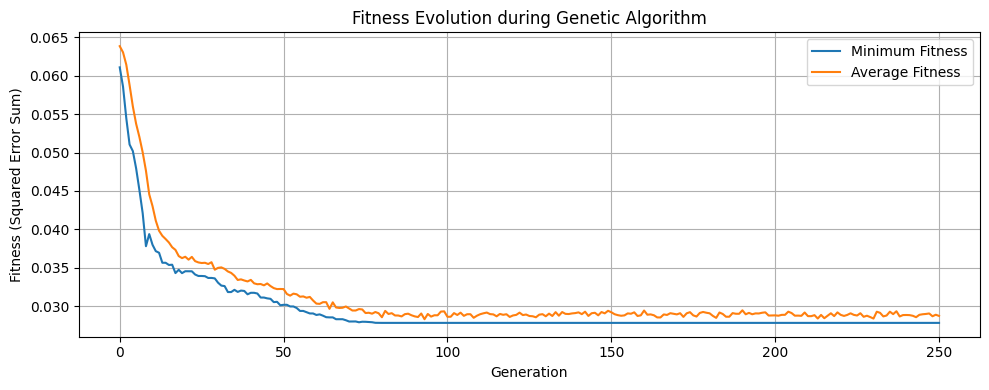

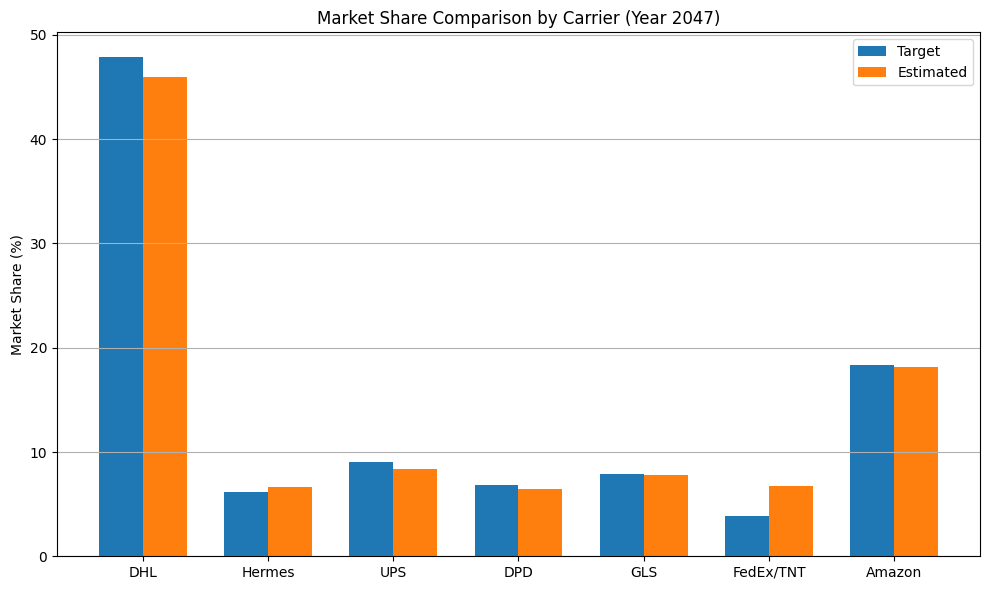

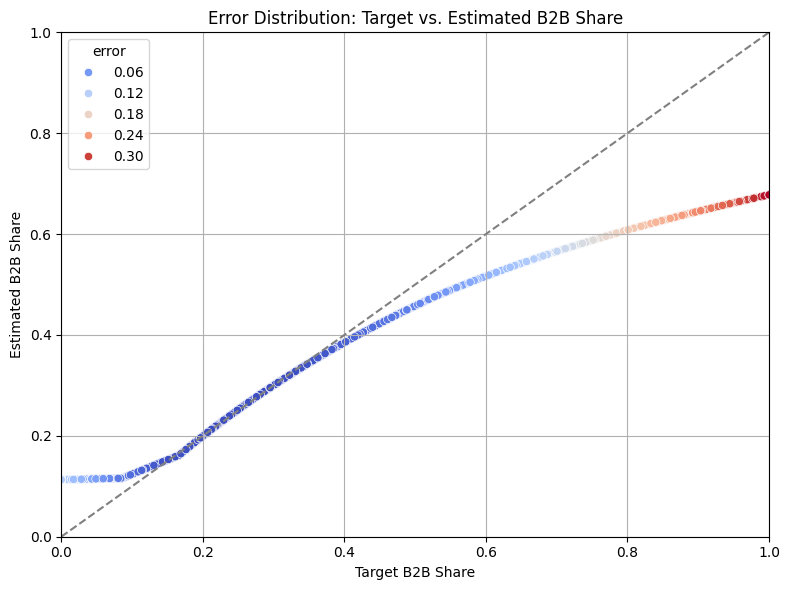


Weighted RMSE per cell: 0.0836
Estimated national B2B share (weighted): 0.2229
Target B2B share from input: 0.2000
Absolute deviation: 0.0229


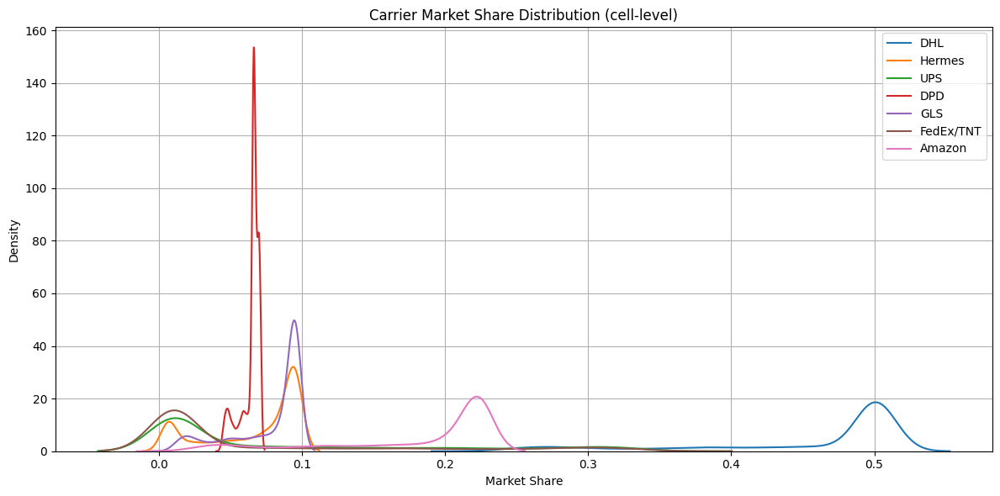

            mean    std  range
DHL        0.455  0.078  0.284
Hermes     0.067  0.033  0.090
UPS        0.085  0.104  0.338
DPD        0.064  0.007  0.027
GLS        0.077  0.026  0.088
FedEx/TNT  0.071  0.100  0.340
Amazon     0.180  0.062  0.209


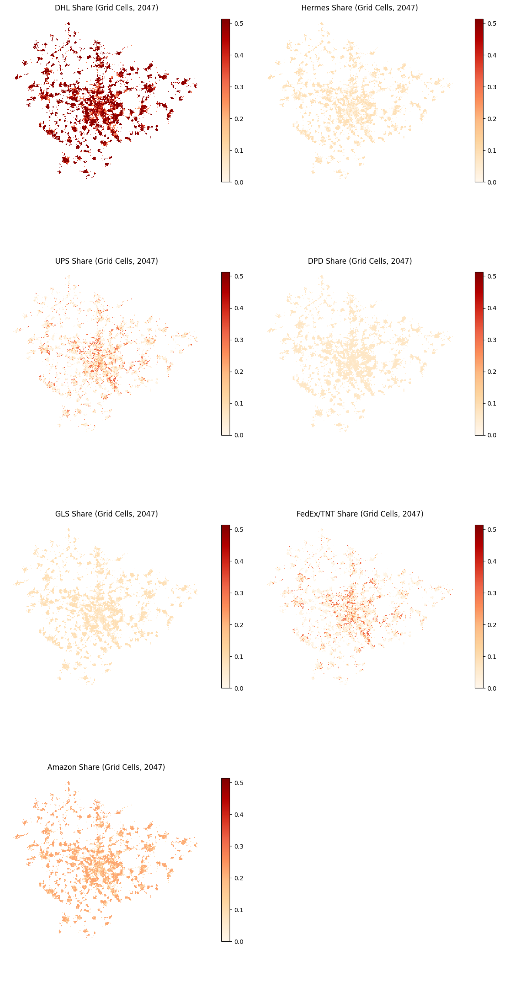

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

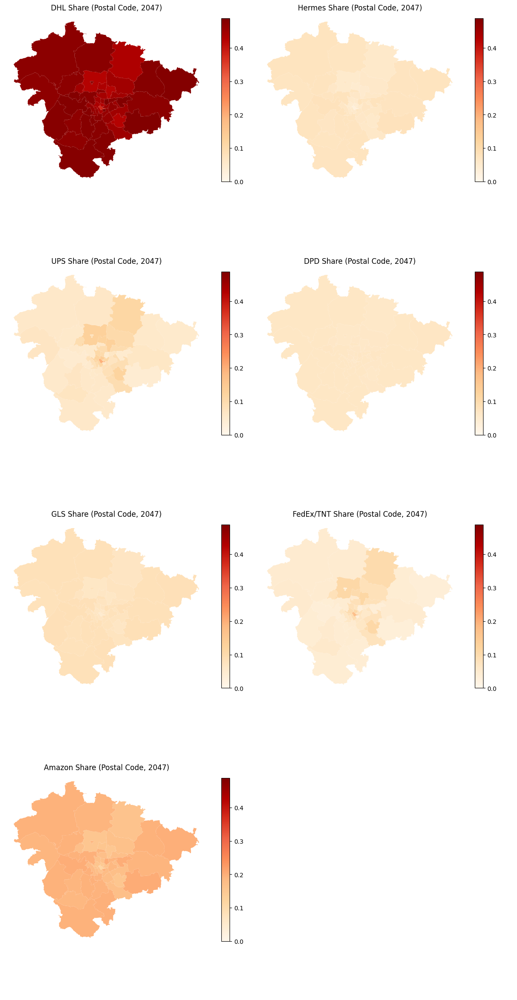

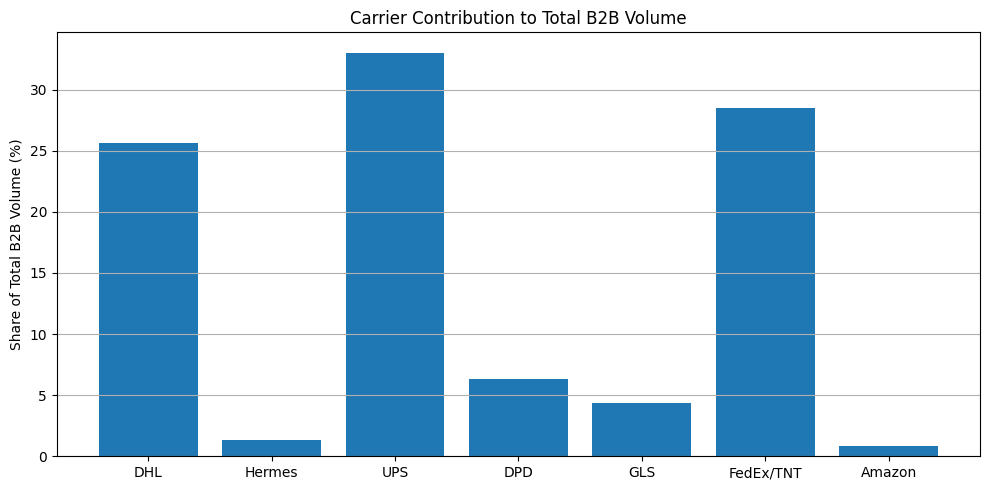

     Carrier  B2B Share (%)
2        UPS          33.04
5  FedEx/TNT          28.52
0        DHL          25.63
3        DPD           6.34
4        GLS           4.33
1     Hermes           1.32
6     Amazon           0.81


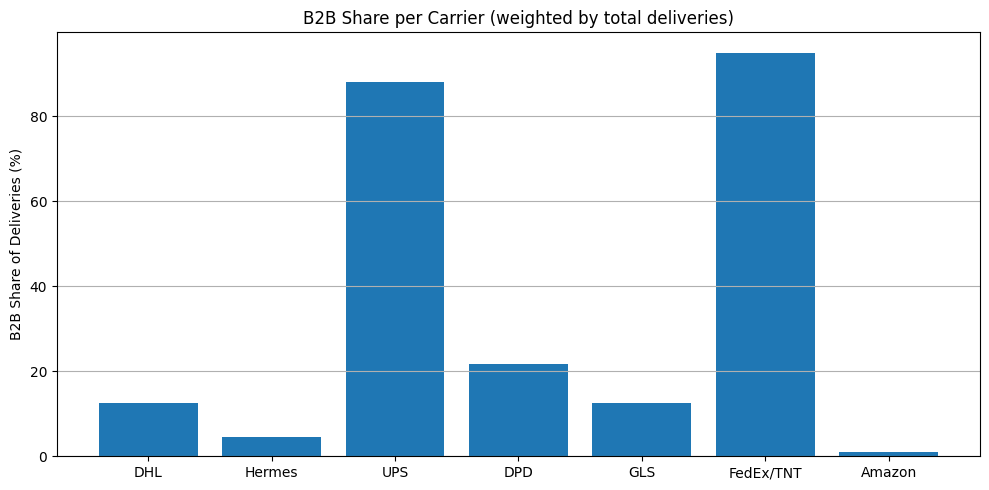

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2047:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2047
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2048 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


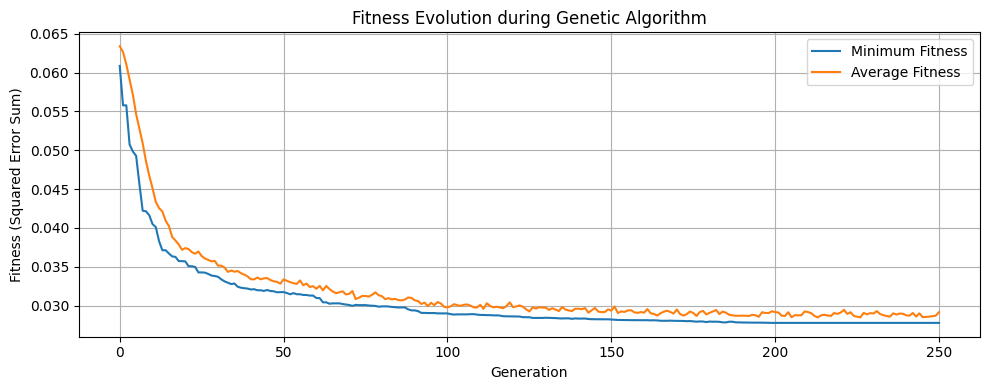

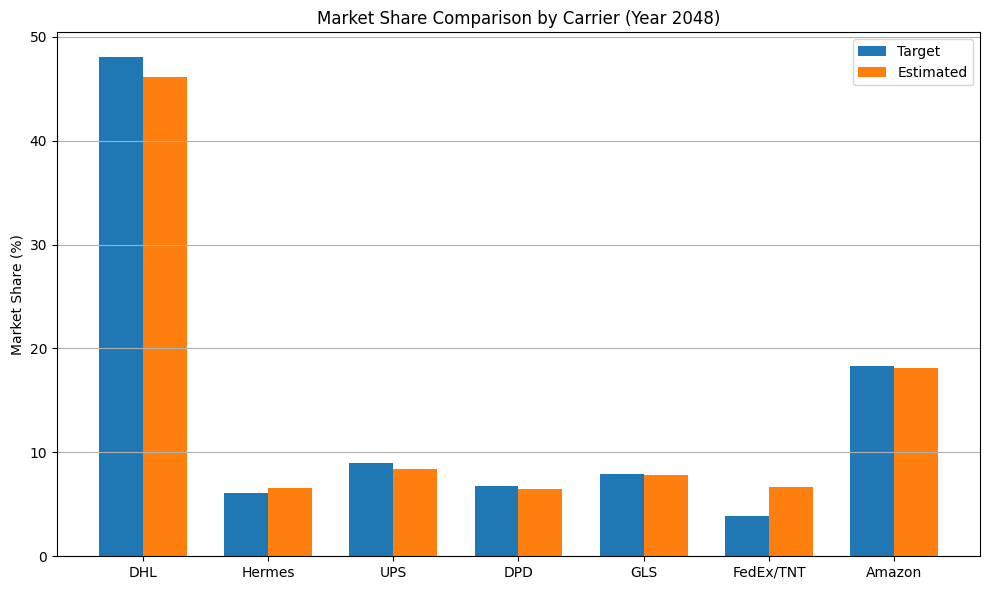

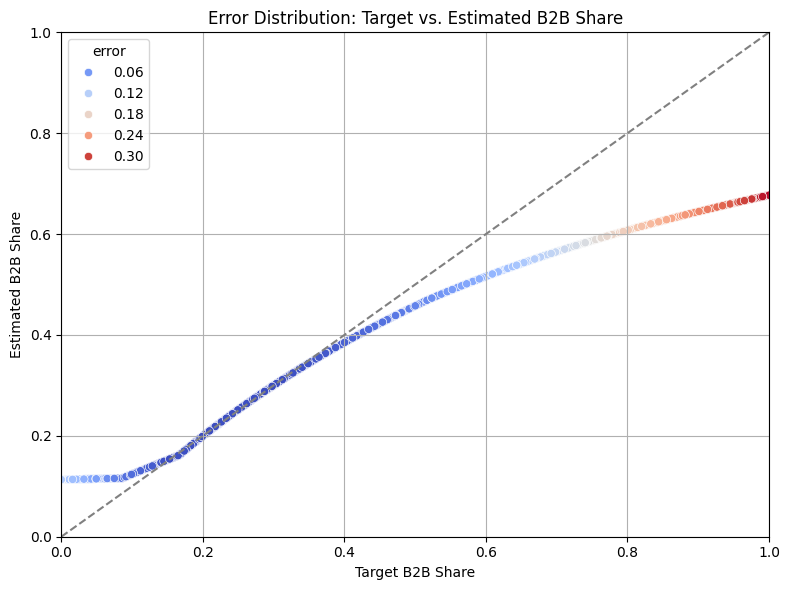


Weighted RMSE per cell: 0.0832
Estimated national B2B share (weighted): 0.2227
Target B2B share from input: 0.2000
Absolute deviation: 0.0227


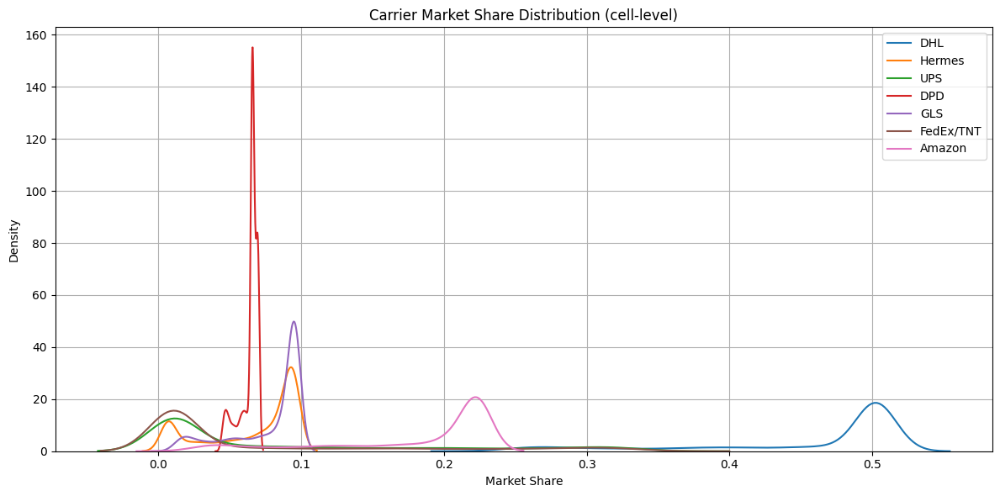

            mean    std  range
DHL        0.457  0.078  0.284
Hermes     0.066  0.033  0.089
UPS        0.085  0.104  0.337
DPD        0.064  0.007  0.027
GLS        0.077  0.026  0.088
FedEx/TNT  0.071  0.100  0.339
Amazon     0.180  0.062  0.209


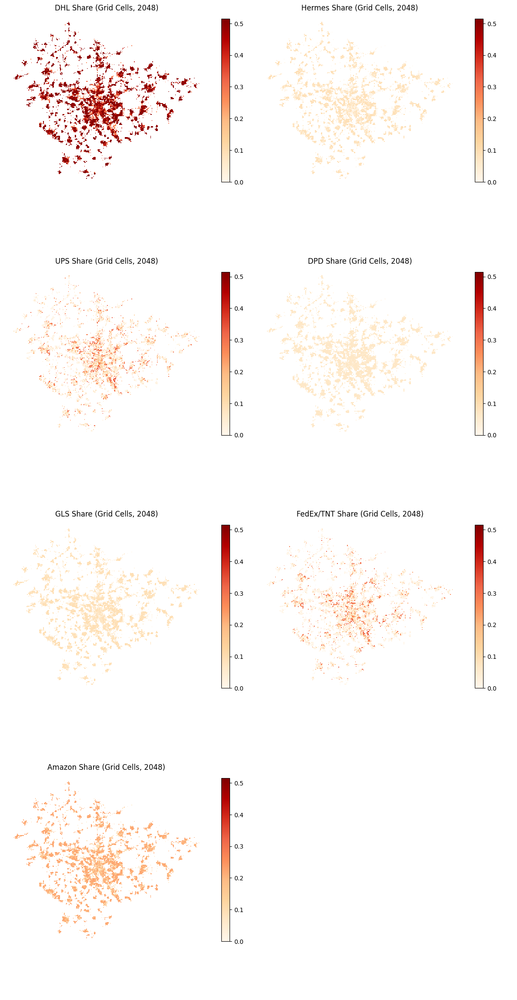

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

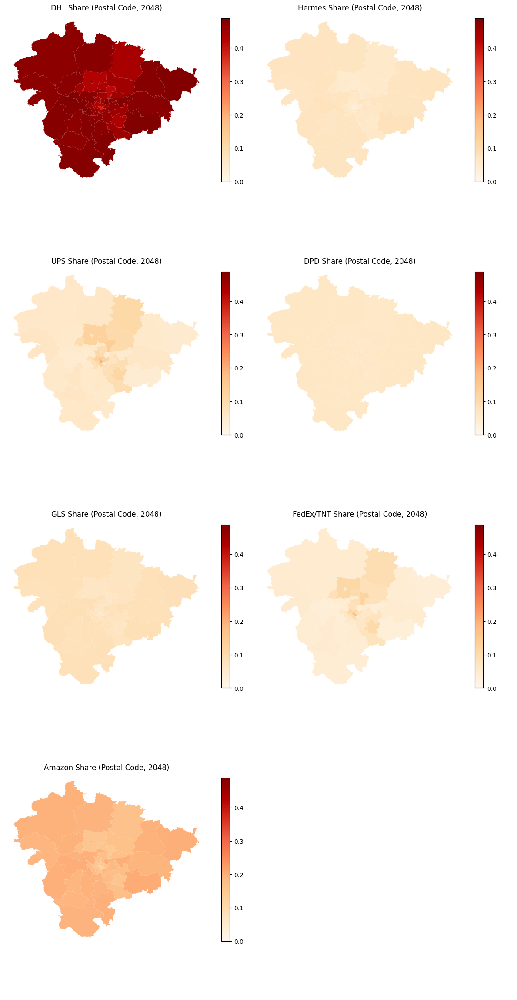

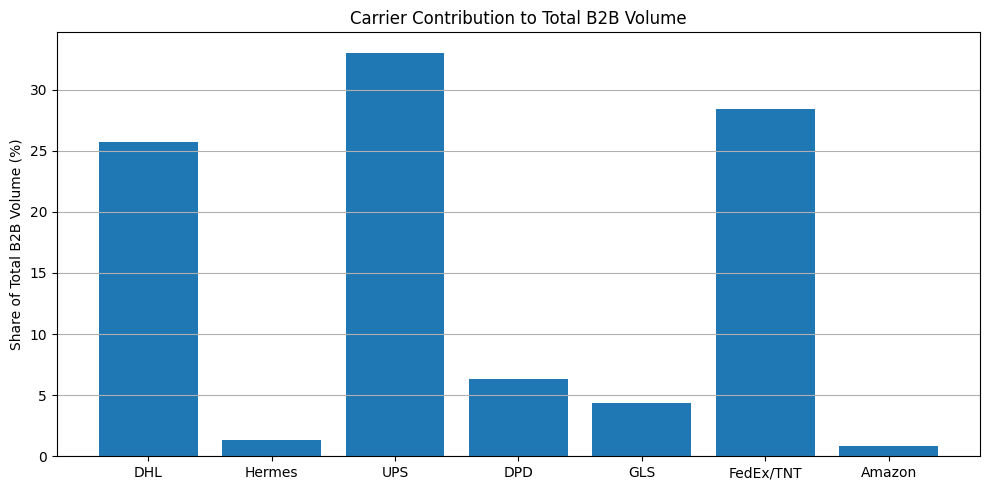

     Carrier  B2B Share (%)
2        UPS          33.04
5  FedEx/TNT          28.44
0        DHL          25.75
3        DPD           6.31
4        GLS           4.35
1     Hermes           1.30
6     Amazon           0.81


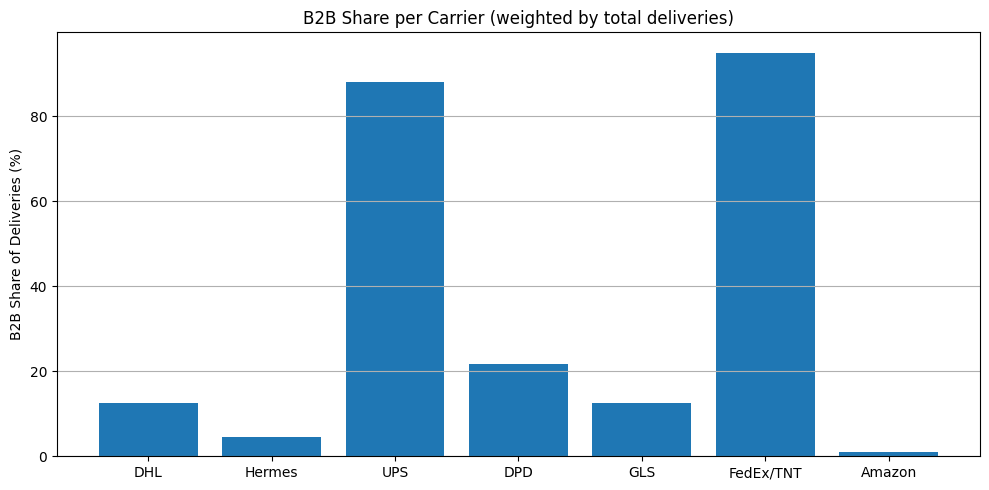

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          21.78
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rena

✅ Optimized B2B shares for 2048:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2048
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2049 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


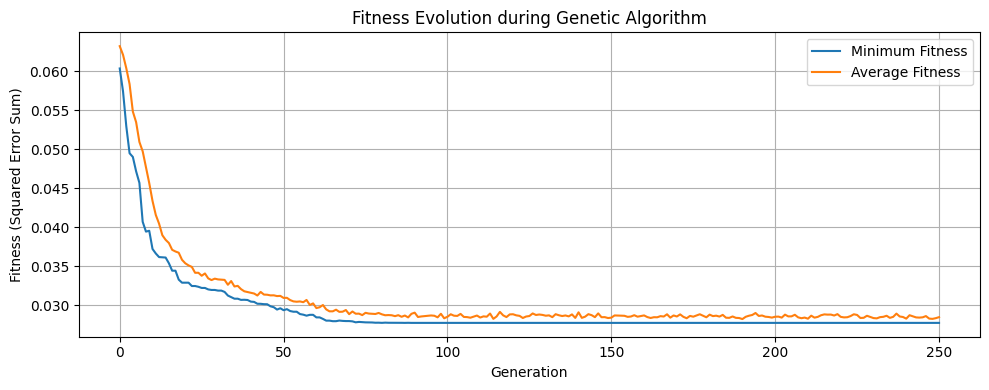

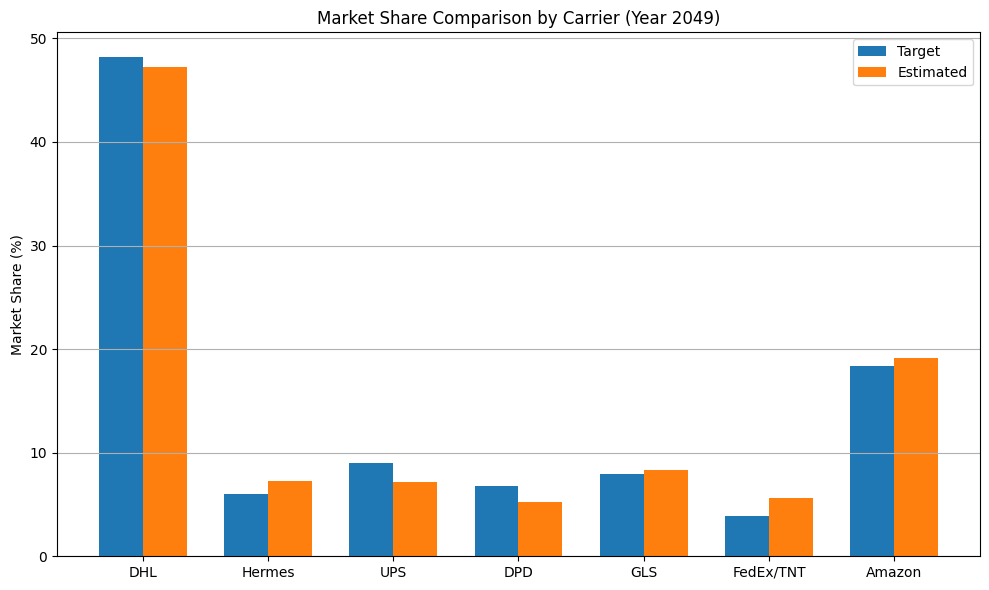

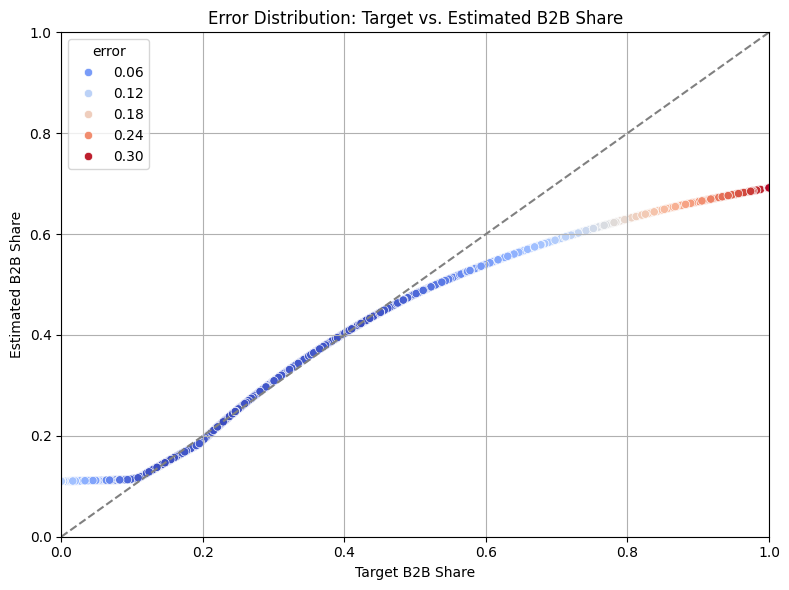


Weighted RMSE per cell: 0.0776
Estimated national B2B share (weighted): 0.2250
Target B2B share from input: 0.2000
Absolute deviation: 0.0250


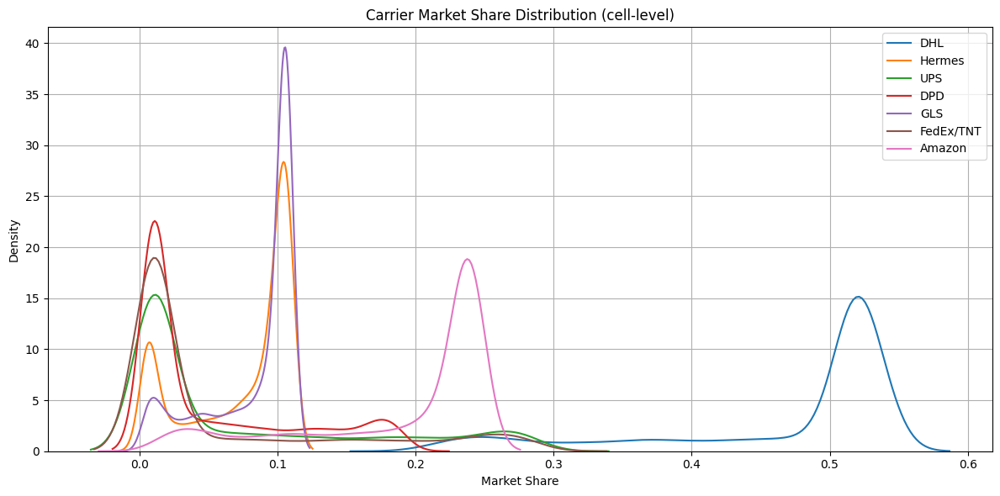

            mean    std  range
DHL        0.467  0.094  0.339
Hermes     0.074  0.038  0.101
UPS        0.073  0.090  0.284
DPD        0.053  0.059  0.184
GLS        0.083  0.033  0.102
FedEx/TNT  0.060  0.085  0.285
Amazon     0.190  0.071  0.234


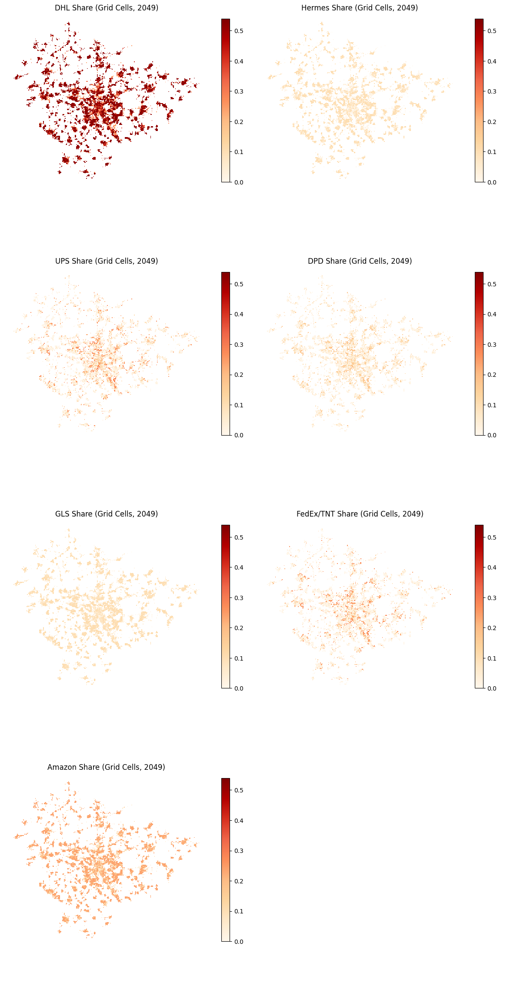

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

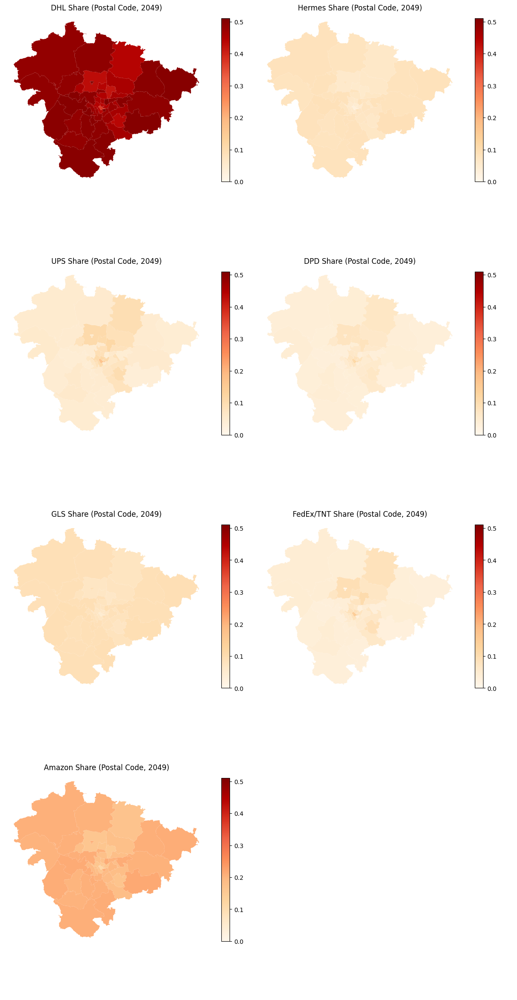

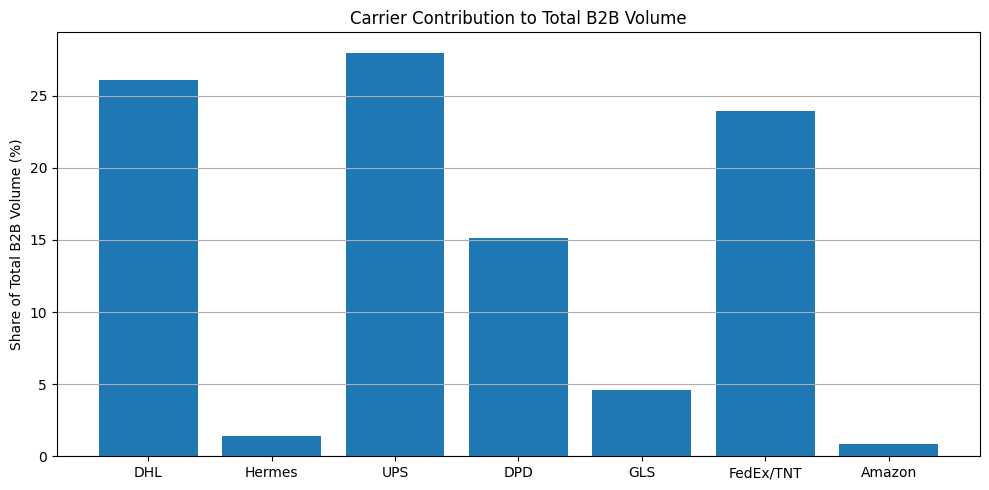

     Carrier  B2B Share (%)
2        UPS          27.99
0        DHL          26.09
5  FedEx/TNT          23.91
3        DPD          15.10
4        GLS           4.61
1     Hermes           1.44
6     Amazon           0.85


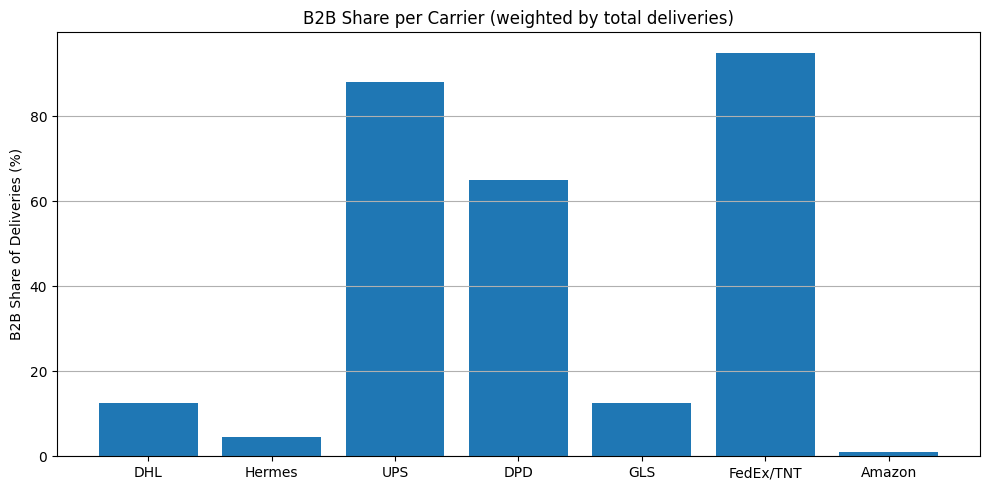

     Carrier  B2B Share (%)
5  FedEx/TNT          95.00
2        UPS          88.00
3        DPD          65.00
0        DHL          12.44
4        GLS          12.44
1     Hermes           4.44
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)


✅ Optimized B2B shares for 2049:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.650
  GLS: 0.124
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2049
════════════════════════════════════════════════════════════

════════════════════════════════════════════════════════════
📅  YEAR 2050 — STARTING OPTIMIZATION
════════════════════════════════════════════════════════════


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


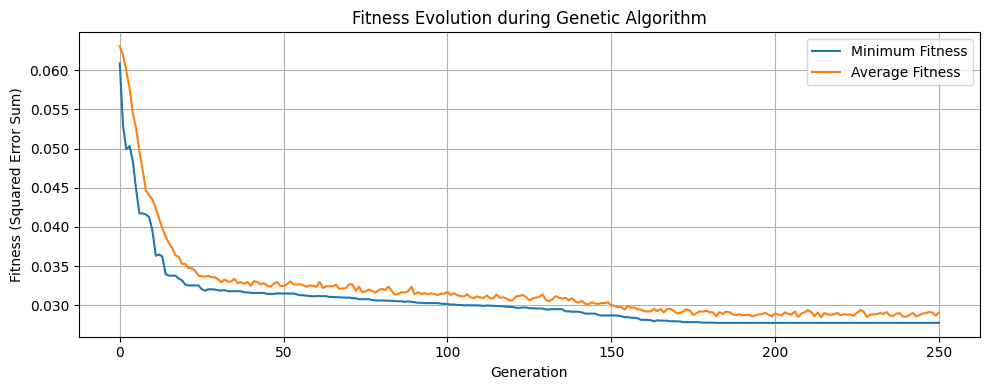

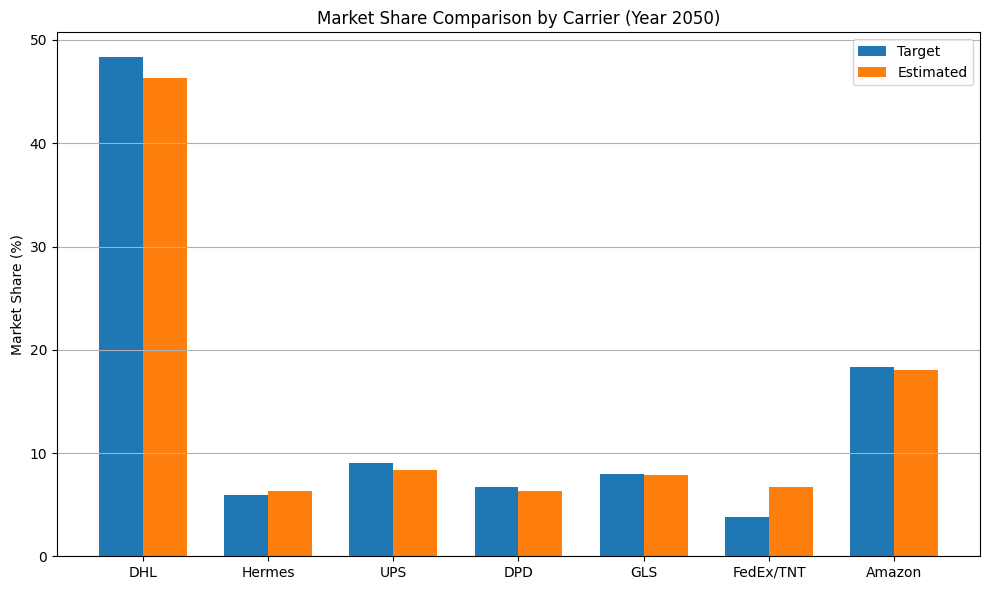

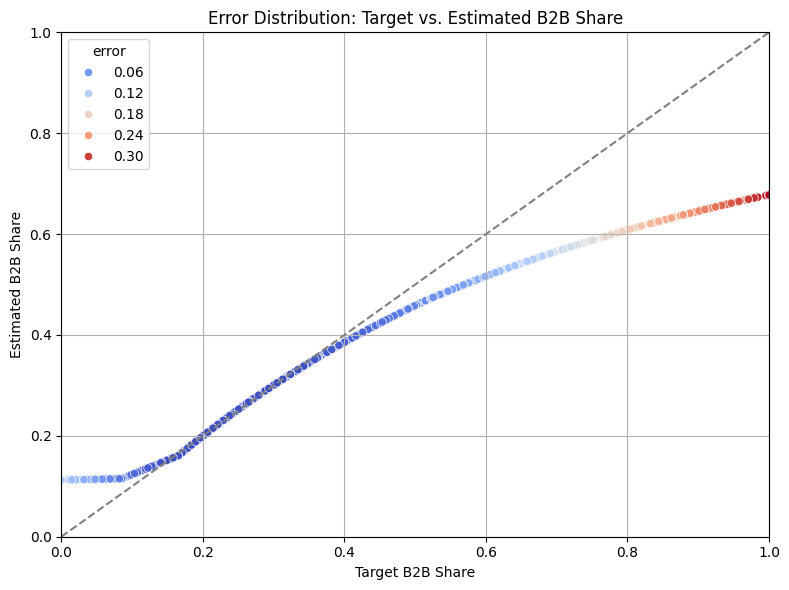


Weighted RMSE per cell: 0.0829
Estimated national B2B share (weighted): 0.2226
Target B2B share from input: 0.2000
Absolute deviation: 0.0226


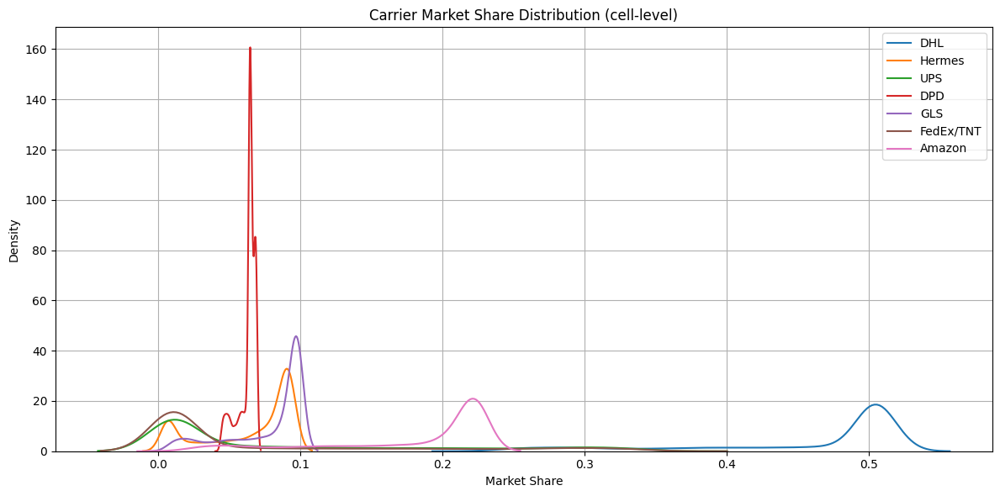

            mean    std  range
DHL        0.459  0.078  0.285
Hermes     0.064  0.032  0.086
UPS        0.085  0.104  0.338
DPD        0.063  0.006  0.026
GLS        0.078  0.028  0.093
FedEx/TNT  0.071  0.100  0.340
Amazon     0.180  0.061  0.208


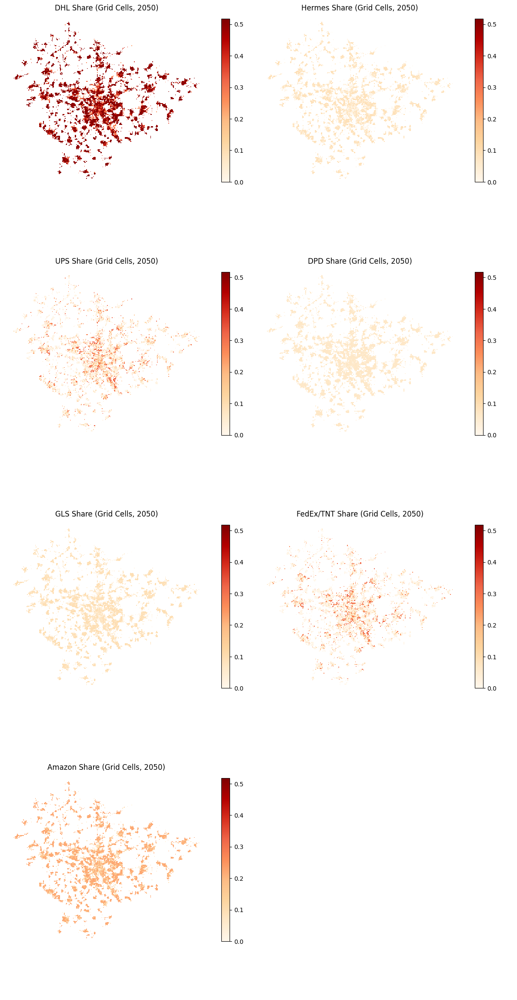

C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["total_coun"]))
C:\Users\bienzeisler\AppData\Local\Temp\ipykernel_22148\304593485.py:233: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  f"share_{c}": grouped.apply(lambda g: np.average(g[f"share_{c}"], weights=g["t

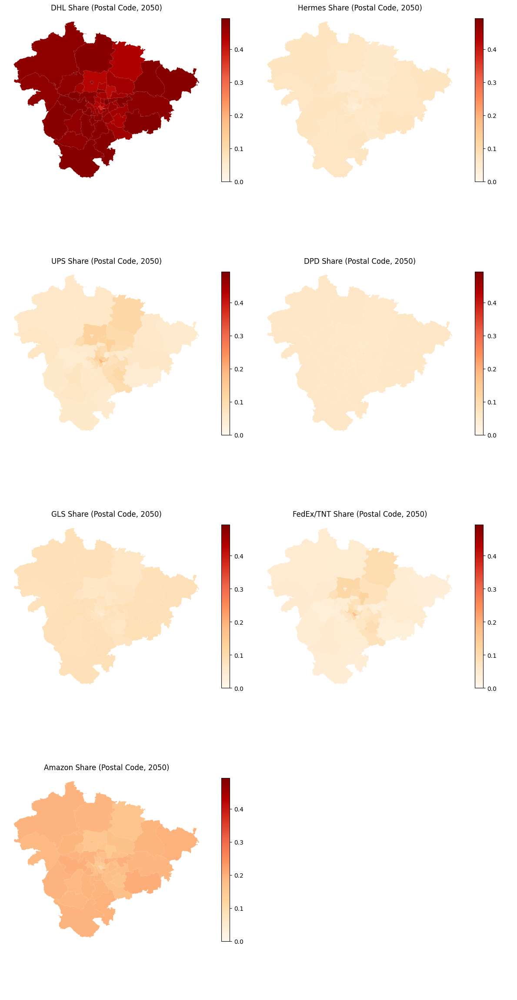

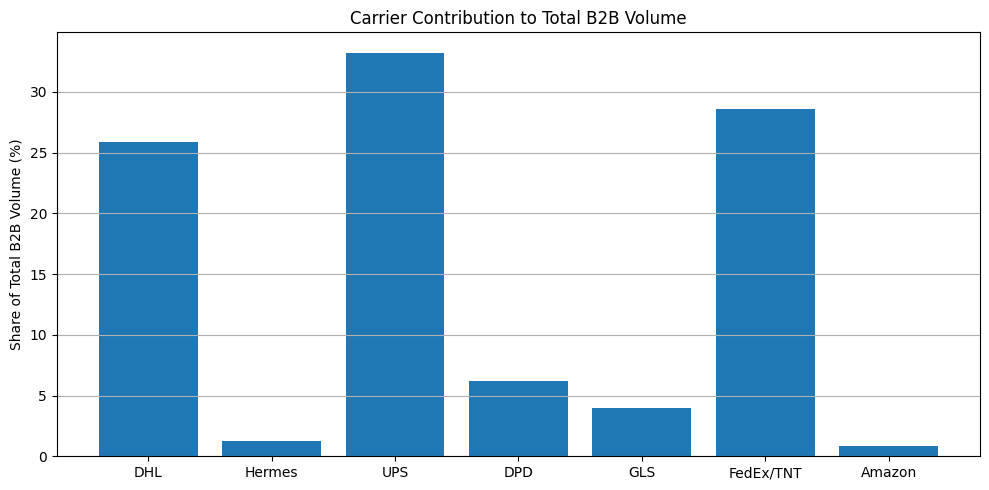

     Carrier  B2B Share (%)
2        UPS          33.23
5  FedEx/TNT          28.59
0        DHL          25.88
3        DPD           6.21
4        GLS           4.01
1     Hermes           1.26
6     Amazon           0.81


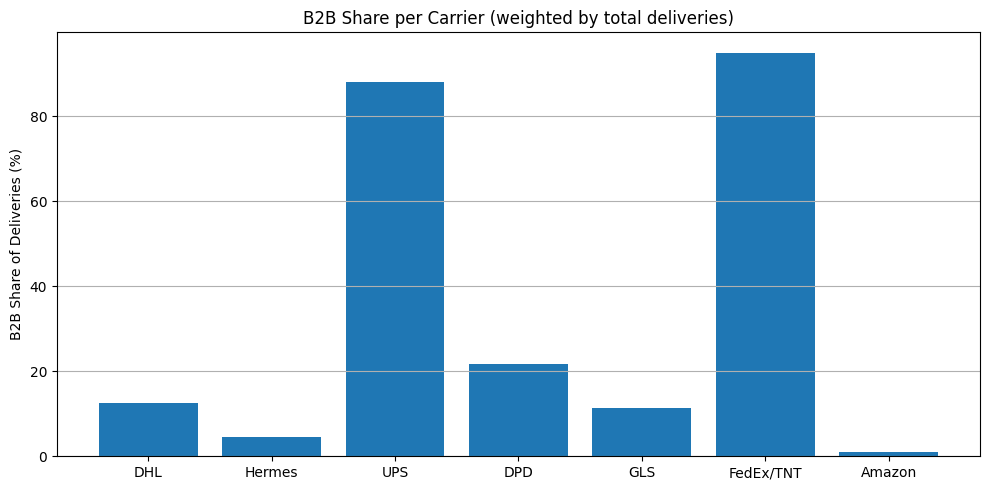

     Carrier  B2B Share (%)
5  FedEx/TNT          95.01
2        UPS          88.03
3        DPD          21.77
0        DHL          12.44
4        GLS          11.40
1     Hermes           4.43
6     Amazon           1.00


c:\Users\bienzeisler\Anaconda3\envs\matsim_geo_environment\lib\site-packages\geopandas\geodataframe.py:1543: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)


✅ Optimized B2B shares for 2050:
  DHL: 0.124
  Hermes: 0.044
  UPS: 0.880
  DPD: 0.218
  GLS: 0.114
  FedEx/TNT: 0.950
  Amazon: 0.010
✅ DONE — Year 2050
════════════════════════════════════════════════════════════


In [122]:
# ============================================================================================
# 🚀 B2B Carrier Share Optimization Loop (Annual Execution)
# --------------------------------------------------------------------------------------------
# This section performs a full end-to-end optimization of carrier-specific B2B shares
# for a given year, using a genetic algorithm (GA).
#
# ⬇️ What is this all about?
# ---------------------------
# In our spatial model of parcel logistics, we divide Germany into a grid of cells (e.g., 1x1 km),
# and for each cell we have:
#   - Estimated total parcel volume (from DHL data)
#   - A rough estimate of the B2B share in that cell (based on regression with population + businesses)
#
# However, we also know:
#   - Not all carriers serve the same type of customers (some focus more on B2B than others)
#   - B2B distribution isn't uniform across carriers (e.g., UPS might be 80% B2B, Amazon only 5%)
#
# ✅ Goal:
# -------
# → Find a realistic **B2B share for each carrier** (e.g., DHL = 35%, Hermes = 10%, etc.)
# → Such that when we apply those values across all grid cells:
#     - The **B2B share in each cell** is approximately hit
#     - The **total market shares per carrier** (on national level) are still met
#     - And carrier-specific constraints (min/max B2B share) are respected
#
#
# 🔁 Process for Each Year:
# -------------------------
# For every year we want to optimize (e.g., 2020, 2030, ...), we:
#
# 1. Dynamically scale each carrier’s lower B2B bound:
#    → Reflects the structural trend that B2B shares in the parcel market have been shrinking over time.
#
# 2. Estimate the initial B2B share per carrier (typically using the midpoint of the scaled bounds).
#
# 3. Core logic — Call `fast_vectorized_estimation`:
#    This function adjusts the market shares of each carrier **per grid cell**, so that:
#      ✅ The cell’s estimated B2B target is matched as closely as possible
#      ✅ The adjusted market shares still resemble the national-level carrier shares
#
#    🔍 What happens inside `fast_vectorized_estimation`:
#    -----------------------------------------------------
#    Imagine each grid cell has a target B2B ratio (e.g., 0.35) and a default market share vector
#    (e.g., [DHL=60%, Hermes=10%, UPS=30%]).
#
#    The function:
#      - Computes how far the current B2B value (based on the carriers' B2B profiles) is from the target
#      - Determines a **correction direction** in the vector space (e.g., shift from DHL to UPS)
#      - Applies that correction to the market share vector of the cell
#        → Ensures that more B2B-heavy carriers get slightly more share where B2B is high
#           and less where B2B is low
#      - The adjustment is done using broadcasting and vectorized NumPy operations
#
#    🔁 This happens for all cells in one go (fully vectorized!), not in a loop
#
#    The result:
#    -----------
#    - A new, corrected market share matrix (cells × carriers)
#    - An estimated B2B value per cell (from the adjusted shares)
#    - The squared error between estimated and target B2B (used in evaluation)
#    - Optionally: national-level market share error (compared to official market shares)
#
# 4. Final Outputs:
#    - Updated per-cell carrier distributions (used for plotting or simulation)
#    - Estimated B2B ratio per grid cell
#    - RMSE and diagnostic plots (to check how close we are to targets)
#
# 📊 Output and Evaluation:
# -------------------------
# For each year, we output:
#   - `optimized_b2b_by_carrier`: the final B2B share for each carrier
#   - A comparison of **target vs. optimized national market shares**
#   - KDE plots of B2B shares across zip codes (PLZ)
#   - RMSE error between estimated and target B2B shares (weighted by volume)
#   - Per-cell adjusted market share matrix (used in downstream simulations)
#
# 📁 Optional Exports:
# -------------------
# The process can also export:
#   - Cell-level outputs (`df_weighted`) with estimated B2B values and carrier distributions
#   - The valid grid cells used in the optimization (`valid_df`)
#
# This enables later use in forecasting, visualization, and simulation of market structure
# under different scenarios and assumptions.
# ============================================================================================


# Step 1: Define base (static) bounds per carrier — this reflects prior knowledge / qualitative estimation
base_bounds = {
    "DHL": (0.28, 0.4),
    "Hermes": (0.1, 0.5),
    "UPS": (0.5, 0.88),
    "Amazon": (0.01, 0.1),
    "DPD": (0.49, 0.65),
    "GLS": (0.28, 0.5),
    "FedEx/TNT": (0.78, 0.95),
}

# Initialize a list to store results per year
optimized_b2b_all_years = []

previous_b2b = None  # wird in Jahr 2014 mit Midpoints gefüllt

for year in range(2014, 2051):  # Adjust the range as needed
    print("\n" + "═" * 60)
    print(f"📅  YEAR {year} — STARTING OPTIMIZATION")
    print("═" * 60)

    # Step 1 Dynamically scale bounds for this year (reflect long-term market trend)
    # Note:
    # Although various different strategies could be applied, we observed that 
    # a simple *linear scaling* of the lower B2B bounds over time leads to the lowest 
    # final deviations (e.g., lower RMSE between target and estimated B2B shares).
    # Therefore, the "linear" method is selected here as default.

    realistic_b2b_bounds = generate_dynamic_bounds(
        year=year,
        base_bounds=base_bounds,
        method="linear"
    )

    # # Step 2: Use the midpoint of each bound range as initial B2B share per carrier
    # # This serves as the starting input to the optimization
    # b2b_share_by_carrier = {
    #     carrier: round((low + high) / 2, 3)
    #     for carrier, (low, high) in realistic_b2b_bounds.items()
    # }
        # Step 2: Initialwerte
    if previous_b2b is None:
        # Für das erste Jahr: Mittelwert der Bounds
        b2b_share_by_carrier = {
            carrier: round((low + high) / 2, 3)
            for carrier, (low, high) in realistic_b2b_bounds.items()
        }
    else:
        # Ab dem zweiten Jahr: Vorjahresergebnis, aber innerhalb neuer Bounds clamped
        b2b_share_by_carrier = {}
        for carrier, (low, high) in realistic_b2b_bounds.items():
            prev_val = previous_b2b.get(carrier, (low + high) / 2)
            adjusted_val = min(max(prev_val, low), high)
            b2b_share_by_carrier[carrier] = round(adjusted_val, 3)

    # Step 3: Run the GA-based optimization
    optimized_b2b, df_result, weighted_results = run_ga(
        year=year,
        df_market_share=df_marketshare_with_amazon,    # national market share data
        df_b2b_share=df_b2b_share,                      # official B2B share by year
        ga_corrected_b2b_df=ga_corrected_b2b_gdf,       # grid cell B2B estimates
        b2b_share_by_carrier_full=b2b_share_by_carrier, # initial B2B share inputs
        realistic_bounds=realistic_b2b_bounds,          # dynamic bounds per carrier
        plz=gdf_plz,                                    # PLZ geometry (for plotting)
        sample_size=None,                               # use all rows; set int for sampling
        ngen=250,                                       # number of GA generations
        popsize=75                                      # GA population size
    )

    # Step 4: Store results for this year
    result_row = {"year": year}
    result_row.update(optimized_b2b)  # Add all carrier-specific optimized shares
    optimized_b2b_all_years.append(result_row)

     # Vorjahr aktualisieren
    previous_b2b = optimized_b2b.copy()

    # Step 5: Display results
    print(f"✅ Optimized B2B shares for {year}:")
    for k, v in optimized_b2b.items():
        print(f"  {k}: {v:.3f}")

    print("✅ DONE — Year", year)
    print("═" * 60)

# Convert all results to a single DataFrame
df_b2b_by_year = pd.DataFrame(optimized_b2b_all_years)

# Export to CSV
df_b2b_by_year.to_csv("output/05_optimized_b2b_shares_by_year.csv", index=False)
ga_corrected_b2b_gdf.to_csv("output/05_ga_corrected_b2b_with_marked_adjust_gdf.csv", index=False)
